## Import packages

In [9]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.init as init
from torch.utils.data import DataLoader, Dataset, IterableDataset
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter

from pyproj import CRS, Transformer

from datetime import datetime, timedelta
import time
from tqdm import tqdm

import math
import numpy as np
import numpy.ma as ma
import pandas as pd

import h5py
import xarray as xr
import rioxarray as rio
import geopandas as gpd
import pickle
import rasterio

from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error

import matplotlib.pyplot as plt

import json
import os
import tempfile

import ray
from ray import train, tune
from ray.train import Checkpoint
from ray.tune.schedulers import ASHAScheduler

from utils.data_utils import load_data, convert_tr_dt_to_dt, \
        process_lulc_data, remap_lulc_data, get_projection_string
from utils.model_utils import get_activation_function, get_optimizer
# Test data
from utils.test_uq import eval, eval_with_mcd
# Infer data
from utils.inference import run_inference
from utils.post_imputation import process_imputed_data, process_imputed_data_uq
from utils.visuals import create_plots
from utils.create_raster import create_xr, save_output

## Utility functions

In [10]:
def get_projection_string(prj_file_path):
    with open(prj_file_path, 'r') as file:
        projection_string = file.read()
    return projection_string

# Function to read LULC data
def process_lulc_data(filepath):
    with rasterio.open(filepath) as src:
        lulc_data = src.read(1)  # Read the first band
    unique_classes, counts = np.unique(lulc_data, return_counts=True)
    valid_classes = unique_classes[(unique_classes != 0) & (unique_classes != 255)]
    class_to_index = {class_val: i + 1 for i, class_val in enumerate(valid_classes)}
    class_to_index[0] = 0
    class_to_index[255] = 0
    return lulc_data, class_to_index

# Function to apply the mapping
def remap_lulc_data(lulc_data, mapping):
    remapped_data = np.copy(lulc_data)
    for class_value, mapped_value in mapping.items():
        remapped_data[remapped_data == class_value] = mapped_value
    return remapped_data

def is_valid_data(data, fill_value):
    """Check if the data contains any valid data points."""
    return not np.all(data == fill_value)


def plt_show(arr, mask_value, title, label, cmap):
    #Visualization###################################
    plot_mask = ma.masked_where(arr == mask_value, arr)
    # Example: Visualize the masked MAIAC data
    plt.figure(figsize=(10, 6))
    plt.imshow(plot_mask, cmap=cmap)  # Adjust colormap as necessary
    plt.colorbar(label=label)
    plt.title(title)
    plt.show()

def inverse_impute(concat_arr, y_scaler):
    valid_concat_indices = concat_arr != 0
    valid_concat = concat_arr[valid_concat_indices].reshape(-1, 1)
    inverse_scaled_valid_concat = y_scaler.inverse_transform(valid_concat)
    inverse_scaled_concat = np.full(concat_arr.shape, np.nan)
    inverse_scaled_concat[valid_concat_indices] = inverse_scaled_valid_concat.ravel()  # Use ravel for flattening
    return inverse_scaled_concat
    

def view_original(original_arr, idx):
    original_data = original_arr[idx]
    original_data_mask = np.where((original_data == -9999) | (original_data == -1), np.nan, original_data)
    plt_show(original_data_mask, np.nan, 'AOD with gaps', 'AOD at 550 nm','jet')


def sample_Z(m, n):
    return torch.rand(m, n)

def sample_M(batch_size, data_shape, p):
    """
    Generate a hint matrix.
    Parameters:
    - batch_size: Number of samples in the batch.
    - data_shape: Shape of each data sample (excluding the batch dimension).
    - p: Probability of hiding an observed data point.
    Returns:
    - Hint matrix with shape (batch_size, *data_shape).
    """
    random_matrix = np.random.uniform(0., 1., size = (batch_size, *data_shape))
    return (random_matrix > p).astype(float)


def get_activation_function(name):
    if hasattr(nn, name):
        return getattr(nn, name)()
    else:
        raise ValueError(f"Unknown activation function: {name}")

def get_activation_function(name):
    if name == "ReLU":
        return nn.ReLU()
    elif name == "LeakyReLU":
        return nn.LeakyReLU(0.2, inplace=True)
    elif name == "Sigmoid":
        return nn.Sigmoid()
    elif name == "Tanh":
        return nn.Tanh()
    elif name == 'PReLU':
        return nn.PReLU()
    else:
        raise ValueError("Unknown activation function")

def load_data(filepath):
    with open(filepath, 'rb') as f:
        print(f"Loading data from {filepath}...")
        return pickle.load(f)

def convert_date_tensor_to_datetime(date_tensor):
    return [datetime.fromtimestamp(ts.item()) for ts in date_tensor]

def get_optimizer(optimizer_name, parameters, lr, weight_decay=0, betas=(0.9, 0.999), momentum=0):
    """
    Returns an optimizer based on the specified parameters and the optimizer type.

    :param optimizer_name: Name of the optimizer (e.g., 'Adam', 'SGD', 'RMSprop', 'AdamW')
    :param parameters: Model parameters to optimize
    :param lr: Learning rate
    :param weight_decay: Weight decay (L2 penalty)
    :param betas: Tuple of betas (for Adam-type optimizers), default is (0.9, 0.999)
    :param momentum: Momentum (for optimizers like SGD and RMSprop that use momentum), default is 0
    :return: Configured optimizer
    """
    if optimizer_name == "Adam":
        return optim.Adam(parameters, lr=lr, weight_decay=weight_decay, betas=betas)
    elif optimizer_name == "SGD":
        return optim.SGD(parameters, lr=lr, weight_decay=weight_decay, momentum=momentum)
    elif optimizer_name == "RMSprop":
        return optim.RMSprop(parameters, lr=lr, weight_decay=weight_decay, momentum=momentum)
    elif optimizer_name == "AdamW":
        return optim.AdamW(parameters, lr=lr, weight_decay=weight_decay, betas=betas)
    else:
        raise ValueError(f"Unsupported optimizer type provided: {optimizer_name}")


def inverse_transform_and_reshape(data, scaler):
    data = data.detach().cpu().numpy()
    # Flatten the data to a 2D array for the scaler
    data_flat = data.reshape(-1, 1)
    
    # Inverse transform the flattened data
    data_inverse_flat = scaler.inverse_transform(data_flat)
    
    # Reshape back to the original shape
    data_inverse = data_inverse_flat.reshape(data.shape)
    
    return data_inverse

def process_imputed_data(imputed_data_samples, gain_data_samples, miss_matrix_model, y_raw_data, all_dates, bm):
    infer_concat = np.concatenate(imputed_data_samples, axis=0)
    gain_concat = np.concatenate(gain_data_samples, axis=0)
    y_data = np.concatenate(y_raw_data, axis = 0)
    
    total_days, channels, height, width = infer_concat.shape

    combined = list(zip(all_dates, infer_concat, gain_concat, y_data))
    combined.sort(key=lambda x: x[0])
    sorted_dates, sorted_infer_concat, sorted_gain_concat, sorted_y_data = zip(*combined)

    sorted_infer_concat = np.array(sorted_infer_concat)
    sorted_gain_concat = np.array(sorted_gain_concat)
    sorted_y_data = np.array(sorted_y_data)

    expanded_bm = np.expand_dims(np.expand_dims(bm, axis=0), axis=0)
    expanded_bm = np.repeat(expanded_bm, total_days, axis=0)
    
    imputed_aod = np.where(expanded_bm == 0, np.nan, sorted_infer_concat)
    gain_imputed_aod = np.where(expanded_bm == 0, np.nan, sorted_gain_concat)
    y_data = np.where((expanded_bm == 0)|(miss_matrix_model==0), np.nan, sorted_y_data)
    
    return imputed_aod, gain_imputed_aod, y_data, sorted_dates


def torch_metrics(actual, predicted):
    mse = F.mse_loss(actual, predicted, reduction='mean')
    mae = F.l1_loss(actual, predicted, reduction='mean')
    return mse, mae

def calc_metrics(dates, M_mb, Imputed_Y_mb, Y_mb):
    # Dictionary to store evaluation results for each date
    metrics_by_date = {}
    
    # Loop over each date to calculate the metrics per date
    for i, date in enumerate(dates):
        non_missing_mask  = M_mb[i].bool()  # Masking observed values
        
        # Filter observed and imputed values using the mask
        imputed_values = Imputed_Y_mb[i][non_missing_mask]
        observed_values = Y_mb[i][non_missing_mask]

        # We assume that no NaNs should exist, so skipping np.isnan check
        if len(observed_values) > 0 and len(imputed_values) > 0:
            # Evaluate the model's performance on the imputed values
            mae = mean_absolute_error(observed_values.cpu().numpy(), imputed_values.cpu().numpy())
            mse = mean_squared_error(observed_values.cpu().numpy(), imputed_values.cpu().numpy())
            rmse = np.sqrt(mse)
            
            # Check for zero variance
            if np.std(observed_values.cpu().numpy()) != 0 and np.std(imputed_values.cpu().numpy()) != 0:
                correlation = np.corrcoef(observed_values.cpu().numpy().flatten(), imputed_values.cpu().numpy().flatten())[0, 1]
            else:
                correlation = np.nan  # Handle case where standard deviation is zero
        else:
            mae, mse, rmse, correlation = np.nan, np.nan, np.nan, np.nan
        print(date, mse, correlation)
        # Save metrics for the current date
        if date not in metrics_by_date:
            metrics_by_date[date] = {'MAE': [], 'MSE': [], 'RMSE': [], 'Correlation': []}

        metrics_by_date[date]['MAE'].append(mae)
        metrics_by_date[date]['MSE'].append(mse)
        metrics_by_date[date]['RMSE'].append(rmse)
        metrics_by_date[date]['Correlation'].append(correlation)

    # Convert the metrics dictionary into a DataFrame
    df_metrics = {
        'Date': [],
        'MAE': [],
        'MSE': [],
        'RMSE': [],
        'Correlation': []
    }
    
    for date, metrics in metrics_by_date.items():
        df_metrics['Date'].append(date)
        df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
        df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
        df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
        df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))
    
    df = pd.DataFrame(df_metrics)
    return df

def plot_subplot(fig, ax, data, title, cmap, norm=None):
    cax = ax.imshow(data, cmap=cmap, norm=norm)
    ax.set_title(title)
    fig.colorbar(cax, ax=ax, extend='both')


def create_plots(imputed_aod, gain_aod, y_data, miss_matrix_model, sorted_dates, date, cmap, norm = False):
    # Find the index for the given date
    idx = [i for i, dt in enumerate(sorted_dates) if dt == date]
    
    if len(idx) == 0:
        print(f"Date {date} not found in sorted_dates.")
        return

    idx = idx[0] 

    # Check if y_data is full NaN
    y_data_full_nan = np.isnan(y_data[idx, 0, :]).all()

    # Print the min and max values
    print("Merged imputed aod min:", np.nanmin(imputed_aod[idx, 0, :]), "max:", np.nanmax(imputed_aod[idx, 0, :]))
    print("GAIN imputed aod min:", np.nanmin(gain_aod[idx, 0, :]), "max:", np.nanmax(gain_aod[idx, 0, :]))
    print("Actual aod min:", np.nanmin(y_data[idx, 0, :]), "max:", np.nanmax(y_data[idx, 0, :]))

    max_val = np.nanmax(y_data[idx, 0, :])
    min_val = np.nanmin(y_data[idx, 0, :])

    # Create subplots with a single row and four columns
    fig, axs = plt.subplots(1, 4, figsize=(24, 6))

    if norm:
        norm = plt.Normalize(min_val, max_val)

    # Plot imputed_aod without normalization if y_data is full NaN
    if y_data_full_nan:
        plot_subplot(fig, axs[0], imputed_aod[idx, 0, :], f'Merged Imputed AOD on {date}', cmap)
    else:
        if norm:
            plot_subplot(fig, axs[0], imputed_aod[idx, 0, :], f'Merged Imputed AOD on {date}', cmap, norm)
        else:
            plot_subplot(fig, axs[0], imputed_aod[idx, 0, :], f'Merged Imputed AOD on {date}', cmap)
    
    
    # Plot gain imputed_aod without normalization if y_data is full NaN
    if y_data_full_nan:
        plot_subplot(fig, axs[1], gain_aod[idx, 0, :], f'GAIN Imputed AOD on {date}', cmap)
    else:
        if norm:
            plot_subplot(fig, axs[1], gain_aod[idx, 0, :], f'GAIN Imputed AOD on {date}', cmap, norm)
        else:
            plot_subplot(fig, axs[0], gain_aod[idx, 0, :], f'GAIN Imputed AOD on {date}', cmap)

    # Plot y_data
    plot_subplot(fig, axs[2], y_data[idx, 0, :], f'Actual AOD with gaps on {date}', cmap)

    # Plot miss_matrix_model
    plot_subplot(fig, axs[3], miss_matrix_model[idx, 0, :], 'Miss Matrix Model', cmap)

    plt.tight_layout()
    plt.show()


def transform_and_create_dataset(imputed_aod, date_arr, longitude, latitude, proj_string):
    x_prj = longitude[0,:]
    y_prj = latitude[:,0]
    date_xr = np.array(date_arr, dtype='datetime64[ns]')
    imputed_data = xr.Dataset(
        {
            "data": (["time", "latitude", "longitude"], imputed_aod[:,0,:])
        },
        coords={
            "time": ("time", date_xr),
            "longitude": ("longitude", x_prj),
            "latitude": ("latitude", y_prj),
        }
    )
    imputed_data.rio.write_crs(proj_string, inplace=True)
    return imputed_data


def save_output(output_path, imputed_data, save_mode = 1):
    print(type(imputed_data))
    if save_mode == 1:
        for time_idx in range(len(imputed_data.time)):
            # Select the data at this particular time
            single_time_slice = imputed_data.isel(time=time_idx)
            timestamp = pd.to_datetime(single_time_slice.time.values)
            year_doy = timestamp.strftime('%Y%j')  
            print(f'Saving {output_path}MAIAC_{year_doy}_GAIN.tif')
            tif_filename = f"{output_path}MAIAC_{year_doy}_GAIN.tif"
            single_time_slice.rio.to_raster(tif_filename)

    elif save_mode == 2:
        date_arr = imputed_data.time.values
        pd_date = pd.Timestamp(date_arr[0])
        year = pd_date.year
        nc4_filename = f"output_path{output_nc4}MAIAC_{year}_GAIN.nc"
        imputed_data.to_netcdf(path=output_filename)

## Custom dataloader

In [11]:
# Custom Dataset class
class CustomDataset(Dataset):
    def __init__(self, xdata, ydata, mask, binary_mask, month_data, season_data):
        self.xdata = torch.tensor(np.nan_to_num(xdata, nan=-1.0), dtype=torch.float32)
        self.ydata = torch.tensor(np.nan_to_num(ydata, nan=-1.0), dtype=torch.float32)
        self.mask = torch.tensor(mask, dtype=torch.float32)
        self.binary_mask = torch.tensor(binary_mask, dtype=torch.float32)
        self.month_data = torch.tensor(month_data, dtype=torch.long)  
        self.season_data = torch.tensor(season_data, dtype=torch.long)
        # self.lulc_data = torch.tensor(lulc_data, dtype=torch.long)
        
    def __len__(self):
        return len(self.ydata)

    def __getitem__(self, idx):
         return {
                    'X': self.xdata[idx],
                    'Y': self.ydata[idx],
                    'M': self.mask[idx],
                    'binary_mask': self.binary_mask,
                    'month': self.month_data[idx], 
                    'season': self.season_data[idx]
                    # 'lulc': self.lulc_data
                }
        
def stream_data_loader(dataset, batch_size=1, shuffle=True):
    worker_init_fn = lambda _: np.random.seed()
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle, worker_init_fn=worker_init_fn)
    while True:
        for data in dataloader:
            yield data


class CustomIterableDataset(IterableDataset):
    def __init__(self, xdata, ydata, mask, binary_mask, month_data, season_data, lulc_data, date_data):
        # lulc_data
        self.xdata = torch.tensor(np.nan_to_num(xdata, nan=0.0), dtype=torch.float32)
        self.ydata = torch.tensor(np.nan_to_num(ydata, nan=0.0), dtype=torch.float32)
        self.mask = torch.tensor(mask, dtype=torch.float32)
        self.binary_mask = torch.tensor(binary_mask, dtype=torch.float32)
        # self.binary_mask = torch.tensor(binary_mask, dtype=torch.bool)
        self.month_data = torch.tensor(month_data, dtype=torch.long)
        self.season_data = torch.tensor(season_data, dtype=torch.long)
        self.lulc_data = torch.tensor(lulc_data, dtype=torch.long)
        self.date_data = np.array([date.timestamp() for date in date_data])  
        
    def process_item(self, idx):
        return {
            'X': self.xdata[idx],
            'Y': self.ydata[idx],
            'M': self.mask[idx],
            'binary_mask': self.binary_mask,
            'month': self.month_data[idx], 
            'season': self.season_data[idx],
            'date': self.date_data[idx],
            'lulc': self.lulc_data
        }

    def __iter__(self):
        worker_info = torch.utils.data.get_worker_info()
        if worker_info is None:  
            iter_start = 0
            iter_end = len(self.ydata)
        else:  # in a worker process
            # split workload
            per_worker = int(math.ceil((len(self.ydata) / float(worker_info.num_workers))))
            worker_id = worker_info.id
            iter_start = worker_id * per_worker
            iter_end = min(iter_start + per_worker, len(self.ydata))

        return (self.process_item(idx) for idx in range(iter_start, iter_end))

## Define generator and discriminator

In [12]:
class CustomLULCEmbedding(nn.Module):
    def __init__(self, num_lulc_classes, lulc_embed_dim):
        super().__init__()
        self.lulc_embedding = nn.Embedding(num_lulc_classes, lulc_embed_dim)
        # Explicitly zero out the first embedding vector which is typically used for padding
        self.lulc_embedding.weight.data[0].fill_(0)

    def forward(self, x):
        return self.lulc_embedding(x)

    @property
    def weight(self):
        return self.lulc_embedding.weight

    
class Generator(nn.Module):
    def __init__(self, in_channels, covariate_channels, activation_fn, 
                 dropout_rate = 0.01, 
                 num_months=12, month_embed_dim=24, 
                 num_seasons=4, season_embed_dim=8, 
                 num_lulc_classes=16, lulc_embed_dim=256):

        super(Generator, self).__init__()
        
        # Embedding for months
        self.month_embedding = nn.Embedding(num_months, month_embed_dim)
        # Embedding for seasons
        self.season_embedding = nn.Embedding(num_seasons, season_embed_dim)
        # Embedding for LULC       
        self.lulc_embedding = CustomLULCEmbedding(num_lulc_classes, lulc_embed_dim)
            
        total_channels = in_channels + 1 + covariate_channels   + month_embed_dim + season_embed_dim + lulc_embed_dim
        
        # Define the generator architecture with convolutional, batch normalization, and ReLU layers in sequence
        self.gen = nn.Sequential(
            nn.Conv2d(in_channels=total_channels, out_channels=8, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(8),
            nn.LeakyReLU(negative_slope = 0.2, inplace=True),
            nn.Dropout2d(dropout_rate), 

            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(negative_slope = 0.2, inplace=True),
            nn.Dropout2d(dropout_rate), 

            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(negative_slope = 0.2, inplace=True),
            nn.Dropout2d(dropout_rate), 
            
            nn.Conv2d(in_channels=32, out_channels=1, kernel_size=3, stride=1, padding=1),
            nn.Softplus()
        )

    def forward(self, corrupted_data, mask, covariates,  months, seasons, lulc_data, y_mask):
        # Extract height and width from corrupted_data
        height = corrupted_data.size(2)
        width = corrupted_data.size(3)

        # Ensure y_mask is of type long for compatibility with embedding tensors
        y_mask = y_mask.to(torch.long)
         
        # Get month embeddings
        month_embeddings = self.month_embedding(months)  # Shape: [batch_size, month_embed_dim]
        month_embeddings = month_embeddings.view(-1, month_embeddings.shape[1], 1, 1).repeat(1, 1, height, width)

        # Get season embeddings
        season_embeddings = self.season_embedding(seasons)  # Shape: [batch_size, season_embed_dim]
        season_embeddings = season_embeddings.view(-1, season_embeddings.shape[1], 1, 1).repeat(1, 1, height, width)

        # Get LULC embeddings
        lulc_embeddings = self.lulc_embedding(lulc_data)
        lulc_embeddings = lulc_embeddings.permute(0, 3, 1, 2) 

        # Concatenate mask and covariates with corrupted data along the channel dimension
        x = torch.cat([corrupted_data, mask, covariates, month_embeddings, season_embeddings, lulc_embeddings], dim=1)
        # Pass the concatenated input through the generator network
        x = self.gen(x)
        return x

class Discriminator(nn.Module):
    def __init__(self, in_channels, activation_fn, dropout_rate = 0.01):
        super(Discriminator, self).__init__()

        # Define the discriminator architecture with convolutional, batch normalization, and ReLU layers in sequence
        self.disc = nn.Sequential(
            nn.Conv2d(in_channels=2, out_channels=8, kernel_size=3, stride = 1, padding=1),
            activation_fn,
            nn.Dropout2d(dropout_rate), 

            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3, stride = 1, padding=1),
            activation_fn,
            nn.Dropout2d(dropout_rate), 
            
            nn.Conv2d(in_channels=16, out_channels=1, kernel_size=3, stride = 1, padding=1),
            nn.Sigmoid()
        )


    def forward(self, combined_input, hint):
        # Concatenate the combined input and hint along the channel dimension
        x = torch.cat([combined_input, hint], dim=1)
        # Pass the concatenated input through the discriminator network
        x = self.disc(x)
        return x

def generator_loss(generator, discriminator, X, Y, M, New_Y, H, ROI_ymask, ROI_xmask, month, season, lulc, alpha, beta):
    # Generator
    G_sample = generator(New_Y * ROI_ymask, M * ROI_ymask, X * ROI_xmask, month, season, lulc, ROI_ymask)
    G_sample = G_sample * ROI_ymask

    # Combine with original data
    Hat_New_Y = New_Y * M + G_sample * (1 - M)

    # Discriminator prediction
    D_prob = discriminator(Hat_New_Y.float() * ROI_ymask, H.float() * ROI_ymask)

    # Adversarial loss
    G_loss1 = -torch.mean((1 - M) * ROI_ymask * torch.log(D_prob + 1e-8))
    
    # MSE loss for observed data
    MSE_train_loss = torch.mean((M * ROI_ymask * New_Y - M * ROI_ymask * G_sample)**2) / torch.mean(M * ROI_ymask)
    MAE_train_loss = torch.mean(torch.abs(M * ROI_ymask * New_Y - M * ROI_ymask * G_sample)) / torch.mean(M * ROI_ymask)

    # Total Generator loss
    G_loss = G_loss1 + alpha * MSE_train_loss + beta * MAE_train_loss

    return G_loss, G_loss1, MSE_train_loss, MAE_train_loss, G_sample

def discriminator_loss(generator, discriminator, X, M, New_Y, H, ROI_ymask, ROI_xmask, month, season, lulc):
    # Generator
    G_sample = generator(New_Y * ROI_ymask, M * ROI_ymask, X * ROI_xmask, month, season, lulc, ROI_ymask)
    # Combine with original data
    Hat_New_Y = New_Y * M + G_sample * (1 - M)
    # Discriminator
    D_prob = discriminator(Hat_New_Y.float() * ROI_ymask, H.float() * ROI_ymask)
    # Flatten M to match the shape of D_prob
    # Loss calculation
    D_loss = -torch.mean((M * ROI_ymask) * torch.log(D_prob + 1e-8) + ((1 - M) * ROI_ymask) * torch.log(1. - D_prob + 1e-8))
    return D_loss, G_sample


In [13]:
def train_model(config, data):
    use_gpu = torch.cuda.is_available()  # Automatically check if GPU is available
    start = 0

    checkpoint_dir= f'/opt/yarn/chkpoint/'
    checkpoint_name = "gain_ne_1007.pt"
    
    print('1. Get the input shape dimensions')
    train_dataset = data['train']
    val_dataset = data['val']
    epochs = config["epochs"]
    alpha = config["alpha"]
    beta = config["beta"]
    dropout_rate_g = config['dropout_rate_g']
    dropout_rate_d = config['dropout_rate_d']

    train_loader = DataLoader(train_dataset, batch_size=config["batch_size"], num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=config["batch_size"],num_workers=2)

    # Get the first batch from the DataLoader
    first_batch = next(iter(train_loader))
    x_first_batch, y_first_batch = first_batch['X'], first_batch['Y']

    # Extracting the shape of your input data
    num_y_segments, in_channels, height, width = y_first_batch.shape
    num_x_segments, x_channels, height, width = x_first_batch.shape

    activation_fn = get_activation_function('LeakyReLU')

    print('2. Set the model')
    # Instantiate the Generator
    generator = Generator(in_channels =in_channels, covariate_channels=x_channels, activation_fn = activation_fn, dropout_rate = dropout_rate_g)   

    # Instantiate the Discriminator
    discriminator = Discriminator(in_channels = in_channels, activation_fn = activation_fn, dropout_rate = dropout_rate_d)


    print('3. Set the device')
    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if torch.cuda.device_count() > 1:
            net = nn.DataParallel(net)

    generator.to(device)
    discriminator.to(device)

    print('4. Set optimizer')
    optimizer_name_G = config["optimizer_G"]
    optimizer_name_D = config["optimizer_D"]
    learning_rate_G = config["learning_rate_G"]
    learning_rate_D = config["learning_rate_D"]
    g_weight_decay = config["g_weight_decay"]
    d_weight_decay = config["d_weight_decay"]
    betas = config["betas"]

    optimizer_G = get_optimizer(optimizer_name_G, generator.parameters(), learning_rate_G, g_weight_decay, betas, momentum=0.9)
    optimizer_D = get_optimizer(optimizer_name_D, discriminator.parameters(), learning_rate_D, d_weight_decay, betas, momentum=0.9)
    
    print('5. Load checkpoint if available')
    # If a checkpoint directory is provided, load the checkpoint    
    checkpoint = train.get_checkpoint()
    if checkpoint:
        with checkpoint.as_directory() as checkpoint_dir:
            checkpoint_path = os.path.join(checkpoint_dir, checkpoint_name)
            if os.path.exists(checkpoint_path):
                state = torch.load(checkpoint_path)
                generator.load_state_dict(state['generator_state_dict'])
                discriminator.load_state_dict(state['discriminator_state_dict'])
                optimizer_G.load_state_dict(state['optimizer_G_state_dict'])
                optimizer_D.load_state_dict(state['optimizer_D_state_dict'])
                start = state['epoch'] + 1 

    print('6. In model training phase')
    iteration = 0
    g_train_loss_history, avg_g_train_loss_history = [], []
    d_train_loss_history, avg_d_train_loss_history = [], []
    mse_train_loss_history, avg_mse_train_loss_history= [], []
    mae_train_loss_history, avg_mae_train_loss_history= [], []
    avg_rmse_train_loss_history = []
    
    avg_g_val_loss_history = []
    avg_d_val_loss_history = []
    avg_mse_val_loss_history = []
    avg_mae_val_loss_history = []
    avg_rmse_val_loss_history = []
           
    for epoch in range(start, epochs + 1):    
        # train_loop = tqdm(enumerate(train_loader), total=len(train_loader), leave=False)
        total_g_train_loss = 0
        total_d_train_loss = 0
        total_mse_train_loss = 0
        total_mae_train_loss = 0
        total_train_samples = 0
        
        for i, batch_data in enumerate(train_loader):
            # Set models to training mode
            generator.train()
            discriminator.train()
    
            # Unpack the batch data
            Y_mb = batch_data['Y']  # observed data
            X_mb = batch_data['X'] #covariate
            M_mb = batch_data['M']  # The mask indicating observed data
            binary_mask = batch_data['binary_mask']
            month = batch_data['month']
            season = batch_data['season']
            lulc = batch_data['lulc']
            date_tensor = batch_data['date']

            dates = convert_date_tensor_to_datetime(date_tensor)
    
            # First, add a channel dimension to the mask, making it [batch_size, 1, height, width]
            binary_mask_expanded = binary_mask.unsqueeze(1) 
            binary_mask_x_expanded = binary_mask_expanded.expand(-1, in_channels, -1, -1) 
            binary_mask_y_expanded = binary_mask.unsqueeze(1)
    
            # Generate random noise Z_mb with the same shape as your data
            Z_mb = torch.rand_like(Y_mb) 
    
            # Generate hint matrix H_mb1 with a fraction of the observed data points hidden
            H_mb1 = sample_M(Y_mb.shape[0], Y_mb.shape[1:], 1 - p_hint)
            H_mb = M_mb * H_mb1
    
            # Combine the mask and the random noise to create New_X_mb
            New_Y_mb = M_mb * Y_mb + (1 - M_mb) * Z_mb  # Missing Data Introduction
    
            # Apply the ROI mask to ensure operations are only applied within the ROI
            New_Y_mb = New_Y_mb * binary_mask_y_expanded
            Y_mb = Y_mb * binary_mask_y_expanded
            X_mb = X_mb * binary_mask_x_expanded
            M_mb = M_mb * binary_mask_y_expanded
            H_mb = H_mb * binary_mask_y_expanded
    
            # Transfer to device (if using GPU)
            if use_gpu:
                Y_mb = Y_mb.to("cuda")
                X_mb = X_mb.to("cuda")
                M_mb = M_mb.to("cuda")
                H_mb = H_mb.to("cuda")
                New_Y_mb = New_Y_mb.to("cuda")
    
            # Discriminator - Reset gradients and calculate losses and perform backpropagation
            optimizer_D.zero_grad()
            D_loss, G_sample = discriminator_loss(generator, discriminator, X_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc)
            D_loss.backward()
            optimizer_D.step()
        
            
            # Generator - Reset gradients and calculate losses and perform backpropagation
            optimizer_G.zero_grad()
            G_loss, Adv_loss, MSE_train_loss, MAE_train_loss, G_sample = generator_loss(generator, discriminator, X_mb, Y_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc, alpha, beta)       
            G_loss.backward()
            
            # Zero out gradients for LULC embedding indices 0 and 255
            if generator.lulc_embedding.weight.grad is not None:
                generator.lulc_embedding.weight.grad[0].fill_(0) 
            
            optimizer_G.step()
            
            # Training - Update running totals
            total_g_train_loss += G_loss.item()
            total_d_train_loss += D_loss.item()
            total_mse_train_loss += MSE_train_loss.item() * Y_mb.size(0) 
            total_mae_train_loss += MAE_train_loss.item() * Y_mb.size(0)
            total_train_samples += Y_mb.size(0)
            
            # Append the generator and discriminator losses for visualization
            g_train_loss_history.append(G_loss.item())
            d_train_loss_history.append(D_loss.item())
            mse_train_loss_history.append(MSE_train_loss.item())
            mae_train_loss_history.append(MAE_train_loss.item())
            iteration += 1
            print(f'Epoch {epoch} - batch {i} Generator loss: {G_loss.item():.4f}, D_loss: {D_loss.item():.4f}, Adversarial_train_loss: {Adv_loss.item():.4f}, MSE_train_loss: {MSE_train_loss.item():.4f}, MAE_train_loss: {MAE_train_loss.item():.4f}')
    
        # Calculate average losses for the epoch
        avg_g_train_loss = total_g_train_loss / total_train_samples
        avg_d_train_loss = total_d_train_loss / total_train_samples
        avg_train_mse = total_mse_train_loss / total_train_samples
        avg_train_mae = total_mae_train_loss / total_train_samples
        avg_train_rmse = np.sqrt(total_mse_train_loss / total_train_samples)  
        
        # At the end of the epoch, append the averages
        avg_g_train_loss_history.append(avg_g_train_loss)
        avg_d_train_loss_history.append(avg_d_train_loss)
        avg_mse_train_loss_history.append(avg_train_mse)
        avg_mae_train_loss_history.append(avg_train_mae)
        avg_rmse_train_loss_history.append(avg_train_rmse)
    
        # Print out the final average losses and total RMSE for training
        print(f'Average train G_loss: {avg_g_train_loss:.4f}')
        print(f'Average train D_loss: {avg_d_train_loss:.4f}')
        print(f'Average train MSE_train: {avg_train_mse:.4f}')
        print(f'Average train MAE_train: {avg_train_mae:.4f}')
        print(f'Average RMSE_train: {avg_train_rmse:.4f}')
        
        # Switch to evaluation mode for validation
        generator.eval()
        discriminator.eval()
        
        total_g_val_loss = 0
        total_d_val_loss = 0
        total_mse_val_loss = 0
        total_mae_val_loss = 0
        total_val_samples = 0
        
        with torch.no_grad():  # No gradients needed for evaluation
            for i, batch_data in enumerate(val_loader):

                X_mb = batch_data['X'].to(device)
                M_mb = batch_data['M'].to(device)
                Y_mb = batch_data['Y'].to(device)
                binary_mask = batch_data['binary_mask']
                month = batch_data['month']
                season = batch_data['season']
                lulc = batch_data['lulc']
    
                # First, add a channel dimension to the mask, making it [batch_size, 1, height, width]
                binary_mask_expanded = binary_mask.unsqueeze(1) 
                binary_mask_x_expanded = binary_mask_expanded.expand(-1, x_channels, -1, -1) 
                binary_mask_y_expanded = binary_mask.unsqueeze(1)
    
                # Generate random noise Z_mb with the same shape as your data
                Z_mb = torch.rand_like(Y_mb)
    
                # Generate hint matrix H_mb1 with a fraction of the observed data points hidden
                H_mb1 = sample_M(Y_mb.shape[0], Y_mb.shape[1:], 1 - p_hint)
                H_mb = M_mb * H_mb1
    
                # Combine the mask and the random noise to create New_X_mb
                New_Y_mb = M_mb * Y_mb + (1 - M_mb) * Z_mb  # Missing Data Introduction
    
                # Apply the ROI mask to ensure operations are only applied within the ROI
                New_Y_mb = New_Y_mb * binary_mask_y_expanded
                X_mb = X_mb * binary_mask_x_expanded
                M_mb = M_mb * binary_mask_y_expanded
                H_mb = H_mb * binary_mask_y_expanded
    
                # Discriminator loss
                D_loss, G_sample = discriminator_loss(generator, discriminator, X_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc)
                # Generator loss
                G_loss, Adv_loss, MSE_val_loss, MAE_val_loss, G_sample = generator_loss(generator, discriminator, X_mb, Y_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc, alpha, beta)
    
                # Validation - Update running totals
                total_g_val_loss += G_loss.item()
                total_d_val_loss += D_loss.item()
                total_mse_val_loss += MSE_val_loss.item() * Y_mb.size(0)  
                total_mae_val_loss += MAE_val_loss.item() * Y_mb.size(0)
                total_val_samples += Y_mb.size(0)
                
        avg_g_val_loss = total_g_val_loss / total_val_samples
        avg_d_val_loss = total_d_val_loss / total_val_samples
        avg_val_mse = total_mse_val_loss / total_val_samples
        avg_val_mae = total_mae_val_loss / total_val_samples
        avg_val_rmse = np.sqrt(total_mse_val_loss / total_val_samples) 
        
        # At the end of the epoch, append the averages
        avg_g_val_loss_history.append(avg_g_val_loss)
        avg_d_val_loss_history.append(avg_d_val_loss)
        avg_mse_val_loss_history.append(avg_val_mse)
        avg_mae_val_loss_history.append(avg_val_mae)
        avg_rmse_val_loss_history.append(avg_val_rmse)

        # Print out the final average losses and total RMSE for training
        print(f'Average val G_loss: {avg_g_val_loss:.4f}')
        print(f'Average val D_loss: {avg_d_val_loss:.4f}')
        print(f'Average val MSE_train: {avg_val_mse:.4f}')
        print(f'Average val RMSE_train: {avg_val_rmse:.4f}')
        print(f'Average val MAE_train: {avg_val_mae:.4f}')
        print('\n')


        metrics = {
                    "gloss": avg_g_val_loss,
                    "dloss": avg_d_val_loss,
                    "mse": avg_val_mse,
                    "rmse": avg_val_rmse,
                    "mae": avg_val_mae,
                    "tgloss": avg_g_train_loss,
                    "tdloss": avg_d_val_loss,
                    "tmse": avg_train_mse,
                    "trmse": avg_train_rmse,
                    "tmae": avg_train_mae
                        }

 
        checkpoint_path = os.path.join(checkpoint_dir, checkpoint_name)
        torch.save({
            'generator_state_dict': generator.state_dict(),
            'discriminator_state_dict': discriminator.state_dict(),
            'optimizer_G_state_dict': optimizer_G.state_dict(),
            'optimizer_D_state_dict': optimizer_D.state_dict(),
        }, checkpoint_path)
        checkpoint = Checkpoint.from_directory(checkpoint_dir)
            
        train.report(metrics, checkpoint=checkpoint)

In [14]:
def test_accuracy(checkpoint_name, best_result, test_dataset):

    print('1. Get the input shape dimensions')
    batch_size = best_result.config["batch_size"]
    test_loader = DataLoader(test_dataset, batch_size=batch_size,num_workers=2)

    # Get the first batch from the DataLoader
    first_batch = next(iter(test_loader))
    x_first_batch, y_first_batch = first_batch['X'], first_batch['Y']

    # Extracting the shape of your input data
    num_y_segments, in_channels, height, width = y_first_batch.shape
    num_x_segments, x_channels, height, width = x_first_batch.shape
    
    activation_fn = get_activation_function('LeakyReLU')
    alpha = best_result.config["alpha"]
    beta = best_result.config["beta"]
    dropout_rate_g = best_result.config['dropout_rate_g']
    dropout_rate_d = best_result.config['dropout_rate_d']

    print('2. Set the model')
    # Instantiate the Generator
    generator = Generator(in_channels=in_channels, covariate_channels=x_channels, activation_fn = activation_fn, dropout_rate = dropout_rate_g)   

    # Instantiate the Discriminator
    discriminator = Discriminator(in_channels = in_channels, activation_fn = activation_fn, dropout_rate = dropout_rate_d)

    device = "cuda:0" if torch.cuda.is_available() else "cpu"
    generator.to(device)
    discriminator.to(device)
    
    checkpoint_path = os.path.join(best_result.checkpoint.to_directory(), checkpoint_name)
    model_state = torch.load(checkpoint_path)
    generator.load_state_dict(model_state['generator_state_dict'])
    discriminator.load_state_dict(model_state['discriminator_state_dict'])

    generator.eval()  # Set the generator to evaluation mode
    discriminator.eval()  # Set the discriminator to evaluation mode

    total_g_test_loss = 0
    total_d_test_loss = 0
    total_mse_test_loss = 0
    total_mae_test_loss = 0
    total_test_samples = 0
    
    imputed_data_samples = []
    gain_data_samples = []
    y_actual_samples = []
    date_list = []
    y_mask_list = []

    # Initialize an empty DataFrame to store all metrics
    all_metrics_df = pd.DataFrame()
    
    with torch.no_grad():  # No gradients needed for evaluation
        for batch_data in test_loader:
            X_mb = batch_data['X'].to(device)
            M_mb = batch_data['M'].to(device)
            Y_mb = batch_data['Y'].to(device)
            binary_mask = batch_data['binary_mask']
            month = batch_data['month']
            season = batch_data['season']
            lulc = batch_data['lulc']
            date_tensor = batch_data['date']

            dates = convert_date_tensor_to_datetime(date_tensor)

            # First, add a channel dimension to the mask, making it [batch_size, 1, height, width]
            binary_mask_expanded = binary_mask.unsqueeze(1) 
            binary_mask_x_expanded = binary_mask_expanded.expand(-1, x_channels, -1, -1) 
            binary_mask_y_expanded = binary_mask.unsqueeze(1)

            # Generate random noise Z_mb with the same shape as your data
            Z_mb = torch.rand_like(Y_mb) 

            # Generate hint matrix H_mb1 with a fraction of the observed data points hidden
            H_mb1 = sample_M(Y_mb.shape[0], Y_mb.shape[1:], 1 - p_hint)
            H_mb = M_mb * H_mb1

            # Combine the mask and the random noise to create New_X_mb
            New_Y_mb = M_mb * Y_mb + (1 - M_mb) * Z_mb  # Missing Data Introduction
            
            # Apply the ROI mask to ensure operations are only applied within the ROI
            New_Y_mb = New_Y_mb * binary_mask_y_expanded
            X_mb = X_mb * binary_mask_x_expanded
            M_mb = M_mb * binary_mask_y_expanded
            H_mb = H_mb * binary_mask_y_expanded

            D_loss, G_sample = discriminator_loss(generator, discriminator, X_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc)
            G_loss, Adv_loss, MSE_test_loss, MAE_test_loss, G_sample = generator_loss(generator, discriminator, X_mb, Y_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc, alpha, beta)

            total_g_test_loss += G_loss.item()
            total_d_test_loss += D_loss.item()
            total_mse_test_loss += MSE_test_loss.item() * Y_mb.size(0)  
            total_mae_test_loss += MAE_test_loss.item() * Y_mb.size(0)  
            total_test_samples += Y_mb.size(0)

            # Imputed_Y_mb = generator(New_Y_mb, M_mb, X_mb, month, season, lulc).detach()
            Imputed_Y_mb = generator(New_Y_mb * binary_mask_y_expanded, M_mb * binary_mask_y_expanded, X_mb * binary_mask_y_expanded, month, season, lulc, binary_mask_y_expanded).detach()

            # Integrate imputed and observed data
            Final_Imputed_Y_mb = M_mb * Y_mb + (1 - M_mb) * Imputed_Y_mb

            # Apply the binary mask again to the final imputed data to ensure consistency within the ROI
            Final_Imputed_Y_mb *= binary_mask_y_expanded
            Imputed_Y_mb *= binary_mask_y_expanded

            #calculate metrics
            batch_metrics_df = calc_metrics(dates, M_mb, Imputed_Y_mb, Y_mb)
            
            # Append the current batch's metrics to the full DataFrame
            all_metrics_df = pd.concat([all_metrics_df, batch_metrics_df], ignore_index=True)
            
            imputed_data_samples.append(Final_Imputed_Y_mb.cpu().numpy())  # Ensure data is moved to CPU for storage or further processing
            gain_data_samples.append(Imputed_Y_mb.cpu().numpy())
            y_actual_samples.append(Y_mb.cpu().numpy())
            y_mask_list.append(M_mb)
            date_list.extend(dates)
            
        avg_g_test_loss = total_g_test_loss / total_test_samples
        avg_d_test_loss = total_d_test_loss / total_test_samples
        avg_test_mse = total_mse_test_loss / total_test_samples
        avg_test_mae = total_mae_test_loss / total_test_samples
        avg_test_rmse = np.sqrt(total_mse_test_loss / total_test_samples) 

        # Print out the final average losses and total RMSE for training
        print(f'Average test G_loss: {avg_g_test_loss:.4f}')
        print(f'Average test D_loss: {avg_d_test_loss:.4f}')
        print(f'Average test MSE: {avg_test_mse:.4f}')
        print(f'Average test MAE: {avg_test_mae:.4f}')
        print(f'Average test RMSE: {avg_test_rmse:.4f}')
        print('\n')
        return imputed_data_samples, gain_data_samples, y_actual_samples, date_list, y_mask_list, all_metrics_df

In [32]:
def fit(num_samples, max_num_epochs, gpus_per_trial):

    # Check if the experiment can be resumed
    if os.path.exists(experiment_path):
        resume = "AUTO"  # or "PROMPT" or "ERRORED_ONLY"
    else:
        resume = False
    runtime_env = {
        'env_vars': {
            "RAY_memory_monitor_refresh_ms": "0",
            "RAY_memory_usage_threshold": "3"
         }
    }

    # Initialize Ray
    ray.shutdown()
    ray._internal_config = '{"num_heartbeats_timeout": 65000}'
    ray.init(runtime_env=runtime_env)
    # ray.init()
    print("Ray initialized.")

    # Load datasets
    print("Loading datasets...")
    
    x_train_model = load_data(f'{output_pkl}/NE_X_Train.pkl')
    x_train_model = x_train_model[0]
    y_train_model, miss_y_train_model = load_data(f'{output_pkl}/NE_Y_Train.pkl')
    y_train_model = np.where((y_train_model == -9999) | (y_train_model == -1.0), np.nan, y_train_model)
    
    x_test_model = load_data(f'{output_pkl}/NE_X_Test.pkl')
    x_test_model = x_test_model[0]
    y_test_model, miss_y_test_model = load_data(f'{output_pkl}/NE_Y_Test.pkl')
    y_test_model = np.where((y_test_model == -9999) | (y_test_model == -1.0), np.nan, y_test_model)
    
    x_val_model = load_data(f'{output_pkl}/NE_X_Validation.pkl')
    x_val_model = x_val_model[0]
    y_val_model, miss_y_val_model = load_data(f'{output_pkl}/NE_Y_Validation.pkl')
    y_val_model = np.where((y_val_model == -9999) | (y_val_model == -1.0), np.nan, y_val_model)
    
    d_train, d_test, d_val = load_data(f'{output_pkl}/NE_DATE_TTV.pkl')
    season_train, season_test, season_val = load_data(f'{output_pkl}/NE_Season_TTV.pkl')
    month_train, month_test, month_val = load_data(f'{output_pkl}/NE_Month_TTV.pkl')
    data_bm = load_data(f'{output_pkl}/NE_BM.pkl')
    latitude, longitude = load_data(f'{output_pkl}/NE_Grid.pkl')
    print("Datasets loaded.")

    # Read and process LULC data
    print("Processing LULC data.")
    lulc_data, class_to_index = process_lulc_data(lulc_filepath)
    lulc_data_remapped = remap_lulc_data(lulc_data, class_to_index)

    # Adjust month data and create datasets
    adj_month_train = month_train - 1
    adj_month_val = month_val - 1
    adj_month_test = month_test - 1
    train_dataset = CustomIterableDataset(x_train_model, y_train_model, miss_y_train_model, data_bm[0], adj_month_train, season_train, lulc_data_remapped, d_train)
    val_dataset = CustomIterableDataset(x_val_model, y_val_model, miss_y_val_model, data_bm[0], adj_month_val, season_val, lulc_data_remapped, d_val)
    test_dataset = CustomIterableDataset(x_test_model, y_test_model, miss_y_test_model, data_bm[0], adj_month_test, season_test, lulc_data_remapped, d_test)
    print("Training and validation datasets prepared.")

    datasets = {
            "train": train_dataset,
            "val": val_dataset    
             }

    config = {
        "learning_rate_G": tune.loguniform(1e-6, 5e-4),  # Learning rate for generator, varying in a logarithmic range
        "learning_rate_D": tune.loguniform(1e-6, 5e-4),  # Learning rate for discriminator, similar range
        "batch_size": tune.choice([8, 16, 32 ]),  # Tuning between smaller and larger batch sizes
        "epochs": tune.choice([20, 25, 30]),  # Between 20 to 50 epochs
        "optimizer_G": tune.choice(["Adam","AdamW"]),  # Tuning between a few optimizers
        "optimizer_D": tune.choice(["Adam","AdamW"]),  # Similar options for discriminator
        "alpha": tune.uniform(0.01, 0.1),  # Tuning around your value of 0.05
        "beta": tune.uniform(0.01, 0.1),  # Similar range for beta
        "g_weight_decay": tune.loguniform(1e-6, 1e-3),  # Regularization for generator weights
        "d_weight_decay": tune.loguniform(1e-6, 1e-3),  # Regularization for discriminator weights
        "betas": tune.choice([(0.5, 0.999), (0.9, 0.99)]),  # Different beta values for Adam optimizer
        "dropout_rate_g": tune.uniform(0.0, 0.1),  # Tuning dropout rate between 0 and 0.1
        "dropout_rate_d": tune.uniform(0.0, 0.1),  # Similar range for discriminator
        "checkpoint_freq": 10,  # Keeping it fixed
        "checkpoint_at_end": True  # Keeping it fixed
    }


    scheduler = ASHAScheduler(
        metric="mse",
        mode="min",
        max_t=max_num_epochs,
        grace_period=1,
        reduction_factor=2,
    )
    print("Configuration for hyperparameter tuning set up.")

    # Start hyperparameter tuning
    print("Starting hyperparameter tuning...")

    if tune.Tuner.can_restore(experiment_path):
        tuner = tune.Tuner.restore(
            experiment_path,
            trainable=tune.with_resources(
                tune.with_parameters(train_model, data=datasets),
                resources={"cpu": 44,"gpu": gpus_per_trial, "worker_resource": 1}
            ),
            resume_errored=True
    )
    else:
        tuner = tune.Tuner(
            tune.with_resources(
                tune.with_parameters(train_model, data=datasets),
                resources={"cpu": 44,"gpu": gpus_per_trial, "worker_resource": 1} 
            ),
            tune_config=tune.TuneConfig(
                scheduler=scheduler,
                num_samples=num_samples,
            ),
            param_space=config,
            run_config=train.RunConfig(
                name=exp_name,
                local_dir=storage_path,
                storage_path=storage_path,
                failure_config=train.FailureConfig(max_failures=3),
                log_to_file=True
            ),
        )

    results = tuner.fit()
    best_result = results.get_best_result("mse", "min")
    print("Best trial config: {}".format(best_result.config))
    print("Best trial final validation generator loss: {}".format(best_result.metrics["gloss"]))
    print("Best trial final validation discriminator loss: {}".format(best_result.metrics["dloss"]))
    print("Best trial final validation MSE: {}".format(best_result.metrics["mse"]))
    print("Best trial final validation RMSE: {}".format(best_result.metrics["rmse"]))
    print("Best trial final validation MAE: {}".format(best_result.metrics["mae"]))
    return best_result, test_dataset

## Initialize variables

In [33]:

prj_file = '/opt/yarn/ml-model/Ancillary_files/Projection/lambert_conformal.prj'
prj_str = get_projection_string(prj_file)
crs = CRS.from_wkt(prj_str)
proj_string = crs.to_proj4()

p_hint = 0.2
region_name = 'Northeast'
# Read and process LULC data
lulc_filepath = f'/opt/yarn/ml-model/Ancillary_files/LULC/{region_name}/NE_LULC.tif'
output_pkl =  '/data/Imputation/Northeast/Input/Pickle/'
output_nc4 = '/data/Imputation/Output/Version2/NetCDF4/'
output_tif = '/data/Imputation/Output/Version2/TIF/'


storage_path = os.path.expanduser("/opt/yarn/storage_path/")
exp_name = "gain_ne_1007"
experiment_path = os.path.join(storage_path, exp_name)

checkpoint_dir= f'/opt/yarn/chkpoint/'
checkpoint_name = "gain_ne_1007.pt"


In [34]:
metrics_path = 'tvt_metrics/'
figures_path = 'figures/'
tif_path = '/data/Imputation/Output/Version3/TIF/'

## Call the tuning and training method

In [10]:
best_result, test_dataset = fit(num_samples=50, max_num_epochs=30, gpus_per_trial=0)

2024-10-08 02:31:07,171	WARNING tune_controller.py:2133 -- The maximum number of pending trials has been automatically set to the number of available cluster CPUs, which is high (739 CPUs/pending trials). If you're running an experiment with a large number of trials, this could lead to scheduling overhead. In this case, consider setting the `TUNE_MAX_PENDING_TRIALS_PG` environment variable to the desired maximum number of concurrent pending trials.
2024-10-08 02:31:07,184	WARNING tune_controller.py:2133 -- The maximum number of pending trials has been automatically set to the number of available cluster CPUs, which is high (739 CPUs/pending trials). If you're running an experiment with a large number of trials, this could lead to scheduling overhead. In this case, consider setting the `TUNE_MAX_PENDING_TRIALS_PG` environment variable to the desired maximum number of concurrent pending trials.


(train_model pid=31777, ip=10.192.20.115) 1. Get the input shape dimensions
(train_model pid=31777, ip=10.192.20.115) 2. Set the model
(train_model pid=31777, ip=10.192.20.115) 3. Set the device
(train_model pid=31777, ip=10.192.20.115) 4. Set optimizer
(train_model pid=31777, ip=10.192.20.115) 5. Load checkpoint if available
(train_model pid=31777, ip=10.192.20.115) 6. In model training phase
(train_model pid=31777, ip=10.192.20.115) Epoch 0 - batch 0 Generator loss: 0.2894, D_loss: 0.2628, Adversarial_train_loss: 0.2572, MSE_train_loss: 0.2843, MAE_train_loss: 0.4741
(train_model pid=31777, ip=10.192.20.115) Epoch 0 - batch 1 Generator loss: 0.2002, D_loss: 0.2711, Adversarial_train_loss: 0.1716, MSE_train_loss: 0.2421, MAE_train_loss: 0.4293
(train_model pid=31777, ip=10.192.20.115) Epoch 0 - batch 2 Generator loss: 0.2916, D_loss: 0.2621, Adversarial_train_loss: 0.2601, MSE_train_loss: 0.2771, MAE_train_loss: 0.4655
(train_model pid=31777, ip=10.192.20.115) Epoch 0 - batch 3 Genera

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=42903, ip=10.192.20.113) Epoch 0 - batch 2 Generator loss: 0.3623, D_loss: 0.2308, Adversarial_train_loss: 0.3152, MSE_train_loss: 1.1511, MAE_train_loss: 0.9901
(train_model pid=31777, ip=10.192.20.115) Epoch 1 - batch 0 Generator loss: 0.2822, D_loss: 0.2624, Adversarial_train_loss: 0.2563, MSE_train_loss: 0.2086, MAE_train_loss: 0.3981
(train_model pid=54448, ip=10.192.20.112) Epoch 0 - batch 2 Generator loss: 0.3879, D_loss: 0.2906, Adversarial_train_loss: 0.2507, MSE_train_loss: 0.9990, MAE_train_loss: 0.9254
(train_model pid=31777, ip=10.192.20.115) Epoch 1 - batch 1 Generator loss: 0.1921, D_loss: 0.2716, Adversarial_train_loss: 0.1714, MSE_train_loss: 0.1522, MAE_train_loss: 0.3287
(train_model pid=31777, ip=10.192.20.115) Epoch 1 - batch 2 Generator loss: 0.2819, D_loss: 0.2622, Adversarial_train_loss: 0.2595, MSE_train_loss: 0.1666, MAE_train_loss: 0.3532
(train_model pid=54448, ip=10.192.20.112) Epoch 0 - batch 3 Generator loss: 0.2857, D_loss: 0.2794, Adver

2024-10-08 03:26:23,279	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=54448, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00006_6_alpha=0.0509,batch_size=32,beta=0.0933,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0279,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=31777, ip=10.192.20.115) Average val G_loss: 0.0130
(train_model pid=31777, ip=10.192.20.115) Average val D_loss: 0.0185
(train_model pid=31777, ip=10.192.20.115) Average val MSE_train: 0.1089
(train_model pid=31777, ip=10.192.20.115) Average val RMSE_train: 0.3300
(train_model pid=31777, ip=10.192.20.115) Average val MAE_train: 0.2798
(train_model pid=31777, ip=10.192.20.115)  [repeated 2x across cluster]


(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=18742, ip=10.192.20.114) Epoch 0 - batch 47 Generator loss: 0.2158, D_loss: 0.2855, Adversarial_train_loss: 0.2104, MSE_train_loss: 0.0116, MAE_train_loss: 0.0812
(train_model pid=19704, ip=10.192.20.127) Epoch 0 - batch 16 Generator loss: 0.2358, D_loss: 0.2597, Adversarial_train_loss: 0.1789, MSE_train_loss: 0.4062, MAE_train_loss: 0.5610
(train_model pid=36389, ip=10.192.20.116) Epoch 0 - batch 27 Generator loss: 0.3120, D_loss: 0.2338, Adversarial_train_loss: 0.2717, MSE_train_loss: 0.2382, MAE_train_loss: 0.4523
(train_model pid=18742, ip=10.192.20.114) Epoch 0 - batch 48 Generator loss: 0.2203, D_loss: 0.2853, Adversarial_train_loss: 0.2087, MSE_train_loss: 0.0363, MAE_train_loss: 0.1556
(train_model pid=10522, ip=10.192.20.112) 1. Get the input shape dimensions
(train_model pid=20044, ip=10.192.20.125) Epoch 0 - batch 4 Generator loss: 0.2285, D_loss: 0.2696, Adversarial_train_loss: 0.1906, MSE_train_loss: 0.4008, MAE_train_loss: 0.5747
(train_model pid=10522, i

2024-10-08 03:33:02,659	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=26890, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00000_0_alpha=0.0604,batch_size=32,beta=0.0459,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0747,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=31777, ip=10.192.20.115) Epoch 2 - batch 8 Generator loss: 0.2235, D_loss: 0.2684, Adversarial_train_loss: 0.2037, MSE_train_loss: 0.1383, MAE_train_loss: 0.3189
(train_model pid=36389, ip=10.192.20.116) Epoch 0 - batch 42 Generator loss: 0.2617, D_loss: 0.2459, Adversarial_train_loss: 0.2394, MSE_train_loss: 0.0843, MAE_train_loss: 0.2566
(train_model pid=36389, ip=10.192.20.116) Epoch 0 - batch 43 Generator loss: 0.3449, D_loss: 0.2166, Adversarial_train_loss: 0.3187, MSE_train_loss: 0.1062, MAE_train_loss: 0.3009 [repeated 2x across cluster]
(train_model pid=42271, ip=10.192.20.117) 1. Get the input shape dimensions
(train_model pid=20314, ip=10.192.20.122) Epoch 0 - batch 5 Generator loss: 0.2226, D_loss: 0.2692, Adversarial_train_loss: 0.2035, MSE_train_loss: 0.2253, MAE_train_loss: 0.3979
(train_model pid=10522, ip=10.192.20.112) Epoch 0 - batch 7 Generator loss: 0.2264, D_loss: 0.2700, Adversarial_train_loss: 0.1583, MSE_train_loss: 0.6229, MAE_train_loss: 0.729

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=20314, ip=10.192.20.122) Epoch 0 - batch 6 Generator loss: 0.2903, D_loss: 0.2633, Adversarial_train_loss: 0.2739, MSE_train_loss: 0.1644, MAE_train_loss: 0.3508
(train_model pid=42903, ip=10.192.20.113) Average val G_loss: 0.0104
(train_model pid=42903, ip=10.192.20.113) Average val D_loss: 0.0113
(train_model pid=42903, ip=10.192.20.113) Average val MSE_train: 0.2402
(train_model pid=42903, ip=10.192.20.113) Average val RMSE_train: 0.4901
(train_model pid=42903, ip=10.192.20.113) Average val MAE_train: 0.4607
(train_model pid=42903, ip=10.192.20.113) 
(train_model pid=42903, ip=10.192.20.113) 
(train_model pid=36389, ip=10.192.20.116) Epoch 0 - batch 45 Generator loss: 0.3310, D_loss: 0.2214, Adversarial_train_loss: 0.3092, MSE_train_loss: 0.0774, MAE_train_loss: 0.2516 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 0 Generator loss: 0.2406, D_loss: 0.2881, Adversarial_train_loss: 0.2373, MSE_train_loss: 0.0058, MAE_train_loss:

(train_model pid=42903, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00001_1_alpha=0.0233,batch_size=32,beta=0.0205,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0745,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=19704, ip=10.192.20.127) Epoch 0 - batch 26 Generator loss: 0.2890, D_loss: 0.2414, Adversarial_train_loss: 0.2390, MSE_train_loss: 0.3276, MAE_train_loss: 0.4971
(train_model pid=36389, ip=10.192.20.116) Epoch 0 - batch 46 Generator loss: 0.3154, D_loss: 0.2280, Adversarial_train_loss: 0.3012, MSE_train_loss: 0.0404, MAE_train_loss: 0.1645
(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 1 Generator loss: 0.1587, D_loss: 0.2780, Adversarial_train_loss: 0.1533, MSE_train_loss: 0.0118, MAE_train_loss: 0.0797
(train_model pid=20314, ip=10.192.20.122) Epoch 0 - batch 7 Generator loss: 0.1774, D_loss: 0.2726, Adversarial_train_loss: 0.1591, MSE_train_loss: 0.2019, MAE_train_loss: 0.3883
(train_model pid=36389, ip=10.192.20.116) Epoch 0 - batch 47 Generator loss: 0.3337, D_loss: 0.2143, Adversarial_train_loss: 0.3133, MSE_train_loss: 0.0696, MAE_train_loss: 0.2355
(train_model pid=31777, ip=10.192.20.115) Epoch 2 - batch 11 Generator loss: 0.2637, D_loss: 0.2637, A

2024-10-08 03:40:11,355	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=19704, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00008_8_alpha=0.0155,batch_size=16,beta=0.0902,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0540,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=31777, ip=10.192.20.115) Epoch 2 - batch 18 Generator loss: 0.2106, D_loss: 0.2692, Adversarial_train_loss: 0.1981, MSE_train_loss: 0.0716, MAE_train_loss: 0.2126 [repeated 3x across cluster]
(train_model pid=10522, ip=10.192.20.112) Epoch 0 - batch 16 Generator loss: 0.2106, D_loss: 0.2700, Adversarial_train_loss: 0.1646, MSE_train_loss: 0.3899, MAE_train_loss: 0.5570 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 15 Generator loss: 0.1061, D_loss: 0.2692, Adversarial_train_loss: 0.0988, MSE_train_loss: 0.0161, MAE_train_loss: 0.1091 [repeated 2x across cluster]
(train_model pid=18004, ip=10.192.20.128) Epoch 0 - batch 1 Generator loss: 0.1991, D_loss: 0.2748, Adversarial_train_loss: 0.1652, MSE_train_loss: 0.1477, MAE_train_loss: 0.3121
(train_model pid=20314, ip=10.192.20.122) Epoch 0 - batch 15 Generator loss: 0.2784, D_loss: 0.2636, Adversarial_train_loss: 0.2640, MSE_train_loss: 0.1371, MAE_train_loss: 0.3136
(train_model p

(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=20314, ip=10.192.20.122) Epoch 0 - batch 18 Generator loss: 0.2078, D_loss: 0.2698, Adversarial_train_loss: 0.1967, MSE_train_loss: 0.0982, MAE_train_loss: 0.2431
(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 21 Generator loss: 0.2268, D_loss: 0.2868, Adversarial_train_loss: 0.2230, MSE_train_loss: 0.0073, MAE_train_loss: 0.0564
(train_model pid=31777, ip=10.192.20.115) Epoch 2 - batch 22 Generator loss: 0.2402, D_loss: 0.2653, Adversarial_train_loss: 0.2296, MSE_train_loss: 0.0560, MAE_train_loss: 0.1842
(train_model pid=42271, ip=10.192.20.117) Epoch 0 - batch 12 Generator loss: 0.1986, D_loss: 0.2821, Adversarial_train_loss: 0.1902, MSE_train_loss: 0.0120, MAE_train_loss: 0.0851
(train_model pid=36389, ip=10.192.20.116) Epoch 1 - batch 0 Generator loss: 0.3866, D_loss: 0.1885, Adversarial_train_loss: 0.3722, MSE_train_loss: 0.0377, MAE_train_loss: 0.1678
(train_model pid=10522, ip=10.192.20.112) Epoch 0 - batch 20 Generator loss: 0.2223, D_loss: 0.2690, 

2024-10-08 03:43:52,501	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=20044, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00011_11_alpha=0.0616,batch_size=32,beta=0.0231,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0482,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=10522, ip=10.192.20.112) Epoch 0 - batch 21 Generator loss: 0.3000, D_loss: 0.2638, Adversarial_train_loss: 0.2452, MSE_train_loss: 0.4773, MAE_train_loss: 0.6392 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 24 Generator loss: 0.1563, D_loss: 0.2769, Adversarial_train_loss: 0.1521, MSE_train_loss: 0.0077, MAE_train_loss: 0.0651 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 0 - batch 20 Generator loss: 0.1863, D_loss: 0.2718, Adversarial_train_loss: 0.1745, MSE_train_loss: 0.1060, MAE_train_loss: 0.2583 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) 1. Get the input shape dimensions
(train_model pid=36389, ip=10.192.20.116) Epoch 1 - batch 3 Generator loss: 0.2485, D_loss: 0.2525, Adversarial_train_loss: 0.2363, MSE_train_loss: 0.0271, MAE_train_loss: 0.1429
(train_model pid=31777, ip=10.192.20.115) Epoch 2 - batch 24 Generator loss: 0.2303, D_loss: 0.2679, Adversarial_train

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 41 Generator loss: 0.2330, D_loss: 0.2873, Adversarial_train_loss: 0.2293, MSE_train_loss: 0.0056, MAE_train_loss: 0.0570
(train_model pid=42903, ip=10.192.20.113) Epoch 1 - batch 6 Generator loss: 0.2854, D_loss: 0.2283, Adversarial_train_loss: 0.2701, MSE_train_loss: 0.2501, MAE_train_loss: 0.4587
(train_model pid=20314, ip=10.192.20.122) Epoch 0 - batch 29 Generator loss: 0.1970, D_loss: 0.2705, Adversarial_train_loss: 0.1858, MSE_train_loss: 0.0940, MAE_train_loss: 0.2472 [repeated 2x across cluster]
(train_model pid=10522, ip=10.192.20.112) Average train G_loss: 0.0172
(train_model pid=10522, ip=10.192.20.112) Average train D_loss: 0.0172
(train_model pid=10522, ip=10.192.20.112) Average train MSE_train: 0.4670
(train_model pid=10522, ip=10.192.20.112) Average train MAE_train: 0.6172
(train_model pid=10522, ip=10.192.20.112) Average RMSE_train: 0.6833
(train_model pid=42271, ip=10.192.20.117) Epoch 0 - batch 23 Generator lo

2024-10-08 03:52:51,471	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=10522, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00013_13_alpha=0.0695,batch_size=16,beta=0.0339,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0965,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=42903, ip=10.192.20.113) Epoch 1 - batch 7 Generator loss: 0.3234, D_loss: 0.2160, Adversarial_train_loss: 0.3081, MSE_train_loss: 0.2464, MAE_train_loss: 0.4669 [repeated 2x across cluster]
(train_model pid=42271, ip=10.192.20.117) Epoch 0 - batch 26 Generator loss: 0.1914, D_loss: 0.2815, Adversarial_train_loss: 0.1768, MSE_train_loss: 0.0294, MAE_train_loss: 0.1444 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Average val G_loss: 0.0121
(train_model pid=20314, ip=10.192.20.122) Average val D_loss: 0.0186
(train_model pid=20314, ip=10.192.20.122) Average val MSE_train: 0.0342
(train_model pid=20314, ip=10.192.20.122) Average val RMSE_train: 0.1848
(train_model pid=20314, ip=10.192.20.122) Average val MAE_train: 0.1373
(train_model pid=20314, ip=10.192.20.122) 
(train_model pid=20314, ip=10.192.20.122) 
(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 47 Generator loss: 0.2146, D_loss: 0.2855, Adversarial_train_loss: 0.2109, MSE_train

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=37759, ip=10.192.20.125) Epoch 0 - batch 23 Generator loss: 0.2628, D_loss: 0.2642, Adversarial_train_loss: 0.2383, MSE_train_loss: 0.1175, MAE_train_loss: 0.2957
(train_model pid=36389, ip=10.192.20.116) Epoch 1 - batch 26 Generator loss: 0.3984, D_loss: 0.1918, Adversarial_train_loss: 0.3908, MSE_train_loss: 0.0140, MAE_train_loss: 0.0896
(train_model pid=18319, ip=10.192.20.112) 1. Get the input shape dimensions
(train_model pid=18319, ip=10.192.20.112) 2. Set the model
(train_model pid=18319, ip=10.192.20.112) 3. Set the device
(train_model pid=18319, ip=10.192.20.112) 4. Set optimizer
(train_model pid=18742, ip=10.192.20.114) Epoch 1 - batch 48 Generator loss: 0.2300, D_loss: 0.2848, Adversarial_train_loss: 0.2088, MSE_train_loss: 0.1162, MAE_train_loss: 0.2107
(train_model pid=31777, ip=10.192.20.115) Epoch 3 - batch 3 Generator loss: 0.2180, D_loss: 0.2680, Adversarial_train_loss: 0.2014, MSE_train_loss: 0.1028, MAE_train_loss: 0.2788
(train_model pid=18319, ip=

(train_model pid=42271, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00014_14_alpha=0.0510,batch_size=16,beta=0.0908,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0548,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=37759, ip=10.192.20.125) Epoch 0 - batch 34 Generator loss: 0.1463, D_loss: 0.2756, Adversarial_train_loss: 0.1390, MSE_train_loss: 0.0184, MAE_train_loss: 0.1027 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 3 - batch 9 Generator loss: 0.1969, D_loss: 0.2711, Adversarial_train_loss: 0.1803, MSE_train_loss: 0.1042, MAE_train_loss: 0.2780 [repeated 2x across cluster]
(train_model pid=18004, ip=10.192.20.128) Epoch 0 - batch 29 Generator loss: 0.3252, D_loss: 0.2401, Adversarial_train_loss: 0.3099, MSE_train_loss: 0.0619, MAE_train_loss: 0.1439 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 0 - batch 35 Generator loss: 0.2766, D_loss: 0.2601, Adversarial_train_loss: 0.2618, MSE_train_loss: 0.0560, MAE_train_loss: 0.1912 [repeated 2x across cluster]
(train_model pid=18319, ip=10.192.20.112) Epoch 0 - batch 2 Generator loss: 0.3302, D_loss: 0.2578, Adversarial_train_loss: 0.2854, MSE_train_loss: 0.3176, MAE_train

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=36389, ip=10.192.20.116) Epoch 1 - batch 45 Generator loss: 0.3857, D_loss: 0.2042, Adversarial_train_loss: 0.3807, MSE_train_loss: 0.0060, MAE_train_loss: 0.0600
(train_model pid=42903, ip=10.192.20.113) Epoch 1 - batch 11 Generator loss: 0.3360, D_loss: 0.2080, Adversarial_train_loss: 0.3219, MSE_train_loss: 0.2180, MAE_train_loss: 0.4375
(train_model pid=37759, ip=10.192.20.125) Epoch 0 - batch 42 Generator loss: 0.2015, D_loss: 0.2681, Adversarial_train_loss: 0.1939, MSE_train_loss: 0.0186, MAE_train_loss: 0.1057
(train_model pid=42271, ip=10.192.20.117) Epoch 1 - batch 4 Generator loss: 0.2587, D_loss: 0.2929, Adversarial_train_loss: 0.2538, MSE_train_loss: 0.0054, MAE_train_loss: 0.0504
(train_model pid=18742, ip=10.192.20.114) Epoch 2 - batch 0 Generator loss: 0.2401, D_loss: 0.2874, Adversarial_train_loss: 0.2377, MSE_train_loss: 0.0034, MAE_train_loss: 0.0377 [repeated 2x across cluster]
(train_model pid=20169, ip=10.192.20.124) 1. Get the input shape dimensio

(train_model pid=36655, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00015_15_alpha=0.0989,batch_size=32,beta=0.0238,betas=0_7_0_9,d_weight_decay=0.0005,dropout_rate_d=0.0715,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=42271, ip=10.192.20.117) Epoch 1 - batch 9 Generator loss: 0.1639, D_loss: 0.2799, Adversarial_train_loss: 0.1599, MSE_train_loss: 0.0036, MAE_train_loss: 0.0418 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 0 - batch 52 Generator loss: 0.2220, D_loss: 0.2647, Adversarial_train_loss: 0.2158, MSE_train_loss: 0.0136, MAE_train_loss: 0.0887 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 2 - batch 9 Generator loss: 0.1917, D_loss: 0.2824, Adversarial_train_loss: 0.1890, MSE_train_loss: 0.0036, MAE_train_loss: 0.0437 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 3 - batch 19 Generator loss: 0.2861, D_loss: 0.2612, Adversarial_train_loss: 0.2686, MSE_train_loss: 0.1109, MAE_train_loss: 0.2894 [repeated 2x across cluster]
(train_model pid=20169, ip=10.192.20.124) Epoch 0 - batch 7 Generator loss: 0.2756, D_loss: 0.2677, Adversarial_train_loss: 0.2105, MSE_train_loss: 0.2800, MAE_train_

(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=18742, ip=10.192.20.114) Epoch 2 - batch 20 Generator loss: 0.1925, D_loss: 0.2820, Adversarial_train_loss: 0.1893, MSE_train_loss: 0.0044, MAE_train_loss: 0.0511 [repeated 2x across cluster]
(train_model pid=18004, ip=10.192.20.128) Epoch 0 - batch 50 Generator loss: 0.3046, D_loss: 0.2721, Adversarial_train_loss: 0.2591, MSE_train_loss: 0.2958, MAE_train_loss: 0.3279
(train_model pid=31777, ip=10.192.20.115) Epoch 3 - batch 25 Generator loss: 0.2450, D_loss: 0.2656, Adversarial_train_loss: 0.2286, MSE_train_loss: 0.1008, MAE_train_loss: 0.2749
(train_model pid=20169, ip=10.192.20.124) Epoch 0 - batch 19 Generator loss: 0.2466, D_loss: 0.2703, Adversarial_train_loss: 0.1802, MSE_train_loss: 0.2879, MAE_train_loss: 0.4806
(train_model pid=36389, ip=10.192.20.116) Epoch 2 - batch 0 Generator loss: 0.4487, D_loss: 0.1634, Adversarial_train_loss: 0.4443, MSE_train_loss: 0.0054, MAE_train_loss: 0.0518
(train_model pid=20314, ip=10.192.20.122) Epoch 1 - batch 19 Generator l

(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=22636, ip=10.192.20.129) Epoch 0 - batch 3 Generator loss: 0.2047, D_loss: 0.2748, Adversarial_train_loss: 0.1670, MSE_train_loss: 0.3449, MAE_train_loss: 0.5410


2024-10-08 04:09:54,744	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}


(train_model pid=37759, ip=10.192.20.125) Average val G_loss: 0.0254
(train_model pid=37759, ip=10.192.20.125) Average val D_loss: 0.0368
(train_model pid=37759, ip=10.192.20.125) Average val MSE_train: 0.0083
(train_model pid=37759, ip=10.192.20.125) Average val RMSE_train: 0.0908
(train_model pid=37759, ip=10.192.20.125) Average val MAE_train: 0.0646
(train_model pid=37759, ip=10.192.20.125)  [repeated 2x across cluster]
(train_model pid=18451, ip=10.192.20.123) Epoch 0 - batch 4 Generator loss: 0.2066, D_loss: 0.2811, Adversarial_train_loss: 0.1702, MSE_train_loss: 0.6937, MAE_train_loss: 0.7533 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 3 - batch 26 Generator loss: 0.2070, D_loss: 0.2689, Adversarial_train_loss: 0.1982, MSE_train_loss: 0.0418, MAE_train_loss: 0.1570 [repeated 3x across cluster]
(train_model pid=20169, ip=10.192.20.124) Epoch 0 - batch 21 Generator loss: 0.3127, D_loss: 0.2640, Adversarial_train_loss: 0.2505, MSE_train_loss: 0.2588,

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000003) [repeated 2x across cluster]


(train_model pid=18451, ip=10.192.20.123) Epoch 0 - batch 7 Generator loss: 0.2454, D_loss: 0.2841, Adversarial_train_loss: 0.2066, MSE_train_loss: 0.7511, MAE_train_loss: 0.7941
(train_model pid=9832, ip=10.192.20.113) Epoch 0 - batch 3 Generator loss: 0.2744, D_loss: 0.2736, Adversarial_train_loss: 0.1937, MSE_train_loss: 0.3622, MAE_train_loss: 0.5521
(train_model pid=20314, ip=10.192.20.122) Epoch 1 - batch 26 Generator loss: 0.2018, D_loss: 0.2703, Adversarial_train_loss: 0.1968, MSE_train_loss: 0.0228, MAE_train_loss: 0.1169 [repeated 2x across cluster]
(train_model pid=18004, ip=10.192.20.128) Epoch 0 - batch 61 Generator loss: 0.2133, D_loss: 0.2545, Adversarial_train_loss: 0.2059, MSE_train_loss: 0.0170, MAE_train_loss: 0.0815 [repeated 3x across cluster]
(train_model pid=18004, ip=10.192.20.128) Average train G_loss: 0.0335
(train_model pid=18004, ip=10.192.20.128) Average train D_loss: 0.0314
(train_model pid=18004, ip=10.192.20.128) Average train MSE_train: 0.0656
(train_mo

(train_model pid=18004, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00007_7_alpha=0.0696,batch_size=8,beta=0.0758,betas=0_9_0_99,d_weight_decay=0.0001,dropout_rate_d=0.0544,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=31777, ip=10.192.20.115) Epoch 4 - batch 3 Generator loss: 0.2171, D_loss: 0.2687, Adversarial_train_loss: 0.2023, MSE_train_loss: 0.0875, MAE_train_loss: 0.2513
(train_model pid=20169, ip=10.192.20.124) Epoch 0 - batch 42 Generator loss: 0.2427, D_loss: 0.2697, Adversarial_train_loss: 0.1890, MSE_train_loss: 0.2199, MAE_train_loss: 0.3989
(train_model pid=36389, ip=10.192.20.116) Epoch 2 - batch 21 Generator loss: 0.4349, D_loss: 0.1786, Adversarial_train_loss: 0.4312, MSE_train_loss: 0.0042, MAE_train_loss: 0.0430
(train_model pid=20314, ip=10.192.20.122) Epoch 1 - batch 31 Generator loss: 0.1421, D_loss: 0.2753, Adversarial_train_loss: 0.1356, MSE_train_loss: 0.0354, MAE_train_loss: 0.1498 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Average train G_loss: 0.0143
(train_model pid=20314, ip=10.192.20.122) Average train D_loss: 0.0173
(train_model pid=20314, ip=10.192.20.122) Average train MSE_train: 0.0543
(train_model pid=20314, ip=10.192.20

2024-10-08 04:18:50,290	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=18319, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00017_17_alpha=0.0803,batch_size=32,beta=0.0389,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0894,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=18742, ip=10.192.20.114) Epoch 2 - batch 45 Generator loss: 0.2120, D_loss: 0.2845, Adversarial_train_loss: 0.2075, MSE_train_loss: 0.0105, MAE_train_loss: 0.0664 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 4 - batch 5 Generator loss: 0.2188, D_loss: 0.2681, Adversarial_train_loss: 0.2047, MSE_train_loss: 0.0816, MAE_train_loss: 0.2405 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 0 - batch 8 Generator loss: 0.2630, D_loss: 0.2736, Adversarial_train_loss: 0.1959, MSE_train_loss: 0.2766, MAE_train_loss: 0.4804 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 1 - batch 23 Generator loss: 0.2537, D_loss: 0.2561, Adversarial_train_loss: 0.2507, MSE_train_loss: 0.0036, MAE_train_loss: 0.0442 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 2 - batch 25 Generator loss: 0.2898, D_loss: 0.2485, Adversarial_train_loss: 0.2863, MSE_train_loss: 0.0029, MAE_train_

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=20169, ip=10.192.20.124) Epoch 0 - batch 47 Generator loss: 0.2926, D_loss: 0.2663, Adversarial_train_loss: 0.2360, MSE_train_loss: 0.2259, MAE_train_loss: 0.4258
(train_model pid=24437, ip=10.192.20.112) 1. Get the input shape dimensions
(train_model pid=24437, ip=10.192.20.112) 2. Set the model
(train_model pid=24437, ip=10.192.20.112) 3. Set the device
(train_model pid=24437, ip=10.192.20.112) 4. Set optimizer
(train_model pid=24437, ip=10.192.20.112) 5. Load checkpoint if available
(train_model pid=24437, ip=10.192.20.112) 6. In model training phase
(train_model pid=18451, ip=10.192.20.123) Epoch 0 - batch 10 Generator loss: 0.2162, D_loss: 0.2805, Adversarial_train_loss: 0.1833, MSE_train_loss: 0.6121, MAE_train_loss: 0.6905
(train_model pid=18742, ip=10.192.20.114) Epoch 2 - batch 47 Generator loss: 0.2143, D_loss: 0.2848, Adversarial_train_loss: 0.2109, MSE_train_loss: 0.0057, MAE_train_loss: 0.0546
(train_model pid=36389, ip=10.192.20.116) Epoch 2 - batch 26 Ge

(train_model pid=42271, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00014_14_alpha=0.0510,batch_size=16,beta=0.0908,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0548,drop_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=37759, ip=10.192.20.125) Epoch 1 - batch 27 Generator loss: 0.2381, D_loss: 0.2591, Adversarial_train_loss: 0.2356, MSE_train_loss: 0.0030, MAE_train_loss: 0.0380 [repeated 2x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 2 - batch 30 Generator loss: 0.3794, D_loss: 0.2109, Adversarial_train_loss: 0.3745, MSE_train_loss: 0.0074, MAE_train_loss: 0.0572 [repeated 2x across cluster]
(train_model pid=24437, ip=10.192.20.112) Epoch 0 - batch 0 Generator loss: 0.2886, D_loss: 0.2903, Adversarial_train_loss: 0.2282, MSE_train_loss: 0.2939, MAE_train_loss: 0.4829 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 2 - batch 52 Generator loss: 0.1928, D_loss: 0.2819, Adversarial_train_loss: 0.1869, MSE_train_loss: 0.0122, MAE_train_loss: 0.0890
(train_model pid=37759, ip=10.192.20.125) Epoch 1 - batch 28 Generator loss: 0.1985, D_loss: 0.2671, Adversarial_train_loss: 0.1934, MSE_train_loss: 0.0095, MAE_train_loss: 0.0743
(train_model p

2024-10-08 04:26:12,354	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=20169, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00010_10_alpha=0.0762,batch_size=8,beta=0.0927,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0343,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=36655, ip=10.192.20.127) Epoch 1 - batch 15 Generator loss: 0.1926, D_loss: 0.2643, Adversarial_train_loss: 0.1832, MSE_train_loss: 0.0488, MAE_train_loss: 0.1900
(train_model pid=36655, ip=10.192.20.127) Average train G_loss: 0.0079
(train_model pid=36655, ip=10.192.20.127) Average train D_loss: 0.0083
(train_model pid=36655, ip=10.192.20.127) Average train MSE_train: 0.0812
(train_model pid=36655, ip=10.192.20.127) Average train MAE_train: 0.2346
(train_model pid=36655, ip=10.192.20.127) Average RMSE_train: 0.2849
(train_model pid=37759, ip=10.192.20.125) Epoch 1 - batch 41 Generator loss: 0.2808, D_loss: 0.2492, Adversarial_train_loss: 0.2757, MSE_train_loss: 0.0089, MAE_train_loss: 0.0734
(train_model pid=18004, ip=10.192.20.128) Epoch 1 - batch 16 Generator loss: 0.3973, D_loss: 0.2044, Adversarial_train_loss: 0.3918, MSE_train_loss: 0.0092, MAE_train_loss: 0.0649 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 4 - batch 16 Generator l

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=42271, ip=10.192.20.117) Epoch 2 - batch 7 Generator loss: 0.1455, D_loss: 0.2762, Adversarial_train_loss: 0.1426, MSE_train_loss: 0.0018, MAE_train_loss: 0.0306
(train_model pid=46902, ip=10.192.20.124) 1. Get the input shape dimensions
(train_model pid=36389, ip=10.192.20.116) Epoch 2 - batch 44 Generator loss: 0.4267, D_loss: 0.1945, Adversarial_train_loss: 0.4160, MSE_train_loss: 0.0218, MAE_train_loss: 0.1255 [repeated 3x across cluster]
(train_model pid=46902, ip=10.192.20.124) 2. Set the model
(train_model pid=46902, ip=10.192.20.124) 3. Set the device
(train_model pid=46902, ip=10.192.20.124) 4. Set optimizer
(train_model pid=46902, ip=10.192.20.124) 5. Load checkpoint if available
(train_model pid=46902, ip=10.192.20.124) 6. In model training phase
(train_model pid=18004, ip=10.192.20.128) Epoch 1 - batch 17 Generator loss: 0.3108, D_loss: 0.2324, Adversarial_train_loss: 0.3059, MSE_train_loss: 0.0066, MAE_train_loss: 0.0587
(train_model pid=18742, ip=10.192.2

(train_model pid=18451, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00009_9_alpha=0.0218,batch_size=32,beta=0.0282,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0376,dropo_2024-10-08_02-31-07/checkpoint_000000)
2024-10-08 04:27:42,761	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}


(train_model pid=37759, ip=10.192.20.125) Epoch 1 - batch 45 Generator loss: 0.2542, D_loss: 0.2542, Adversarial_train_loss: 0.2504, MSE_train_loss: 0.0071, MAE_train_loss: 0.0550 [repeated 4x across cluster]
(train_model pid=22636, ip=10.192.20.129) Average train G_loss: 0.0075
(train_model pid=22636, ip=10.192.20.129) Average train D_loss: 0.0089
(train_model pid=22636, ip=10.192.20.129) Average train MSE_train: 0.3091
(train_model pid=22636, ip=10.192.20.129) Average train MAE_train: 0.5022
(train_model pid=22636, ip=10.192.20.129) Average RMSE_train: 0.5559
(train_model pid=36655, ip=10.192.20.127) Average val G_loss: 0.0086
(train_model pid=36655, ip=10.192.20.127) Average val D_loss: 0.0121
(train_model pid=36655, ip=10.192.20.127) Average val MSE_train: 0.0239
(train_model pid=36655, ip=10.192.20.127) Average val RMSE_train: 0.1547
(train_model pid=36655, ip=10.192.20.127) Average val MAE_train: 0.1239
(train_model pid=36655, ip=10.192.20.127) 
(train_model pid=36655, ip=10.192.

2024-10-08 04:28:03,163	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=36655, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00015_15_alpha=0.0989,batch_size=32,beta=0.0238,betas=0_7_0_9,d_weight_decay=0.0005,dropout_rate_d=0.0715,dropou_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=18004, ip=10.192.20.128) Epoch 1 - batch 19 Generator loss: 0.3199, D_loss: 0.2275, Adversarial_train_loss: 0.3156, MSE_train_loss: 0.0052, MAE_train_loss: 0.0517 [repeated 3x across cluster]
(train_model pid=42271, ip=10.192.20.117) Epoch 2 - batch 9 Generator loss: 0.1650, D_loss: 0.2787, Adversarial_train_loss: 0.1607, MSE_train_loss: 0.0042, MAE_train_loss: 0.0450
(train_model pid=37759, ip=10.192.20.125) Epoch 1 - batch 46 Generator loss: 0.2546, D_loss: 0.2558, Adversarial_train_loss: 0.2415, MSE_train_loss: 0.0432, MAE_train_loss: 0.1735
(train_model pid=36389, ip=10.192.20.116) Epoch 2 - batch 48 Generator loss: 0.4711, D_loss: 0.2143, Adversarial_train_loss: 0.4436, MSE_train_loss: 0.1447, MAE_train_loss: 0.3106 [repeated 2x across cluster]
(train_model pid=45530, ip=10.192.20.123) 1. Get the input shape dimensions
(train_model pid=45530, ip=10.192.20.123) 2. Set the model
(train_model pid=45530, ip=10.192.20.123) 3. Set the device
(train_model pid=45530, ip=1

2024-10-08 04:29:46,334	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=22636, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00012_12_alpha=0.0915,batch_size=32,beta=0.0115,betas=0_9_0_99,d_weight_decay=0.0001,dropout_rate_d=0.0525,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=18742, ip=10.192.20.114) Epoch 3 - batch 7 Generator loss: 0.1932, D_loss: 0.2818, Adversarial_train_loss: 0.1890, MSE_train_loss: 0.0086, MAE_train_loss: 0.0619
(train_model pid=47698, ip=10.192.20.127) Epoch 0 - batch 2 Generator loss: 0.3064, D_loss: 0.2688, Adversarial_train_loss: 0.2404, MSE_train_loss: 0.6158, MAE_train_loss: 0.7268
(train_model pid=20314, ip=10.192.20.122) Epoch 2 - batch 14 Generator loss: 0.1998, D_loss: 0.2701, Adversarial_train_loss: 0.1960, MSE_train_loss: 0.0152, MAE_train_loss: 0.0909 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 3 - batch 8 Generator loss: 0.2585, D_loss: 0.2911, Adversarial_train_loss: 0.2556, MSE_train_loss: 0.0043, MAE_train_loss: 0.0461 [repeated 2x across cluster]
(train_model pid=42271, ip=10.192.20.117) Epoch 2 - batch 12 Generator loss: 0.2007, D_loss: 0.2819, Adversarial_train_loss: 0.1909, MSE_train_loss: 0.0161, MAE_train_loss: 0.0983 [repeated 6x across cluster]
(train_model pid

(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=42271, ip=10.192.20.117) Epoch 2 - batch 19 Generator loss: 0.2423, D_loss: 0.2875, Adversarial_train_loss: 0.2381, MSE_train_loss: 0.0035, MAE_train_loss: 0.0449 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Average val G_loss: 0.0266
(train_model pid=37759, ip=10.192.20.125) Average val D_loss: 0.0364
(train_model pid=37759, ip=10.192.20.125) Average val MSE_train: 0.0084
(train_model pid=37759, ip=10.192.20.125) Average val RMSE_train: 0.0917
(train_model pid=37759, ip=10.192.20.125) Average val MAE_train: 0.0654
(train_model pid=37759, ip=10.192.20.125) 
(train_model pid=37759, ip=10.192.20.125) 
(train_model pid=9832, ip=10.192.20.113) Epoch 0 - batch 27 Generator loss: 0.2580, D_loss: 0.2713, Adversarial_train_loss: 0.2199, MSE_train_loss: 0.1172, MAE_train_loss: 0.3068 [repeated 2x across cluster]


(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=45530, ip=10.192.20.123) Epoch 0 - batch 9 Generator loss: 0.2192, D_loss: 0.2779, Adversarial_train_loss: 0.1654, MSE_train_loss: 0.4668, MAE_train_loss: 0.6016 [repeated 4x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 3 - batch 0 Generator loss: 0.4942, D_loss: 0.1442, Adversarial_train_loss: 0.4898, MSE_train_loss: 0.0056, MAE_train_loss: 0.0516 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 2 - batch 0 Generator loss: 0.2949, D_loss: 0.2444, Adversarial_train_loss: 0.2917, MSE_train_loss: 0.0044, MAE_train_loss: 0.0475 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 4 - batch 29 Generator loss: 0.2023, D_loss: 0.2699, Adversarial_train_loss: 0.1889, MSE_train_loss: 0.0749, MAE_train_loss: 0.2314
(train_model pid=18742, ip=10.192.20.114) Epoch 3 - batch 23 Generator loss: 0.2147, D_loss: 0.2848, Adversarial_train_loss: 0.2116, MSE_train_loss: 0.0046, MAE_train_loss: 0.0480
(train_model pid

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=37759, ip=10.192.20.125) Epoch 2 - batch 7 Generator loss: 0.2343, D_loss: 0.2569, Adversarial_train_loss: 0.2314, MSE_train_loss: 0.0034, MAE_train_loss: 0.0425
(train_model pid=24437, ip=10.192.20.112) Epoch 0 - batch 11 Generator loss: 0.2815, D_loss: 0.2822, Adversarial_train_loss: 0.2195, MSE_train_loss: 0.3020, MAE_train_loss: 0.4954
(train_model pid=18742, ip=10.192.20.114) Epoch 3 - batch 30 Generator loss: 0.1918, D_loss: 0.2811, Adversarial_train_loss: 0.1884, MSE_train_loss: 0.0050, MAE_train_loss: 0.0528 [repeated 2x across cluster]
(train_model pid=42271, ip=10.192.20.117) Epoch 2 - batch 24 Generator loss: 0.2225, D_loss: 0.2811, Adversarial_train_loss: 0.1919, MSE_train_loss: 0.1614, MAE_train_loss: 0.2455 [repeated 4x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 0 - batch 11 Generator loss: 0.2879, D_loss: 0.2678, Adversarial_train_loss: 0.2392, MSE_train_loss: 0.2987, MAE_train_loss: 0.4915 [repeated 2x across cluster]
(train_model p

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=24437, ip=10.192.20.112) Epoch 0 - batch 12 Generator loss: 0.2286, D_loss: 0.2784, Adversarial_train_loss: 0.1874, MSE_train_loss: 0.1904, MAE_train_loss: 0.3437
(train_model pid=18742, ip=10.192.20.114) Epoch 3 - batch 34 Generator loss: 0.1284, D_loss: 0.2725, Adversarial_train_loss: 0.1225, MSE_train_loss: 0.0114, MAE_train_loss: 0.0885 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 2 - batch 12 Generator loss: 0.3158, D_loss: 0.2360, Adversarial_train_loss: 0.3110, MSE_train_loss: 0.0084, MAE_train_loss: 0.0688 [repeated 4x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 0 - batch 13 Generator loss: 0.2409, D_loss: 0.2711, Adversarial_train_loss: 0.1917, MSE_train_loss: 0.2992, MAE_train_loss: 0.5000
(train_model pid=45530, ip=10.192.20.123) Epoch 0 - batch 16 Generator loss: 0.1973, D_loss: 0.2763, Adversarial_train_loss: 0.1538, MSE_train_loss: 0.3476, MAE_train_loss: 0.4953
(train_model pid=31777, ip=10.192.20.115) 

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=37759, ip=10.192.20.125) Epoch 2 - batch 20 Generator loss: 0.2378, D_loss: 0.2564, Adversarial_train_loss: 0.2338, MSE_train_loss: 0.0057, MAE_train_loss: 0.0600 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 5 - batch 6 Generator loss: 0.2873, D_loss: 0.2606, Adversarial_train_loss: 0.2757, MSE_train_loss: 0.0608, MAE_train_loss: 0.2033 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 0 - batch 39 Generator loss: 0.2898, D_loss: 0.2632, Adversarial_train_loss: 0.2538, MSE_train_loss: 0.2215, MAE_train_loss: 0.4297 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 3 - batch 43 Generator loss: 0.2153, D_loss: 0.2846, Adversarial_train_loss: 0.2119, MSE_train_loss: 0.0056, MAE_train_loss: 0.0529 [repeated 2x across cluster]
(train_model pid=24437, ip=10.192.20.112) Average train G_loss: 0.0081
(train_model pid=24437, ip=10.192.20.112) Average train D_loss: 0.0091
(train_model pid=24437,

(train_model pid=42271, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00014_14_alpha=0.0510,batch_size=16,beta=0.0908,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0548,drop_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=31777, ip=10.192.20.115) Epoch 5 - batch 8 Generator loss: 0.2142, D_loss: 0.2691, Adversarial_train_loss: 0.2035, MSE_train_loss: 0.0530, MAE_train_loss: 0.1897 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 0 - batch 43 Generator loss: 0.2760, D_loss: 0.2643, Adversarial_train_loss: 0.2400, MSE_train_loss: 0.2202, MAE_train_loss: 0.4307 [repeated 2x across cluster]
(train_model pid=46902, ip=10.192.20.124) Epoch 0 - batch 12 Generator loss: 0.2270, D_loss: 0.2722, Adversarial_train_loss: 0.1959, MSE_train_loss: 0.2619, MAE_train_loss: 0.4329 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 3 - batch 47 Generator loss: 0.2151, D_loss: 0.2843, Adversarial_train_loss: 0.2116, MSE_train_loss: 0.0060, MAE_train_loss: 0.0540 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 0 - batch 44 Generator loss: 0.2569, D_loss: 0.2640, Adversarial_train_loss: 0.2353, MSE_train_loss: 0.1015, MAE_trai

2024-10-08 04:45:37,475	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=24437, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00019_19_alpha=0.0972,batch_size=32,beta=0.0661,betas=0_9_0_99,d_weight_decay=0.0005,dropout_rate_d=0.0226,dropo_2024-10-08_02-31-07/checkpoint_000000)
(train_model pid=24437, ip=10.192.20.112) [2024-10-08 04:45:38,203 E 24437 24550] logging.cc:108: Stack trace: 
(train_model pid=24437, ip=10.192.20.112)  /opt/miniconda/envs/aq-env/lib/python3.10/site-packages/ray/_raylet.so(+0xfe64fa) [0x7fcbb24224fa] ray::operator<<()
(train_model pid=24437, ip=10.192.20.112) /opt/miniconda/envs/aq-env/lib/python3.10/site-packages/ray/_raylet.so(+0xfe8fb8) [0x7fcbb2424fb8] ray::TerminateHandler()
(train_model pid=24437, ip=10.192.20.112) /opt/miniconda/envs/aq-env/bin/../lib/libstdc++.so.6(+0

(train_model pid=47698, ip=10.192.20.127) Epoch 0 - batch 45 Generator loss: 0.2677, D_loss: 0.2639, Adversarial_train_loss: 0.2377, MSE_train_loss: 0.1630, MAE_train_loss: 0.3653
(train_model pid=37759, ip=10.192.20.125) Epoch 2 - batch 27 Generator loss: 0.2490, D_loss: 0.2517, Adversarial_train_loss: 0.2462, MSE_train_loss: 0.0030, MAE_train_loss: 0.0419
(train_model pid=20314, ip=10.192.20.122) Epoch 3 - batch 3 Generator loss: 0.2025, D_loss: 0.2704, Adversarial_train_loss: 0.1996, MSE_train_loss: 0.0094, MAE_train_loss: 0.0697 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 0 - batch 46 Generator loss: 0.2479, D_loss: 0.2664, Adversarial_train_loss: 0.2263, MSE_train_loss: 0.1082, MAE_train_loss: 0.2653 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 3 - batch 27 Generator loss: 0.4316, D_loss: 0.1861, Adversarial_train_loss: 0.4277, MSE_train_loss: 0.0044, MAE_train_loss: 0.0472 [repeated 6x across cluster]
(train_model p

2024-10-08 04:50:14,135	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=46902, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00020_20_alpha=0.0815,batch_size=32,beta=0.0224,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0959,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=49890, ip=10.192.20.129) Epoch 0 - batch 27 Generator loss: 0.2515, D_loss: 0.2692, Adversarial_train_loss: 0.2221, MSE_train_loss: 0.1559, MAE_train_loss: 0.3456 [repeated 3x across cluster]
(train_model pid=45530, ip=10.192.20.123) Average train G_loss: 0.0160
(train_model pid=45530, ip=10.192.20.123) Average train D_loss: 0.0180
(train_model pid=45530, ip=10.192.20.123) Average train MSE_train: 0.4157
(train_model pid=45530, ip=10.192.20.123) Average train MAE_train: 0.5530
(train_model pid=45530, ip=10.192.20.123) Average RMSE_train: 0.6447
(train_model pid=37759, ip=10.192.20.125) Epoch 2 - batch 40 Generator loss: 0.1862, D_loss: 0.2699, Adversarial_train_loss: 0.1826, MSE_train_loss: 0.0053, MAE_train_loss: 0.0530 [repeated 5x across cluster]
(train_model pid=18004, ip=10.192.20.128) Average train G_loss: 0.0501
(train_model pid=18004, ip=10.192.20.128) Average train D_loss: 0.0242
(train_model pid=18004, ip=10.192.20.128) Average train MSE_train: 0.0223
(train_

(train_model pid=45530, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00021_21_alpha=0.0239,batch_size=16,beta=0.0709,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0136,dropo_2024-10-08_02-31-07/checkpoint_000000)
2024-10-08 04:51:59,352	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}


(train_model pid=49890, ip=10.192.20.129) Epoch 0 - batch 30 Generator loss: 0.2409, D_loss: 0.2701, Adversarial_train_loss: 0.2167, MSE_train_loss: 0.1214, MAE_train_loss: 0.2988
(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 14 Generator loss: 0.3036, D_loss: 0.2675, Adversarial_train_loss: 0.2621, MSE_train_loss: 0.2244, MAE_train_loss: 0.4305
(train_model pid=20314, ip=10.192.20.122) Epoch 3 - batch 12 Generator loss: 0.2145, D_loss: 0.2689, Adversarial_train_loss: 0.2107, MSE_train_loss: 0.0137, MAE_train_loss: 0.0900 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0219
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0378
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0074
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0862
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0641
(train_model pid=18742, ip=10.192.20.114) 
(train_model pid=18742, ip=10.192

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=52561, ip=10.192.20.124) Epoch 0 - batch 1 Generator loss: 0.2310, D_loss: 0.2837, Adversarial_train_loss: 0.1473, MSE_train_loss: 0.7723, MAE_train_loss: 0.7942
(train_model pid=49890, ip=10.192.20.129) Epoch 0 - batch 31 Generator loss: 0.1659, D_loss: 0.2752, Adversarial_train_loss: 0.1341, MSE_train_loss: 0.1703, MAE_train_loss: 0.3712
(train_model pid=49890, ip=10.192.20.129) Average train G_loss: 0.0162
(train_model pid=49890, ip=10.192.20.129) Average train D_loss: 0.0174
(train_model pid=49890, ip=10.192.20.129) Average train MSE_train: 0.2472
(train_model pid=49890, ip=10.192.20.129) Average train MAE_train: 0.4243
(train_model pid=49890, ip=10.192.20.129) Average RMSE_train: 0.4972
(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 15 Generator loss: 0.1480, D_loss: 0.2753, Adversarial_train_loss: 0.1081, MSE_train_loss: 0.2128, MAE_train_loss: 0.4204 [repeated 2x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 3 - batch 44 Generator lo

2024-10-08 04:52:56,067	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=18004, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00007_7_alpha=0.0696,batch_size=8,beta=0.0758,betas=0_9_0_99,d_weight_decay=0.0001,dropout_rate_d=0.0544,dropout_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 16 Generator loss: 0.2532, D_loss: 0.2696, Adversarial_train_loss: 0.2179, MSE_train_loss: 0.1833, MAE_train_loss: 0.3814
(train_model pid=36389, ip=10.192.20.116) Epoch 3 - batch 45 Generator loss: 0.5048, D_loss: 0.1627, Adversarial_train_loss: 0.5007, MSE_train_loss: 0.0058, MAE_train_loss: 0.0495 [repeated 3x across cluster]
(train_model pid=52561, ip=10.192.20.124) Epoch 0 - batch 2 Generator loss: 0.3050, D_loss: 0.2971, Adversarial_train_loss: 0.2206, MSE_train_loss: 0.7750, MAE_train_loss: 0.8120 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Average val G_loss: 0.0268
(train_model pid=47698, ip=10.192.20.127) Average val D_loss: 0.0370
(train_model pid=47698, ip=10.192.20.127) Average val MSE_train: 0.0743
(train_model pid=47698, ip=10.192.20.127) Average val RMSE_train: 0.2727
(train_model pid=47698, ip=10.192.20.127) Average val MAE_train: 0.2356
(train_model pid=47698, ip=10.192.20.127) 
(trai

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 17 Generator loss: 0.2101, D_loss: 0.2721, Adversarial_train_loss: 0.1752, MSE_train_loss: 0.1784, MAE_train_loss: 0.3832 [repeated 2x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 0 - batch 1 Generator loss: 0.2024, D_loss: 0.2753, Adversarial_train_loss: 0.1667, MSE_train_loss: 0.1325, MAE_train_loss: 0.3038 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 1 - batch 0 Generator loss: 0.3000, D_loss: 0.2579, Adversarial_train_loss: 0.2721, MSE_train_loss: 0.1459, MAE_train_loss: 0.3410
(train_model pid=50738, ip=10.192.20.128) 1. Get the input shape dimensions
(train_model pid=18742, ip=10.192.20.114) Epoch 4 - batch 2 Generator loss: 0.2210, D_loss: 0.2855, Adversarial_train_loss: 0.2187, MSE_train_loss: 0.0032, MAE_train_loss: 0.0374
(train_model pid=50738, ip=10.192.20.128) 2. Set the model
(train_model pid=50738, ip=10.192.20.128) 3. Set the device
(train_model pid=50738, ip=10.

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=51190, ip=10.192.20.123) Epoch 0 - batch 3 Generator loss: 0.1993, D_loss: 0.2722, Adversarial_train_loss: 0.1630, MSE_train_loss: 0.1328, MAE_train_loss: 0.3101 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 4 - batch 4 Generator loss: 0.2265, D_loss: 0.2861, Adversarial_train_loss: 0.2237, MSE_train_loss: 0.0039, MAE_train_loss: 0.0442 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 3 - batch 15 Generator loss: 0.2667, D_loss: 0.2642, Adversarial_train_loss: 0.2634, MSE_train_loss: 0.0204, MAE_train_loss: 0.0770 [repeated 2x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 3 - batch 49 Generator loss: 0.4260, D_loss: 0.1892, Adversarial_train_loss: 0.4213, MSE_train_loss: 0.0061, MAE_train_loss: 0.0559 [repeated 3x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 0 - batch 4 Generator loss: 0.2644, D_loss: 0.2711, Adversarial_train_loss: 0.2419, MSE_train_loss: 0.0642, MAE_train_

(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=18742, ip=10.192.20.114) Epoch 4 - batch 18 Generator loss: 0.1674, D_loss: 0.2784, Adversarial_train_loss: 0.1653, MSE_train_loss: 0.0022, MAE_train_loss: 0.0346 [repeated 2x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 0 - batch 18 Generator loss: 0.1904, D_loss: 0.2735, Adversarial_train_loss: 0.1788, MSE_train_loss: 0.0214, MAE_train_loss: 0.1128 [repeated 4x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 3 - batch 23 Generator loss: 0.2361, D_loss: 0.2669, Adversarial_train_loss: 0.2326, MSE_train_loss: 0.0123, MAE_train_loss: 0.0837 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 1 - batch 18 Generator loss: 0.2077, D_loss: 0.2699, Adversarial_train_loss: 0.1911, MSE_train_loss: 0.0630, MAE_train_loss: 0.2101 [repeated 4x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 5 - batch 31 Generator loss: 0.1494, D_loss: 0.2740, Adversarial_train_loss: 0.1368, MSE_train_loss: 0.0646, MAE_tra

(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=37759, ip=10.192.20.125) Epoch 3 - batch 3 Generator loss: 0.2002, D_loss: 0.2661, Adversarial_train_loss: 0.1960, MSE_train_loss: 0.0067, MAE_train_loss: 0.0612 [repeated 2x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 38 Generator loss: 0.2226, D_loss: 0.2628, Adversarial_train_loss: 0.2056, MSE_train_loss: 0.0694, MAE_train_loss: 0.2150 [repeated 4x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 3 - batch 25 Generator loss: 0.2293, D_loss: 0.2674, Adversarial_train_loss: 0.2252, MSE_train_loss: 0.0183, MAE_train_loss: 0.0978 [repeated 2x across cluster]
(train_model pid=50738, ip=10.192.20.128) Epoch 0 - batch 7 Generator loss: 0.2214, D_loss: 0.2684, Adversarial_train_loss: 0.1704, MSE_train_loss: 1.3640, MAE_train_loss: 1.1005 [repeated 3x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 39 Generator loss: 0.2881, D_loss: 0.2560, Adversarial_train_loss: 0.2600, MSE_train_loss: 0.1338, MAE_train

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=18742, ip=10.192.20.114) Epoch 4 - batch 24 Generator loss: 0.1557, D_loss: 0.2768, Adversarial_train_loss: 0.1529, MSE_train_loss: 0.0038, MAE_train_loss: 0.0453 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 1 - batch 25 Generator loss: 0.2417, D_loss: 0.2709, Adversarial_train_loss: 0.2220, MSE_train_loss: 0.0416, MAE_train_loss: 0.1743 [repeated 4x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 3 - batch 6 Generator loss: 0.3139, D_loss: 0.2328, Adversarial_train_loss: 0.3096, MSE_train_loss: 0.0064, MAE_train_loss: 0.0627 [repeated 4x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 41 Generator loss: 0.2892, D_loss: 0.2562, Adversarial_train_loss: 0.2662, MSE_train_loss: 0.1021, MAE_train_loss: 0.2775 [repeated 5x across cluster]
(train_model pid=50738, ip=10.192.20.128) Epoch 0 - batch 8 Generator loss: 0.2661, D_loss: 0.2595, Adversarial_train_loss: 0.2149, MSE_train_loss: 1.4006, MAE_train_

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=49890, ip=10.192.20.129) Epoch 1 - batch 17 Generator loss: 0.2761, D_loss: 0.2669, Adversarial_train_loss: 0.2569, MSE_train_loss: 0.0891, MAE_train_loss: 0.2526 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 6 - batch 6 Generator loss: 0.2847, D_loss: 0.2605, Adversarial_train_loss: 0.2756, MSE_train_loss: 0.0403, MAE_train_loss: 0.1630 [repeated 3x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 0 - batch 38 Generator loss: 0.1996, D_loss: 0.2729, Adversarial_train_loss: 0.1910, MSE_train_loss: 0.0115, MAE_train_loss: 0.0873 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 4 - batch 38 Generator loss: 0.1819, D_loss: 0.2795, Adversarial_train_loss: 0.1762, MSE_train_loss: 0.0107, MAE_train_loss: 0.0866 [repeated 2x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 54 Generator loss: 0.2145, D_loss: 0.2635, Adversarial_train_loss: 0.2028, MSE_train_loss: 0.0422, MAE_trai

2024-10-08 05:08:03,023	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=42271, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00014_14_alpha=0.0510,batch_size=16,beta=0.0908,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0548,drop_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=36389, ip=10.192.20.116) Epoch 4 - batch 17 Generator loss: 0.3958, D_loss: 0.2100, Adversarial_train_loss: 0.3915, MSE_train_loss: 0.0055, MAE_train_loss: 0.0508 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 1 - batch 19 Generator loss: 0.2731, D_loss: 0.2664, Adversarial_train_loss: 0.2624, MSE_train_loss: 0.0409, MAE_train_loss: 0.1581 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 6 - batch 8 Generator loss: 0.2128, D_loss: 0.2683, Adversarial_train_loss: 0.2032, MSE_train_loss: 0.0461, MAE_train_loss: 0.1725 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Average val G_loss: 0.0122
(train_model pid=9832, ip=10.192.20.113) Average val D_loss: 0.0186
(train_model pid=9832, ip=10.192.20.113) Average val MSE_train: 0.0144
(train_model pid=9832, ip=10.192.20.113) Average val RMSE_train: 0.1201
(train_model pid=9832, ip=10.192.20.113) Average val MAE_train: 0.0919
(train_model pid=9832, i

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=30629, ip=10.192.20.112) Epoch 0 - batch 57 Generator loss: 0.2300, D_loss: 0.2569, Adversarial_train_loss: 0.2134, MSE_train_loss: 0.0641, MAE_train_loss: 0.2174 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 1 - batch 41 Generator loss: 0.2772, D_loss: 0.2579, Adversarial_train_loss: 0.2653, MSE_train_loss: 0.0334, MAE_train_loss: 0.1549 [repeated 3x across cluster]
(train_model pid=52561, ip=10.192.20.124) Epoch 0 - batch 24 Generator loss: 0.2319, D_loss: 0.2884, Adversarial_train_loss: 0.1818, MSE_train_loss: 0.4372, MAE_train_loss: 0.5606
(train_model pid=7489, ip=10.192.20.117) 1. Get the input shape dimensions
(train_model pid=37759, ip=10.192.20.125) Epoch 3 - batch 24 Generator loss: 0.2043, D_loss: 0.2652, Adversarial_train_loss: 0.1998, MSE_train_loss: 0.0084, MAE_train_loss: 0.0640
(train_model pid=7489, ip=10.192.20.117) 2. Set the model
(train_model pid=7489, ip=10.192.20.117) 3. Set the device
(train_model pid=7489, ip=10.1

(train_model pid=30629, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00024_24_alpha=0.0877,batch_size=8,beta=0.0505,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0627,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=47698, ip=10.192.20.127) Epoch 1 - batch 50 Generator loss: 0.2173, D_loss: 0.2698, Adversarial_train_loss: 0.1978, MSE_train_loss: 0.1396, MAE_train_loss: 0.2276 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 4 - batch 27 Generator loss: 0.5059, D_loss: 0.1626, Adversarial_train_loss: 0.5018, MSE_train_loss: 0.0048, MAE_train_loss: 0.0489 [repeated 2x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 0 - batch 52 Generator loss: 0.2143, D_loss: 0.2719, Adversarial_train_loss: 0.2025, MSE_train_loss: 0.0210, MAE_train_loss: 0.1157 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 1 - batch 51 Generator loss: 0.2722, D_loss: 0.2564, Adversarial_train_loss: 0.2602, MSE_train_loss: 0.0379, MAE_train_loss: 0.1544 [repeated 3x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 4 - batch 7 Generator loss: 0.1620, D_loss: 0.2735, Adversarial_train_loss: 0.1585, MSE_train_loss: 0.0122, MAE_trai

2024-10-08 05:14:37,639	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=52561, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00025_25_alpha=0.0834,batch_size=16,beta=0.0243,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0540,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=7489, ip=10.192.20.117) Epoch 0 - batch 3 Generator loss: 0.2223, D_loss: 0.2759, Adversarial_train_loss: 0.1759, MSE_train_loss: 0.8715, MAE_train_loss: 0.8680 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 1 - batch 58 Generator loss: 0.1992, D_loss: 0.2687, Adversarial_train_loss: 0.1925, MSE_train_loss: 0.0136, MAE_train_loss: 0.0877 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 4 - batch 58 Generator loss: 0.1710, D_loss: 0.2784, Adversarial_train_loss: 0.1648, MSE_train_loss: 0.0122, MAE_train_loss: 0.0932 [repeated 2x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 0 - batch 60 Generator loss: 0.2206, D_loss: 0.2714, Adversarial_train_loss: 0.2149, MSE_train_loss: 0.0061, MAE_train_loss: 0.0585 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 1 - batch 59 Generator loss: 0.1965, D_loss: 0.2701, Adversarial_train_loss: 0.1871, MSE_train_loss: 0.0204, MAE_train

(train_model pid=51190, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00026_26_alpha=0.0619,batch_size=8,beta=0.0907,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0963,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=50738, ip=10.192.20.128) Epoch 0 - batch 23 Generator loss: 0.2990, D_loss: 0.2535, Adversarial_train_loss: 0.2504, MSE_train_loss: 1.2820, MAE_train_loss: 1.0529 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 4 - batch 14 Generator loss: 0.1983, D_loss: 0.2698, Adversarial_train_loss: 0.1956, MSE_train_loss: 0.0078, MAE_train_loss: 0.0641 [repeated 2x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 1 - batch 0 Generator loss: 0.2637, D_loss: 0.2675, Adversarial_train_loss: 0.2591, MSE_train_loss: 0.0046, MAE_train_loss: 0.0481 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Average val G_loss: 0.0258
(train_model pid=47698, ip=10.192.20.127) Average val D_loss: 0.0369
(train_model pid=47698, ip=10.192.20.127) Average val MSE_train: 0.0145
(train_model pid=47698, ip=10.192.20.127) Average val RMSE_train: 0.1206
(train_model pid=47698, ip=10.192.20.127) Average val MAE_train: 0.0945
(train_model pid=47

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=37759, ip=10.192.20.125) Epoch 3 - batch 48 Generator loss: 0.2983, D_loss: 0.2363, Adversarial_train_loss: 0.2825, MSE_train_loss: 0.0617, MAE_train_loss: 0.2025 [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Average val G_loss: 0.0119
(train_model pid=49890, ip=10.192.20.129) Average val D_loss: 0.0186
(train_model pid=49890, ip=10.192.20.129) Average val MSE_train: 0.0127
(train_model pid=49890, ip=10.192.20.129) Average val RMSE_train: 0.1126
(train_model pid=49890, ip=10.192.20.129) Average val MAE_train: 0.0846
(train_model pid=49890, ip=10.192.20.129) 
(train_model pid=49890, ip=10.192.20.129) 


(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=9832, ip=10.192.20.113) Epoch 2 - batch 10 Generator loss: 0.1836, D_loss: 0.2732, Adversarial_train_loss: 0.1734, MSE_train_loss: 0.0148, MAE_train_loss: 0.0962
(train_model pid=30629, ip=10.192.20.112) Epoch 1 - batch 15 Generator loss: 0.1394, D_loss: 0.2762, Adversarial_train_loss: 0.1263, MSE_train_loss: 0.0442, MAE_train_loss: 0.1831 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 0 Generator loss: 0.2881, D_loss: 0.2540, Adversarial_train_loss: 0.2803, MSE_train_loss: 0.0161, MAE_train_loss: 0.1037 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0219
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0378
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0084
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0915
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0670
(train_model pid=18742, ip=10.192.20.114) 
(train

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=20314, ip=10.192.20.122) Epoch 4 - batch 15 Generator loss: 0.2670, D_loss: 0.2642, Adversarial_train_loss: 0.2630, MSE_train_loss: 0.0238, MAE_train_loss: 0.0915
(train_model pid=30629, ip=10.192.20.112) Epoch 1 - batch 16 Generator loss: 0.2586, D_loss: 0.2463, Adversarial_train_loss: 0.2500, MSE_train_loss: 0.0249, MAE_train_loss: 0.1273 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 1 Generator loss: 0.1892, D_loss: 0.2710, Adversarial_train_loss: 0.1799, MSE_train_loss: 0.0253, MAE_train_loss: 0.1212 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 2 - batch 0 Generator loss: 0.2588, D_loss: 0.2676, Adversarial_train_loss: 0.2502, MSE_train_loss: 0.0300, MAE_train_loss: 0.1314 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 4 - batch 44 Generator loss: 0.5587, D_loss: 0.1641, Adversarial_train_loss: 0.5455, MSE_train_loss: 0.0310, MAE_train_loss: 0.1536 [repeated 2x ac

(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=36389, ip=10.192.20.116) Epoch 4 - batch 58 Generator loss: 0.4716, D_loss: 0.2059, Adversarial_train_loss: 0.4551, MSE_train_loss: 0.0446, MAE_train_loss: 0.1924 [repeated 2x across cluster]
(train_model pid=7489, ip=10.192.20.117) Epoch 0 - batch 10 Generator loss: 0.2378, D_loss: 0.2714, Adversarial_train_loss: 0.1990, MSE_train_loss: 0.7088, MAE_train_loss: 0.7589 [repeated 4x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 0 Generator loss: 0.3259, D_loss: 0.2185, Adversarial_train_loss: 0.3233, MSE_train_loss: 0.0033, MAE_train_loss: 0.0392 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 4 - batch 59 Generator loss: 0.4475, D_loss: 0.1851, Adversarial_train_loss: 0.4429, MSE_train_loss: 0.0062, MAE_train_loss: 0.0544
(train_model pid=18742, ip=10.192.20.114) Epoch 5 - batch 16 Generator loss: 0.1991, D_loss: 0.2826, Adversarial_train_loss: 0.1970, MSE_train_loss: 0.0025, MAE_train_loss: 0.0353
(train_model pi

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 21 Generator loss: 0.2719, D_loss: 0.2555, Adversarial_train_loss: 0.2645, MSE_train_loss: 0.0151, MAE_train_loss: 0.0977
(train_model pid=18742, ip=10.192.20.114) Epoch 5 - batch 19 Generator loss: 0.1637, D_loss: 0.2771, Adversarial_train_loss: 0.1616, MSE_train_loss: 0.0022, MAE_train_loss: 0.0336
(train_model pid=51190, ip=10.192.20.123) Epoch 1 - batch 23 Generator loss: 0.2337, D_loss: 0.2693, Adversarial_train_loss: 0.2295, MSE_train_loss: 0.0037, MAE_train_loss: 0.0444 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 22 Generator loss: 0.1596, D_loss: 0.2756, Adversarial_train_loss: 0.1539, MSE_train_loss: 0.0094, MAE_train_loss: 0.0765 [repeated 2x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 1 - batch 37 Generator loss: 0.3429, D_loss: 0.2268, Adversarial_train_loss: 0.3349, MSE_train_loss: 0.0254, MAE_train_loss: 0.1152 [repeated 2x across cluster]
(train_model 

2024-10-08 05:26:19,646	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=50738, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00027_27_alpha=0.0111,batch_size=16,beta=0.0326,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0088,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 23 Generator loss: 0.2554, D_loss: 0.2570, Adversarial_train_loss: 0.2494, MSE_train_loss: 0.0097, MAE_train_loss: 0.0802 [repeated 4x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 1 - batch 38 Generator loss: 0.2390, D_loss: 0.2526, Adversarial_train_loss: 0.2315, MSE_train_loss: 0.0201, MAE_train_loss: 0.1133 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 6 Generator loss: 0.3328, D_loss: 0.2175, Adversarial_train_loss: 0.3298, MSE_train_loss: 0.0035, MAE_train_loss: 0.0440 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 24 Generator loss: 0.1873, D_loss: 0.2724, Adversarial_train_loss: 0.1802, MSE_train_loss: 0.0154, MAE_train_loss: 0.0928
(train_model pid=1415, ip=10.192.20.124) Epoch 0 - batch 7 Generator loss: 0.2980, D_loss: 0.2715, Adversarial_train_loss: 0.2227, MSE_train_loss: 0.4247, MAE_train_loss: 0.5899
(train_model pid

(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=18742, ip=10.192.20.114) Epoch 5 - batch 23 Generator loss: 0.2141, D_loss: 0.2836, Adversarial_train_loss: 0.2121, MSE_train_loss: 0.0023, MAE_train_loss: 0.0341 [repeated 4x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 8 Generator loss: 0.3572, D_loss: 0.2085, Adversarial_train_loss: 0.3537, MSE_train_loss: 0.0049, MAE_train_loss: 0.0518 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 26 Generator loss: 0.2745, D_loss: 0.2562, Adversarial_train_loss: 0.2652, MSE_train_loss: 0.0230, MAE_train_loss: 0.1226
(train_model pid=18742, ip=10.192.20.114) Epoch 5 - batch 24 Generator loss: 0.1562, D_loss: 0.2775, Adversarial_train_loss: 0.1528, MSE_train_loss: 0.0049, MAE_train_loss: 0.0539
(train_model pid=31777, ip=10.192.20.115) Epoch 7 - batch 2 Generator loss: 0.2683, D_loss: 0.2622, Adversarial_train_loss: 0.2595, MSE_train_loss: 0.0393, MAE_train_loss: 0.1593 [repeated 5x across cluster]
(train_model pi

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 7 Generator loss: 0.4903, D_loss: 0.1554, Adversarial_train_loss: 0.4854, MSE_train_loss: 0.0068, MAE_train_loss: 0.0573 [repeated 4x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 2 - batch 17 Generator loss: 0.2667, D_loss: 0.2672, Adversarial_train_loss: 0.2564, MSE_train_loss: 0.0385, MAE_train_loss: 0.1542 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 7 - batch 6 Generator loss: 0.2833, D_loss: 0.2607, Adversarial_train_loss: 0.2756, MSE_train_loss: 0.0310, MAE_train_loss: 0.1413 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 5 - batch 32 Generator loss: 0.1787, D_loss: 0.2795, Adversarial_train_loss: 0.1738, MSE_train_loss: 0.0091, MAE_train_loss: 0.0759 [repeated 2x across cluster]
(train_model pid=7489, ip=10.192.20.117) Average train G_loss: 0.0081
(train_model pid=7489, ip=10.192.20.117) Average train D_loss: 0.0088
(train_model pid=7489, ip=

2024-10-08 05:32:18,782	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=7489, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00028_28_alpha=0.0337,batch_size=32,beta=0.0195,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0192,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=20314, ip=10.192.20.122) Epoch 5 - batch 2 Generator loss: 0.2598, D_loss: 0.2645, Adversarial_train_loss: 0.2569, MSE_train_loss: 0.0098, MAE_train_loss: 0.0699 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 22 Generator loss: 0.1846, D_loss: 0.2769, Adversarial_train_loss: 0.1805, MSE_train_loss: 0.0064, MAE_train_loss: 0.0589
(train_model pid=49890, ip=10.192.20.129) Epoch 2 - batch 20 Generator loss: 0.1790, D_loss: 0.2729, Adversarial_train_loss: 0.1724, MSE_train_loss: 0.0200, MAE_train_loss: 0.1076
(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 13 Generator loss: 0.5621, D_loss: 0.1461, Adversarial_train_loss: 0.5584, MSE_train_loss: 0.0038, MAE_train_loss: 0.0440 [repeated 5x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 23 Generator loss: 0.2998, D_loss: 0.2291, Adversarial_train_loss: 0.2973, MSE_train_loss: 0.0027, MAE_train_loss: 0.0386 [repeated 2x across cluster]
(train_model p

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 24 Generator loss: 0.4319, D_loss: 0.1737, Adversarial_train_loss: 0.4243, MSE_train_loss: 0.0152, MAE_train_loss: 0.0901 [repeated 4x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 0 - batch 9 Generator loss: 0.2199, D_loss: 0.2679, Adversarial_train_loss: 0.1798, MSE_train_loss: 0.2151, MAE_train_loss: 0.4047 [repeated 3x across cluster]
(train_model pid=30629, ip=10.192.20.112) Average val G_loss: 0.0293
(train_model pid=30629, ip=10.192.20.112) Average val D_loss: 0.0357
(train_model pid=30629, ip=10.192.20.112) Average val MSE_train: 0.0088
(train_model pid=30629, ip=10.192.20.112) Average val RMSE_train: 0.0940
(train_model pid=30629, ip=10.192.20.112) Average val MAE_train: 0.0696
(train_model pid=30629, ip=10.192.20.112) 
(train_model pid=30629, ip=10.192.20.112) 
(train_model pid=1415, ip=10.192.20.124) Average train G_loss: 0.0090
(train_model pid=1415, ip=10.192.20.124) Average train D_loss: 0.0087
(tr

(train_model pid=30629, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00024_24_alpha=0.0877,batch_size=8,beta=0.0505,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0627,dropo_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 35 Generator loss: 0.3310, D_loss: 0.2165, Adversarial_train_loss: 0.3280, MSE_train_loss: 0.0031, MAE_train_loss: 0.0453 [repeated 2x across cluster]
(train_model pid=13436, ip=10.192.20.117) Epoch 0 - batch 2 Generator loss: 0.3185, D_loss: 0.2662, Adversarial_train_loss: 0.2747, MSE_train_loss: 0.2626, MAE_train_loss: 0.4559 [repeated 3x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 2 - batch 0 Generator loss: 0.3340, D_loss: 0.2224, Adversarial_train_loss: 0.3255, MSE_train_loss: 0.0276, MAE_train_loss: 0.1206 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 5 - batch 50 Generator loss: 0.1897, D_loss: 0.2788, Adversarial_train_loss: 0.1699, MSE_train_loss: 0.1033, MAE_train_loss: 0.2046 [repeated 4x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 26 Generator loss: 0.7070, D_loss: 0.1079, Adversarial_train_loss: 0.6951, MSE_train_loss: 0.0300, MAE_train

(train_model pid=1415, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00029_29_alpha=0.0582,batch_size=32,beta=0.0858,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0596,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 29 Generator loss: 0.7834, D_loss: 0.0819, Adversarial_train_loss: 0.7720, MSE_train_loss: 0.0746, MAE_train_loss: 0.1269 [repeated 4x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 40 Generator loss: 0.2111, D_loss: 0.2696, Adversarial_train_loss: 0.2065, MSE_train_loss: 0.0086, MAE_train_loss: 0.0656 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 0 - batch 11 Generator loss: 0.2801, D_loss: 0.2664, Adversarial_train_loss: 0.2431, MSE_train_loss: 0.1919, MAE_train_loss: 0.3852 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 2 - batch 58 Generator loss: 0.2056, D_loss: 0.2685, Adversarial_train_loss: 0.1977, MSE_train_loss: 0.0163, MAE_train_loss: 0.1048 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 30 Generator loss: 0.5393, D_loss: 0.1322, Adversarial_train_loss: 0.5328, MSE_train_loss: 0.0119, MAE_trai

(train_model pid=51190, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00026_26_alpha=0.0619,batch_size=8,beta=0.0907,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0963,dropou_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 35 Generator loss: 0.7494, D_loss: 0.0873, Adversarial_train_loss: 0.7447, MSE_train_loss: 0.0057, MAE_train_loss: 0.0549 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Average val G_loss: 0.0119
(train_model pid=49890, ip=10.192.20.129) Average val D_loss: 0.0186
(train_model pid=49890, ip=10.192.20.129) Average val MSE_train: 0.0088
(train_model pid=49890, ip=10.192.20.129) Average val RMSE_train: 0.0937
(train_model pid=49890, ip=10.192.20.129) Average val MAE_train: 0.0682
(train_model pid=49890, ip=10.192.20.129) 
(train_model pid=49890, ip=10.192.20.129) 
(train_model pid=30629, ip=10.192.20.112) Epoch 2 - batch 10 Generator loss: 0.3424, D_loss: 0.2117, Adversarial_train_loss: 0.3380, MSE_train_loss: 0.0101, MAE_train_loss: 0.0691
(train_model pid=13436, ip=10.192.20.117) Epoch 0 - batch 5 Generator loss: 0.2536, D_loss: 0.2700, Adversarial_train_loss: 0.2079, MSE_train_loss: 0.2779, MAE_train_loss

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 47 Generator loss: 0.3081, D_loss: 0.2252, Adversarial_train_loss: 0.3046, MSE_train_loss: 0.0048, MAE_train_loss: 0.0512 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 36 Generator loss: 0.5592, D_loss: 0.1581, Adversarial_train_loss: 0.5490, MSE_train_loss: 0.0246, MAE_train_loss: 0.1187 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 7 - batch 22 Generator loss: 0.2359, D_loss: 0.2657, Adversarial_train_loss: 0.2293, MSE_train_loss: 0.0245, MAE_train_loss: 0.1214 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average train G_loss: 0.0247
(train_model pid=18742, ip=10.192.20.114) Average train D_loss: 0.0352
(train_model pid=18742, ip=10.192.20.114) Average train MSE_train: 0.0085
(train_model pid=18742, ip=10.192.20.114) Average train MAE_train: 0.0587
(train_model pid=18742, ip=10.192.20.114) Average RMSE_train: 0.0920
(train_model p

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=9832, ip=10.192.20.113) Epoch 3 - batch 5 Generator loss: 0.2063, D_loss: 0.2707, Adversarial_train_loss: 0.1988, MSE_train_loss: 0.0087, MAE_train_loss: 0.0726
(train_model pid=30629, ip=10.192.20.112) Epoch 2 - batch 12 Generator loss: 0.3417, D_loss: 0.2191, Adversarial_train_loss: 0.3361, MSE_train_loss: 0.0137, MAE_train_loss: 0.0889
(train_model pid=49890, ip=10.192.20.129) Epoch 3 - batch 0 Generator loss: 0.2551, D_loss: 0.2675, Adversarial_train_loss: 0.2501, MSE_train_loss: 0.0142, MAE_train_loss: 0.0831 [repeated 3x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 2 - batch 2 Generator loss: 0.2409, D_loss: 0.2678, Adversarial_train_loss: 0.2367, MSE_train_loss: 0.0042, MAE_train_loss: 0.0430 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 3 - batch 0 Generator loss: 0.2884, D_loss: 0.2496, Adversarial_train_loss: 0.2842, MSE_train_loss: 0.0071, MAE_train_loss: 0.0558
(train_model pid=30629, ip=10.192.20.112) Epoch

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=49890, ip=10.192.20.129) Epoch 3 - batch 2 Generator loss: 0.2581, D_loss: 0.2674, Adversarial_train_loss: 0.2534, MSE_train_loss: 0.0131, MAE_train_loss: 0.0802 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 53 Generator loss: 0.3047, D_loss: 0.2278, Adversarial_train_loss: 0.3015, MSE_train_loss: 0.0042, MAE_train_loss: 0.0484 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 3 - batch 7 Generator loss: 0.1677, D_loss: 0.2741, Adversarial_train_loss: 0.1562, MSE_train_loss: 0.0161, MAE_train_loss: 0.1094 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 6 - batch 0 Generator loss: 0.2417, D_loss: 0.2880, Adversarial_train_loss: 0.2394, MSE_train_loss: 0.0029, MAE_train_loss: 0.0385 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 4 - batch 54 Generator loss: 0.2570, D_loss: 0.2537, Adversarial_train_loss: 0.2436, MSE_train_loss: 0.0411, MAE_train_l

(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 53 Generator loss: 0.7201, D_loss: 0.1066, Adversarial_train_loss: 0.7158, MSE_train_loss: 0.0059, MAE_train_loss: 0.0517 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 5 - batch 25 Generator loss: 0.2301, D_loss: 0.2673, Adversarial_train_loss: 0.2268, MSE_train_loss: 0.0113, MAE_train_loss: 0.0805 [repeated 4x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 2 - batch 29 Generator loss: 0.3579, D_loss: 0.2093, Adversarial_train_loss: 0.3468, MSE_train_loss: 0.0654, MAE_train_loss: 0.1063 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 5 - batch 0 Generator loss: 0.3532, D_loss: 0.2062, Adversarial_train_loss: 0.3502, MSE_train_loss: 0.0037, MAE_train_loss: 0.0439 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 6 - batch 13 Generator loss: 0.1894, D_loss: 0.2814, Adversarial_train_loss: 0.1875, MSE_train_loss: 0.0019, MAE_trai

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 55 Generator loss: 0.6545, D_loss: 0.1094, Adversarial_train_loss: 0.6481, MSE_train_loss: 0.0099, MAE_train_loss: 0.0752 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 6 - batch 14 Generator loss: 0.2413, D_loss: 0.2881, Adversarial_train_loss: 0.2392, MSE_train_loss: 0.0026, MAE_train_loss: 0.0348 [repeated 3x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 2 - batch 31 Generator loss: 0.3222, D_loss: 0.2236, Adversarial_train_loss: 0.3181, MSE_train_loss: 0.0094, MAE_train_loss: 0.0661 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 5 - batch 2 Generator loss: 0.3236, D_loss: 0.2195, Adversarial_train_loss: 0.3208, MSE_train_loss: 0.0041, MAE_train_loss: 0.0404 [repeated 2x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 5 - batch 56 Generator loss: 0.5956, D_loss: 0.1149, Adversarial_train_loss: 0.5848, MSE_train_loss: 0.0251, MAE_trai

(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=49890, ip=10.192.20.129) Epoch 3 - batch 16 Generator loss: 0.1675, D_loss: 0.2736, Adversarial_train_loss: 0.1623, MSE_train_loss: 0.0142, MAE_train_loss: 0.0884
(train_model pid=13436, ip=10.192.20.117) Epoch 0 - batch 14 Generator loss: 0.2411, D_loss: 0.2694, Adversarial_train_loss: 0.2042, MSE_train_loss: 0.2064, MAE_train_loss: 0.3892 [repeated 6x across cluster]
(train_model pid=20314, ip=10.192.20.122) Average val G_loss: 0.0120
(train_model pid=20314, ip=10.192.20.122) Average val D_loss: 0.0186
(train_model pid=20314, ip=10.192.20.122) Average val MSE_train: 0.0114
(train_model pid=20314, ip=10.192.20.122) Average val RMSE_train: 0.1069
(train_model pid=20314, ip=10.192.20.122) Average val MAE_train: 0.0813
(train_model pid=20314, ip=10.192.20.122) 
(train_model pid=20314, ip=10.192.20.122) 
(train_model pid=30629, ip=10.192.20.112) Epoch 2 - batch 42 Generator loss: 0.2451, D_loss: 0.2589, Adversarial_train_loss: 0.2400, MSE_train_loss: 0.0123, MAE_train_los

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=51190, ip=10.192.20.123) Epoch 2 - batch 34 Generator loss: 0.1422, D_loss: 0.2754, Adversarial_train_loss: 0.1340, MSE_train_loss: 0.0105, MAE_train_loss: 0.0829 [repeated 3x across cluster]
(train_model pid=1415, ip=10.192.20.124) Epoch 1 - batch 10 Generator loss: 0.2490, D_loss: 0.2688, Adversarial_train_loss: 0.1993, MSE_train_loss: 0.2471, MAE_train_loss: 0.4123 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 3 - batch 19 Generator loss: 0.2674, D_loss: 0.2681, Adversarial_train_loss: 0.2614, MSE_train_loss: 0.0067, MAE_train_loss: 0.0579 [repeated 2x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 1 Generator loss: 0.4986, D_loss: 0.1688, Adversarial_train_loss: 0.4863, MSE_train_loss: 0.0382, MAE_train_loss: 0.1429 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 6 - batch 27 Generator loss: 0.2009, D_loss: 0.2829, Adversarial_train_loss: 0.1988, MSE_train_loss: 0.0022, MAE_train_

(train_model pid=13436, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00031_31_alpha=0.0264,batch_size=32,beta=0.0808,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0024,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=31777, ip=10.192.20.115) Epoch 8 - batch 9 Generator loss: 0.1895, D_loss: 0.2709, Adversarial_train_loss: 0.1799, MSE_train_loss: 0.0429, MAE_train_loss: 0.1733 [repeated 4x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 7 Generator loss: 0.6305, D_loss: 0.1143, Adversarial_train_loss: 0.6254, MSE_train_loss: 0.0071, MAE_train_loss: 0.0596 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 0 - batch 28 Generator loss: 0.2041, D_loss: 0.2704, Adversarial_train_loss: 0.1956, MSE_train_loss: 0.0256, MAE_train_loss: 0.1223 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 3 - batch 39 Generator loss: 0.2727, D_loss: 0.2497, Adversarial_train_loss: 0.2687, MSE_train_loss: 0.0046, MAE_train_loss: 0.0535 [repeated 6x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 3 - batch 21 Generator loss: 0.2475, D_loss: 0.2685, Adversarial_train_loss: 0.2417, MSE_train_loss: 0.0205, MAE_train_

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 19 Generator loss: 0.5510, D_loss: 0.1269, Adversarial_train_loss: 0.5466, MSE_train_loss: 0.0052, MAE_train_loss: 0.0522 [repeated 4x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 8 - batch 16 Generator loss: 0.1723, D_loss: 0.2728, Adversarial_train_loss: 0.1666, MSE_train_loss: 0.0204, MAE_train_loss: 0.1081 [repeated 3x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 2 - batch 55 Generator loss: 0.2225, D_loss: 0.2701, Adversarial_train_loss: 0.2166, MSE_train_loss: 0.0063, MAE_train_loss: 0.0612 [repeated 3x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 6 - batch 10 Generator loss: 0.1795, D_loss: 0.2713, Adversarial_train_loss: 0.1772, MSE_train_loss: 0.0058, MAE_train_loss: 0.0570
(train_model pid=47698, ip=10.192.20.127) Epoch 3 - batch 52 Generator loss: 0.2337, D_loss: 0.2602, Adversarial_train_loss: 0.2245, MSE_train_loss: 0.0220, MAE_train_loss: 0.1205
(train_model 

2024-10-08 06:01:42,054	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=1415, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00029_29_alpha=0.0582,batch_size=32,beta=0.0858,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0596,drop_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=13436, ip=10.192.20.117) Epoch 1 - batch 3 Generator loss: 0.2247, D_loss: 0.2711, Adversarial_train_loss: 0.1801, MSE_train_loss: 0.2672, MAE_train_loss: 0.4638 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 8 - batch 17 Generator loss: 0.2712, D_loss: 0.2617, Adversarial_train_loss: 0.2625, MSE_train_loss: 0.0364, MAE_train_loss: 0.1592 [repeated 5x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 2 - batch 57 Generator loss: 0.2005, D_loss: 0.2722, Adversarial_train_loss: 0.1934, MSE_train_loss: 0.0089, MAE_train_loss: 0.0721 [repeated 3x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 6 - batch 11 Generator loss: 0.2447, D_loss: 0.2656, Adversarial_train_loss: 0.2425, MSE_train_loss: 0.0062, MAE_train_loss: 0.0549 [repeated 2x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 22 Generator loss: 0.4987, D_loss: 0.1261, Adversarial_train_loss: 0.4916, MSE_train_loss: 0.0114, MAE_trai

(train_model pid=30629, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00024_24_alpha=0.0877,batch_size=8,beta=0.0505,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0627,dropo_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=51190, ip=10.192.20.123) Epoch 2 - batch 59 Generator loss: 0.1796, D_loss: 0.2746, Adversarial_train_loss: 0.1749, MSE_train_loss: 0.0044, MAE_train_loss: 0.0493 [repeated 5x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 0 - batch 0 Generator loss: 0.2860, D_loss: 0.2724, Adversarial_train_loss: 0.2550, MSE_train_loss: 0.3701, MAE_train_loss: 0.5559
(train_model pid=20314, ip=10.192.20.122) Epoch 6 - batch 12 Generator loss: 0.2156, D_loss: 0.2686, Adversarial_train_loss: 0.2117, MSE_train_loss: 0.0143, MAE_train_loss: 0.0928
(train_model pid=1487, ip=10.192.20.128) Epoch 1 - batch 1 Generator loss: 0.1786, D_loss: 0.2725, Adversarial_train_loss: 0.1694, MSE_train_loss: 0.0278, MAE_train_loss: 0.1313 [repeated 4x across cluster]
(train_model pid=51190, ip=10.192.20.123) Epoch 2 - batch 60 Generator loss: 0.2230, D_loss: 0.2694, Adversarial_train_loss: 0.2174, MSE_train_loss: 0.0056, MAE_train_loss: 0.0576 [repeated 5x across cluster]
(train_model pid

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=37759, ip=10.192.20.125) Epoch 5 - batch 45 Generator loss: 0.3235, D_loss: 0.2187, Adversarial_train_loss: 0.3203, MSE_train_loss: 0.0048, MAE_train_loss: 0.0462 [repeated 3x across cluster]
(train_model pid=51190, ip=10.192.20.123) Average val G_loss: 0.0244
(train_model pid=51190, ip=10.192.20.123) Average val D_loss: 0.0372
(train_model pid=51190, ip=10.192.20.123) Average val MSE_train: 0.0093
(train_model pid=51190, ip=10.192.20.123) Average val RMSE_train: 0.0964
(train_model pid=51190, ip=10.192.20.123) Average val MAE_train: 0.0724
(train_model pid=51190, ip=10.192.20.123) 
(train_model pid=51190, ip=10.192.20.123) 


(train_model pid=51190, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00026_26_alpha=0.0619,batch_size=8,beta=0.0907,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0963,dropou_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 30 Generator loss: 0.7269, D_loss: 0.0900, Adversarial_train_loss: 0.7206, MSE_train_loss: 0.0116, MAE_train_loss: 0.0749 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 0 - batch 7 Generator loss: 0.2227, D_loss: 0.2724, Adversarial_train_loss: 0.2036, MSE_train_loss: 0.1709, MAE_train_loss: 0.3664 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Average val G_loss: 0.0120
(train_model pid=9832, ip=10.192.20.113) Average val D_loss: 0.0186
(train_model pid=9832, ip=10.192.20.113) Average val MSE_train: 0.0078
(train_model pid=9832, ip=10.192.20.113) Average val RMSE_train: 0.0883
(train_model pid=9832, ip=10.192.20.113) Average val MAE_train: 0.0635
(train_model pid=9832, ip=10.192.20.113) 
(train_model pid=9832, ip=10.192.20.113) 
(train_model pid=37759, ip=10.192.20.125) Epoch 5 - batch 46 Generator loss: 0.3190, D_loss: 0.2258, Adversarial_train_loss: 0.3050, MSE_train_loss: 

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 31 Generator loss: 0.8787, D_loss: 0.0845, Adversarial_train_loss: 0.8744, MSE_train_loss: 0.0056, MAE_train_loss: 0.0511 [repeated 3x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 3 - batch 7 Generator loss: 0.2813, D_loss: 0.2416, Adversarial_train_loss: 0.2778, MSE_train_loss: 0.0067, MAE_train_loss: 0.0572 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 5 - batch 47 Generator loss: 0.3299, D_loss: 0.2154, Adversarial_train_loss: 0.3268, MSE_train_loss: 0.0043, MAE_train_loss: 0.0460 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 32 Generator loss: 0.5914, D_loss: 0.1198, Adversarial_train_loss: 0.5811, MSE_train_loss: 0.0219, MAE_train_loss: 0.1207 [repeated 4x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 0 - batch 9 Generator loss: 0.2217, D_loss: 0.2718, Adversarial_train_loss: 0.2060, MSE_train_loss: 0.1252, MAE_train

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=13033, ip=10.192.20.124) Epoch 0 - batch 10 Generator loss: 0.2860, D_loss: 0.2693, Adversarial_train_loss: 0.2790, MSE_train_loss: 0.0380, MAE_train_loss: 0.1460 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 5 - batch 49 Generator loss: 0.2892, D_loss: 0.2377, Adversarial_train_loss: 0.2849, MSE_train_loss: 0.0073, MAE_train_loss: 0.0633
(train_model pid=51190, ip=10.192.20.123) Epoch 3 - batch 3 Generator loss: 0.1708, D_loss: 0.2734, Adversarial_train_loss: 0.1657, MSE_train_loss: 0.0046, MAE_train_loss: 0.0537
(train_model pid=18742, ip=10.192.20.114) Epoch 6 - batch 59 Generator loss: 0.1635, D_loss: 0.2774, Adversarial_train_loss: 0.1604, MSE_train_loss: 0.0043, MAE_train_loss: 0.0485
(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 34 Generator loss: 0.3470, D_loss: 0.1340, Adversarial_train_loss: 0.3349, MSE_train_loss: 0.0276, MAE_train_loss: 0.1418
(train_model pid=37759, ip=10.192.20.125) Epoch 5 - batch 50 Generator l

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=30629, ip=10.192.20.112) Epoch 3 - batch 17 Generator loss: 0.2367, D_loss: 0.2519, Adversarial_train_loss: 0.2334, MSE_train_loss: 0.0059, MAE_train_loss: 0.0548 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 8 - batch 28 Generator loss: 0.2057, D_loss: 0.2692, Adversarial_train_loss: 0.2006, MSE_train_loss: 0.0167, MAE_train_loss: 0.0982 [repeated 4x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 4 - batch 4 Generator loss: 0.2863, D_loss: 0.2671, Adversarial_train_loss: 0.2803, MSE_train_loss: 0.0063, MAE_train_loss: 0.0584 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 4 - batch 6 Generator loss: 0.2722, D_loss: 0.2663, Adversarial_train_loss: 0.2690, MSE_train_loss: 0.0075, MAE_train_loss: 0.0570 [repeated 7x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 1 - batch 8 Generator loss: 0.2056, D_loss: 0.2701, Adversarial_train_loss: 0.1987, MSE_train_loss: 0.0184, MAE_train_lo

(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=47698, ip=10.192.20.127) Epoch 4 - batch 16 Generator loss: 0.2448, D_loss: 0.2561, Adversarial_train_loss: 0.2409, MSE_train_loss: 0.0047, MAE_train_loss: 0.0518 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Average val G_loss: 0.0123
(train_model pid=31777, ip=10.192.20.115) Average val D_loss: 0.0185
(train_model pid=31777, ip=10.192.20.115) Average val MSE_train: 0.0218
(train_model pid=31777, ip=10.192.20.115) Average val RMSE_train: 0.1477
(train_model pid=31777, ip=10.192.20.115) Average val MAE_train: 0.1164
(train_model pid=31777, ip=10.192.20.115)  [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 4 - batch 10 Generator loss: 0.1789, D_loss: 0.2724, Adversarial_train_loss: 0.1744, MSE_train_loss: 0.0112, MAE_train_loss: 0.0789 [repeated 3x across cluster]


(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 50 Generator loss: 0.6460, D_loss: 0.1076, Adversarial_train_loss: 0.6093, MSE_train_loss: 0.3429, MAE_train_loss: 0.3952 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 0 Generator loss: 0.3782, D_loss: 0.1918, Adversarial_train_loss: 0.3753, MSE_train_loss: 0.0040, MAE_train_loss: 0.0435 [repeated 3x across cluster]
(train_model pid=30629, ip=10.192.20.112) Epoch 3 - batch 27 Generator loss: 0.3054, D_loss: 0.2338, Adversarial_train_loss: 0.3027, MSE_train_loss: 0.0042, MAE_train_loss: 0.0456 [repeated 3x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 6 - batch 27 Generator loss: 0.2274, D_loss: 0.2675, Adversarial_train_loss: 0.2253, MSE_train_loss: 0.0056, MAE_train_loss: 0.0529 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 4 - batch 11 Generator loss: 0.2438, D_loss: 0.2687, Adversarial_train_loss: 0.2389, MSE_train_loss: 0.0140, MAE_trai

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=36389, ip=10.192.20.116) Average train G_loss: 0.0884
(train_model pid=36389, ip=10.192.20.116) Average train D_loss: 0.0121
(train_model pid=36389, ip=10.192.20.116) Average train MSE_train: 0.0220
(train_model pid=36389, ip=10.192.20.116) Average train MAE_train: 0.0911
(train_model pid=36389, ip=10.192.20.116) Average RMSE_train: 0.1483
(train_model pid=36389, ip=10.192.20.116) Epoch 6 - batch 61 Generator loss: 0.4740, D_loss: 0.0869, Adversarial_train_loss: 0.4689, MSE_train_loss: 0.0063, MAE_train_loss: 0.0607
(train_model pid=30629, ip=10.192.20.112) Epoch 3 - batch 38 Generator loss: 0.2717, D_loss: 0.2539, Adversarial_train_loss: 0.2640, MSE_train_loss: 0.0192, MAE_train_loss: 0.1193
(train_model pid=51190, ip=10.192.20.123) Epoch 3 - batch 33 Generator loss: 0.2691, D_loss: 0.2667, Adversarial_train_loss: 0.2633, MSE_train_loss: 0.0063, MAE_train_loss: 0.0598 [repeated 5x across cluster]
(train_model pid=13436, ip=10.192.20.117) Average train G_loss: 0.0082
(

(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=1487, ip=10.192.20.128) Epoch 1 - batch 17 Generator loss: 0.2645, D_loss: 0.2667, Adversarial_train_loss: 0.2568, MSE_train_loss: 0.0222, MAE_train_loss: 0.1100 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 17 Generator loss: 0.2582, D_loss: 0.2536, Adversarial_train_loss: 0.2553, MSE_train_loss: 0.0040, MAE_train_loss: 0.0430
(train_model pid=13033, ip=10.192.20.124) Epoch 0 - batch 45 Generator loss: 0.2299, D_loss: 0.2702, Adversarial_train_loss: 0.2267, MSE_train_loss: 0.0086, MAE_train_loss: 0.0676
(train_model pid=13436, ip=10.192.20.117) Average val G_loss: 0.0095
(train_model pid=13436, ip=10.192.20.117) Average val D_loss: 0.0123
(train_model pid=13436, ip=10.192.20.117) Average val MSE_train: 0.1756
(train_model pid=13436, ip=10.192.20.117) Average val RMSE_train: 0.4191
(train_model pid=13436, ip=10.192.20.117) Average val MAE_train: 0.3731
(train_model pid=13436, ip=10.192.20.117) 
(train_model pid=13436, ip=10.192.

2024-10-08 06:19:24,190	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=13436, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00031_31_alpha=0.0264,batch_size=32,beta=0.0808,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0024,drop_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=36389, ip=10.192.20.116) Epoch 7 - batch 0 Generator loss: 0.9537, D_loss: 0.0547, Adversarial_train_loss: 0.9462, MSE_train_loss: 0.0119, MAE_train_loss: 0.0882 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 18 Generator loss: 0.2657, D_loss: 0.2489, Adversarial_train_loss: 0.2617, MSE_train_loss: 0.0054, MAE_train_loss: 0.0593
(train_model pid=13033, ip=10.192.20.124) Epoch 0 - batch 46 Generator loss: 0.2280, D_loss: 0.2698, Adversarial_train_loss: 0.2190, MSE_train_loss: 0.0503, MAE_train_loss: 0.1859
(train_model pid=30629, ip=10.192.20.112) Epoch 3 - batch 44 Generator loss: 0.3448, D_loss: 0.2249, Adversarial_train_loss: 0.3349, MSE_train_loss: 0.0280, MAE_train_loss: 0.1458 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 7 - batch 26 Generator loss: 0.2357, D_loss: 0.2846, Adversarial_train_loss: 0.2290, MSE_train_loss: 0.0147, MAE_train_loss: 0.1002 [repeated 3x across cluster]
(train_model p

(train_model pid=13033, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00032_32_alpha=0.0175,batch_size=8,beta=0.0439,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0771,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 38 Generator loss: 0.2977, D_loss: 0.2414, Adversarial_train_loss: 0.2884, MSE_train_loss: 0.0227, MAE_train_loss: 0.1313 [repeated 4x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 7 - batch 13 Generator loss: 0.1956, D_loss: 0.2703, Adversarial_train_loss: 0.1936, MSE_train_loss: 0.0047, MAE_train_loss: 0.0491 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Average train G_loss: 0.0140
(train_model pid=49890, ip=10.192.20.129) Average train D_loss: 0.0174
(train_model pid=49890, ip=10.192.20.129) Average train MSE_train: 0.0191
(train_model pid=49890, ip=10.192.20.129) Average train MAE_train: 0.0940
(train_model pid=49890, ip=10.192.20.129) Average RMSE_train: 0.1382
(train_model pid=1487, ip=10.192.20.128) Epoch 1 - batch 25 Generator loss: 0.2298, D_loss: 0.2698, Adversarial_train_loss: 0.2244, MSE_train_loss: 0.0129, MAE_train_loss: 0.0836 [repeated 2x across cluster]
(train_model pi

(train_model pid=30629, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00024_24_alpha=0.0877,batch_size=8,beta=0.0505,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0627,dropo_2024-10-08_02-31-07/checkpoint_000003)
2024-10-08 06:28:02,219	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}


(train_model pid=1487, ip=10.192.20.128) Epoch 1 - batch 26 Generator loss: 0.2031, D_loss: 0.2706, Adversarial_train_loss: 0.1952, MSE_train_loss: 0.0213, MAE_train_loss: 0.1182 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 7 - batch 48 Generator loss: 0.2210, D_loss: 0.2830, Adversarial_train_loss: 0.2112, MSE_train_loss: 0.0296, MAE_train_loss: 0.1327 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 4 - batch 59 Generator loss: 0.2050, D_loss: 0.2655, Adversarial_train_loss: 0.2021, MSE_train_loss: 0.0030, MAE_train_loss: 0.0380 [repeated 3x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 4 Generator loss: 0.2470, D_loss: 0.2685, Adversarial_train_loss: 0.2447, MSE_train_loss: 0.0050, MAE_train_loss: 0.0509 [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Average val G_loss: 0.0119
(train_model pid=49890, ip=10.192.20.129) Average val D_loss: 0.0186
(train_model pid=49890, ip=1

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 43 Generator loss: 0.3483, D_loss: 0.2074, Adversarial_train_loss: 0.3455, MSE_train_loss: 0.0035, MAE_train_loss: 0.0422
(train_model pid=54009, ip=10.192.20.112) 1. Get the input shape dimensions
(train_model pid=47698, ip=10.192.20.127) Epoch 4 - batch 60 Generator loss: 0.2523, D_loss: 0.2520, Adversarial_train_loss: 0.2479, MSE_train_loss: 0.0072, MAE_train_loss: 0.0589 [repeated 4x across cluster]
(train_model pid=54009, ip=10.192.20.112) 2. Set the model
(train_model pid=54009, ip=10.192.20.112) 3. Set the device
(train_model pid=54009, ip=10.192.20.112) 4. Set optimizer
(train_model pid=54009, ip=10.192.20.112) 5. Load checkpoint if available
(train_model pid=54009, ip=10.192.20.112) 6. In model training phase
(train_model pid=9832, ip=10.192.20.113) Epoch 4 - batch 26 Generator loss: 0.2054, D_loss: 0.2716, Adversarial_train_loss: 0.1935, MSE_train_loss: 0.0187, MAE_train_loss: 0.1114 [repeated 2x across cluster]
(train

2024-10-08 06:29:24,049	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=51190, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00026_26_alpha=0.0619,batch_size=8,beta=0.0907,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0963,dropou_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=49890, ip=10.192.20.129) Epoch 5 - batch 0 Generator loss: 0.2553, D_loss: 0.2676, Adversarial_train_loss: 0.2510, MSE_train_loss: 0.0121, MAE_train_loss: 0.0738
(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 45 Generator loss: 0.3468, D_loss: 0.2102, Adversarial_train_loss: 0.3434, MSE_train_loss: 0.0055, MAE_train_loss: 0.0493
(train_model pid=36389, ip=10.192.20.116) Epoch 7 - batch 26 Generator loss: 1.0135, D_loss: 0.0625, Adversarial_train_loss: 0.9945, MSE_train_loss: 0.0923, MAE_train_loss: 0.2152 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 7 Generator loss: 0.2075, D_loss: 0.2711, Adversarial_train_loss: 0.2054, MSE_train_loss: 0.0043, MAE_train_loss: 0.0465 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 4 - batch 27 Generator loss: 0.2281, D_loss: 0.2698, Adversarial_train_loss: 0.2219, MSE_train_loss: 0.0068, MAE_train_loss: 0.0607
(train_model pid=37759, ip=10.192.20.125) Epo

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 49 Generator loss: 0.3081, D_loss: 0.2300, Adversarial_train_loss: 0.3033, MSE_train_loss: 0.0094, MAE_train_loss: 0.0690 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 11 Generator loss: 0.1926, D_loss: 0.2718, Adversarial_train_loss: 0.1907, MSE_train_loss: 0.0043, MAE_train_loss: 0.0417 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 2 Generator loss: 0.2643, D_loss: 0.2825, Adversarial_train_loss: 0.2202, MSE_train_loss: 0.2332, MAE_train_loss: 0.4292 [repeated 3x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 6 - batch 50 Generator loss: 0.3434, D_loss: 0.2498, Adversarial_train_loss: 0.2852, MSE_train_loss: 0.6852, MAE_train_loss: 0.3861 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 7 - batch 56 Generator loss: 0.1985, D_loss: 0.2814, Adversarial_train_loss: 0.1935, MSE_train_loss: 0.0116, MAE_trai

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=47698, ip=10.192.20.127) Epoch 5 - batch 9 Generator loss: 0.2398, D_loss: 0.2553, Adversarial_train_loss: 0.2360, MSE_train_loss: 0.0052, MAE_train_loss: 0.0511 [repeated 2x across cluster]
(train_model pid=1487, ip=10.192.20.128) Average val G_loss: 0.0119
(train_model pid=1487, ip=10.192.20.128) Average val D_loss: 0.0186
(train_model pid=1487, ip=10.192.20.128) Average val MSE_train: 0.0086
(train_model pid=1487, ip=10.192.20.128) Average val RMSE_train: 0.0929
(train_model pid=1487, ip=10.192.20.128) Average val MAE_train: 0.0660
(train_model pid=1487, ip=10.192.20.128) 
(train_model pid=1487, ip=10.192.20.128) 
(train_model pid=31777, ip=10.192.20.115) Average train G_loss: 0.0144
(train_model pid=31777, ip=10.192.20.115) Average train D_loss: 0.0172
(train_model pid=31777, ip=10.192.20.115) Average train MSE_train: 0.0308
(train_model pid=31777, ip=10.192.20.115) Average train MAE_train: 0.1313
(train_model pid=31777, ip=10.192.20.115) Average RMSE_train: 0.1755

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=36389, ip=10.192.20.116) Epoch 7 - batch 39 Generator loss: 1.0354, D_loss: 0.0509, Adversarial_train_loss: 1.0134, MSE_train_loss: 0.1397, MAE_train_loss: 0.2469 [repeated 4x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 21 Generator loss: 0.2472, D_loss: 0.2696, Adversarial_train_loss: 0.2450, MSE_train_loss: 0.0040, MAE_train_loss: 0.0468
(train_model pid=20314, ip=10.192.20.122) Epoch 7 - batch 24 Generator loss: 0.2265, D_loss: 0.2694, Adversarial_train_loss: 0.2108, MSE_train_loss: 0.1942, MAE_train_loss: 0.3233
(train_model pid=54009, ip=10.192.20.112) Epoch 0 - batch 3 Generator loss: 0.1835, D_loss: 0.2767, Adversarial_train_loss: 0.1684, MSE_train_loss: 0.2431, MAE_train_loss: 0.4483
(train_model pid=47698, ip=10.192.20.127) Epoch 5 - batch 10 Generator loss: 0.3287, D_loss: 0.2322, Adversarial_train_loss: 0.3232, MSE_train_loss: 0.0090, MAE_train_loss: 0.0743
(train_model pid=36389, ip=10.192.20.116) Epoch 7 - batch 40 Generator l

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 22 Generator loss: 0.1432, D_loss: 0.2750, Adversarial_train_loss: 0.1411, MSE_train_loss: 0.0040, MAE_train_loss: 0.0470 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 5 - batch 0 Generator loss: 0.2532, D_loss: 0.2676, Adversarial_train_loss: 0.2493, MSE_train_loss: 0.0035, MAE_train_loss: 0.0386
(train_model pid=47698, ip=10.192.20.127) Epoch 5 - batch 11 Generator loss: 0.2209, D_loss: 0.2584, Adversarial_train_loss: 0.2178, MSE_train_loss: 0.0035, MAE_train_loss: 0.0422
(train_model pid=37759, ip=10.192.20.125) Average train G_loss: 0.0399
(train_model pid=37759, ip=10.192.20.125) Average train D_loss: 0.0282
(train_model pid=37759, ip=10.192.20.125) Average train MSE_train: 0.0234
(train_model pid=37759, ip=10.192.20.125) Average train MAE_train: 0.0794
(train_model pid=37759, ip=10.192.20.125) Average RMSE_train: 0.1530
(train_model pid=36389, ip=10.192.20.116) Epoch 7 - batch 41 Generator los

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=54009, ip=10.192.20.112) Epoch 0 - batch 4 Generator loss: 0.1879, D_loss: 0.2775, Adversarial_train_loss: 0.1764, MSE_train_loss: 0.1627, MAE_train_loss: 0.3554 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 16 Generator loss: 0.2088, D_loss: 0.2819, Adversarial_train_loss: 0.2007, MSE_train_loss: 0.0219, MAE_train_loss: 0.1122 [repeated 2x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 7 - batch 44 Generator loss: 0.9881, D_loss: 0.0857, Adversarial_train_loss: 0.9660, MSE_train_loss: 0.1020, MAE_train_loss: 0.2523 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 8 - batch 3 Generator loss: 0.1548, D_loss: 0.2757, Adversarial_train_loss: 0.1520, MSE_train_loss: 0.0037, MAE_train_loss: 0.0441 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 17 Generator loss: 0.1723, D_loss: 0.2782, Adversarial_train_loss: 0.1619, MSE_train_loss: 0.0312, MAE_train

(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 18 Generator loss: 0.1758, D_loss: 0.2790, Adversarial_train_loss: 0.1678, MSE_train_loss: 0.0217, MAE_train_loss: 0.1111 [repeated 3x across cluster]
(train_model pid=36389, ip=10.192.20.116) Epoch 7 - batch 46 Generator loss: 1.0265, D_loss: 0.0703, Adversarial_train_loss: 1.0073, MSE_train_loss: 0.0798, MAE_train_loss: 0.2210 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 7 - batch 0 Generator loss: 0.4057, D_loss: 0.1786, Adversarial_train_loss: 0.4023, MSE_train_loss: 0.0044, MAE_train_loss: 0.0497 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 19 Generator loss: 0.1716, D_loss: 0.2783, Adversarial_train_loss: 0.1633, MSE_train_loss: 0.0220, MAE_train_loss: 0.1181 [repeated 3x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 7 - batch 28 Generator loss: 0.2039, D_loss: 0.2700, Adversarial_train_loss: 0.1988, MSE_train_loss: 0.0210, MAE_trai

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 28 Generator loss: 0.1694, D_loss: 0.2784, Adversarial_train_loss: 0.1657, MSE_train_loss: 0.0063, MAE_train_loss: 0.0581 [repeated 4x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 7 - batch 10 Generator loss: 0.4459, D_loss: 0.1592, Adversarial_train_loss: 0.4399, MSE_train_loss: 0.0113, MAE_train_loss: 0.0871 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 8 - batch 15 Generator loss: 0.1020, D_loss: 0.2689, Adversarial_train_loss: 0.0996, MSE_train_loss: 0.0026, MAE_train_loss: 0.0395 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 29 Generator loss: 0.2627, D_loss: 0.2851, Adversarial_train_loss: 0.2538, MSE_train_loss: 0.0449, MAE_train_loss: 0.0900 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 7 - batch 11 Generator loss: 0.3008, D_loss: 0.2386, Adversarial_train_loss: 0.2980, MSE_train_loss: 0.0041, MAE_tra

(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 46 Generator loss: 0.2243, D_loss: 0.2710, Adversarial_train_loss: 0.2187, MSE_train_loss: 0.0209, MAE_train_loss: 0.1191 [repeated 4x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 36 Generator loss: 0.1862, D_loss: 0.2796, Adversarial_train_loss: 0.1803, MSE_train_loss: 0.0137, MAE_train_loss: 0.0865 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 5 - batch 35 Generator loss: 0.2968, D_loss: 0.2409, Adversarial_train_loss: 0.2914, MSE_train_loss: 0.0080, MAE_train_loss: 0.0718 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 47 Generator loss: 0.2326, D_loss: 0.2701, Adversarial_train_loss: 0.2297, MSE_train_loss: 0.0089, MAE_train_loss: 0.0638 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 37 Generator loss: 0.2692, D_loss: 0.2856, Adversarial_train_loss: 0.2611, MSE_train_loss: 0.0234, MAE_tra

2024-10-08 06:44:59,609	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=36389, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00003_3_alpha=0.0110,batch_size=8,beta=0.0832,betas=0_7_0_9,d_weight_decay=0.0010,dropout_rate_d=0.0809,dropout__2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=20314, ip=10.192.20.122) Epoch 8 - batch 5 Generator loss: 0.2048, D_loss: 0.2694, Adversarial_train_loss: 0.2026, MSE_train_loss: 0.0058, MAE_train_loss: 0.0527 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 50 Generator loss: 0.1917, D_loss: 0.2732, Adversarial_train_loss: 0.1828, MSE_train_loss: 0.0680, MAE_train_loss: 0.1754 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 40 Generator loss: 0.1506, D_loss: 0.2764, Adversarial_train_loss: 0.1462, MSE_train_loss: 0.0085, MAE_train_loss: 0.0664 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 10 - batch 12 Generator loss: 0.2200, D_loss: 0.2673, Adversarial_train_loss: 0.2142, MSE_train_loss: 0.0192, MAE_train_loss: 0.1110 [repeated 3x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 1 - batch 51 Generator loss: 0.2475, D_loss: 0.2704, Adversarial_train_loss: 0.2431, MSE_train_loss: 0.0197, MAE_tra

(train_model pid=13033, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00032_32_alpha=0.0175,batch_size=8,beta=0.0439,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0771,dropou_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=37759, ip=10.192.20.125) Epoch 7 - batch 37 Generator loss: 0.4519, D_loss: 0.1566, Adversarial_train_loss: 0.4488, MSE_train_loss: 0.0053, MAE_train_loss: 0.0450 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 5 - batch 54 Generator loss: 0.2280, D_loss: 0.2627, Adversarial_train_loss: 0.2131, MSE_train_loss: 0.0437, MAE_train_loss: 0.1928 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 10 - batch 20 Generator loss: 0.1819, D_loss: 0.2714, Adversarial_train_loss: 0.1761, MSE_train_loss: 0.0196, MAE_train_loss: 0.1083 [repeated 2x across cluster]
(train_model pid=37759, ip=10.192.20.125) Epoch 7 - batch 38 Generator loss: 0.3184, D_loss: 0.2375, Adversarial_train_loss: 0.3089, MSE_train_loss: 0.0230, MAE_train_loss: 0.1328 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 5 - batch 55 Generator loss: 0.2559, D_loss: 0.2497, Adversarial_train_loss: 0.2520, MSE_train_loss: 0.0046, MAE_tr

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=54009, ip=10.192.20.112) Average train G_loss: 0.0067
(train_model pid=54009, ip=10.192.20.112) Average train D_loss: 0.0090
(train_model pid=54009, ip=10.192.20.112) Average train MSE_train: 0.1438
(train_model pid=54009, ip=10.192.20.112) Average train MAE_train: 0.2940
(train_model pid=54009, ip=10.192.20.112) Average RMSE_train: 0.3792
(train_model pid=9832, ip=10.192.20.113) Epoch 5 - batch 20 Generator loss: 0.1767, D_loss: 0.2729, Adversarial_train_loss: 0.1717, MSE_train_loss: 0.0050, MAE_train_loss: 0.0498 [repeated 4x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 4 Generator loss: 0.2468, D_loss: 0.2700, Adversarial_train_loss: 0.2445, MSE_train_loss: 0.0047, MAE_train_loss: 0.0511 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 0 - batch 60 Generator loss: 0.2045, D_loss: 0.2824, Adversarial_train_loss: 0.2004, MSE_train_loss: 0.0076, MAE_train_loss: 0.0640 [repeated 4x across cluster]
(train_model pid

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 9 Generator loss: 0.2094, D_loss: 0.2720, Adversarial_train_loss: 0.2064, MSE_train_loss: 0.0083, MAE_train_loss: 0.0639 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 10 - batch 25 Generator loss: 0.2357, D_loss: 0.2662, Adversarial_train_loss: 0.2287, MSE_train_loss: 0.0256, MAE_train_loss: 0.1308 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 2 - batch 19 Generator loss: 0.2676, D_loss: 0.2646, Adversarial_train_loss: 0.2642, MSE_train_loss: 0.0070, MAE_train_loss: 0.0539 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Average val G_loss: 0.0223
(train_model pid=17240, ip=10.192.20.123) Average val D_loss: 0.0379
(train_model pid=17240, ip=10.192.20.123) Average val MSE_train: 0.0091
(train_model pid=17240, ip=10.192.20.123) Average val RMSE_train: 0.0952
(train_model pid=17240, ip=10.192.20.123) Average val MAE_train: 0.0680
(train_model pid=17

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=20314, ip=10.192.20.122) Epoch 8 - batch 19 Generator loss: 0.2687, D_loss: 0.2640, Adversarial_train_loss: 0.2661, MSE_train_loss: 0.0082, MAE_train_loss: 0.0629 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 8 - batch 51 Generator loss: 0.2295, D_loss: 0.2849, Adversarial_train_loss: 0.2251, MSE_train_loss: 0.0074, MAE_train_loss: 0.0681
(train_model pid=24276, ip=10.192.20.117) Epoch 1 - batch 7 Generator loss: 0.2167, D_loss: 0.2798, Adversarial_train_loss: 0.2119, MSE_train_loss: 0.0442, MAE_train_loss: 0.1532
(train_model pid=9832, ip=10.192.20.113) Epoch 5 - batch 23 Generator loss: 0.2351, D_loss: 0.2695, Adversarial_train_loss: 0.2294, MSE_train_loss: 0.0068, MAE_train_loss: 0.0553
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 11 Generator loss: 0.1907, D_loss: 0.2738, Adversarial_train_loss: 0.1881, MSE_train_loss: 0.0108, MAE_train_loss: 0.0560
(train_model pid=47698, ip=10.192.20.127) Average val G_loss: 0.0280
(tra

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=31777, ip=10.192.20.115) Epoch 10 - batch 26 Generator loss: 0.2050, D_loss: 0.2697, Adversarial_train_loss: 0.1990, MSE_train_loss: 0.0198, MAE_train_loss: 0.1119 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 8 - batch 52 Generator loss: 0.1931, D_loss: 0.2807, Adversarial_train_loss: 0.1884, MSE_train_loss: 0.0085, MAE_train_loss: 0.0718 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 12 Generator loss: 0.2762, D_loss: 0.2684, Adversarial_train_loss: 0.2735, MSE_train_loss: 0.0064, MAE_train_loss: 0.0582
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 1 Generator loss: 0.1614, D_loss: 0.2774, Adversarial_train_loss: 0.1567, MSE_train_loss: 0.0102, MAE_train_loss: 0.0702
(train_model pid=38601, ip=10.192.20.116) Epoch 0 - batch 24 Generator loss: 0.2098, D_loss: 0.2757, Adversarial_train_loss: 0.1640, MSE_train_loss: 0.3362, MAE_train_loss: 0.5174 [repeated 4x across cluster]
(train_model 

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=20314, ip=10.192.20.122) Epoch 8 - batch 26 Generator loss: 0.2037, D_loss: 0.2699, Adversarial_train_loss: 0.1969, MSE_train_loss: 0.0334, MAE_train_loss: 0.1593 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 13 Generator loss: 0.1931, D_loss: 0.2816, Adversarial_train_loss: 0.1892, MSE_train_loss: 0.0069, MAE_train_loss: 0.0618 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 12 Generator loss: 0.3322, D_loss: 0.2273, Adversarial_train_loss: 0.3288, MSE_train_loss: 0.0042, MAE_train_loss: 0.0454
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 25 Generator loss: 0.1621, D_loss: 0.2802, Adversarial_train_loss: 0.1596, MSE_train_loss: 0.0094, MAE_train_loss: 0.0530
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 14 Generator loss: 0.2463, D_loss: 0.2853, Adversarial_train_loss: 0.2439, MSE_train_loss: 0.0030, MAE_train_loss: 0.0398 [repeated 3x across cluster]
(train_model 

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 14 Generator loss: 0.3052, D_loss: 0.2299, Adversarial_train_loss: 0.3021, MSE_train_loss: 0.0035, MAE_train_loss: 0.0424 [repeated 4x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 27 Generator loss: 0.2152, D_loss: 0.2762, Adversarial_train_loss: 0.2115, MSE_train_loss: 0.0186, MAE_train_loss: 0.0765 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 16 Generator loss: 0.2023, D_loss: 0.2808, Adversarial_train_loss: 0.1993, MSE_train_loss: 0.0046, MAE_train_loss: 0.0479 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 15 Generator loss: 0.1303, D_loss: 0.2868, Adversarial_train_loss: 0.1277, MSE_train_loss: 0.0023, MAE_train_loss: 0.0358 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Average train G_loss: 0.0140
(train_model pid=9832, ip=10.192.20.113) Average train D_loss: 0.0175
(train_model pid=9832, i

2024-10-08 07:01:13,966	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=37759, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00016_16_alpha=0.0494,batch_size=8,beta=0.0630,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0086,dropout_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 17 Generator loss: 0.1655, D_loss: 0.2779, Adversarial_train_loss: 0.1626, MSE_train_loss: 0.0043, MAE_train_loss: 0.0461 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 16 Generator loss: 0.2513, D_loss: 0.2466, Adversarial_train_loss: 0.2481, MSE_train_loss: 0.0039, MAE_train_loss: 0.0430 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 6 - batch 12 Generator loss: 0.2135, D_loss: 0.2707, Adversarial_train_loss: 0.2090, MSE_train_loss: 0.0108, MAE_train_loss: 0.0791
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 29 Generator loss: 0.2707, D_loss: 0.2726, Adversarial_train_loss: 0.2639, MSE_train_loss: 0.0680, MAE_train_loss: 0.1284
(train_model pid=38601, ip=10.192.20.116) Epoch 0 - batch 40 Generator loss: 0.2020, D_loss: 0.2746, Adversarial_train_loss: 0.1559, MSE_train_loss: 0.3432, MAE_train_loss: 0.5201 [repeated 3x across cluster]
(train_model 

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 21 Generator loss: 0.2922, D_loss: 0.2398, Adversarial_train_loss: 0.2894, MSE_train_loss: 0.0030, MAE_train_loss: 0.0374
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 34 Generator loss: 0.1356, D_loss: 0.2813, Adversarial_train_loss: 0.1286, MSE_train_loss: 0.0481, MAE_train_loss: 0.1396 [repeated 4x across cluster]
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 3 Generator loss: 0.2874, D_loss: 0.2813, Adversarial_train_loss: 0.1459, MSE_train_loss: 0.8902, MAE_train_loss: 0.8604 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 22 Generator loss: 0.1708, D_loss: 0.2803, Adversarial_train_loss: 0.1665, MSE_train_loss: 0.0061, MAE_train_loss: 0.0569 [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 6 - batch 15 Generator loss: 0.2649, D_loss: 0.2670, Adversarial_train_loss: 0.2603, MSE_train_loss: 0.0188, MAE_train_loss: 0.0664 [repeated 5x a

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 24 Generator loss: 0.2036, D_loss: 0.2657, Adversarial_train_loss: 0.1985, MSE_train_loss: 0.0091, MAE_train_loss: 0.0678
(train_model pid=49890, ip=10.192.20.129) Epoch 6 - batch 16 Generator loss: 0.1679, D_loss: 0.2738, Adversarial_train_loss: 0.1627, MSE_train_loss: 0.0131, MAE_train_loss: 0.0924
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 26 Generator loss: 0.2412, D_loss: 0.2835, Adversarial_train_loss: 0.2326, MSE_train_loss: 0.0207, MAE_train_loss: 0.1235 [repeated 5x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 25 Generator loss: 0.1982, D_loss: 0.2634, Adversarial_train_loss: 0.1963, MSE_train_loss: 0.0014, MAE_train_loss: 0.0253 [repeated 4x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 38 Generator loss: 0.1898, D_loss: 0.2792, Adversarial_train_loss: 0.1826, MSE_train_loss: 0.0453, MAE_train_loss: 0.1461
(train_model pid=18742, ip=10.192.20.114) 

(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=31777, ip=10.192.20.115) Epoch 11 - batch 10 Generator loss: 0.1840, D_loss: 0.2711, Adversarial_train_loss: 0.1789, MSE_train_loss: 0.0163, MAE_train_loss: 0.0981 [repeated 2x across cluster]
(train_model pid=38601, ip=10.192.20.116) Epoch 0 - batch 55 Generator loss: 0.2540, D_loss: 0.2711, Adversarial_train_loss: 0.2156, MSE_train_loss: 0.2490, MAE_train_loss: 0.4462 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 33 Generator loss: 0.3173, D_loss: 0.2305, Adversarial_train_loss: 0.3135, MSE_train_loss: 0.0042, MAE_train_loss: 0.0513 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 9 - batch 18 Generator loss: 0.1685, D_loss: 0.2776, Adversarial_train_loss: 0.1665, MSE_train_loss: 0.0019, MAE_train_loss: 0.0322 [repeated 3x across cluster]
(train_model pid=38601, ip=10.192.20.116) Epoch 0 - batch 56 Generator loss: 0.2418, D_loss: 0.2712, Adversarial_train_loss: 0.2104, MSE_train_loss: 0.1849, MAE_tr

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 34 Generator loss: 0.1684, D_loss: 0.2826, Adversarial_train_loss: 0.1592, MSE_train_loss: 0.0203, MAE_train_loss: 0.1210 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 11 - batch 11 Generator loss: 0.2509, D_loss: 0.2636, Adversarial_train_loss: 0.2451, MSE_train_loss: 0.0213, MAE_train_loss: 0.1085 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 36 Generator loss: 0.1856, D_loss: 0.2799, Adversarial_train_loss: 0.1803, MSE_train_loss: 0.0110, MAE_train_loss: 0.0790 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 35 Generator loss: 0.3069, D_loss: 0.2330, Adversarial_train_loss: 0.3027, MSE_train_loss: 0.0046, MAE_train_loss: 0.0559 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 9 - batch 20 Generator loss: 0.1936, D_loss: 0.2799, Adversarial_train_loss: 0.1908, MSE_train_loss: 0.0036, MAE_tr

(train_model pid=38601, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00036_36_alpha=0.0255,batch_size=8,beta=0.0719,betas=0_9_0_99,d_weight_decay=0.0001,dropout_rate_d=0.0289,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=20314, ip=10.192.20.122) Epoch 9 - batch 10 Generator loss: 0.1797, D_loss: 0.2715, Adversarial_train_loss: 0.1775, MSE_train_loss: 0.0053, MAE_train_loss: 0.0550 [repeated 3x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 2 - batch 58 Generator loss: 0.1797, D_loss: 0.2833, Adversarial_train_loss: 0.1652, MSE_train_loss: 0.1964, MAE_train_loss: 0.2508 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 45 Generator loss: 0.2775, D_loss: 0.2449, Adversarial_train_loss: 0.2743, MSE_train_loss: 0.0039, MAE_train_loss: 0.0428 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 6 - batch 27 Generator loss: 0.2272, D_loss: 0.2693, Adversarial_train_loss: 0.2225, MSE_train_loss: 0.0134, MAE_train_loss: 0.0783 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 47 Generator loss: 0.2188, D_loss: 0.2796, Adversarial_train_loss: 0.2153, MSE_train_loss: 0.0063, MAE_tra

(train_model pid=13033, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00032_32_alpha=0.0175,batch_size=8,beta=0.0439,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0771,dropou_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 7 Generator loss: 0.2405, D_loss: 0.2708, Adversarial_train_loss: 0.2065, MSE_train_loss: 0.2015, MAE_train_loss: 0.4009 [repeated 2x across cluster]
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 34 Generator loss: 0.2097, D_loss: 0.2710, Adversarial_train_loss: 0.1162, MSE_train_loss: 0.5149, MAE_train_loss: 0.6509 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 11 - batch 21 Generator loss: 0.2541, D_loss: 0.2635, Adversarial_train_loss: 0.2479, MSE_train_loss: 0.0215, MAE_train_loss: 0.1178 [repeated 4x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 1 - batch 55 Generator loss: 0.2058, D_loss: 0.2812, Adversarial_train_loss: 0.2011, MSE_train_loss: 0.0101, MAE_train_loss: 0.0702 [repeated 2x across cluster]
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 35 Generator loss: 0.3453, D_loss: 0.2977, Adversarial_train_loss: 0.2205, MSE_train_loss: 0.7407, MAE_tra

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 10 Generator loss: 0.3069, D_loss: 0.2666, Adversarial_train_loss: 0.2804, MSE_train_loss: 0.1419, MAE_train_loss: 0.3177
(train_model pid=1487, ip=10.192.20.128) Epoch 3 - batch 7 Generator loss: 0.1635, D_loss: 0.2716, Adversarial_train_loss: 0.1606, MSE_train_loss: 0.0051, MAE_train_loss: 0.0465
(train_model pid=47698, ip=10.192.20.127) Epoch 6 - batch 56 Generator loss: 0.2627, D_loss: 0.2528, Adversarial_train_loss: 0.2536, MSE_train_loss: 0.0207, MAE_train_loss: 0.1201 [repeated 5x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 6 - batch 14 Generator loss: 0.1974, D_loss: 0.2712, Adversarial_train_loss: 0.1927, MSE_train_loss: 0.0042, MAE_train_loss: 0.0457 [repeated 2x across cluster]
(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 11 Generator loss: 0.2275, D_loss: 0.2717, Adversarial_train_loss: 0.1906, MSE_train_loss: 0.2308, MAE_train_loss: 0.4311 [repeated 2x across cluster]
(train_model pid

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=31777, ip=10.192.20.115) Epoch 11 - batch 27 Generator loss: 0.2343, D_loss: 0.2657, Adversarial_train_loss: 0.2279, MSE_train_loss: 0.0217, MAE_train_loss: 0.1214 [repeated 3x across cluster]
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 46 Generator loss: 0.2563, D_loss: 0.2976, Adversarial_train_loss: 0.1913, MSE_train_loss: 0.3216, MAE_train_loss: 0.4949
(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 12 Generator loss: 0.2485, D_loss: 0.2983, Adversarial_train_loss: 0.2454, MSE_train_loss: 0.0101, MAE_train_loss: 0.0663
(train_model pid=20314, ip=10.192.20.122) Epoch 9 - batch 21 Generator loss: 0.2481, D_loss: 0.2654, Adversarial_train_loss: 0.2458, MSE_train_loss: 0.0065, MAE_train_loss: 0.0568 [repeated 5x across cluster]
(train_model pid=47698, ip=10.192.20.127) Average val G_loss: 0.0288
(train_model pid=47698, ip=10.192.20.127) Average val D_loss: 0.0360
(train_model pid=47698, ip=10.192.20.127) Average val MSE_train: 0.0110
(train_mode

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=9832, ip=10.192.20.113) Epoch 6 - batch 18 Generator loss: 0.2019, D_loss: 0.2712, Adversarial_train_loss: 0.1922, MSE_train_loss: 0.0146, MAE_train_loss: 0.0912
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 47 Generator loss: 0.3012, D_loss: 0.2974, Adversarial_train_loss: 0.2007, MSE_train_loss: 0.5518, MAE_train_loss: 0.7012
(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 13 Generator loss: 0.1826, D_loss: 0.2989, Adversarial_train_loss: 0.1769, MSE_train_loss: 0.0739, MAE_train_loss: 0.1002
(train_model pid=17240, ip=10.192.20.123) Epoch 2 - batch 1 Generator loss: 0.1615, D_loss: 0.2763, Adversarial_train_loss: 0.1572, MSE_train_loss: 0.0087, MAE_train_loss: 0.0645
(train_model pid=31777, ip=10.192.20.115) Epoch 11 - batch 28 Generator loss: 0.2059, D_loss: 0.2691, Adversarial_train_loss: 0.2007, MSE_train_loss: 0.0162, MAE_train_loss: 0.0994 [repeated 4x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 3 - batch 11 Generator lo

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=49890, ip=10.192.20.129) Epoch 7 - batch 5 Generator loss: 0.2029, D_loss: 0.2711, Adversarial_train_loss: 0.2001, MSE_train_loss: 0.0055, MAE_train_loss: 0.0509 [repeated 3x across cluster]
(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 21 Generator loss: 0.2807, D_loss: 0.2664, Adversarial_train_loss: 0.2462, MSE_train_loss: 0.2064, MAE_train_loss: 0.4060 [repeated 4x across cluster]
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 49 Generator loss: 0.2861, D_loss: 0.2880, Adversarial_train_loss: 0.1740, MSE_train_loss: 0.6443, MAE_train_loss: 0.7506 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 9 - batch 52 Generator loss: 0.1946, D_loss: 0.2797, Adversarial_train_loss: 0.1900, MSE_train_loss: 0.0085, MAE_train_loss: 0.0717 [repeated 4x across cluster]
(train_model pid=38601, ip=10.192.20.116) 
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 50 Generator loss: 0.2294, D_loss: 0.2858, Adversarial_train_los

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 56 Generator loss: 0.2658, D_loss: 0.2899, Adversarial_train_loss: 0.1823, MSE_train_loss: 0.4412, MAE_train_loss: 0.6032 [repeated 2x across cluster]
(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 28 Generator loss: 0.2053, D_loss: 0.2725, Adversarial_train_loss: 0.1779, MSE_train_loss: 0.1453, MAE_train_loss: 0.3285 [repeated 5x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 9 - batch 59 Generator loss: 0.1634, D_loss: 0.2767, Adversarial_train_loss: 0.1611, MSE_train_loss: 0.0026, MAE_train_loss: 0.0387 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 23 Generator loss: 0.2027, D_loss: 0.2939, Adversarial_train_loss: 0.1958, MSE_train_loss: 0.1161, MAE_train_loss: 0.1095
(train_model pid=26154, ip=10.192.20.125) Epoch 0 - batch 57 Generator loss: 0.2689, D_loss: 0.2840, Adversarial_train_loss: 0.1690, MSE_train_loss: 0.5534, MAE_train_loss: 0.6919
(train_model 

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=31777, ip=10.192.20.115) Epoch 12 - batch 3 Generator loss: 0.2069, D_loss: 0.2686, Adversarial_train_loss: 0.2025, MSE_train_loss: 0.0127, MAE_train_loss: 0.0855 [repeated 4x across cluster]
(train_model pid=20314, ip=10.192.20.122) Average train G_loss: 0.0140
(train_model pid=20314, ip=10.192.20.122) Average train D_loss: 0.0173
(train_model pid=20314, ip=10.192.20.122) Average train MSE_train: 0.0155
(train_model pid=20314, ip=10.192.20.122) Average train MAE_train: 0.0770
(train_model pid=20314, ip=10.192.20.122) Average RMSE_train: 0.1247
(train_model pid=47698, ip=10.192.20.127) Epoch 7 - batch 17 Generator loss: 0.2107, D_loss: 0.2617, Adversarial_train_loss: 0.2077, MSE_train_loss: 0.0036, MAE_train_loss: 0.0399 [repeated 4x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 3 - batch 17 Generator loss: 0.2612, D_loss: 0.2634, Adversarial_train_loss: 0.2577, MSE_train_loss: 0.0065, MAE_train_loss: 0.0562 [repeated 3x across cluster]
(train_model pi

2024-10-08 07:26:42,670	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=26154, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00037_37_alpha=0.0860,batch_size=8,beta=0.0755,betas=0_7_0_9,d_weight_decay=0.0005,dropout_rate_d=0.0844,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 32 Generator loss: 0.1755, D_loss: 0.3013, Adversarial_train_loss: 0.1610, MSE_train_loss: 0.3156, MAE_train_loss: 0.2043 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 7 - batch 19 Generator loss: 0.2203, D_loss: 0.2591, Adversarial_train_loss: 0.2171, MSE_train_loss: 0.0033, MAE_train_loss: 0.0435 [repeated 2x across cluster]
(train_model pid=24276, ip=10.192.20.117) Epoch 2 - batch 13 Generator loss: 0.2124, D_loss: 0.2797, Adversarial_train_loss: 0.2093, MSE_train_loss: 0.0273, MAE_train_loss: 0.1088 [repeated 3x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 33 Generator loss: 0.2486, D_loss: 0.3127, Adversarial_train_loss: 0.2311, MSE_train_loss: 0.4842, MAE_train_loss: 0.2038
(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 38 Generator loss: 0.2140, D_loss: 0.2711, Adversarial_train_loss: 0.1926, MSE_train_loss: 0.1001, MAE_train_loss: 0.2625
(train_model 

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 35 Generator loss: 0.2368, D_loss: 0.3131, Adversarial_train_loss: 0.2226, MSE_train_loss: 0.4028, MAE_train_loss: 0.1641
(train_model pid=49890, ip=10.192.20.129) Epoch 7 - batch 16 Generator loss: 0.1677, D_loss: 0.2738, Adversarial_train_loss: 0.1625, MSE_train_loss: 0.0131, MAE_train_loss: 0.0912
(train_model pid=54009, ip=10.192.20.112) Epoch 2 - batch 4 Generator loss: 0.1800, D_loss: 0.2760, Adversarial_train_loss: 0.1786, MSE_train_loss: 0.0055, MAE_train_loss: 0.0533 [repeated 4x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 0 - batch 0 Generator loss: 0.2972, D_loss: 0.2666, Adversarial_train_loss: 0.2447, MSE_train_loss: 0.4847, MAE_train_loss: 0.6446 [repeated 4x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 3 - batch 19 Generator loss: 0.2698, D_loss: 0.2628, Adversarial_train_loss: 0.2661, MSE_train_loss: 0.0085, MAE_train_loss: 0.0583 [repeated 2x across cluster]
(train_model pid

(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=47698, ip=10.192.20.127) Epoch 7 - batch 30 Generator loss: 0.2623, D_loss: 0.2483, Adversarial_train_loss: 0.2575, MSE_train_loss: 0.0083, MAE_train_loss: 0.0633
(train_model pid=54009, ip=10.192.20.112) Epoch 2 - batch 6 Generator loss: 0.1941, D_loss: 0.2761, Adversarial_train_loss: 0.1922, MSE_train_loss: 0.0086, MAE_train_loss: 0.0696 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 10 - batch 13 Generator loss: 0.1900, D_loss: 0.2797, Adversarial_train_loss: 0.1884, MSE_train_loss: 0.0014, MAE_train_loss: 0.0276 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 7 - batch 31 Generator loss: 0.3034, D_loss: 0.2294, Adversarial_train_loss: 0.3003, MSE_train_loss: 0.0036, MAE_train_loss: 0.0415 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 45 Generator loss: 0.2133, D_loss: 0.3160, Adversarial_train_loss: 0.1950, MSE_train_loss: 0.5448, MAE_train_loss: 0.1995 [repeated 4x 

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 51 Generator loss: 0.2804, D_loss: 0.2659, Adversarial_train_loss: 0.2474, MSE_train_loss: 0.1927, MAE_train_loss: 0.3903 [repeated 3x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 48 Generator loss: 0.2094, D_loss: 0.3207, Adversarial_train_loss: 0.1902, MSE_train_loss: 0.2893, MAE_train_loss: 0.3223 [repeated 8x across cluster]
(train_model pid=38601, ip=10.192.20.116) Epoch 1 - batch 52 Generator loss: 0.2321, D_loss: 0.2679, Adversarial_train_loss: 0.2088, MSE_train_loss: 0.1182, MAE_train_loss: 0.2826 [repeated 2x across cluster]
(train_model pid=13033, ip=10.192.20.124) Epoch 3 - batch 49 Generator loss: 0.1701, D_loss: 0.3203, Adversarial_train_loss: 0.1611, MSE_train_loss: 0.2060, MAE_train_loss: 0.1221 [repeated 5x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 12 - batch 13 Generator loss: 0.2016, D_loss: 0.2692, Adversarial_train_loss: 0.1959, MSE_train_loss: 0.0173, MAE_tr

2024-10-08 07:38:00,948	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=38601, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00036_36_alpha=0.0255,batch_size=8,beta=0.0719,betas=0_9_0_99,d_weight_decay=0.0001,dropout_rate_d=0.0289,dropou_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=18742, ip=10.192.20.114) Epoch 10 - batch 31 Generator loss: 0.2290, D_loss: 0.2849, Adversarial_train_loss: 0.2264, MSE_train_loss: 0.0035, MAE_train_loss: 0.0422
(train_model pid=47698, ip=10.192.20.127) Epoch 7 - batch 50 Generator loss: 0.2611, D_loss: 0.2603, Adversarial_train_loss: 0.2308, MSE_train_loss: 0.2672, MAE_train_loss: 0.3380
(train_model pid=9832, ip=10.192.20.113) Epoch 7 - batch 6 Generator loss: 0.2729, D_loss: 0.2666, Adversarial_train_loss: 0.2692, MSE_train_loss: 0.0029, MAE_train_loss: 0.0367 [repeated 2x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 3 - batch 29 Generator loss: 0.1926, D_loss: 0.2689, Adversarial_train_loss: 0.1891, MSE_train_loss: 0.0062, MAE_train_loss: 0.0573
(train_model pid=20314, ip=10.192.20.122) Epoch 10 - batch 14 Generator loss: 0.1994, D_loss: 0.2700, Adversarial_train_loss: 0.1965, MSE_train_loss: 0.0082, MAE_train_loss: 0.0684
(train_model pid=47698, ip=10.192.20.127) Epoch 7 - batch 51 Generator l

(train_model pid=13033, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00032_32_alpha=0.0175,batch_size=8,beta=0.0439,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0771,dropou_2024-10-08_02-31-07/checkpoint_000003)
2024-10-08 07:38:53,575	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}


(train_model pid=20314, ip=10.192.20.122) Epoch 10 - batch 15 Generator loss: 0.2662, D_loss: 0.2631, Adversarial_train_loss: 0.2636, MSE_train_loss: 0.0170, MAE_train_loss: 0.0589 [repeated 5x across cluster]
(train_model pid=50684, ip=10.192.20.116) Epoch 0 - batch 0 Generator loss: 0.3055, D_loss: 0.2756, Adversarial_train_loss: 0.2553, MSE_train_loss: 0.2848, MAE_train_loss: 0.4641 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 10 - batch 34 Generator loss: 0.1275, D_loss: 0.2730, Adversarial_train_loss: 0.1235, MSE_train_loss: 0.0064, MAE_train_loss: 0.0619 [repeated 4x across cluster]
(train_model pid=1487, ip=10.192.20.128) Average train G_loss: 0.0142
(train_model pid=1487, ip=10.192.20.128) Average train D_loss: 0.0173
(train_model pid=1487, ip=10.192.20.128) Average train MSE_train: 0.0153
(train_model pid=1487, ip=10.192.20.128) Average train MAE_train: 0.0796
(train_model pid=1487, ip=10.192.20.128) Average RMSE_train: 0.1239
(train_model pid=2

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=50684, ip=10.192.20.116) Epoch 0 - batch 1 Generator loss: 0.2107, D_loss: 0.2737, Adversarial_train_loss: 0.1662, MSE_train_loss: 0.2453, MAE_train_loss: 0.4139
(train_model pid=35147, ip=10.192.20.124) 1. Get the input shape dimensions
(train_model pid=35147, ip=10.192.20.124) 2. Set the model
(train_model pid=35147, ip=10.192.20.124) 3. Set the device
(train_model pid=35147, ip=10.192.20.124) 4. Set optimizer
(train_model pid=35147, ip=10.192.20.124) 5. Load checkpoint if available
(train_model pid=35147, ip=10.192.20.124) 6. In model training phase
(train_model pid=47698, ip=10.192.20.127) Epoch 7 - batch 54 Generator loss: 0.2384, D_loss: 0.2590, Adversarial_train_loss: 0.2229, MSE_train_loss: 0.0476, MAE_train_loss: 0.1998 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 10 - batch 16 Generator loss: 0.1694, D_loss: 0.2733, Adversarial_train_loss: 0.1647, MSE_train_loss: 0.0179, MAE_train_loss: 0.1114 [repeated 2x across cluster]
(trai

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=17240, ip=10.192.20.123) Epoch 2 - batch 61 Generator loss: 0.1308, D_loss: 0.2755, Adversarial_train_loss: 0.1246, MSE_train_loss: 0.0141, MAE_train_loss: 0.0913 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Average train G_loss: 0.0252
(train_model pid=17240, ip=10.192.20.123) Average train D_loss: 0.0350
(train_model pid=17240, ip=10.192.20.123) Average train MSE_train: 0.0125
(train_model pid=17240, ip=10.192.20.123) Average train MAE_train: 0.0688
(train_model pid=17240, ip=10.192.20.123) Average RMSE_train: 0.1117
(train_model pid=50684, ip=10.192.20.116) Epoch 0 - batch 7 Generator loss: 0.2542, D_loss: 0.2763, Adversarial_train_loss: 0.2047, MSE_train_loss: 0.2810, MAE_train_loss: 0.4579 [repeated 3x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 0 - batch 20 Generator loss: 0.1867, D_loss: 0.2716, Adversarial_train_loss: 0.1656, MSE_train_loss: 0.1193, MAE_train_loss: 0.2960 [repeated 4x across cluster]
(train_model pi

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=9832, ip=10.192.20.113) Epoch 7 - batch 12 Generator loss: 0.2150, D_loss: 0.2703, Adversarial_train_loss: 0.2086, MSE_train_loss: 0.0070, MAE_train_loss: 0.0627
(train_model pid=24276, ip=10.192.20.117) Epoch 3 - batch 8 Generator loss: 0.1697, D_loss: 0.2780, Adversarial_train_loss: 0.1675, MSE_train_loss: 0.0166, MAE_train_loss: 0.0968 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Average val G_loss: 0.0297
(train_model pid=47698, ip=10.192.20.127) Average val D_loss: 0.0357
(train_model pid=47698, ip=10.192.20.127) Average val MSE_train: 0.0118
(train_model pid=47698, ip=10.192.20.127) Average val RMSE_train: 0.1087
(train_model pid=47698, ip=10.192.20.127) Average val MAE_train: 0.0801
(train_model pid=47698, ip=10.192.20.127) 
(train_model pid=47698, ip=10.192.20.127) 
(train_model pid=1487, ip=10.192.20.128) Epoch 4 - batch 1 Generator loss: 0.1758, D_loss: 0.2694, Adversarial_train_loss: 0.1718, MSE_train_loss: 0.0087, MAE_train_loss: 0

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=50684, ip=10.192.20.116) Epoch 0 - batch 12 Generator loss: 0.3195, D_loss: 0.2723, Adversarial_train_loss: 0.2744, MSE_train_loss: 0.2346, MAE_train_loss: 0.4235 [repeated 3x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 10 - batch 22 Generator loss: 0.2351, D_loss: 0.2672, Adversarial_train_loss: 0.2279, MSE_train_loss: 0.0409, MAE_train_loss: 0.1655
(train_model pid=31777, ip=10.192.20.115) Epoch 12 - batch 29 Generator loss: 0.1944, D_loss: 0.2702, Adversarial_train_loss: 0.1887, MSE_train_loss: 0.0185, MAE_train_loss: 0.1085
(train_model pid=54009, ip=10.192.20.112) Average train G_loss: 0.0066
(train_model pid=54009, ip=10.192.20.112) Average train D_loss: 0.0089
(train_model pid=54009, ip=10.192.20.112) Average train MSE_train: 0.0094
(train_model pid=54009, ip=10.192.20.112) Average train MAE_train: 0.0677
(train_model pid=54009, ip=10.192.20.112) Average RMSE_train: 0.0971
(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 0 Generator 

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 5 Generator loss: 0.2339, D_loss: 0.2518, Adversarial_train_loss: 0.2305, MSE_train_loss: 0.0043, MAE_train_loss: 0.0466 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 10 - batch 52 Generator loss: 0.1923, D_loss: 0.2801, Adversarial_train_loss: 0.1883, MSE_train_loss: 0.0067, MAE_train_loss: 0.0615 [repeated 4x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 0 - batch 26 Generator loss: 0.1967, D_loss: 0.2742, Adversarial_train_loss: 0.1847, MSE_train_loss: 0.0530, MAE_train_loss: 0.1772 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Average val G_loss: 0.0122
(train_model pid=31777, ip=10.192.20.115) Average val D_loss: 0.0185
(train_model pid=31777, ip=10.192.20.115) Average val MSE_train: 0.0102
(train_model pid=31777, ip=10.192.20.115) Average val RMSE_train: 0.1009
(train_model pid=31777, ip=10.192.20.115) Average val MAE_train: 0.0761
(train_model pid=3

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=17240, ip=10.192.20.123) Epoch 3 - batch 7 Generator loss: 0.1963, D_loss: 0.2794, Adversarial_train_loss: 0.1941, MSE_train_loss: 0.0027, MAE_train_loss: 0.0362
(train_model pid=18742, ip=10.192.20.114) Epoch 10 - batch 53 Generator loss: 0.2119, D_loss: 0.2825, Adversarial_train_loss: 0.2088, MSE_train_loss: 0.0045, MAE_train_loss: 0.0489
(train_model pid=24276, ip=10.192.20.117) Epoch 3 - batch 10 Generator loss: 0.1877, D_loss: 0.2794, Adversarial_train_loss: 0.1858, MSE_train_loss: 0.0136, MAE_train_loss: 0.0843
(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 7 Generator loss: 0.2514, D_loss: 0.2447, Adversarial_train_loss: 0.2482, MSE_train_loss: 0.0040, MAE_train_loss: 0.0435 [repeated 4x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 10 - batch 26 Generator loss: 0.2041, D_loss: 0.2698, Adversarial_train_loss: 0.1975, MSE_train_loss: 0.0318, MAE_train_loss: 0.1539
(train_model pid=17240, ip=10.192.20.123) Epoch 3 - batch 8 Generator l

(train_model pid=32135, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00038_38_alpha=0.0296,batch_size=16,beta=0.0593,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0680,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=1487, ip=10.192.20.128) Epoch 4 - batch 8 Generator loss: 0.2085, D_loss: 0.2667, Adversarial_train_loss: 0.2051, MSE_train_loss: 0.0063, MAE_train_loss: 0.0545 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 19 Generator loss: 0.2233, D_loss: 0.2571, Adversarial_train_loss: 0.2197, MSE_train_loss: 0.0038, MAE_train_loss: 0.0484 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 7 - batch 21 Generator loss: 0.2473, D_loss: 0.2682, Adversarial_train_loss: 0.2421, MSE_train_loss: 0.0056, MAE_train_loss: 0.0506 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Average val G_loss: 0.0120
(train_model pid=20314, ip=10.192.20.122) Average val D_loss: 0.0186
(train_model pid=20314, ip=10.192.20.122) Average val MSE_train: 0.0118
(train_model pid=20314, ip=10.192.20.122) Average val RMSE_train: 0.1085
(train_model pid=20314, ip=10.192.20.122) Average val MAE_train: 0.0822
(train_model pid=2031

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=50684, ip=10.192.20.116) Epoch 0 - batch 31 Generator loss: 0.3022, D_loss: 0.2689, Adversarial_train_loss: 0.2468, MSE_train_loss: 0.3246, MAE_train_loss: 0.5078 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0221
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0377
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0076
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0870
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0642
(train_model pid=18742, ip=10.192.20.114)  [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 20 Generator loss: 0.2580, D_loss: 0.2441, Adversarial_train_loss: 0.2545, MSE_train_loss: 0.0054, MAE_train_loss: 0.0479
(train_model pid=17240, ip=10.192.20.123) Epoch 3 - batch 21 Generator loss: 0.2325, D_loss: 0.2822, Adversarial_train_loss: 0.2304, MSE_train_loss: 0.0023, MAE_train_loss: 0.0358
(tra

(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000003) [repeated 2x across cluster]


(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 8 Generator loss: 0.2597, D_loss: 0.2881, Adversarial_train_loss: 0.2565, MSE_train_loss: 0.0046, MAE_train_loss: 0.0519 [repeated 5x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 11 - batch 4 Generator loss: 0.2883, D_loss: 0.2614, Adversarial_train_loss: 0.2857, MSE_train_loss: 0.0074, MAE_train_loss: 0.0639 [repeated 2x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 1 - batch 5 Generator loss: 0.2069, D_loss: 0.2761, Adversarial_train_loss: 0.1911, MSE_train_loss: 0.0736, MAE_train_loss: 0.2308 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 3 - batch 31 Generator loss: 0.2329, D_loss: 0.2824, Adversarial_train_loss: 0.2297, MSE_train_loss: 0.0058, MAE_train_loss: 0.0502 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 9 Generator loss: 0.1954, D_loss: 0.2804, Adversarial_train_loss: 0.1925, MSE_train_loss: 0.0040, MAE_trai

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=50684, ip=10.192.20.116) Epoch 0 - batch 56 Generator loss: 0.2401, D_loss: 0.2730, Adversarial_train_loss: 0.2070, MSE_train_loss: 0.1487, MAE_train_loss: 0.3187 [repeated 4x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 1 - batch 14 Generator loss: 0.1975, D_loss: 0.2750, Adversarial_train_loss: 0.1858, MSE_train_loss: 0.0463, MAE_train_loss: 0.1734 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 3 - batch 48 Generator loss: 0.2272, D_loss: 0.2801, Adversarial_train_loss: 0.2151, MSE_train_loss: 0.0363, MAE_train_loss: 0.1631 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 25 Generator loss: 0.1527, D_loss: 0.2749, Adversarial_train_loss: 0.1508, MSE_train_loss: 0.0019, MAE_train_loss: 0.0328 [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Average train G_loss: 0.0139
(train_model pid=49890, ip=10.192.20.129) Average train D_loss: 0.0174
(train_model pid=4989

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=50684, ip=10.192.20.116) Epoch 0 - batch 60 Generator loss: 0.2633, D_loss: 0.2727, Adversarial_train_loss: 0.2142, MSE_train_loss: 0.2812, MAE_train_loss: 0.4523 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 29 Generator loss: 0.2616, D_loss: 0.2874, Adversarial_train_loss: 0.2519, MSE_train_loss: 0.0523, MAE_train_loss: 0.0972 [repeated 3x across cluster]
(train_model pid=50684, ip=10.192.20.116) Average train G_loss: 0.0319
(train_model pid=50684, ip=10.192.20.116) Average train D_loss: 0.0343
(train_model pid=50684, ip=10.192.20.116) Average train MSE_train: 0.2617
(train_model pid=50684, ip=10.192.20.116) Average train MAE_train: 0.4394
(train_model pid=50684, ip=10.192.20.116) Average RMSE_train: 0.5116
(train_model pid=49890, ip=10.192.20.129) Average val G_loss: 0.0119
(train_model pid=49890, ip=10.192.20.129) Average val D_loss: 0.0186
(train_model pid=49890, ip=10.192.20.129) Average val MSE_train: 0.0122
(train_model

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=1487, ip=10.192.20.128) Epoch 4 - batch 20 Generator loss: 0.1836, D_loss: 0.2695, Adversarial_train_loss: 0.1789, MSE_train_loss: 0.0100, MAE_train_loss: 0.0726 [repeated 5x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 1 - batch 17 Generator loss: 0.2558, D_loss: 0.2788, Adversarial_train_loss: 0.2447, MSE_train_loss: 0.0411, MAE_train_loss: 0.1669 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 53 Generator loss: 0.2884, D_loss: 0.2288, Adversarial_train_loss: 0.2850, MSE_train_loss: 0.0042, MAE_train_loss: 0.0467 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 8 - batch 2 Generator loss: 0.2573, D_loss: 0.2671, Adversarial_train_loss: 0.2536, MSE_train_loss: 0.0029, MAE_train_loss: 0.0368 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 31 Generator loss: 0.2296, D_loss: 0.2842, Adversarial_train_loss: 0.2268, MSE_train_loss: 0.0037, MAE_train

(train_model pid=50684, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00039_39_alpha=0.0312,batch_size=8,beta=0.0890,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,dropo_2024-10-08_02-31-07/checkpoint_000000)
2024-10-08 08:04:53,874	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}


(train_model pid=1487, ip=10.192.20.128) Epoch 4 - batch 22 Generator loss: 0.2429, D_loss: 0.2648, Adversarial_train_loss: 0.2315, MSE_train_loss: 0.0367, MAE_train_loss: 0.1598 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 58 Generator loss: 0.2441, D_loss: 0.2544, Adversarial_train_loss: 0.2320, MSE_train_loss: 0.0310, MAE_train_loss: 0.1574 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 8 - batch 4 Generator loss: 0.2881, D_loss: 0.2657, Adversarial_train_loss: 0.2808, MSE_train_loss: 0.0090, MAE_train_loss: 0.0699 [repeated 3x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 1 - batch 1 Generator loss: 0.1907, D_loss: 0.2706, Adversarial_train_loss: 0.1843, MSE_train_loss: 0.0100, MAE_train_loss: 0.0692 [repeated 3x across cluster]
(train_model pid=56965, ip=10.192.20.116) 1. Get the input shape dimensions
(train_model pid=47698, ip=10.192.20.127) Epoch 8 - batch 59 Generator loss: 0.2237, D_loss:

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 42 Generator loss: 0.1747, D_loss: 0.2791, Adversarial_train_loss: 0.1716, MSE_train_loss: 0.0046, MAE_train_loss: 0.0493
(train_model pid=9832, ip=10.192.20.113) Epoch 8 - batch 7 Generator loss: 0.1621, D_loss: 0.2740, Adversarial_train_loss: 0.1564, MSE_train_loss: 0.0051, MAE_train_loss: 0.0565
(train_model pid=47698, ip=10.192.20.127) Average val G_loss: 0.0306
(train_model pid=47698, ip=10.192.20.127) Average val D_loss: 0.0354
(train_model pid=47698, ip=10.192.20.127) Average val MSE_train: 0.0120
(train_model pid=47698, ip=10.192.20.127) Average val RMSE_train: 0.1094
(train_model pid=47698, ip=10.192.20.127) Average val MAE_train: 0.0805
(train_model pid=47698, ip=10.192.20.127) 
(train_model pid=47698, ip=10.192.20.127) 


(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=31777, ip=10.192.20.115) Average train G_loss: 0.0143
(train_model pid=31777, ip=10.192.20.115) Average train D_loss: 0.0172
(train_model pid=31777, ip=10.192.20.115) Average train MSE_train: 0.0190
(train_model pid=31777, ip=10.192.20.115) Average train MAE_train: 0.0939
(train_model pid=31777, ip=10.192.20.115) Average RMSE_train: 0.1379
(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 0 Generator loss: 0.2463, D_loss: 0.2831, Adversarial_train_loss: 0.2439, MSE_train_loss: 0.0026, MAE_train_loss: 0.0389 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 4 - batch 25 Generator loss: 0.2331, D_loss: 0.2626, Adversarial_train_loss: 0.2298, MSE_train_loss: 0.0055, MAE_train_loss: 0.0552
(train_model pid=32135, ip=10.192.20.125) Epoch 1 - batch 24 Generator loss: 0.2221, D_loss: 0.2787, Adversarial_train_loss: 0.1989, MSE_train_loss: 0.2081, MAE_train_loss: 0.2865
(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 0 Generator loss

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=9832, ip=10.192.20.113) Epoch 8 - batch 9 Generator loss: 0.1816, D_loss: 0.2725, Adversarial_train_loss: 0.1765, MSE_train_loss: 0.0050, MAE_train_loss: 0.0496 [repeated 2x across cluster]
(train_model pid=54009, ip=10.192.20.112) Average train G_loss: 0.0066
(train_model pid=54009, ip=10.192.20.112) Average train D_loss: 0.0089
(train_model pid=54009, ip=10.192.20.112) Average train MSE_train: 0.0091
(train_model pid=54009, ip=10.192.20.112) Average train MAE_train: 0.0656
(train_model pid=54009, ip=10.192.20.112) Average RMSE_train: 0.0953
(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 47 Generator loss: 0.2162, D_loss: 0.2830, Adversarial_train_loss: 0.2133, MSE_train_loss: 0.0043, MAE_train_loss: 0.0466 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 4 Generator loss: 0.3151, D_loss: 0.2201, Adversarial_train_loss: 0.3114, MSE_train_loss: 0.0045, MAE_train_loss: 0.0502 [repeated 2x across cluster]
(train_model pid

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=49890, ip=10.192.20.129) Epoch 9 - batch 11 Generator loss: 0.2420, D_loss: 0.2686, Adversarial_train_loss: 0.2391, MSE_train_loss: 0.0054, MAE_train_loss: 0.0542
(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 9 Generator loss: 0.2754, D_loss: 0.2390, Adversarial_train_loss: 0.2707, MSE_train_loss: 0.0072, MAE_train_loss: 0.0618 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 11 Generator loss: 0.1817, D_loss: 0.2784, Adversarial_train_loss: 0.1788, MSE_train_loss: 0.0047, MAE_train_loss: 0.0456 [repeated 5x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 53 Generator loss: 0.2118, D_loss: 0.2817, Adversarial_train_loss: 0.2094, MSE_train_loss: 0.0028, MAE_train_loss: 0.0390 [repeated 2x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 4 - batch 29 Generator loss: 0.1944, D_loss: 0.2675, Adversarial_train_loss: 0.1911, MSE_train_loss: 0.0058, MAE_train_loss: 0.0543 [repeated 2x a

(train_model pid=32135, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00038_38_alpha=0.0296,batch_size=16,beta=0.0593,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0680,dropou_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=24276, ip=10.192.20.117) Epoch 4 - batch 13 Generator loss: 0.2122, D_loss: 0.2799, Adversarial_train_loss: 0.2099, MSE_train_loss: 0.0189, MAE_train_loss: 0.0839
(train_model pid=18742, ip=10.192.20.114) Epoch 11 - batch 59 Generator loss: 0.1635, D_loss: 0.2771, Adversarial_train_loss: 0.1614, MSE_train_loss: 0.0021, MAE_train_loss: 0.0346 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 18 Generator loss: 0.1716, D_loss: 0.2781, Adversarial_train_loss: 0.1693, MSE_train_loss: 0.0029, MAE_train_loss: 0.0376
(train_model pid=56965, ip=10.192.20.116) Epoch 0 - batch 5 Generator loss: 0.2540, D_loss: 0.2714, Adversarial_train_loss: 0.2053, MSE_train_loss: 0.3725, MAE_train_loss: 0.5567
(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 17 Generator loss: 0.2329, D_loss: 0.2553, Adversarial_train_loss: 0.2297, MSE_train_loss: 0.0039, MAE_train_loss: 0.0428 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) 

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 18 Generator loss: 0.2430, D_loss: 0.2524, Adversarial_train_loss: 0.2399, MSE_train_loss: 0.0035, MAE_train_loss: 0.0422 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 1 - batch 8 Generator loss: 0.1889, D_loss: 0.2709, Adversarial_train_loss: 0.1800, MSE_train_loss: 0.0139, MAE_train_loss: 0.0948 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average train G_loss: 0.0248
(train_model pid=18742, ip=10.192.20.114) Average train D_loss: 0.0351
(train_model pid=18742, ip=10.192.20.114) Average train MSE_train: 0.0068
(train_model pid=18742, ip=10.192.20.114) Average train MAE_train: 0.0526
(train_model pid=18742, ip=10.192.20.114) Average RMSE_train: 0.0823
(train_model pid=24276, ip=10.192.20.117) Epoch 4 - batch 14 Generator loss: 0.1930, D_loss: 0.2794, Adversarial_train_loss: 0.1903, MSE_train_loss: 0.0207, MAE_train_loss: 0.1091 [repeated 4x across cluster]
(train_model pi

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 20 Generator loss: 0.2763, D_loss: 0.2385, Adversarial_train_loss: 0.2719, MSE_train_loss: 0.0066, MAE_train_loss: 0.0593 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 14 - batch 8 Generator loss: 0.2069, D_loss: 0.2683, Adversarial_train_loss: 0.2032, MSE_train_loss: 0.0093, MAE_train_loss: 0.0717 [repeated 3x across cluster]
(train_model pid=56965, ip=10.192.20.116) Epoch 0 - batch 6 Generator loss: 0.2390, D_loss: 0.2717, Adversarial_train_loss: 0.1999, MSE_train_loss: 0.2909, MAE_train_loss: 0.4778 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 23 Generator loss: 0.2193, D_loss: 0.2805, Adversarial_train_loss: 0.2171, MSE_train_loss: 0.0024, MAE_train_loss: 0.0352 [repeated 3x across cluster]
(train_model pid=24276, ip=10.192.20.117) Average train G_loss: 0.0065
(train_model pid=24276, ip=10.192.20.117) Average train D_loss: 0.0090
(train_model pid=24276,

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=20314, ip=10.192.20.122) Epoch 12 - batch 2 Generator loss: 0.2601, D_loss: 0.2638, Adversarial_train_loss: 0.2579, MSE_train_loss: 0.0061, MAE_train_loss: 0.0542
(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 24 Generator loss: 0.2249, D_loss: 0.2594, Adversarial_train_loss: 0.2196, MSE_train_loss: 0.0097, MAE_train_loss: 0.0710 [repeated 4x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 14 - batch 10 Generator loss: 0.1836, D_loss: 0.2707, Adversarial_train_loss: 0.1794, MSE_train_loss: 0.0113, MAE_train_loss: 0.0811
(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 26 Generator loss: 0.2431, D_loss: 0.2819, Adversarial_train_loss: 0.2347, MSE_train_loss: 0.0193, MAE_train_loss: 0.1230
(train_model pid=9832, ip=10.192.20.113) Epoch 8 - batch 18 Generator loss: 0.2035, D_loss: 0.2713, Adversarial_train_loss: 0.1936, MSE_train_loss: 0.0149, MAE_train_loss: 0.0924 [repeated 2x across cluster]
(train_model pid=56965, ip=10.192.20.116) 

(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 28 Generator loss: 0.1696, D_loss: 0.2783, Adversarial_train_loss: 0.1657, MSE_train_loss: 0.0064, MAE_train_loss: 0.0620
(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 2 Generator loss: 0.2241, D_loss: 0.2830, Adversarial_train_loss: 0.2212, MSE_train_loss: 0.0040, MAE_train_loss: 0.0465
(train_model pid=9832, ip=10.192.20.113) Epoch 8 - batch 19 Generator loss: 0.2674, D_loss: 0.2664, Adversarial_train_loss: 0.2630, MSE_train_loss: 0.0041, MAE_train_loss: 0.0434 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 12 - batch 4 Generator loss: 0.2878, D_loss: 0.2618, Adversarial_train_loss: 0.2854, MSE_train_loss: 0.0068, MAE_train_loss: 0.0585
(train_model pid=49890, ip=10.192.20.129) Epoch 9 - batch 21 Generator loss: 0.2462, D_loss: 0.2678, Adversarial_train_loss: 0.2421, MSE_train_loss: 0.0101, MAE_train_loss: 0.0731
(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 3 Generator l

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 49 Generator loss: 0.1967, D_loss: 0.2790, Adversarial_train_loss: 0.1890, MSE_train_loss: 0.0204, MAE_train_loss: 0.1084 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 5 - batch 9 Generator loss: 0.1858, D_loss: 0.2691, Adversarial_train_loss: 0.1832, MSE_train_loss: 0.0041, MAE_train_loss: 0.0438
(train_model pid=56965, ip=10.192.20.116) Epoch 0 - batch 12 Generator loss: 0.2266, D_loss: 0.2698, Adversarial_train_loss: 0.2034, MSE_train_loss: 0.1646, MAE_train_loss: 0.3085
(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 22 Generator loss: 0.1332, D_loss: 0.2735, Adversarial_train_loss: 0.1309, MSE_train_loss: 0.0025, MAE_train_loss: 0.0376 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 12 - batch 15 Generator loss: 0.2666, D_loss: 0.2634, Adversarial_train_loss: 0.2640, MSE_train_loss: 0.0184, MAE_train_loss: 0.0586 [repeated 3x across cluster]
(train_model 

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=54009, ip=10.192.20.112) Epoch 4 - batch 9 Generator loss: 0.2521, D_loss: 0.2749, Adversarial_train_loss: 0.2507, MSE_train_loss: 0.0050, MAE_train_loss: 0.0518
(train_model pid=24276, ip=10.192.20.117) Epoch 5 - batch 5 Generator loss: 0.1958, D_loss: 0.2799, Adversarial_train_loss: 0.1945, MSE_train_loss: 0.0085, MAE_train_loss: 0.0617 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 12 - batch 16 Generator loss: 0.1693, D_loss: 0.2729, Adversarial_train_loss: 0.1652, MSE_train_loss: 0.0142, MAE_train_loss: 0.0973 [repeated 4x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 2 - batch 17 Generator loss: 0.2473, D_loss: 0.2794, Adversarial_train_loss: 0.2425, MSE_train_loss: 0.0098, MAE_train_loss: 0.0764 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 4 - batch 53 Generator loss: 0.2162, D_loss: 0.2805, Adversarial_train_loss: 0.2120, MSE_train_loss: 0.0086, MAE_train_loss: 0.0639 [repeated 4x a

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=32135, ip=10.192.20.125) Epoch 2 - batch 21 Generator loss: 0.2340, D_loss: 0.2796, Adversarial_train_loss: 0.2295, MSE_train_loss: 0.0088, MAE_train_loss: 0.0723 [repeated 6x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 9 - batch 59 Generator loss: 0.2344, D_loss: 0.2527, Adversarial_train_loss: 0.2308, MSE_train_loss: 0.0045, MAE_train_loss: 0.0474 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Average train G_loss: 0.0253
(train_model pid=17240, ip=10.192.20.123) Average train D_loss: 0.0349
(train_model pid=17240, ip=10.192.20.123) Average train MSE_train: 0.0082
(train_model pid=17240, ip=10.192.20.123) Average train MAE_train: 0.0617
(train_model pid=17240, ip=10.192.20.123) Average RMSE_train: 0.0906
(train_model pid=49890, ip=10.192.20.129) Epoch 10 - batch 4 Generator loss: 0.2844, D_loss: 0.2654, Adversarial_train_loss: 0.2808, MSE_train_loss: 0.0079, MAE_train_loss: 0.0666 [repeated 2x across cluster]
(train_model p

(train_model pid=56965, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00041_41_alpha=0.0924,batch_size=32,beta=0.0257,betas=0_9_0_99,d_weight_decay=0.0001,dropout_rate_d=0.0653,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 36 Generator loss: 0.1824, D_loss: 0.2786, Adversarial_train_loss: 0.1790, MSE_train_loss: 0.0050, MAE_train_loss: 0.0534 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 9 - batch 1 Generator loss: 0.1736, D_loss: 0.2734, Adversarial_train_loss: 0.1677, MSE_train_loss: 0.0082, MAE_train_loss: 0.0560
(train_model pid=49890, ip=10.192.20.129) Epoch 10 - batch 6 Generator loss: 0.2724, D_loss: 0.2660, Adversarial_train_loss: 0.2698, MSE_train_loss: 0.0045, MAE_train_loss: 0.0488
(train_model pid=17240, ip=10.192.20.123) Average val G_loss: 0.0225
(train_model pid=17240, ip=10.192.20.123) Average val D_loss: 0.0377
(train_model pid=17240, ip=10.192.20.123) Average val MSE_train: 0.0073
(train_model pid=17240, ip=10.192.20.123) Average val RMSE_train: 0.0855
(train_model pid=17240, ip=10.192.20.123) Average val MAE_train: 0.0651
(train_model pid=17240, ip=10.192.20.123) 
(train_model pid=17240, ip=10.192.

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 37 Generator loss: 0.2630, D_loss: 0.2868, Adversarial_train_loss: 0.2582, MSE_train_loss: 0.0089, MAE_train_loss: 0.0743
(train_model pid=1487, ip=10.192.20.128) Epoch 5 - batch 15 Generator loss: 0.2751, D_loss: 0.2595, Adversarial_train_loss: 0.2702, MSE_train_loss: 0.0184, MAE_train_loss: 0.0621
(train_model pid=32135, ip=10.192.20.125) Epoch 2 - batch 24 Generator loss: 0.2219, D_loss: 0.2802, Adversarial_train_loss: 0.1958, MSE_train_loss: 0.2299, MAE_train_loss: 0.3257 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 0 Generator loss: 0.2475, D_loss: 0.2819, Adversarial_train_loss: 0.2452, MSE_train_loss: 0.0026, MAE_train_loss: 0.0380
(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 38 Generator loss: 0.1820, D_loss: 0.2789, Adversarial_train_loss: 0.1775, MSE_train_loss: 0.0073, MAE_train_loss: 0.0694
(train_model pid=49890, ip=10.192.20.129) Epoch 10 - batch 7 Generator 

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 1 Generator loss: 0.1630, D_loss: 0.2769, Adversarial_train_loss: 0.1593, MSE_train_loss: 0.0067, MAE_train_loss: 0.0577
(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 39 Generator loss: 0.2270, D_loss: 0.2837, Adversarial_train_loss: 0.2248, MSE_train_loss: 0.0025, MAE_train_loss: 0.0367 [repeated 3x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 2 - batch 25 Generator loss: 0.2154, D_loss: 0.2782, Adversarial_train_loss: 0.2105, MSE_train_loss: 0.0100, MAE_train_loss: 0.0771 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 2 Generator loss: 0.2266, D_loss: 0.2806, Adversarial_train_loss: 0.2243, MSE_train_loss: 0.0032, MAE_train_loss: 0.0379 [repeated 2x across cluster]
(train_model pid=56965, ip=10.192.20.116) Epoch 1 - batch 0 Generator loss: 0.2806, D_loss: 0.2628, Adversarial_train_loss: 0.2576, MSE_train_loss: 0.1529, MAE_train_loss: 0.3443 [repeated 3x ac

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 40 Generator loss: 0.1493, D_loss: 0.2747, Adversarial_train_loss: 0.1459, MSE_train_loss: 0.0051, MAE_train_loss: 0.0541
(train_model pid=49890, ip=10.192.20.129) Epoch 10 - batch 8 Generator loss: 0.2016, D_loss: 0.2711, Adversarial_train_loss: 0.1988, MSE_train_loss: 0.0050, MAE_train_loss: 0.0515
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 3 Generator loss: 0.1589, D_loss: 0.2771, Adversarial_train_loss: 0.1555, MSE_train_loss: 0.0058, MAE_train_loss: 0.0532 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 9 - batch 3 Generator loss: 0.2007, D_loss: 0.2712, Adversarial_train_loss: 0.1968, MSE_train_loss: 0.0032, MAE_train_loss: 0.0391
(train_model pid=20314, ip=10.192.20.122) Epoch 12 - batch 25 Generator loss: 0.2296, D_loss: 0.2667, Adversarial_train_loss: 0.2270, MSE_train_loss: 0.0068, MAE_train_loss: 0.0637
(train_model pid=47698, ip=10.192.20.127) Epoch 10 - batch 2 Generator l

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=1487, ip=10.192.20.128) Epoch 5 - batch 20 Generator loss: 0.1841, D_loss: 0.2695, Adversarial_train_loss: 0.1792, MSE_train_loss: 0.0102, MAE_train_loss: 0.0779 [repeated 4x across cluster]
(train_model pid=20314, ip=10.192.20.122) Average train G_loss: 0.0140
(train_model pid=20314, ip=10.192.20.122) Average train D_loss: 0.0173
(train_model pid=20314, ip=10.192.20.122) Average train MSE_train: 0.0150
(train_model pid=20314, ip=10.192.20.122) Average train MAE_train: 0.0755
(train_model pid=20314, ip=10.192.20.122) Average RMSE_train: 0.1223
(train_model pid=47698, ip=10.192.20.127) Epoch 10 - batch 12 Generator loss: 0.3757, D_loss: 0.1977, Adversarial_train_loss: 0.3716, MSE_train_loss: 0.0050, MAE_train_loss: 0.0540 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 15 - batch 5 Generator loss: 0.2084, D_loss: 0.2680, Adversarial_train_loss: 0.2052, MSE_train_loss: 0.0069, MAE_train_loss: 0.0644 [repeated 5x across cluster]
(train_model p

(train_model pid=32135, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00038_38_alpha=0.0296,batch_size=16,beta=0.0593,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0680,dropou_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 53 Generator loss: 0.2114, D_loss: 0.2816, Adversarial_train_loss: 0.2090, MSE_train_loss: 0.0029, MAE_train_loss: 0.0392 [repeated 5x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 10 - batch 15 Generator loss: 0.1418, D_loss: 0.2894, Adversarial_train_loss: 0.1392, MSE_train_loss: 0.0023, MAE_train_loss: 0.0349
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 17 Generator loss: 0.1664, D_loss: 0.2773, Adversarial_train_loss: 0.1640, MSE_train_loss: 0.0030, MAE_train_loss: 0.0397
(train_model pid=18742, ip=10.192.20.114) Epoch 12 - batch 54 Generator loss: 0.1743, D_loss: 0.2777, Adversarial_train_loss: 0.1695, MSE_train_loss: 0.0090, MAE_train_loss: 0.0735 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 9 - batch 9 Generator loss: 0.1813, D_loss: 0.2725, Adversarial_train_loss: 0.1770, MSE_train_loss: 0.0035, MAE_train_loss: 0.0425
(train_model pid=20314, ip=10.192.20.122)

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=49890, ip=10.192.20.129) Epoch 10 - batch 16 Generator loss: 0.1686, D_loss: 0.2733, Adversarial_train_loss: 0.1629, MSE_train_loss: 0.0150, MAE_train_loss: 0.0980
(train_model pid=32135, ip=10.192.20.125) Epoch 3 - batch 0 Generator loss: 0.2404, D_loss: 0.2799, Adversarial_train_loss: 0.2369, MSE_train_loss: 0.0064, MAE_train_loss: 0.0562 [repeated 4x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 5 - batch 22 Generator loss: 0.2431, D_loss: 0.2628, Adversarial_train_loss: 0.2326, MSE_train_loss: 0.0302, MAE_train_loss: 0.1508 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 10 - batch 17 Generator loss: 0.2345, D_loss: 0.2544, Adversarial_train_loss: 0.2314, MSE_train_loss: 0.0037, MAE_train_loss: 0.0421
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 19 Generator loss: 0.1695, D_loss: 0.2774, Adversarial_train_loss: 0.1666, MSE_train_loss: 0.0049, MAE_train_loss: 0.0464
(train_model pid=18742, ip=10.192.20.114) 

(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 28 Generator loss: 0.1702, D_loss: 0.2771, Adversarial_train_loss: 0.1671, MSE_train_loss: 0.0042, MAE_train_loss: 0.0502 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 29 Generator loss: 0.2641, D_loss: 0.2801, Adversarial_train_loss: 0.2560, MSE_train_loss: 0.0294, MAE_train_loss: 0.0996 [repeated 3x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 13 - batch 5 Generator loss: 0.2055, D_loss: 0.2690, Adversarial_train_loss: 0.2035, MSE_train_loss: 0.0050, MAE_train_loss: 0.0494 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0220
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0377
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0058
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0760
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0543
(train_model pid=1

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=32135, ip=10.192.20.125) Epoch 3 - batch 6 Generator loss: 0.2583, D_loss: 0.2809, Adversarial_train_loss: 0.2545, MSE_train_loss: 0.0073, MAE_train_loss: 0.0612 [repeated 5x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 31 Generator loss: 0.2358, D_loss: 0.2809, Adversarial_train_loss: 0.2313, MSE_train_loss: 0.0118, MAE_train_loss: 0.0633 [repeated 4x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 2 - batch 12 Generator loss: 0.2184, D_loss: 0.2693, Adversarial_train_loss: 0.2025, MSE_train_loss: 0.0394, MAE_train_loss: 0.1562 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 15 - batch 14 Generator loss: 0.2024, D_loss: 0.2689, Adversarial_train_loss: 0.1984, MSE_train_loss: 0.0109, MAE_train_loss: 0.0777 [repeated 2x across cluster]
(train_model pid=32135, ip=10.192.20.125) Epoch 3 - batch 7 Generator loss: 0.1506, D_loss: 0.2742, Adversarial_train_loss: 0.1476, MSE_train_loss: 0.0044, MAE_trai

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=32135, ip=10.192.20.125) Epoch 3 - batch 14 Generator loss: 0.1868, D_loss: 0.2766, Adversarial_train_loss: 0.1824, MSE_train_loss: 0.0090, MAE_train_loss: 0.0705
(train_model pid=20314, ip=10.192.20.122) Epoch 13 - batch 13 Generator loss: 0.1956, D_loss: 0.2700, Adversarial_train_loss: 0.1943, MSE_train_loss: 0.0024, MAE_train_loss: 0.0334
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 46 Generator loss: 0.2161, D_loss: 0.2776, Adversarial_train_loss: 0.2083, MSE_train_loss: 0.0177, MAE_train_loss: 0.1156
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 14 Generator loss: 0.2436, D_loss: 0.2850, Adversarial_train_loss: 0.2413, MSE_train_loss: 0.0031, MAE_train_loss: 0.0378
(train_model pid=9832, ip=10.192.20.113) Epoch 9 - batch 21 Generator loss: 0.2479, D_loss: 0.2679, Adversarial_train_loss: 0.2428, MSE_train_loss: 0.0056, MAE_train_loss: 0.0497 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 47 Generator

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=20314, ip=10.192.20.122) Epoch 13 - batch 14 Generator loss: 0.1990, D_loss: 0.2695, Adversarial_train_loss: 0.1964, MSE_train_loss: 0.0070, MAE_train_loss: 0.0625 [repeated 3x across cluster]
(train_model pid=56965, ip=10.192.20.116) Epoch 1 - batch 11 Generator loss: 0.2679, D_loss: 0.2562, Adversarial_train_loss: 0.2519, MSE_train_loss: 0.0989, MAE_train_loss: 0.2657
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 48 Generator loss: 0.2349, D_loss: 0.2790, Adversarial_train_loss: 0.2161, MSE_train_loss: 0.0815, MAE_train_loss: 0.2124
(train_model pid=47698, ip=10.192.20.127) Epoch 10 - batch 46 Generator loss: 0.3168, D_loss: 0.2267, Adversarial_train_loss: 0.3013, MSE_train_loss: 0.0553, MAE_train_loss: 0.1974
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 16 Generator loss: 0.2007, D_loss: 0.2811, Adversarial_train_loss: 0.1989, MSE_train_loss: 0.0020, MAE_train_loss: 0.0313
(train_model pid=31777, ip=10.192.20.115) Epoch 15 - batch 23 Genera

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 50 Generator loss: 0.1943, D_loss: 0.2770, Adversarial_train_loss: 0.1745, MSE_train_loss: 0.0950, MAE_train_loss: 0.2096
(train_model pid=1487, ip=10.192.20.128) Epoch 6 - batch 0 Generator loss: 0.2673, D_loss: 0.2568, Adversarial_train_loss: 0.2630, MSE_train_loss: 0.0096, MAE_train_loss: 0.0656
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 18 Generator loss: 0.1699, D_loss: 0.2776, Adversarial_train_loss: 0.1678, MSE_train_loss: 0.0023, MAE_train_loss: 0.0355 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 5 - batch 51 Generator loss: 0.2364, D_loss: 0.2809, Adversarial_train_loss: 0.2314, MSE_train_loss: 0.0101, MAE_train_loss: 0.0759 [repeated 2x across cluster]
(train_model pid=54009, ip=10.192.20.112) Epoch 5 - batch 8 Generator loss: 0.1754, D_loss: 0.2743, Adversarial_train_loss: 0.1728, MSE_train_loss: 0.0139, MAE_train_loss: 0.0958
(train_model pid=24276, ip=10.192.20.117) Ep

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=9832, ip=10.192.20.113) Epoch 9 - batch 29 Generator loss: 0.1887, D_loss: 0.2723, Adversarial_train_loss: 0.1840, MSE_train_loss: 0.0045, MAE_train_loss: 0.0465
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 33 Generator loss: 0.2440, D_loss: 0.2851, Adversarial_train_loss: 0.2410, MSE_train_loss: 0.0038, MAE_train_loss: 0.0483
(train_model pid=32135, ip=10.192.20.125) Epoch 3 - batch 25 Generator loss: 0.2142, D_loss: 0.2796, Adversarial_train_loss: 0.2105, MSE_train_loss: 0.0062, MAE_train_loss: 0.0595
(train_model pid=9832, ip=10.192.20.113) Epoch 9 - batch 30 Generator loss: 0.2220, D_loss: 0.2701, Adversarial_train_loss: 0.2172, MSE_train_loss: 0.0044, MAE_train_loss: 0.0468 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Average val G_loss: 0.0121
(train_model pid=31777, ip=10.192.20.115) Average val D_loss: 0.0185
(train_model pid=31777, ip=10.192.20.115) Average val MSE_train: 0.0077
(train_model pid=31777, ip=10.192.20.115) 

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000015)
2024-10-08 08:56:33,501	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}


(train_model pid=56965, ip=10.192.20.116) Average val G_loss: 0.0086
(train_model pid=56965, ip=10.192.20.116) Average val D_loss: 0.0121
(train_model pid=56965, ip=10.192.20.116) Average val MSE_train: 0.0220
(train_model pid=56965, ip=10.192.20.116) Average val RMSE_train: 0.1483
(train_model pid=56965, ip=10.192.20.116) Average val MAE_train: 0.1168
(train_model pid=56965, ip=10.192.20.116)  [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 34 Generator loss: 0.1280, D_loss: 0.2731, Adversarial_train_loss: 0.1243, MSE_train_loss: 0.0061, MAE_train_loss: 0.0577
(train_model pid=17240, ip=10.192.20.123) Epoch 6 - batch 1 Generator loss: 0.1640, D_loss: 0.2766, Adversarial_train_loss: 0.1592, MSE_train_loss: 0.0090, MAE_train_loss: 0.0725
(train_model pid=47698, ip=10.192.20.127) Average val G_loss: 0.0326
(train_model pid=47698, ip=10.192.20.127) Average val D_loss: 0.0347
(train_model pid=47698, ip=10.192.20.127) Average val MSE_train: 0.0121
(tr

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000010) [repeated 2x across cluster]


(train_model pid=35147, ip=10.192.20.124) Epoch 3 - batch 5 Generator loss: 0.2134, D_loss: 0.2686, Adversarial_train_loss: 0.2101, MSE_train_loss: 0.0029, MAE_train_loss: 0.0378
(train_model pid=9832, ip=10.192.20.113) Epoch 9 - batch 31 Generator loss: 0.1395, D_loss: 0.2758, Adversarial_train_loss: 0.1340, MSE_train_loss: 0.0048, MAE_train_loss: 0.0550
(train_model pid=9832, ip=10.192.20.113) Average train G_loss: 0.0140
(train_model pid=9832, ip=10.192.20.113) Average train D_loss: 0.0174
(train_model pid=9832, ip=10.192.20.113) Average train MSE_train: 0.0079
(train_model pid=9832, ip=10.192.20.113) Average train MAE_train: 0.0581
(train_model pid=9832, ip=10.192.20.113) Average RMSE_train: 0.0886
(train_model pid=32135, ip=10.192.20.125) Epoch 3 - batch 26 Generator loss: 0.1943, D_loss: 0.2774, Adversarial_train_loss: 0.1840, MSE_train_loss: 0.0333, MAE_train_loss: 0.1570 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 13 - batch 25 Generator loss: 0

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 40 Generator loss: 0.1487, D_loss: 0.2748, Adversarial_train_loss: 0.1461, MSE_train_loss: 0.0034, MAE_train_loss: 0.0422 [repeated 2x across cluster]
(train_model pid=24276, ip=10.192.20.117) Epoch 6 - batch 11 Generator loss: 0.2212, D_loss: 0.2816, Adversarial_train_loss: 0.2192, MSE_train_loss: 0.0173, MAE_train_loss: 0.0692 [repeated 2x across cluster]
(train_model pid=12489, ip=10.192.20.116) Epoch 0 - batch 4 Generator loss: 0.2484, D_loss: 0.2876, Adversarial_train_loss: 0.2258, MSE_train_loss: 0.4786, MAE_train_loss: 0.6333 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 16 - batch 3 Generator loss: 0.2057, D_loss: 0.2682, Adversarial_train_loss: 0.2024, MSE_train_loss: 0.0077, MAE_train_loss: 0.0663 [repeated 4x across cluster]
(train_model pid=54009, ip=10.192.20.112) Epoch 5 - batch 14 Generator loss: 0.1993, D_loss: 0.2743, Adversarial_train_loss: 0.1973, MSE_train_loss: 0.0090, MAE_tra

(train_model pid=32135, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00038_38_alpha=0.0296,batch_size=16,beta=0.0593,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0680,dropou_2024-10-08_02-31-07/checkpoint_000003)
2024-10-08 09:01:33,576	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}


(train_model pid=47698, ip=10.192.20.127) Epoch 11 - batch 12 Generator loss: 0.3831, D_loss: 0.1917, Adversarial_train_loss: 0.3783, MSE_train_loss: 0.0067, MAE_train_loss: 0.0641 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 47 Generator loss: 0.2165, D_loss: 0.2823, Adversarial_train_loss: 0.2140, MSE_train_loss: 0.0035, MAE_train_loss: 0.0412
(train_model pid=17240, ip=10.192.20.123) Epoch 6 - batch 15 Generator loss: 0.1087, D_loss: 0.2743, Adversarial_train_loss: 0.1021, MSE_train_loss: 0.0146, MAE_train_loss: 0.0979
(train_model pid=12489, ip=10.192.20.116) Epoch 0 - batch 11 Generator loss: 0.1962, D_loss: 0.2798, Adversarial_train_loss: 0.1761, MSE_train_loss: 0.4147, MAE_train_loss: 0.5995
(train_model pid=47698, ip=10.192.20.127) Epoch 11 - batch 13 Generator loss: 0.2924, D_loss: 0.2350, Adversarial_train_loss: 0.2899, MSE_train_loss: 0.0024, MAE_train_loss: 0.0340
(train_model pid=49890, ip=10.192.20.129) Epoch 11 - batch 16 Genera

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=53703, ip=10.192.20.125) 1. Get the input shape dimensions
(train_model pid=53703, ip=10.192.20.125) 2. Set the model
(train_model pid=53703, ip=10.192.20.125) 3. Set the device
(train_model pid=53703, ip=10.192.20.125) 4. Set optimizer
(train_model pid=53703, ip=10.192.20.125) 5. Load checkpoint if available
(train_model pid=53703, ip=10.192.20.125) 6. In model training phase
(train_model pid=12489, ip=10.192.20.116) Epoch 0 - batch 12 Generator loss: 0.2796, D_loss: 0.2883, Adversarial_train_loss: 0.2581, MSE_train_loss: 0.4492, MAE_train_loss: 0.6202 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 10 - batch 3 Generator loss: 0.2018, D_loss: 0.2710, Adversarial_train_loss: 0.1982, MSE_train_loss: 0.0028, MAE_train_loss: 0.0368 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Average val G_loss: 0.0120
(train_model pid=20314, ip=10.192.20.122) Average val D_loss: 0.0186
(train_model pid=20314, ip=10.192.20.122) Averag

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 49 Generator loss: 0.1897, D_loss: 0.2785, Adversarial_train_loss: 0.1858, MSE_train_loss: 0.0070, MAE_train_loss: 0.0601 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 0 - batch 0 Generator loss: 0.2769, D_loss: 0.2758, Adversarial_train_loss: 0.2507, MSE_train_loss: 0.3746, MAE_train_loss: 0.5552 [repeated 2x across cluster]
(train_model pid=12489, ip=10.192.20.116) Epoch 0 - batch 13 Generator loss: 0.2105, D_loss: 0.2805, Adversarial_train_loss: 0.1899, MSE_train_loss: 0.4274, MAE_train_loss: 0.6092
(train_model pid=47698, ip=10.192.20.127) Epoch 11 - batch 15 Generator loss: 0.1479, D_loss: 0.2879, Adversarial_train_loss: 0.1459, MSE_train_loss: 0.0016, MAE_train_loss: 0.0275
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 50 Generator loss: 0.1875, D_loss: 0.2777, Adversarial_train_loss: 0.1716, MSE_train_loss: 0.0734, MAE_train_loss: 0.1782 [repeated 3x across cluster]
(train_mode

(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=47698, ip=10.192.20.127) Epoch 11 - batch 24 Generator loss: 0.2322, D_loss: 0.2535, Adversarial_train_loss: 0.2265, MSE_train_loss: 0.0110, MAE_train_loss: 0.0760 [repeated 4x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 6 - batch 27 Generator loss: 0.2076, D_loss: 0.2785, Adversarial_train_loss: 0.2052, MSE_train_loss: 0.0029, MAE_train_loss: 0.0387 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 3 - batch 12 Generator loss: 0.2169, D_loss: 0.2694, Adversarial_train_loss: 0.2023, MSE_train_loss: 0.0353, MAE_train_loss: 0.1445
(train_model pid=31777, ip=10.192.20.115) Epoch 16 - batch 13 Generator loss: 0.1990, D_loss: 0.2687, Adversarial_train_loss: 0.1955, MSE_train_loss: 0.0077, MAE_train_loss: 0.0701
(train_model pid=18742, ip=10.192.20.114) Epoch 13 - batch 59 Generator loss: 0.1642, D_loss: 0.2760, Adversarial_train_loss: 0.1621, MSE_train_loss: 0.0022, MAE_train_loss: 0.0343 [repeated 4x across cluster]
(train_mod

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=49890, ip=10.192.20.129) Epoch 11 - batch 26 Generator loss: 0.2016, D_loss: 0.2709, Adversarial_train_loss: 0.1948, MSE_train_loss: 0.0195, MAE_train_loss: 0.1142 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 11 - batch 33 Generator loss: 0.3654, D_loss: 0.2028, Adversarial_train_loss: 0.3620, MSE_train_loss: 0.0037, MAE_train_loss: 0.0467 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 6 - batch 36 Generator loss: 0.1865, D_loss: 0.2770, Adversarial_train_loss: 0.1830, MSE_train_loss: 0.0055, MAE_train_loss: 0.0570
(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 0 Generator loss: 0.2438, D_loss: 0.2853, Adversarial_train_loss: 0.2412, MSE_train_loss: 0.0032, MAE_train_loss: 0.0416
(train_model pid=1487, ip=10.192.20.128) Epoch 6 - batch 19 Generator loss: 0.2792, D_loss: 0.2553, Adversarial_train_loss: 0.2766, MSE_train_loss: 0.0044, MAE_train_loss: 0.0419 [repeated 3x across cluster]
(train_model

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=12489, ip=10.192.20.116) Epoch 0 - batch 35 Generator loss: 0.2548, D_loss: 0.2807, Adversarial_train_loss: 0.2358, MSE_train_loss: 0.3897, MAE_train_loss: 0.5791 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 11 - batch 39 Generator loss: 0.3354, D_loss: 0.2050, Adversarial_train_loss: 0.3323, MSE_train_loss: 0.0028, MAE_train_loss: 0.0410 [repeated 4x across cluster]
(train_model pid=24276, ip=10.192.20.117) Epoch 7 - batch 3 Generator loss: 0.1695, D_loss: 0.2794, Adversarial_train_loss: 0.1667, MSE_train_loss: 0.0243, MAE_train_loss: 0.0931 [repeated 5x across cluster]
(train_model pid=12489, ip=10.192.20.116) Epoch 0 - batch 36 Generator loss: 0.1953, D_loss: 0.2775, Adversarial_train_loss: 0.1819, MSE_train_loss: 0.2574, MAE_train_loss: 0.4544 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 11 - batch 40 Generator loss: 0.2337, D_loss: 0.2623, Adversarial_train_loss: 0.2277, MSE_train_loss: 0.0107, MAE_tr

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=9832, ip=10.192.20.113) Epoch 10 - batch 16 Generator loss: 0.1693, D_loss: 0.2730, Adversarial_train_loss: 0.1625, MSE_train_loss: 0.0072, MAE_train_loss: 0.0669
(train_model pid=35147, ip=10.192.20.124) Epoch 4 - batch 1 Generator loss: 0.1889, D_loss: 0.2710, Adversarial_train_loss: 0.1841, MSE_train_loss: 0.0062, MAE_train_loss: 0.0523
(train_model pid=24276, ip=10.192.20.117) Epoch 7 - batch 5 Generator loss: 0.1961, D_loss: 0.2815, Adversarial_train_loss: 0.1943, MSE_train_loss: 0.0142, MAE_train_loss: 0.0679 [repeated 6x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 13 Generator loss: 0.1903, D_loss: 0.2798, Adversarial_train_loss: 0.1887, MSE_train_loss: 0.0014, MAE_train_loss: 0.0277 [repeated 5x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 16 - batch 25 Generator loss: 0.2340, D_loss: 0.2656, Adversarial_train_loss: 0.2291, MSE_train_loss: 0.0172, MAE_train_loss: 0.0914 [repeated 2x across cluster]
(train_model 

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000016)


(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 27 Generator loss: 0.2028, D_loss: 0.2814, Adversarial_train_loss: 0.2009, MSE_train_loss: 0.0019, MAE_train_loss: 0.0310 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 0 - batch 47 Generator loss: 0.2258, D_loss: 0.2758, Adversarial_train_loss: 0.2228, MSE_train_loss: 0.0129, MAE_train_loss: 0.0752 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Average val G_loss: 0.0227
(train_model pid=17240, ip=10.192.20.123) Average val D_loss: 0.0376
(train_model pid=17240, ip=10.192.20.123) Average val MSE_train: 0.0076
(train_model pid=17240, ip=10.192.20.123) Average val RMSE_train: 0.0870
(train_model pid=17240, ip=10.192.20.123) Average val MAE_train: 0.0650
(train_model pid=17240, ip=10.192.20.123) 
(train_model pid=17240, ip=10.192.20.123) 
(train_model pid=12489, ip=10.192.20.116) Epoch 0 - batch 57 Generator loss: 0.2004, D_loss: 0.2745, Adversarial_train_loss: 0.1852, MSE_tra

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=49890, ip=10.192.20.129) Epoch 12 - batch 8 Generator loss: 0.2020, D_loss: 0.2708, Adversarial_train_loss: 0.1988, MSE_train_loss: 0.0065, MAE_train_loss: 0.0573 [repeated 4x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 0 - batch 48 Generator loss: 0.2270, D_loss: 0.2760, Adversarial_train_loss: 0.2206, MSE_train_loss: 0.0322, MAE_train_loss: 0.1574 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 17 - batch 0 Generator loss: 0.2605, D_loss: 0.2621, Adversarial_train_loss: 0.2574, MSE_train_loss: 0.0081, MAE_train_loss: 0.0605
(train_model pid=17240, ip=10.192.20.123) Epoch 7 - batch 0 Generator loss: 0.2500, D_loss: 0.2807, Adversarial_train_loss: 0.2477, MSE_train_loss: 0.0026, MAE_train_loss: 0.0376
(train_model pid=1487, ip=10.192.20.128) Epoch 6 - batch 31 Generator loss: 0.1458, D_loss: 0.2703, Adversarial_train_loss: 0.1438, MSE_train_loss: 0.0024, MAE_train_loss: 0.0340 [repeated 2x across cluster]
(train_model pi

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 31 Generator loss: 0.2305, D_loss: 0.2839, Adversarial_train_loss: 0.2279, MSE_train_loss: 0.0033, MAE_train_loss: 0.0406 [repeated 4x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 14 - batch 26 Generator loss: 0.2043, D_loss: 0.2693, Adversarial_train_loss: 0.1982, MSE_train_loss: 0.0289, MAE_train_loss: 0.1429 [repeated 3x across cluster]
(train_model pid=12489, ip=10.192.20.116) Average train G_loss: 0.0269
(train_model pid=12489, ip=10.192.20.116) Average train D_loss: 0.0349
(train_model pid=12489, ip=10.192.20.116) Average train MSE_train: 0.3426
(train_model pid=12489, ip=10.192.20.116) Average train MAE_train: 0.5308
(train_model pid=12489, ip=10.192.20.116) Average RMSE_train: 0.5853
(train_model pid=49890, ip=10.192.20.129) Epoch 12 - batch 10 Generator loss: 0.1782, D_loss: 0.2728, Adversarial_train_loss: 0.1749, MSE_train_loss: 0.0068, MAE_train_loss: 0.0610 [repeated 4x across cluster]
(train_mode

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=31777, ip=10.192.20.115) Epoch 17 - batch 4 Generator loss: 0.2909, D_loss: 0.2586, Adversarial_train_loss: 0.2880, MSE_train_loss: 0.0064, MAE_train_loss: 0.0574 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 36 Generator loss: 0.1834, D_loss: 0.2783, Adversarial_train_loss: 0.1801, MSE_train_loss: 0.0048, MAE_train_loss: 0.0533 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 12 - batch 5 Generator loss: 0.2664, D_loss: 0.2370, Adversarial_train_loss: 0.2629, MSE_train_loss: 0.0042, MAE_train_loss: 0.0477
(train_model pid=17240, ip=10.192.20.123) Epoch 7 - batch 8 Generator loss: 0.2682, D_loss: 0.2802, Adversarial_train_loss: 0.2641, MSE_train_loss: 0.0061, MAE_train_loss: 0.0665
(train_model pid=12489, ip=10.192.20.116) Average val G_loss: 0.0240
(train_model pid=12489, ip=10.192.20.116) Average val D_loss: 0.0374
(train_model pid=12489, ip=10.192.20.116) Average val MSE_train: 0.2103
(train_model

2024-10-08 09:23:40,479	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=12489, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00042_42_alpha=0.0331,batch_size=8,beta=0.0107,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0760,dropout_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=53703, ip=10.192.20.125) Epoch 0 - batch 57 Generator loss: 0.1893, D_loss: 0.2753, Adversarial_train_loss: 0.1864, MSE_train_loss: 0.0110, MAE_train_loss: 0.0723
(train_model pid=20314, ip=10.192.20.122) Epoch 14 - batch 29 Generator loss: 0.1897, D_loss: 0.2704, Adversarial_train_loss: 0.1877, MSE_train_loss: 0.0044, MAE_train_loss: 0.0472 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 12 - batch 6 Generator loss: 0.3738, D_loss: 0.2054, Adversarial_train_loss: 0.3704, MSE_train_loss: 0.0039, MAE_train_loss: 0.0460 [repeated 4x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 17 - batch 5 Generator loss: 0.2089, D_loss: 0.2683, Adversarial_train_loss: 0.2057, MSE_train_loss: 0.0071, MAE_train_loss: 0.0621 [repeated 2x across cluster]
(train_model pid=24276, ip=10.192.20.117) Epoch 7 - batch 12 Generator loss: 0.1943, D_loss: 0.2795, Adversarial_train_loss: 0.1893, MSE_train_loss: 0.0439, MAE_train_loss: 0.1731 [repeated 2x

(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=31777, ip=10.192.20.115) Epoch 17 - batch 8 Generator loss: 0.2060, D_loss: 0.2681, Adversarial_train_loss: 0.2036, MSE_train_loss: 0.0043, MAE_train_loss: 0.0473
(train_model pid=1487, ip=10.192.20.128) Epoch 7 - batch 2 Generator loss: 0.2709, D_loss: 0.2527, Adversarial_train_loss: 0.2682, MSE_train_loss: 0.0048, MAE_train_loss: 0.0453
(train_model pid=35147, ip=10.192.20.124) Epoch 4 - batch 10 Generator loss: 0.2062, D_loss: 0.2705, Adversarial_train_loss: 0.1990, MSE_train_loss: 0.0141, MAE_train_loss: 0.0744
(train_model pid=18794, ip=10.192.20.116) Epoch 0 - batch 4 Generator loss: 0.3534, D_loss: 0.2393, Adversarial_train_loss: 0.2809, MSE_train_loss: 0.9663, MAE_train_loss: 0.9156
(train_model pid=9832, ip=10.192.20.113) Average train G_loss: 0.0140
(train_model pid=9832, ip=10.192.20.113) Average train D_loss: 0.0174
(train_model pid=9832, ip=10.192.20.113) Average train MSE_train: 0.0072
(train_model pid=9832, ip=10.192.20.113) Average train MAE_train: 0.05

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=47698, ip=10.192.20.127) Epoch 12 - batch 14 Generator loss: 0.3857, D_loss: 0.1979, Adversarial_train_loss: 0.3829, MSE_train_loss: 0.0031, MAE_train_loss: 0.0370 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 17 - batch 9 Generator loss: 0.1845, D_loss: 0.2707, Adversarial_train_loss: 0.1811, MSE_train_loss: 0.0078, MAE_train_loss: 0.0656 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 7 - batch 18 Generator loss: 0.1738, D_loss: 0.2766, Adversarial_train_loss: 0.1716, MSE_train_loss: 0.0025, MAE_train_loss: 0.0350 [repeated 2x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 7 - batch 3 Generator loss: 0.2147, D_loss: 0.2634, Adversarial_train_loss: 0.2118, MSE_train_loss: 0.0047, MAE_train_loss: 0.0480 [repeated 4x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 7 - batch 19 Generator loss: 0.1688, D_loss: 0.2764, Adversarial_train_loss: 0.1670, MSE_train_loss: 0.0020, MAE_trai

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 49 Generator loss: 0.1905, D_loss: 0.2783, Adversarial_train_loss: 0.1863, MSE_train_loss: 0.0074, MAE_train_loss: 0.0665 [repeated 2x across cluster]
(train_model pid=54009, ip=10.192.20.112) Average val G_loss: 0.0077
(train_model pid=54009, ip=10.192.20.112) Average val D_loss: 0.0125
(train_model pid=54009, ip=10.192.20.112) Average val MSE_train: 0.0102
(train_model pid=54009, ip=10.192.20.112) Average val RMSE_train: 0.1010
(train_model pid=54009, ip=10.192.20.112) Average val MAE_train: 0.0740
(train_model pid=54009, ip=10.192.20.112)  [repeated 2x across cluster]


(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=47698, ip=10.192.20.127) Epoch 12 - batch 19 Generator loss: 0.2566, D_loss: 0.2422, Adversarial_train_loss: 0.2540, MSE_train_loss: 0.0027, MAE_train_loss: 0.0358 [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 12 - batch 20 Generator loss: 0.1759, D_loss: 0.2727, Adversarial_train_loss: 0.1723, MSE_train_loss: 0.0078, MAE_train_loss: 0.0660 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 50 Generator loss: 0.1877, D_loss: 0.2774, Adversarial_train_loss: 0.1730, MSE_train_loss: 0.0640, MAE_train_loss: 0.1718 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 12 - batch 20 Generator loss: 0.3070, D_loss: 0.2231, Adversarial_train_loss: 0.3030, MSE_train_loss: 0.0057, MAE_train_loss: 0.0528 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 15 - batch 3 Generator loss: 0.2027, D_loss: 0.2697, Adversarial_train_loss: 0.2011, MSE_train_loss: 0.0032, MAE

2024-10-08 09:29:25,602	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=24276, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00033_33_alpha=0.0691,batch_size=32,beta=0.0114,betas=0_5_0_999,d_weight_decay=0.0004,dropout_rate_d=0.0985,drop_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=18794, ip=10.192.20.116) Epoch 0 - batch 12 Generator loss: 0.3709, D_loss: 0.2350, Adversarial_train_loss: 0.3169, MSE_train_loss: 0.5962, MAE_train_loss: 0.7192 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 14 - batch 52 Generator loss: 0.1934, D_loss: 0.2801, Adversarial_train_loss: 0.1893, MSE_train_loss: 0.0069, MAE_train_loss: 0.0633 [repeated 2x across cluster]
(train_model pid=20314, ip=10.192.20.122) Epoch 15 - batch 4 Generator loss: 0.2887, D_loss: 0.2612, Adversarial_train_loss: 0.2862, MSE_train_loss: 0.0070, MAE_train_loss: 0.0621 [repeated 4x across cluster]
(train_model pid=18794, ip=10.192.20.116) Epoch 0 - batch 13 Generator loss: 0.3131, D_loss: 0.2421, Adversarial_train_loss: 0.2408, MSE_train_loss: 0.9547, MAE_train_loss: 0.9153
(train_model pid=17240, ip=10.192.20.123) Epoch 7 - batch 26 Generator loss: 0.2420, D_loss: 0.2793, Adversarial_train_loss: 0.2353, MSE_train_loss: 0.0138, MAE_train_loss: 0.1017
(train_model

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=18794, ip=10.192.20.116) Epoch 0 - batch 24 Generator loss: 0.2489, D_loss: 0.2562, Adversarial_train_loss: 0.2016, MSE_train_loss: 0.4989, MAE_train_loss: 0.6372
(train_model pid=49890, ip=10.192.20.129) Epoch 12 - batch 28 Generator loss: 0.2021, D_loss: 0.2712, Adversarial_train_loss: 0.1960, MSE_train_loss: 0.0156, MAE_train_loss: 0.1063
(train_model pid=17240, ip=10.192.20.123) Epoch 7 - batch 38 Generator loss: 0.1884, D_loss: 0.2768, Adversarial_train_loss: 0.1836, MSE_train_loss: 0.0085, MAE_train_loss: 0.0748 [repeated 4x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 11 - batch 6 Generator loss: 0.2736, D_loss: 0.2659, Adversarial_train_loss: 0.2702, MSE_train_loss: 0.0026, MAE_train_loss: 0.0347
(train_model pid=31777, ip=10.192.20.115) Epoch 17 - batch 20 Generator loss: 0.1798, D_loss: 0.2716, Adversarial_train_loss: 0.1764, MSE_train_loss: 0.0079, MAE_train_loss: 0.0669
(train_model pid=53703, ip=10.192.20.125) Epoch 1 - batch 21 Generator

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=31777, ip=10.192.20.115) Epoch 17 - batch 21 Generator loss: 0.2515, D_loss: 0.2639, Adversarial_train_loss: 0.2476, MSE_train_loss: 0.0099, MAE_train_loss: 0.0771
(train_model pid=1487, ip=10.192.20.128) Epoch 7 - batch 11 Generator loss: 0.2557, D_loss: 0.2563, Adversarial_train_loss: 0.2526, MSE_train_loss: 0.0053, MAE_train_loss: 0.0506
(train_model pid=53703, ip=10.192.20.125) Epoch 1 - batch 23 Generator loss: 0.2238, D_loss: 0.2758, Adversarial_train_loss: 0.2225, MSE_train_loss: 0.0024, MAE_train_loss: 0.0350 [repeated 4x across cluster]
(train_model pid=18794, ip=10.192.20.116) Epoch 0 - batch 27 Generator loss: 0.2943, D_loss: 0.2362, Adversarial_train_loss: 0.2505, MSE_train_loss: 0.4248, MAE_train_loss: 0.6008 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 0 Generator loss: 0.2445, D_loss: 0.2848, Adversarial_train_loss: 0.2421, MSE_train_loss: 0.0029, MAE_train_loss: 0.0389
(train_model pid=35147, ip=10.192.20.124) 

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=53703, ip=10.192.20.125) Epoch 1 - batch 29 Generator loss: 0.2676, D_loss: 0.2765, Adversarial_train_loss: 0.2631, MSE_train_loss: 0.0558, MAE_train_loss: 0.1005 [repeated 2x across cluster]
(train_model pid=18794, ip=10.192.20.116) Epoch 0 - batch 32 Generator loss: 0.2640, D_loss: 0.2474, Adversarial_train_loss: 0.2301, MSE_train_loss: 0.2899, MAE_train_loss: 0.4756 [repeated 3x across cluster]
(train_model pid=54009, ip=10.192.20.112) Epoch 7 - batch 5 Generator loss: 0.2042, D_loss: 0.2731, Adversarial_train_loss: 0.2032, MSE_train_loss: 0.0028, MAE_train_loss: 0.0366
(train_model pid=47698, ip=10.192.20.127) Epoch 12 - batch 45 Generator loss: 0.3272, D_loss: 0.2101, Adversarial_train_loss: 0.3237, MSE_train_loss: 0.0045, MAE_train_loss: 0.0472
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 6 Generator loss: 0.2453, D_loss: 0.2847, Adversarial_train_loss: 0.2416, MSE_train_loss: 0.0056, MAE_train_loss: 0.0596 [repeated 2x across cluster]
(train_model 

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000017)


(train_model pid=9832, ip=10.192.20.113) Epoch 11 - batch 16 Generator loss: 0.1694, D_loss: 0.2730, Adversarial_train_loss: 0.1627, MSE_train_loss: 0.0069, MAE_train_loss: 0.0651 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Average train G_loss: 0.0388
(train_model pid=47698, ip=10.192.20.127) Average train D_loss: 0.0277
(train_model pid=47698, ip=10.192.20.127) Average train MSE_train: 0.0209
(train_model pid=47698, ip=10.192.20.127) Average train MAE_train: 0.0760
(train_model pid=47698, ip=10.192.20.127) Average RMSE_train: 0.1444
(train_model pid=47698, ip=10.192.20.127) Epoch 12 - batch 61 Generator loss: 0.2041, D_loss: 0.2688, Adversarial_train_loss: 0.2000, MSE_train_loss: 0.0054, MAE_train_loss: 0.0549 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 1 - batch 46 Generator loss: 0.2173, D_loss: 0.2755, Adversarial_train_loss: 0.2122, MSE_train_loss: 0.0229, MAE_train_loss: 0.1261
(train_model pid=20314, ip=10.192.20.122) 

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=9832, ip=10.192.20.113) Epoch 11 - batch 17 Generator loss: 0.2624, D_loss: 0.2662, Adversarial_train_loss: 0.2573, MSE_train_loss: 0.0058, MAE_train_loss: 0.0496 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 7 - batch 20 Generator loss: 0.1885, D_loss: 0.2672, Adversarial_train_loss: 0.1838, MSE_train_loss: 0.0106, MAE_train_loss: 0.0732
(train_model pid=53703, ip=10.192.20.125) Epoch 1 - batch 48 Generator loss: 0.2303, D_loss: 0.2757, Adversarial_train_loss: 0.2217, MSE_train_loss: 0.0706, MAE_train_loss: 0.2000
(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 0 Generator loss: 0.2506, D_loss: 0.2791, Adversarial_train_loss: 0.2481, MSE_train_loss: 0.0030, MAE_train_loss: 0.0427 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 18 - batch 1 Generator loss: 0.1767, D_loss: 0.2719, Adversarial_train_loss: 0.1723, MSE_train_loss: 0.0137, MAE_train_loss: 0.0836 [repeated 3x across cluster]
(train_model pi

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 2 Generator loss: 0.2295, D_loss: 0.2779, Adversarial_train_loss: 0.2269, MSE_train_loss: 0.0033, MAE_train_loss: 0.0411 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 25 Generator loss: 0.1560, D_loss: 0.2756, Adversarial_train_loss: 0.1521, MSE_train_loss: 0.0070, MAE_train_loss: 0.0613
(train_model pid=1487, ip=10.192.20.128) Epoch 7 - batch 21 Generator loss: 0.2639, D_loss: 0.2545, Adversarial_train_loss: 0.2605, MSE_train_loss: 0.0071, MAE_train_loss: 0.0549
(train_model pid=53703, ip=10.192.20.125) Epoch 1 - batch 51 Generator loss: 0.2387, D_loss: 0.2756, Adversarial_train_loss: 0.2358, MSE_train_loss: 0.0096, MAE_train_loss: 0.0718 [repeated 3x across cluster]
(train_model pid=11112, ip=10.192.20.117) Epoch 0 - batch 9 Generator loss: 0.3141, D_loss: 0.2996, Adversarial_train_loss: 0.2269, MSE_train_loss: 0.6574, MAE_train_loss: 0.7611 [repeated 3x across cluster]
(train_model pi

2024-10-08 09:49:52,328	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=20314, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00005_5_alpha=0.0151,batch_size=16,beta=0.0395,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0207,dropout_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 36 Generator loss: 0.1832, D_loss: 0.2786, Adversarial_train_loss: 0.1800, MSE_train_loss: 0.0045, MAE_train_loss: 0.0507 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 13 - batch 12 Generator loss: 0.4200, D_loss: 0.1736, Adversarial_train_loss: 0.4164, MSE_train_loss: 0.0043, MAE_train_loss: 0.0479
(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 15 Generator loss: 0.1101, D_loss: 0.2745, Adversarial_train_loss: 0.1029, MSE_train_loss: 0.0158, MAE_train_loss: 0.1069
(train_model pid=49890, ip=10.192.20.129) Epoch 13 - batch 17 Generator loss: 0.2608, D_loss: 0.2670, Adversarial_train_loss: 0.2566, MSE_train_loss: 0.0101, MAE_train_loss: 0.0734 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 37 Generator loss: 0.2639, D_loss: 0.2868, Adversarial_train_loss: 0.2597, MSE_train_loss: 0.0067, MAE_train_loss: 0.0657
(train_model pid=11112, ip=10.192.20.1

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=47698, ip=10.192.20.127) Epoch 13 - batch 15 Generator loss: 0.1684, D_loss: 0.2935, Adversarial_train_loss: 0.1659, MSE_train_loss: 0.0021, MAE_train_loss: 0.0329 [repeated 2x across cluster]
(train_model pid=7901, ip=10.192.20.122) Epoch 0 - batch 1 Generator loss: 0.2525, D_loss: 0.2729, Adversarial_train_loss: 0.1750, MSE_train_loss: 0.4937, MAE_train_loss: 0.6231 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 40 Generator loss: 0.1493, D_loss: 0.2754, Adversarial_train_loss: 0.1460, MSE_train_loss: 0.0047, MAE_train_loss: 0.0518
(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 19 Generator loss: 0.1698, D_loss: 0.2760, Adversarial_train_loss: 0.1677, MSE_train_loss: 0.0023, MAE_train_loss: 0.0344
(train_model pid=18794, ip=10.192.20.116) Average val G_loss: 0.0313
(train_model pid=18794, ip=10.192.20.116) Average val D_loss: 0.0345
(train_model pid=18794, ip=10.192.20.116) Average val MSE_train: 0.0962
(train_model

(train_model pid=18794, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00044_44_alpha=0.0183,batch_size=8,beta=0.0600,betas=0_5_0_999,d_weight_decay=0.0007,dropout_rate_d=0.0597,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 41 Generator loss: 0.2345, D_loss: 0.2840, Adversarial_train_loss: 0.2322, MSE_train_loss: 0.0026, MAE_train_loss: 0.0376 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 1 Generator loss: 0.1657, D_loss: 0.2754, Adversarial_train_loss: 0.1629, MSE_train_loss: 0.0100, MAE_train_loss: 0.0708 [repeated 4x across cluster]
(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 0 Generator loss: 0.3515, D_loss: 0.2180, Adversarial_train_loss: 0.3278, MSE_train_loss: 0.1532, MAE_train_loss: 0.3497 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 42 Generator loss: 0.1756, D_loss: 0.2780, Adversarial_train_loss: 0.1718, MSE_train_loss: 0.0058, MAE_train_loss: 0.0595 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 13 - batch 18 Generator loss: 0.2547, D_loss: 0.2355, Adversarial_train_loss: 0.2518, MSE_train_loss: 0.0031, MAE_tr

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 7 Generator loss: 0.2003, D_loss: 0.2759, Adversarial_train_loss: 0.1988, MSE_train_loss: 0.0033, MAE_train_loss: 0.0408 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 11 - batch 28 Generator loss: 0.2062, D_loss: 0.2712, Adversarial_train_loss: 0.1961, MSE_train_loss: 0.0144, MAE_train_loss: 0.0959 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 13 - batch 23 Generator loss: 0.2331, D_loss: 0.2687, Adversarial_train_loss: 0.2301, MSE_train_loss: 0.0064, MAE_train_loss: 0.0542 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 8 Generator loss: 0.2708, D_loss: 0.2756, Adversarial_train_loss: 0.2685, MSE_train_loss: 0.0057, MAE_train_loss: 0.0588 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 7 - batch 31 Generator loss: 0.1481, D_loss: 0.2712, Adversarial_train_loss: 0.1455, MSE_train_loss: 0.0037, MAE_train

(train_model pid=11112, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00045_45_alpha=0.0644,batch_size=32,beta=0.0590,betas=0_9_0_99,d_weight_decay=0.0004,dropout_rate_d=0.0006,dropo_2024-10-08_02-31-07/checkpoint_000000)
2024-10-08 09:55:55,486	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}


(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 31 Generator loss: 0.2373, D_loss: 0.2791, Adversarial_train_loss: 0.2343, MSE_train_loss: 0.0049, MAE_train_loss: 0.0458 [repeated 2x across cluster]
(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 10 Generator loss: 0.3753, D_loss: 0.2035, Adversarial_train_loss: 0.3599, MSE_train_loss: 0.0823, MAE_train_loss: 0.2329 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 52 Generator loss: 0.1937, D_loss: 0.2795, Adversarial_train_loss: 0.1899, MSE_train_loss: 0.0063, MAE_train_loss: 0.0594 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Average train G_loss: 0.0140
(train_model pid=9832, ip=10.192.20.113) Average train D_loss: 0.0174
(train_model pid=9832, ip=10.192.20.113) Average train MSE_train: 0.0070
(train_model pid=9832, ip=10.192.20.113) Average train MAE_train: 0.0546
(train_model pid=9832, ip=10.192.20.113) Average RMSE_train: 0.0840
(train_model pid=1

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 13 Generator loss: 0.2839, D_loss: 0.2345, Adversarial_train_loss: 0.2658, MSE_train_loss: 0.0890, MAE_train_loss: 0.2745 [repeated 3x across cluster]
(train_model pid=54009, ip=10.192.20.112) Epoch 8 - batch 1 Generator loss: 0.1807, D_loss: 0.2734, Adversarial_train_loss: 0.1791, MSE_train_loss: 0.0068, MAE_train_loss: 0.0565 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Average val G_loss: 0.0081
(train_model pid=35147, ip=10.192.20.124) Average val D_loss: 0.0124
(train_model pid=35147, ip=10.192.20.124) Average val MSE_train: 0.0070
(train_model pid=35147, ip=10.192.20.124) Average val RMSE_train: 0.0835
(train_model pid=35147, ip=10.192.20.124) Average val MAE_train: 0.0552
(train_model pid=35147, ip=10.192.20.124) 
(train_model pid=35147, ip=10.192.20.124) 
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 55 Generator loss: 0.2038, D_loss: 0.2804, Adversarial_train_loss: 0.2009, MSE_trai

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 14 Generator loss: 0.3636, D_loss: 0.2058, Adversarial_train_loss: 0.3448, MSE_train_loss: 0.1026, MAE_train_loss: 0.2813 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 13 - batch 33 Generator loss: 0.3974, D_loss: 0.1828, Adversarial_train_loss: 0.3937, MSE_train_loss: 0.0038, MAE_train_loss: 0.0492 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 17 Generator loss: 0.1704, D_loss: 0.2751, Adversarial_train_loss: 0.1687, MSE_train_loss: 0.0041, MAE_train_loss: 0.0445 [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 13 - batch 28 Generator loss: 0.2026, D_loss: 0.2714, Adversarial_train_loss: 0.1960, MSE_train_loss: 0.0174, MAE_train_loss: 0.1124 [repeated 2x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 13 - batch 34 Generator loss: 0.2023, D_loss: 0.2741, Adversarial_train_loss: 0.1931, MSE_train_loss: 0.0205, MAE_

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 38 Generator loss: 0.1865, D_loss: 0.2761, Adversarial_train_loss: 0.1816, MSE_train_loss: 0.0082, MAE_train_loss: 0.0771 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 15 - batch 58 Generator loss: 0.1707, D_loss: 0.2767, Adversarial_train_loss: 0.1671, MSE_train_loss: 0.0056, MAE_train_loss: 0.0581 [repeated 3x across cluster]
(train_model pid=7901, ip=10.192.20.122) Epoch 0 - batch 21 Generator loss: 0.3390, D_loss: 0.2596, Adversarial_train_loss: 0.2549, MSE_train_loss: 0.5368, MAE_train_loss: 0.6754 [repeated 2x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 13 - batch 29 Generator loss: 0.1875, D_loss: 0.2718, Adversarial_train_loss: 0.1850, MSE_train_loss: 0.0046, MAE_train_loss: 0.0470
(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 39 Generator loss: 0.2349, D_loss: 0.2776, Adversarial_train_loss: 0.2323, MSE_train_loss: 0.0034, MAE_train_loss: 0.0414
(train_model

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=1487, ip=10.192.20.128) Epoch 8 - batch 3 Generator loss: 0.2165, D_loss: 0.2612, Adversarial_train_loss: 0.2134, MSE_train_loss: 0.0050, MAE_train_loss: 0.0506 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 27 Generator loss: 0.2102, D_loss: 0.2758, Adversarial_train_loss: 0.2087, MSE_train_loss: 0.0027, MAE_train_loss: 0.0385 [repeated 3x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 6 - batch 2 Generator loss: 0.2813, D_loss: 0.2640, Adversarial_train_loss: 0.2772, MSE_train_loss: 0.0038, MAE_train_loss: 0.0469 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0221
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0377
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0070
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0836
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0607
(train_model pid=1874

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=17240, ip=10.192.20.123) Epoch 8 - batch 47 Generator loss: 0.2242, D_loss: 0.2790, Adversarial_train_loss: 0.2212, MSE_train_loss: 0.0054, MAE_train_loss: 0.0457
(train_model pid=47698, ip=10.192.20.127) Epoch 13 - batch 44 Generator loss: 0.3549, D_loss: 0.2026, Adversarial_train_loss: 0.3470, MSE_train_loss: 0.0169, MAE_train_loss: 0.1037
(train_model pid=31777, ip=10.192.20.115) Epoch 18 - batch 25 Generator loss: 0.2332, D_loss: 0.2654, Adversarial_train_loss: 0.2296, MSE_train_loss: 0.0076, MAE_train_loss: 0.0702
(train_model pid=9832, ip=10.192.20.113) Epoch 12 - batch 3 Generator loss: 0.2009, D_loss: 0.2708, Adversarial_train_loss: 0.1973, MSE_train_loss: 0.0026, MAE_train_loss: 0.0355
(train_model pid=7901, ip=10.192.20.122) Epoch 0 - batch 30 Generator loss: 0.3008, D_loss: 0.2669, Adversarial_train_loss: 0.2158, MSE_train_loss: 0.5520, MAE_train_loss: 0.6743 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 16 - batch 0 Generator 

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000018)


(train_model pid=9832, ip=10.192.20.113) Epoch 12 - batch 9 Generator loss: 0.1800, D_loss: 0.2723, Adversarial_train_loss: 0.1761, MSE_train_loss: 0.0030, MAE_train_loss: 0.0392 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 43 Generator loss: 0.2257, D_loss: 0.2766, Adversarial_train_loss: 0.2233, MSE_train_loss: 0.0071, MAE_train_loss: 0.0612 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 16 - batch 13 Generator loss: 0.1905, D_loss: 0.2792, Adversarial_train_loss: 0.1889, MSE_train_loss: 0.0014, MAE_train_loss: 0.0274
(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 38 Generator loss: 0.2656, D_loss: 0.2406, Adversarial_train_loss: 0.2597, MSE_train_loss: 0.0153, MAE_train_loss: 0.0936
(train_model pid=7901, ip=10.192.20.122) Epoch 0 - batch 45 Generator loss: 0.3251, D_loss: 0.2635, Adversarial_train_loss: 0.2358, MSE_train_loss: 0.5894, MAE_train_loss: 0.7006 [repeated 2x across cluster]
(train_model p

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=35147, ip=10.192.20.124) Epoch 6 - batch 7 Generator loss: 0.2305, D_loss: 0.2693, Adversarial_train_loss: 0.2261, MSE_train_loss: 0.0078, MAE_train_loss: 0.0467
(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 41 Generator loss: 0.3512, D_loss: 0.2051, Adversarial_train_loss: 0.3390, MSE_train_loss: 0.0459, MAE_train_loss: 0.1892
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 47 Generator loss: 0.2255, D_loss: 0.2757, Adversarial_train_loss: 0.2232, MSE_train_loss: 0.0072, MAE_train_loss: 0.0587 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 12 - batch 11 Generator loss: 0.2421, D_loss: 0.2675, Adversarial_train_loss: 0.2389, MSE_train_loss: 0.0022, MAE_train_loss: 0.0325
(train_model pid=17240, ip=10.192.20.123) Epoch 9 - batch 0 Generator loss: 0.2508, D_loss: 0.2771, Adversarial_train_loss: 0.2484, MSE_train_loss: 0.0029, MAE_train_loss: 0.0396
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 48 Generator lo

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=9832, ip=10.192.20.113) Epoch 12 - batch 12 Generator loss: 0.2149, D_loss: 0.2702, Adversarial_train_loss: 0.2092, MSE_train_loss: 0.0056, MAE_train_loss: 0.0567 [repeated 4x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 2 - batch 50 Generator loss: 0.1950, D_loss: 0.2749, Adversarial_train_loss: 0.1782, MSE_train_loss: 0.2827, MAE_train_loss: 0.3410 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 19 - batch 3 Generator loss: 0.2049, D_loss: 0.2687, Adversarial_train_loss: 0.2026, MSE_train_loss: 0.0040, MAE_train_loss: 0.0455 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 14 - batch 0 Generator loss: 0.4048, D_loss: 0.1892, Adversarial_train_loss: 0.4019, MSE_train_loss: 0.0031, MAE_train_loss: 0.0388 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 16 - batch 20 Generator loss: 0.1950, D_loss: 0.2797, Adversarial_train_loss: 0.1921, MSE_train_loss: 0.0039, MAE_tr

2024-10-08 10:15:06,341	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=7901, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00046_46_alpha=0.0619,batch_size=8,beta=0.0753,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0776,dropou_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 57 Generator loss: 0.2870, D_loss: 0.2285, Adversarial_train_loss: 0.2762, MSE_train_loss: 0.0381, MAE_train_loss: 0.1680
(train_model pid=47698, ip=10.192.20.127) Epoch 14 - batch 14 Generator loss: 0.4034, D_loss: 0.1820, Adversarial_train_loss: 0.4006, MSE_train_loss: 0.0030, MAE_train_loss: 0.0378 [repeated 3x across cluster]
(train_model pid=17303, ip=10.192.20.117) Epoch 0 - batch 12 Generator loss: 0.2144, D_loss: 0.2855, Adversarial_train_loss: 0.1783, MSE_train_loss: 0.2661, MAE_train_loss: 0.4330 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 9 - batch 18 Generator loss: 0.1741, D_loss: 0.2755, Adversarial_train_loss: 0.1722, MSE_train_loss: 0.0019, MAE_train_loss: 0.0329
(train_model pid=18794, ip=10.192.20.116) Epoch 1 - batch 58 Generator loss: 0.2693, D_loss: 0.2511, Adversarial_train_loss: 0.2644, MSE_train_loss: 0.0110, MAE_train_loss: 0.0778
(train_model pid=53703, ip=10.192.20.125)

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=1487, ip=10.192.20.128) Epoch 8 - batch 17 Generator loss: 0.2824, D_loss: 0.2471, Adversarial_train_loss: 0.2793, MSE_train_loss: 0.0053, MAE_train_loss: 0.0513 [repeated 4x across cluster]
(train_model pid=54009, ip=10.192.20.112) Epoch 8 - batch 13 Generator loss: 0.2205, D_loss: 0.2716, Adversarial_train_loss: 0.2190, MSE_train_loss: 0.0058, MAE_train_loss: 0.0552 [repeated 3x across cluster]
(train_model pid=13922, ip=10.192.20.122) 1. Get the input shape dimensions
(train_model pid=13922, ip=10.192.20.122) 2. Set the model
(train_model pid=13922, ip=10.192.20.122) 3. Set the device
(train_model pid=13922, ip=10.192.20.122) 4. Set optimizer
(train_model pid=13922, ip=10.192.20.122) 5. Load checkpoint if available
(train_model pid=13922, ip=10.192.20.122) 6. In model training phase
(train_model pid=17240, ip=10.192.20.123) Epoch 9 - batch 19 Generator loss: 0.1703, D_loss: 0.2751, Adversarial_train_loss: 0.1687, MSE_train_loss: 0.0016, MAE_train_loss: 0.0267
(train

2024-10-08 10:18:30,197	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=18794, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00044_44_alpha=0.0183,batch_size=8,beta=0.0600,betas=0_5_0_999,d_weight_decay=0.0007,dropout_rate_d=0.0597,dropo_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=1487, ip=10.192.20.128) Epoch 8 - batch 20 Generator loss: 0.1930, D_loss: 0.2673, Adversarial_train_loss: 0.1877, MSE_train_loss: 0.0116, MAE_train_loss: 0.0816 [repeated 3x across cluster]
(train_model pid=13922, ip=10.192.20.122) Epoch 0 - batch 3 Generator loss: 0.2219, D_loss: 0.2749, Adversarial_train_loss: 0.1898, MSE_train_loss: 0.3262, MAE_train_loss: 0.5119 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 12 - batch 22 Generator loss: 0.2334, D_loss: 0.2691, Adversarial_train_loss: 0.2248, MSE_train_loss: 0.0111, MAE_train_loss: 0.0816
(train_model pid=53703, ip=10.192.20.125) Epoch 3 - batch 8 Generator loss: 0.2714, D_loss: 0.2751, Adversarial_train_loss: 0.2690, MSE_train_loss: 0.0060, MAE_train_loss: 0.0607
(train_model pid=17303, ip=10.192.20.117) Average train G_loss: 0.0079
(train_model pid=17303, ip=10.192.20.117) Average train D_loss: 0.0093
(train_model pid=17303, ip=10.192.20.117) Average train MSE_train: 0.5501
(train_mo

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=18742, ip=10.192.20.114) Epoch 16 - batch 45 Generator loss: 0.2144, D_loss: 0.2821, Adversarial_train_loss: 0.2115, MSE_train_loss: 0.0041, MAE_train_loss: 0.0456 [repeated 4x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 14 - batch 27 Generator loss: 0.3502, D_loss: 0.2117, Adversarial_train_loss: 0.3470, MSE_train_loss: 0.0034, MAE_train_loss: 0.0423 [repeated 2x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 0 - batch 1 Generator loss: 0.2889, D_loss: 0.2693, Adversarial_train_loss: 0.1731, MSE_train_loss: 0.7199, MAE_train_loss: 0.7599
(train_model pid=17240, ip=10.192.20.123) Epoch 9 - batch 31 Generator loss: 0.2374, D_loss: 0.2772, Adversarial_train_loss: 0.2347, MSE_train_loss: 0.0038, MAE_train_loss: 0.0428
(train_model pid=13922, ip=10.192.20.122) Epoch 0 - batch 5 Generator loss: 0.2221, D_loss: 0.2749, Adversarial_train_loss: 0.1919, MSE_train_loss: 0.2948, MAE_train_loss: 0.4841
(train_model pid=18742, ip=10.192.20.114) 

(train_model pid=17303, ip=10.192.20.117) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00047_47_alpha=0.0178,batch_size=32,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0687,dropou_2024-10-08_02-31-07/checkpoint_000000)
2024-10-08 10:20:40,442	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}


(train_model pid=47698, ip=10.192.20.127) Epoch 14 - batch 29 Generator loss: 0.4416, D_loss: 0.1553, Adversarial_train_loss: 0.4318, MSE_train_loss: 0.0699, MAE_train_loss: 0.1148 [repeated 4x across cluster]


(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=35147, ip=10.192.20.124) Average val G_loss: 0.0081
(train_model pid=35147, ip=10.192.20.124) Average val D_loss: 0.0124
(train_model pid=35147, ip=10.192.20.124) Average val MSE_train: 0.0082
(train_model pid=35147, ip=10.192.20.124) Average val RMSE_train: 0.0905
(train_model pid=35147, ip=10.192.20.124) Average val MAE_train: 0.0654
(train_model pid=35147, ip=10.192.20.124)  [repeated 2x across cluster]
(train_model pid=13922, ip=10.192.20.122) Epoch 0 - batch 6 Generator loss: 0.2888, D_loss: 0.2770, Adversarial_train_loss: 0.2571, MSE_train_loss: 0.3190, MAE_train_loss: 0.5061 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 3 - batch 14 Generator loss: 0.2537, D_loss: 0.2756, Adversarial_train_loss: 0.2521, MSE_train_loss: 0.0035, MAE_train_loss: 0.0413 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 19 - batch 19 Generator loss: 0.2719, D_loss: 0.2608, Adversarial_train_loss: 0.2693, MSE_train_loss: 0.0047

(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=17240, ip=10.192.20.123) Epoch 9 - batch 45 Generator loss: 0.2201, D_loss: 0.2765, Adversarial_train_loss: 0.2173, MSE_train_loss: 0.0045, MAE_train_loss: 0.0433 [repeated 3x across cluster]
(train_model pid=13922, ip=10.192.20.122) Epoch 0 - batch 12 Generator loss: 0.2275, D_loss: 0.2749, Adversarial_train_loss: 0.2004, MSE_train_loss: 0.2505, MAE_train_loss: 0.4371 [repeated 2x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 0 - batch 14 Generator loss: 0.2817, D_loss: 0.2662, Adversarial_train_loss: 0.2614, MSE_train_loss: 0.0510, MAE_train_loss: 0.1846 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 19 - batch 25 Generator loss: 0.2330, D_loss: 0.2656, Adversarial_train_loss: 0.2294, MSE_train_loss: 0.0078, MAE_train_loss: 0.0720 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 3 - batch 27 Generator loss: 0.2111, D_loss: 0.2754, Adversarial_train_loss: 0.2096, MSE_train_loss: 0.0026, MAE_tr

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000016)


(train_model pid=31525, ip=10.192.20.116) Epoch 0 - batch 21 Generator loss: 0.2568, D_loss: 0.2681, Adversarial_train_loss: 0.2452, MSE_train_loss: 0.0209, MAE_train_loss: 0.1109
(train_model pid=9832, ip=10.192.20.113) Average val G_loss: 0.0121
(train_model pid=9832, ip=10.192.20.113) Average val D_loss: 0.0186
(train_model pid=9832, ip=10.192.20.113) Average val MSE_train: 0.0082
(train_model pid=9832, ip=10.192.20.113) Average val RMSE_train: 0.0906
(train_model pid=9832, ip=10.192.20.113) Average val MAE_train: 0.0669
(train_model pid=9832, ip=10.192.20.113) 
(train_model pid=9832, ip=10.192.20.113) 
(train_model pid=13922, ip=10.192.20.122) Epoch 0 - batch 16 Generator loss: 0.1802, D_loss: 0.2736, Adversarial_train_loss: 0.1565, MSE_train_loss: 0.2013, MAE_train_loss: 0.3842


(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=47698, ip=10.192.20.127) Epoch 14 - batch 50 Generator loss: 0.3198, D_loss: 0.2341, Adversarial_train_loss: 0.2828, MSE_train_loss: 0.4904, MAE_train_loss: 0.3625 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 19 - batch 29 Generator loss: 0.1920, D_loss: 0.2696, Adversarial_train_loss: 0.1891, MSE_train_loss: 0.0059, MAE_train_loss: 0.0594 [repeated 2x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 0 - batch 22 Generator loss: 0.1543, D_loss: 0.2730, Adversarial_train_loss: 0.1412, MSE_train_loss: 0.0251, MAE_train_loss: 0.1235 [repeated 3x across cluster]
(train_model pid=49890, ip=10.192.20.129) Epoch 15 - batch 4 Generator loss: 0.2842, D_loss: 0.2648, Adversarial_train_loss: 0.2810, MSE_train_loss: 0.0067, MAE_train_loss: 0.0593 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 19 - batch 30 Generator loss: 0.2254, D_loss: 0.2659, Adversarial_train_loss: 0.2225, MSE_train_loss: 0.0064, MAE_

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000019)


(train_model pid=17240, ip=10.192.20.123) Epoch 9 - batch 61 Generator loss: 0.1328, D_loss: 0.2744, Adversarial_train_loss: 0.1279, MSE_train_loss: 0.0079, MAE_train_loss: 0.0789 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Average train G_loss: 0.0257
(train_model pid=17240, ip=10.192.20.123) Average train D_loss: 0.0345
(train_model pid=17240, ip=10.192.20.123) Average train MSE_train: 0.0062
(train_model pid=17240, ip=10.192.20.123) Average train MAE_train: 0.0537
(train_model pid=17240, ip=10.192.20.123) Average RMSE_train: 0.0790
(train_model pid=13922, ip=10.192.20.122) Epoch 0 - batch 20 Generator loss: 0.1909, D_loss: 0.2738, Adversarial_train_loss: 0.1666, MSE_train_loss: 0.2067, MAE_train_loss: 0.3951
(train_model pid=53703, ip=10.192.20.125) Epoch 3 - batch 42 Generator loss: 0.1810, D_loss: 0.2753, Adversarial_train_loss: 0.1787, MSE_train_loss: 0.0061, MAE_train_loss: 0.0577
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 7 Generator l

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=53703, ip=10.192.20.125) Epoch 3 - batch 43 Generator loss: 0.2257, D_loss: 0.2753, Adversarial_train_loss: 0.2236, MSE_train_loss: 0.0051, MAE_train_loss: 0.0546 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 8 Generator loss: 0.2614, D_loss: 0.2854, Adversarial_train_loss: 0.2588, MSE_train_loss: 0.0034, MAE_train_loss: 0.0426 [repeated 3x across cluster]
(train_model pid=13922, ip=10.192.20.122) Epoch 0 - batch 21 Generator loss: 0.2628, D_loss: 0.2750, Adversarial_train_loss: 0.2339, MSE_train_loss: 0.2714, MAE_train_loss: 0.4648 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 14 - batch 60 Generator loss: 0.3381, D_loss: 0.2164, Adversarial_train_loss: 0.3335, MSE_train_loss: 0.0070, MAE_train_loss: 0.0607 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 9 Generator loss: 0.1972, D_loss: 0.2794, Adversarial_train_loss: 0.1941, MSE_train_loss: 0.0044, MAE_tr

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=9832, ip=10.192.20.113) Epoch 13 - batch 4 Generator loss: 0.2872, D_loss: 0.2645, Adversarial_train_loss: 0.2812, MSE_train_loss: 0.0057, MAE_train_loss: 0.0584
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 11 Generator loss: 0.1790, D_loss: 0.2777, Adversarial_train_loss: 0.1770, MSE_train_loss: 0.0021, MAE_train_loss: 0.0329
(train_model pid=53703, ip=10.192.20.125) Epoch 3 - batch 47 Generator loss: 0.2252, D_loss: 0.2755, Adversarial_train_loss: 0.2233, MSE_train_loss: 0.0049, MAE_train_loss: 0.0490
(train_model pid=49890, ip=10.192.20.129) Epoch 15 - batch 10 Generator loss: 0.1789, D_loss: 0.2729, Adversarial_train_loss: 0.1752, MSE_train_loss: 0.0078, MAE_train_loss: 0.0678
(train_model pid=17240, ip=10.192.20.123) Epoch 10 - batch 0 Generator loss: 0.2519, D_loss: 0.2763, Adversarial_train_loss: 0.2494, MSE_train_loss: 0.0029, MAE_train_loss: 0.0414 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 12 Generato

(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=31525, ip=10.192.20.116) Epoch 0 - batch 36 Generator loss: 0.2050, D_loss: 0.2708, Adversarial_train_loss: 0.1938, MSE_train_loss: 0.0182, MAE_train_loss: 0.1082 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 3 - batch 51 Generator loss: 0.2387, D_loss: 0.2755, Adversarial_train_loss: 0.2359, MSE_train_loss: 0.0112, MAE_train_loss: 0.0708 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 15 Generator loss: 0.1025, D_loss: 0.2711, Adversarial_train_loss: 0.1005, MSE_train_loss: 0.0016, MAE_train_loss: 0.0326 [repeated 3x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 9 - batch 2 Generator loss: 0.2823, D_loss: 0.2473, Adversarial_train_loss: 0.2794, MSE_train_loss: 0.0052, MAE_train_loss: 0.0461
(train_model pid=31777, ip=10.192.20.115) Epoch 20 - batch 4 Generator loss: 0.2917, D_loss: 0.2587, Adversarial_train_loss: 0.2888, MSE_train_loss: 0.0063, MAE_train_loss: 0.0586
(train_model p

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=54009, ip=10.192.20.112) Epoch 9 - batch 12 Generator loss: 0.2038, D_loss: 0.2719, Adversarial_train_loss: 0.1992, MSE_train_loss: 0.0384, MAE_train_loss: 0.1578 [repeated 2x across cluster]
(train_model pid=13922, ip=10.192.20.122) Average val G_loss: 0.0126
(train_model pid=13922, ip=10.192.20.122) Average val D_loss: 0.0186
(train_model pid=13922, ip=10.192.20.122) Average val MSE_train: 0.1472
(train_model pid=13922, ip=10.192.20.122) Average val RMSE_train: 0.3837
(train_model pid=13922, ip=10.192.20.122) Average val MAE_train: 0.3338
(train_model pid=13922, ip=10.192.20.122) 
(train_model pid=13922, ip=10.192.20.122) 
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 29 Generator loss: 0.2637, D_loss: 0.2851, Adversarial_train_loss: 0.2539, MSE_train_loss: 0.0493, MAE_train_loss: 0.1042 [repeated 4x across cluster]


(train_model pid=13922, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00048_48_alpha=0.0101,batch_size=16,beta=0.0563,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0441,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=17240, ip=10.192.20.123) Epoch 10 - batch 19 Generator loss: 0.1699, D_loss: 0.2767, Adversarial_train_loss: 0.1684, MSE_train_loss: 0.0015, MAE_train_loss: 0.0251 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 13 - batch 12 Generator loss: 0.2152, D_loss: 0.2699, Adversarial_train_loss: 0.2096, MSE_train_loss: 0.0053, MAE_train_loss: 0.0549 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 20 - batch 12 Generator loss: 0.2176, D_loss: 0.2667, Adversarial_train_loss: 0.2142, MSE_train_loss: 0.0085, MAE_train_loss: 0.0672
(train_model pid=47698, ip=10.192.20.127) Epoch 15 - batch 16 Generator loss: 0.3406, D_loss: 0.2086, Adversarial_train_loss: 0.3367, MSE_train_loss: 0.0049, MAE_train_loss: 0.0531
(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 1 Generator loss: 0.1664, D_loss: 0.2752, Adversarial_train_loss: 0.1633, MSE_train_loss: 0.0110, MAE_train_loss: 0.0762 [repeated 4x across cluster]
(train_mode

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 40 Generator loss: 0.1492, D_loss: 0.2752, Adversarial_train_loss: 0.1467, MSE_train_loss: 0.0034, MAE_train_loss: 0.0387 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 10 - batch 31 Generator loss: 0.2392, D_loss: 0.2765, Adversarial_train_loss: 0.2364, MSE_train_loss: 0.0038, MAE_train_loss: 0.0446 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 12 Generator loss: 0.2687, D_loss: 0.2755, Adversarial_train_loss: 0.2671, MSE_train_loss: 0.0036, MAE_train_loss: 0.0407
(train_model pid=31777, ip=10.192.20.115) Epoch 20 - batch 18 Generator loss: 0.2045, D_loss: 0.2690, Adversarial_train_loss: 0.1993, MSE_train_loss: 0.0165, MAE_train_loss: 0.0992
(train_model pid=47698, ip=10.192.20.127) Epoch 15 - batch 28 Generator loss: 0.2994, D_loss: 0.2197, Adversarial_train_loss: 0.2945, MSE_train_loss: 0.0078, MAE_train_loss: 0.0651
(train_model pid=18742, ip=10.192.20.1

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=47698, ip=10.192.20.127) Epoch 15 - batch 30 Generator loss: 0.3510, D_loss: 0.2048, Adversarial_train_loss: 0.3463, MSE_train_loss: 0.0076, MAE_train_loss: 0.0626
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 43 Generator loss: 0.2178, D_loss: 0.2816, Adversarial_train_loss: 0.2155, MSE_train_loss: 0.0027, MAE_train_loss: 0.0384 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 8 - batch 0 Generator loss: 0.2566, D_loss: 0.2678, Adversarial_train_loss: 0.2521, MSE_train_loss: 0.0048, MAE_train_loss: 0.0498 [repeated 3x across cluster]
(train_model pid=47698, ip=10.192.20.127) Epoch 15 - batch 31 Generator loss: 0.4168, D_loss: 0.1843, Adversarial_train_loss: 0.4134, MSE_train_loss: 0.0041, MAE_train_loss: 0.0458 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 17 - batch 44 Generator loss: 0.2153, D_loss: 0.2804, Adversarial_train_loss: 0.2120, MSE_train_loss: 0.0049, MAE_train_loss: 0.0519 [repeated 

(train_model pid=31525, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00049_49_alpha=0.0628,batch_size=8,beta=0.0929,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0067,dropo_2024-10-08_02-31-07/checkpoint_000000)


(train_model pid=1487, ip=10.192.20.128) Epoch 9 - batch 13 Generator loss: 0.2132, D_loss: 0.2581, Adversarial_train_loss: 0.2105, MSE_train_loss: 0.0041, MAE_train_loss: 0.0454 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 10 - batch 36 Generator loss: 0.1888, D_loss: 0.2767, Adversarial_train_loss: 0.1860, MSE_train_loss: 0.0038, MAE_train_loss: 0.0463 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 17 Generator loss: 0.1703, D_loss: 0.2752, Adversarial_train_loss: 0.1691, MSE_train_loss: 0.0021, MAE_train_loss: 0.0322 [repeated 3x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 0 Generator loss: 0.2650, D_loss: 0.2660, Adversarial_train_loss: 0.2608, MSE_train_loss: 0.0046, MAE_train_loss: 0.0423
(train_model pid=49890, ip=10.192.20.129) Epoch 15 - batch 29 Generator loss: 0.1887, D_loss: 0.2715, Adversarial_train_loss: 0.1852, MSE_train_loss: 0.0082, MAE_train_loss: 0.0628
(train_model 

2024-10-08 10:48:40,024	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=49890, ip=10.192.20.129) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00023_23_alpha=0.0901,batch_size=16,beta=0.0444,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0593,drop_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=13922, ip=10.192.20.122) Epoch 1 - batch 12 Generator loss: 0.2235, D_loss: 0.2729, Adversarial_train_loss: 0.2032, MSE_train_loss: 0.1529, MAE_train_loss: 0.3334 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 10 - batch 44 Generator loss: 0.2216, D_loss: 0.2759, Adversarial_train_loss: 0.2189, MSE_train_loss: 0.0036, MAE_train_loss: 0.0451
(train_model pid=1487, ip=10.192.20.128) Epoch 9 - batch 16 Generator loss: 0.1867, D_loss: 0.2681, Adversarial_train_loss: 0.1797, MSE_train_loss: 0.0173, MAE_train_loss: 0.1072
(train_model pid=9832, ip=10.192.20.113) Epoch 13 - batch 22 Generator loss: 0.2329, D_loss: 0.2692, Adversarial_train_loss: 0.2250, MSE_train_loss: 0.0100, MAE_train_loss: 0.0756 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 20 - batch 25 Generator loss: 0.2331, D_loss: 0.2649, Adversarial_train_loss: 0.2296, MSE_train_loss: 0.0080, MAE_train_loss: 0.0703 [repeated 3x across cluster]
(train_model

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000017)


(train_model pid=47698, ip=10.192.20.127) Epoch 15 - batch 55 Generator loss: 0.3771, D_loss: 0.2049, Adversarial_train_loss: 0.3662, MSE_train_loss: 0.0493, MAE_train_loss: 0.1360 [repeated 4x across cluster]
(train_model pid=31777, ip=10.192.20.115) Average val G_loss: 0.0122
(train_model pid=31777, ip=10.192.20.115) Average val D_loss: 0.0185
(train_model pid=31777, ip=10.192.20.115) Average val MSE_train: 0.0078
(train_model pid=31777, ip=10.192.20.115) Average val RMSE_train: 0.0881
(train_model pid=31777, ip=10.192.20.115) Average val MAE_train: 0.0634
(train_model pid=31777, ip=10.192.20.115)  [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 10 - batch 59 Generator loss: 0.1719, D_loss: 0.2745, Adversarial_train_loss: 0.1679, MSE_train_loss: 0.0060, MAE_train_loss: 0.0639


(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000020)


(train_model pid=13922, ip=10.192.20.122) Epoch 1 - batch 20 Generator loss: 0.1899, D_loss: 0.2723, Adversarial_train_loss: 0.1687, MSE_train_loss: 0.1608, MAE_train_loss: 0.3473
(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 21 Generator loss: 0.2525, D_loss: 0.2664, Adversarial_train_loss: 0.2471, MSE_train_loss: 0.0061, MAE_train_loss: 0.0547 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 10 - batch 60 Generator loss: 0.2102, D_loss: 0.2757, Adversarial_train_loss: 0.2078, MSE_train_loss: 0.0031, MAE_train_loss: 0.0405 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 41 Generator loss: 0.2441, D_loss: 0.2749, Adversarial_train_loss: 0.2421, MSE_train_loss: 0.0044, MAE_train_loss: 0.0535
(train_model pid=47698, ip=10.192.20.127) Epoch 15 - batch 57 Generator loss: 0.3140, D_loss: 0.2177, Adversarial_train_loss: 0.3022, MSE_train_loss: 0.0549, MAE_train_loss: 0.1464
(train_model pid=17240, ip=10.192.20.123

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 27 Generator loss: 0.2226, D_loss: 0.2679, Adversarial_train_loss: 0.2189, MSE_train_loss: 0.0029, MAE_train_loss: 0.0376
(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 47 Generator loss: 0.2265, D_loss: 0.2750, Adversarial_train_loss: 0.2242, MSE_train_loss: 0.0063, MAE_train_loss: 0.0569
(train_model pid=31777, ip=10.192.20.115) Epoch 21 - batch 3 Generator loss: 0.2058, D_loss: 0.2684, Adversarial_train_loss: 0.2028, MSE_train_loss: 0.0072, MAE_train_loss: 0.0581 [repeated 3x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 28 Generator loss: 0.1868, D_loss: 0.2705, Adversarial_train_loss: 0.1804, MSE_train_loss: 0.0071, MAE_train_loss: 0.0644 [repeated 4x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 8 - batch 9 Generator loss: 0.2653, D_loss: 0.2715, Adversarial_train_loss: 0.2548, MSE_train_loss: 0.0469, MAE_train_loss: 0.0831 [repeated 4x across cluster]
(train_model p

2024-10-08 10:58:02,019	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=47698, ip=10.192.20.127) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00022_22_alpha=0.0217,batch_size=8,beta=0.0725,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0710,dropout_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 50 Generator loss: 0.1912, D_loss: 0.2750, Adversarial_train_loss: 0.1791, MSE_train_loss: 0.1631, MAE_train_loss: 0.2610
(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 30 Generator loss: 0.2143, D_loss: 0.2680, Adversarial_train_loss: 0.2082, MSE_train_loss: 0.0072, MAE_train_loss: 0.0606
(train_model pid=9832, ip=10.192.20.113) Average val G_loss: 0.0121
(train_model pid=9832, ip=10.192.20.113) Average val D_loss: 0.0186
(train_model pid=9832, ip=10.192.20.113) Average val MSE_train: 0.0081
(train_model pid=9832, ip=10.192.20.113) Average val RMSE_train: 0.0900
(train_model pid=9832, ip=10.192.20.113) Average val MAE_train: 0.0671
(train_model pid=9832, ip=10.192.20.113) 
(train_model pid=9832, ip=10.192.20.113) 
(train_model pid=18742, ip=10.192.20.114) Epoch 18 - batch 9 Generator loss: 0.1961, D_loss: 0.2787, Adversarial_train_loss: 0.1935, MSE_train_loss: 0.0035, MAE_train_loss: 0.0425 [repeated 3x across cluste

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 51 Generator loss: 0.2398, D_loss: 0.2751, Adversarial_train_loss: 0.2370, MSE_train_loss: 0.0085, MAE_train_loss: 0.0708
(train_model pid=17240, ip=10.192.20.123) Epoch 11 - batch 4 Generator loss: 0.2377, D_loss: 0.2757, Adversarial_train_loss: 0.2355, MSE_train_loss: 0.0025, MAE_train_loss: 0.0376
(train_model pid=18742, ip=10.192.20.114) Epoch 18 - batch 10 Generator loss: 0.2649, D_loss: 0.2851, Adversarial_train_loss: 0.2611, MSE_train_loss: 0.0058, MAE_train_loss: 0.0589 [repeated 4x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 4 - batch 52 Generator loss: 0.2015, D_loss: 0.2753, Adversarial_train_loss: 0.1982, MSE_train_loss: 0.0115, MAE_train_loss: 0.0817 [repeated 2x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 32 Generator loss: 0.2020, D_loss: 0.2701, Adversarial_train_loss: 0.1922, MSE_train_loss: 0.0140, MAE_train_loss: 0.0968 [repeated 2x across cluster]
(train_model

2024-10-08 11:03:09,359	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}
(train_model pid=13922, ip=10.192.20.122) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00048_48_alpha=0.0101,batch_size=16,beta=0.0563,betas=0_9_0_99,d_weight_decay=0.0003,dropout_rate_d=0.0441,dropo_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=54009, ip=10.192.20.112) Epoch 10 - batch 11 Generator loss: 0.2349, D_loss: 0.2701, Adversarial_train_loss: 0.2337, MSE_train_loss: 0.0042, MAE_train_loss: 0.0437
(train_model pid=1487, ip=10.192.20.128) Average train G_loss: 0.0154
(train_model pid=1487, ip=10.192.20.128) Average train D_loss: 0.0165
(train_model pid=1487, ip=10.192.20.128) Average train MSE_train: 0.0126
(train_model pid=1487, ip=10.192.20.128) Average train MAE_train: 0.0760
(train_model pid=1487, ip=10.192.20.128) Average RMSE_train: 0.1123
(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 43 Generator loss: 0.2405, D_loss: 0.2660, Adversarial_train_loss: 0.2348, MSE_train_loss: 0.0065, MAE_train_loss: 0.0574 [repeated 4x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 11 - batch 18 Generator loss: 0.1764, D_loss: 0.2735, Adversarial_train_loss: 0.1746, MSE_train_loss: 0.0016, MAE_train_loss: 0.0299 [repeated 3x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoc

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000004)


(train_model pid=9832, ip=10.192.20.113) Epoch 14 - batch 5 Generator loss: 0.2042, D_loss: 0.2706, Adversarial_train_loss: 0.2008, MSE_train_loss: 0.0027, MAE_train_loss: 0.0342
(train_model pid=17240, ip=10.192.20.123) Epoch 11 - batch 19 Generator loss: 0.1714, D_loss: 0.2748, Adversarial_train_loss: 0.1699, MSE_train_loss: 0.0014, MAE_train_loss: 0.0253
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 0 Generator loss: 0.2532, D_loss: 0.2759, Adversarial_train_loss: 0.2517, MSE_train_loss: 0.0030, MAE_train_loss: 0.0379 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 11 - batch 20 Generator loss: 0.2028, D_loss: 0.2753, Adversarial_train_loss: 0.2000, MSE_train_loss: 0.0034, MAE_train_loss: 0.0463 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 18 - batch 25 Generator loss: 0.1549, D_loss: 0.2752, Adversarial_train_loss: 0.1526, MSE_train_loss: 0.0023, MAE_train_loss: 0.0385
(train_model pid=35147, ip=10.192.20.124)

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=31525, ip=10.192.20.116) Epoch 1 - batch 49 Generator loss: 0.2114, D_loss: 0.2678, Adversarial_train_loss: 0.2041, MSE_train_loss: 0.0086, MAE_train_loss: 0.0729 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 5 Generator loss: 0.1833, D_loss: 0.2752, Adversarial_train_loss: 0.1816, MSE_train_loss: 0.0033, MAE_train_loss: 0.0449 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 11 - batch 25 Generator loss: 0.1626, D_loss: 0.2744, Adversarial_train_loss: 0.1582, MSE_train_loss: 0.0068, MAE_train_loss: 0.0702 [repeated 2x across cluster]
(train_model pid=54009, ip=10.192.20.112) Epoch 10 - batch 13 Generator loss: 0.2224, D_loss: 0.2705, Adversarial_train_loss: 0.2210, MSE_train_loss: 0.0054, MAE_train_loss: 0.0540 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 18 - batch 30 Generator loss: 0.1956, D_loss: 0.2791, Adversarial_train_loss: 0.1929, MSE_train_loss: 0.0036, MAE_t

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000008)


(train_model pid=54009, ip=10.192.20.112) Epoch 10 - batch 14 Generator loss: 0.2033, D_loss: 0.2713, Adversarial_train_loss: 0.2016, MSE_train_loss: 0.0073, MAE_train_loss: 0.0624 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 14 - batch 9 Generator loss: 0.1809, D_loss: 0.2730, Adversarial_train_loss: 0.1771, MSE_train_loss: 0.0029, MAE_train_loss: 0.0383 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 21 - batch 18 Generator loss: 0.2043, D_loss: 0.2691, Adversarial_train_loss: 0.1993, MSE_train_loss: 0.0152, MAE_train_loss: 0.0954 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 11 - batch 30 Generator loss: 0.2016, D_loss: 0.2751, Adversarial_train_loss: 0.1991, MSE_train_loss: 0.0032, MAE_train_loss: 0.0420 [repeated 4x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 11 Generator loss: 0.1863, D_loss: 0.2757, Adversarial_train_loss: 0.1846, MSE_train_loss: 0.0034, MAE_t

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=18742, ip=10.192.20.114) Epoch 18 - batch 40 Generator loss: 0.1493, D_loss: 0.2748, Adversarial_train_loss: 0.1465, MSE_train_loss: 0.0037, MAE_train_loss: 0.0456 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 21 - batch 22 Generator loss: 0.2388, D_loss: 0.2653, Adversarial_train_loss: 0.2307, MSE_train_loss: 0.0329, MAE_train_loss: 0.1493 [repeated 2x across cluster]
(train_model pid=31525, ip=10.192.20.116) Average train G_loss: 0.0276
(train_model pid=31525, ip=10.192.20.116) Average train D_loss: 0.0335
(train_model pid=31525, ip=10.192.20.116) Average train MSE_train: 0.0113
(train_model pid=31525, ip=10.192.20.116) Average train MAE_train: 0.0712
(train_model pid=31525, ip=10.192.20.116) Average RMSE_train: 0.1062
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 18 Generator loss: 0.1772, D_loss: 0.2751, Adversarial_train_loss: 0.1757, MSE_train_loss: 0.0026, MAE_train_loss: 0.0388 [repeated 2x across cluster]
(train_model

(train_model pid=31525, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00049_49_alpha=0.0628,batch_size=8,beta=0.0929,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0067,dropo_2024-10-08_02-31-07/checkpoint_000001)


(train_model pid=31777, ip=10.192.20.115) Epoch 21 - batch 25 Generator loss: 0.2328, D_loss: 0.2647, Adversarial_train_loss: 0.2295, MSE_train_loss: 0.0068, MAE_train_loss: 0.0642
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 24 Generator loss: 0.1640, D_loss: 0.2751, Adversarial_train_loss: 0.1618, MSE_train_loss: 0.0054, MAE_train_loss: 0.0551 [repeated 3x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 2 - batch 0 Generator loss: 0.2696, D_loss: 0.2631, Adversarial_train_loss: 0.2654, MSE_train_loss: 0.0043, MAE_train_loss: 0.0422 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 18 - batch 47 Generator loss: 0.2187, D_loss: 0.2816, Adversarial_train_loss: 0.2155, MSE_train_loss: 0.0046, MAE_train_loss: 0.0502 [repeated 3x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 2 - batch 1 Generator loss: 0.1806, D_loss: 0.2711, Adversarial_train_loss: 0.1729, MSE_train_loss: 0.0109, MAE_train_loss: 0.0760 [repeated 2x 

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000021)


(train_model pid=1487, ip=10.192.20.128) Epoch 10 - batch 11 Generator loss: 0.2726, D_loss: 0.2470, Adversarial_train_loss: 0.2699, MSE_train_loss: 0.0043, MAE_train_loss: 0.0449
(train_model pid=18742, ip=10.192.20.114) Epoch 18 - batch 60 Generator loss: 0.2043, D_loss: 0.2786, Adversarial_train_loss: 0.2018, MSE_train_loss: 0.0029, MAE_train_loss: 0.0410 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 11 - batch 59 Generator loss: 0.1713, D_loss: 0.2741, Adversarial_train_loss: 0.1678, MSE_train_loss: 0.0053, MAE_train_loss: 0.0565 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 40 Generator loss: 0.1540, D_loss: 0.2752, Adversarial_train_loss: 0.1523, MSE_train_loss: 0.0034, MAE_train_loss: 0.0425 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Average train G_loss: 0.0250
(train_model pid=18742, ip=10.192.20.114) Average train D_loss: 0.0349
(train_model pid=18742, ip=10.192.20.114) Average

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000018)


(train_model pid=31525, ip=10.192.20.116) Epoch 2 - batch 19 Generator loss: 0.1837, D_loss: 0.2694, Adversarial_train_loss: 0.1808, MSE_train_loss: 0.0023, MAE_train_loss: 0.0297
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 46 Generator loss: 0.2159, D_loss: 0.2748, Adversarial_train_loss: 0.2126, MSE_train_loss: 0.0110, MAE_train_loss: 0.0829
(train_model pid=17240, ip=10.192.20.123) Average val G_loss: 0.0228
(train_model pid=17240, ip=10.192.20.123) Average val D_loss: 0.0374
(train_model pid=17240, ip=10.192.20.123) Average val MSE_train: 0.0035
(train_model pid=17240, ip=10.192.20.123) Average val RMSE_train: 0.0591
(train_model pid=17240, ip=10.192.20.123) Average val MAE_train: 0.0416
(train_model pid=17240, ip=10.192.20.123) 
(train_model pid=17240, ip=10.192.20.123) 
(train_model pid=31777, ip=10.192.20.115) Epoch 22 - batch 3 Generator loss: 0.2052, D_loss: 0.2678, Adversarial_train_loss: 0.2026, MSE_train_loss: 0.0050, MAE_train_loss: 0.0513


(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 0 Generator loss: 0.2456, D_loss: 0.2845, Adversarial_train_loss: 0.2428, MSE_train_loss: 0.0035, MAE_train_loss: 0.0454
(train_model pid=1487, ip=10.192.20.128) Epoch 10 - batch 14 Generator loss: 0.2213, D_loss: 0.2582, Adversarial_train_loss: 0.2167, MSE_train_loss: 0.0095, MAE_train_loss: 0.0729 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 14 - batch 24 Generator loss: 0.2240, D_loss: 0.2698, Adversarial_train_loss: 0.2081, MSE_train_loss: 0.0378, MAE_train_loss: 0.1370 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 1 Generator loss: 0.1605, D_loss: 0.2757, Adversarial_train_loss: 0.1571, MSE_train_loss: 0.0057, MAE_train_loss: 0.0536 [repeated 4x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 5 - batch 48 Generator loss: 0.2283, D_loss: 0.2756, Adversarial_train_loss: 0.2221, MSE_train_loss: 0.0351, MAE_train_loss: 0.1519 [repeated 2x 

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000005)


(train_model pid=35147, ip=10.192.20.124) Epoch 9 - batch 14 Generator loss: 0.2046, D_loss: 0.2777, Adversarial_train_loss: 0.1965, MSE_train_loss: 0.0219, MAE_train_loss: 0.0775
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 19 Generator loss: 0.1714, D_loss: 0.2744, Adversarial_train_loss: 0.1700, MSE_train_loss: 0.0014, MAE_train_loss: 0.0246
(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 18 Generator loss: 0.1708, D_loss: 0.2764, Adversarial_train_loss: 0.1682, MSE_train_loss: 0.0032, MAE_train_loss: 0.0425
(train_model pid=31525, ip=10.192.20.116) Epoch 2 - batch 38 Generator loss: 0.2076, D_loss: 0.2682, Adversarial_train_loss: 0.1973, MSE_train_loss: 0.0148, MAE_train_loss: 0.1011
(train_model pid=1487, ip=10.192.20.128) Epoch 10 - batch 21 Generator loss: 0.2793, D_loss: 0.2444, Adversarial_train_loss: 0.2761, MSE_train_loss: 0.0052, MAE_train_loss: 0.0525 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 20 Generat

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=54009, ip=10.192.20.112) Epoch 11 - batch 11 Generator loss: 0.2360, D_loss: 0.2693, Adversarial_train_loss: 0.2348, MSE_train_loss: 0.0043, MAE_train_loss: 0.0448 [repeated 3x across cluster]
(train_model pid=35147, ip=10.192.20.124) Average train G_loss: 0.0069
(train_model pid=35147, ip=10.192.20.124) Average train D_loss: 0.0089
(train_model pid=35147, ip=10.192.20.124) Average train MSE_train: 0.0265
(train_model pid=35147, ip=10.192.20.124) Average train MAE_train: 0.0719
(train_model pid=35147, ip=10.192.20.124) Average RMSE_train: 0.1628
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 22 Generator loss: 0.1378, D_loss: 0.2737, Adversarial_train_loss: 0.1359, MSE_train_loss: 0.0017, MAE_train_loss: 0.0309 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 21 Generator loss: 0.2306, D_loss: 0.2825, Adversarial_train_loss: 0.2284, MSE_train_loss: 0.0026, MAE_train_loss: 0.0359 [repeated 2x across cluster]
(train_mode

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=9832, ip=10.192.20.113) Epoch 15 - batch 1 Generator loss: 0.1742, D_loss: 0.2736, Adversarial_train_loss: 0.1682, MSE_train_loss: 0.0086, MAE_train_loss: 0.0562 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 25 Generator loss: 0.1545, D_loss: 0.2749, Adversarial_train_loss: 0.1526, MSE_train_loss: 0.0018, MAE_train_loss: 0.0315 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 6 - batch 8 Generator loss: 0.2727, D_loss: 0.2747, Adversarial_train_loss: 0.2702, MSE_train_loss: 0.0060, MAE_train_loss: 0.0624 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 22 - batch 18 Generator loss: 0.2038, D_loss: 0.2689, Adversarial_train_loss: 0.1987, MSE_train_loss: 0.0154, MAE_train_loss: 0.0974
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 28 Generator loss: 0.1751, D_loss: 0.2742, Adversarial_train_loss: 0.1725, MSE_train_loss: 0.0030, MAE_train_loss: 0.0428
(train_model

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=9832, ip=10.192.20.113) Epoch 15 - batch 7 Generator loss: 0.1625, D_loss: 0.2737, Adversarial_train_loss: 0.1571, MSE_train_loss: 0.0044, MAE_train_loss: 0.0530 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 42 Generator loss: 0.1816, D_loss: 0.2747, Adversarial_train_loss: 0.1791, MSE_train_loss: 0.0030, MAE_train_loss: 0.0412
(train_model pid=35147, ip=10.192.20.124) Epoch 10 - batch 3 Generator loss: 0.1750, D_loss: 0.2849, Adversarial_train_loss: 0.1677, MSE_train_loss: 0.0308, MAE_train_loss: 0.0587
(train_model pid=1487, ip=10.192.20.128) Epoch 10 - batch 29 Generator loss: 0.2134, D_loss: 0.2573, Adversarial_train_loss: 0.2091, MSE_train_loss: 0.0096, MAE_train_loss: 0.0672 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 43 Generator loss: 0.2270, D_loss: 0.2746, Adversarial_train_loss: 0.2243, MSE_train_loss: 0.0037, MAE_train_loss: 0.0435 [repeated 2x across cluster]
(train_model

(train_model pid=31525, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00049_49_alpha=0.0628,batch_size=8,beta=0.0929,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0067,dropo_2024-10-08_02-31-07/checkpoint_000002)


(train_model pid=35147, ip=10.192.20.124) Epoch 10 - batch 5 Generator loss: 0.2071, D_loss: 0.2855, Adversarial_train_loss: 0.1940, MSE_train_loss: 0.0772, MAE_train_loss: 0.0844 [repeated 2x across cluster]
(train_model pid=54009, ip=10.192.20.112) Epoch 12 - batch 1 Generator loss: 0.1834, D_loss: 0.2721, Adversarial_train_loss: 0.1818, MSE_train_loss: 0.0091, MAE_train_loss: 0.0595 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 6 - batch 31 Generator loss: 0.2413, D_loss: 0.2746, Adversarial_train_loss: 0.2392, MSE_train_loss: 0.0050, MAE_train_loss: 0.0542
(train_model pid=31777, ip=10.192.20.115) Epoch 22 - batch 30 Generator loss: 0.2260, D_loss: 0.2653, Adversarial_train_loss: 0.2230, MSE_train_loss: 0.0067, MAE_train_loss: 0.0591
(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 47 Generator loss: 0.2180, D_loss: 0.2816, Adversarial_train_loss: 0.2151, MSE_train_loss: 0.0043, MAE_train_loss: 0.0471 [repeated 2x across cluster]
(train_mode

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 52 Generator loss: 0.2021, D_loss: 0.2752, Adversarial_train_loss: 0.1984, MSE_train_loss: 0.0060, MAE_train_loss: 0.0600 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 6 - batch 33 Generator loss: 0.2538, D_loss: 0.2756, Adversarial_train_loss: 0.2518, MSE_train_loss: 0.0043, MAE_train_loss: 0.0508 [repeated 2x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 3 - batch 2 Generator loss: 0.2518, D_loss: 0.2617, Adversarial_train_loss: 0.2473, MSE_train_loss: 0.0046, MAE_train_loss: 0.0454
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 53 Generator loss: 0.2215, D_loss: 0.2744, Adversarial_train_loss: 0.2185, MSE_train_loss: 0.0044, MAE_train_loss: 0.0476
(train_model pid=53703, ip=10.192.20.125) Epoch 6 - batch 34 Generator loss: 0.1323, D_loss: 0.2752, Adversarial_train_loss: 0.1296, MSE_train_loss: 0.0078, MAE_train_loss: 0.0687 [repeated 2x across cluster]
(train_model

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000022)


(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 52 Generator loss: 0.1947, D_loss: 0.2788, Adversarial_train_loss: 0.1909, MSE_train_loss: 0.0063, MAE_train_loss: 0.0593 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 57 Generator loss: 0.1900, D_loss: 0.2742, Adversarial_train_loss: 0.1870, MSE_train_loss: 0.0042, MAE_train_loss: 0.0488 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 6 - batch 38 Generator loss: 0.1890, D_loss: 0.2756, Adversarial_train_loss: 0.1858, MSE_train_loss: 0.0108, MAE_train_loss: 0.0817 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 10 - batch 7 Generator loss: 0.2241, D_loss: 0.2839, Adversarial_train_loss: 0.2130, MSE_train_loss: 0.0587, MAE_train_loss: 0.0774 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 12 - batch 58 Generator loss: 0.1795, D_loss: 0.2742, Adversarial_train_loss: 0.1746, MSE_train_loss: 0.0085, MAE_

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=31777, ip=10.192.20.115) Epoch 23 - batch 4 Generator loss: 0.2918, D_loss: 0.2583, Adversarial_train_loss: 0.2884, MSE_train_loss: 0.0075, MAE_train_loss: 0.0662
(train_model pid=18742, ip=10.192.20.114) Average train G_loss: 0.0250
(train_model pid=18742, ip=10.192.20.114) Average train D_loss: 0.0349
(train_model pid=18742, ip=10.192.20.114) Average train MSE_train: 0.0060
(train_model pid=18742, ip=10.192.20.114) Average train MAE_train: 0.0498
(train_model pid=18742, ip=10.192.20.114) Average RMSE_train: 0.0773
(train_model pid=18742, ip=10.192.20.114) Epoch 19 - batch 61 Generator loss: 0.1263, D_loss: 0.2722, Adversarial_train_loss: 0.1245, MSE_train_loss: 0.0015, MAE_train_loss: 0.0298
(train_model pid=1487, ip=10.192.20.128) Epoch 11 - batch 4 Generator loss: 0.3246, D_loss: 0.2325, Adversarial_train_loss: 0.3203, MSE_train_loss: 0.0096, MAE_train_loss: 0.0664
(train_model pid=9832, ip=10.192.20.113) Epoch 15 - batch 17 Generator loss: 0.2636, D_loss: 0.2652, 

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000019)


(train_model pid=31777, ip=10.192.20.115) Epoch 23 - batch 7 Generator loss: 0.1633, D_loss: 0.2727, Adversarial_train_loss: 0.1610, MSE_train_loss: 0.0035, MAE_train_loss: 0.0458 [repeated 2x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 11 - batch 6 Generator loss: 0.3119, D_loss: 0.2347, Adversarial_train_loss: 0.3079, MSE_train_loss: 0.0094, MAE_train_loss: 0.0616 [repeated 3x across cluster]
(train_model pid=31525, ip=10.192.20.116) Epoch 3 - batch 20 Generator loss: 0.2203, D_loss: 0.2648, Adversarial_train_loss: 0.2155, MSE_train_loss: 0.0049, MAE_train_loss: 0.0479
(train_model pid=53703, ip=10.192.20.125) Epoch 6 - batch 53 Generator loss: 0.2221, D_loss: 0.2748, Adversarial_train_loss: 0.2195, MSE_train_loss: 0.0077, MAE_train_loss: 0.0636
(train_model pid=35147, ip=10.192.20.124) Epoch 10 - batch 11 Generator loss: 0.2352, D_loss: 0.2840, Adversarial_train_loss: 0.2242, MSE_train_loss: 0.0604, MAE_train_loss: 0.0756 [repeated 2x across cluster]
(train_model 

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000006)


(train_model pid=31525, ip=10.192.20.116) Epoch 3 - batch 32 Generator loss: 0.2067, D_loss: 0.2668, Adversarial_train_loss: 0.1983, MSE_train_loss: 0.0115, MAE_train_loss: 0.0830
(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 12 Generator loss: 0.2598, D_loss: 0.2857, Adversarial_train_loss: 0.2573, MSE_train_loss: 0.0031, MAE_train_loss: 0.0409 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 0 Generator loss: 0.2538, D_loss: 0.2745, Adversarial_train_loss: 0.2524, MSE_train_loss: 0.0026, MAE_train_loss: 0.0362 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Average train G_loss: 0.0068
(train_model pid=35147, ip=10.192.20.124) Average train D_loss: 0.0091
(train_model pid=35147, ip=10.192.20.124) Average train MSE_train: 0.0451
(train_model pid=35147, ip=10.192.20.124) Average train MAE_train: 0.0799
(train_model pid=35147, ip=10.192.20.124) Average RMSE_train: 0.2123
(train_model pid=31525, ip=10.192.20.116) E

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=31525, ip=10.192.20.116) Epoch 3 - batch 37 Generator loss: 0.3008, D_loss: 0.2548, Adversarial_train_loss: 0.2930, MSE_train_loss: 0.0095, MAE_train_loss: 0.0776
(train_model pid=31777, ip=10.192.20.115) Epoch 23 - batch 17 Generator loss: 0.2671, D_loss: 0.2615, Adversarial_train_loss: 0.2641, MSE_train_loss: 0.0065, MAE_train_loss: 0.0600 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 13 - batch 25 Generator loss: 0.1617, D_loss: 0.2732, Adversarial_train_loss: 0.1592, MSE_train_loss: 0.0024, MAE_train_loss: 0.0419
(train_model pid=1487, ip=10.192.20.128) Epoch 11 - batch 13 Generator loss: 0.2223, D_loss: 0.2532, Adversarial_train_loss: 0.2197, MSE_train_loss: 0.0037, MAE_train_loss: 0.0428
(train_model pid=9832, ip=10.192.20.113) Epoch 15 - batch 27 Generator loss: 0.2280, D_loss: 0.2684, Adversarial_train_loss: 0.2229, MSE_train_loss: 0.0052, MAE_train_loss: 0.0495 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=31525, ip=10.192.20.116) Epoch 3 - batch 50 Generator loss: 0.2316, D_loss: 0.2678, Adversarial_train_loss: 0.1980, MSE_train_loss: 0.1375, MAE_train_loss: 0.2680
(train_model pid=17240, ip=10.192.20.123) Epoch 13 - batch 39 Generator loss: 0.2394, D_loss: 0.2736, Adversarial_train_loss: 0.2371, MSE_train_loss: 0.0030, MAE_train_loss: 0.0385
(train_model pid=1487, ip=10.192.20.128) Epoch 11 - batch 18 Generator loss: 0.2325, D_loss: 0.2543, Adversarial_train_loss: 0.2251, MSE_train_loss: 0.0181, MAE_train_loss: 0.1123
(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 31 Generator loss: 0.2319, D_loss: 0.2824, Adversarial_train_loss: 0.2294, MSE_train_loss: 0.0034, MAE_train_loss: 0.0404
(train_model pid=54009, ip=10.192.20.112) Epoch 12 - batch 15 Generator loss: 0.1687, D_loss: 0.2726, Adversarial_train_loss: 0.1677, MSE_train_loss: 0.0030, MAE_train_loss: 0.0355 [repeated 3x across cluster]
(train_model pid=54009, ip=10.192.20.112) Average train G_loss: 0.00

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 26 Generator loss: 0.2458, D_loss: 0.2739, Adversarial_train_loss: 0.2421, MSE_train_loss: 0.0125, MAE_train_loss: 0.0917 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 37 Generator loss: 0.2635, D_loss: 0.2850, Adversarial_train_loss: 0.2601, MSE_train_loss: 0.0051, MAE_train_loss: 0.0541 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 16 - batch 2 Generator loss: 0.2593, D_loss: 0.2657, Adversarial_train_loss: 0.2557, MSE_train_loss: 0.0025, MAE_train_loss: 0.0355 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 27 Generator loss: 0.2123, D_loss: 0.2754, Adversarial_train_loss: 0.2106, MSE_train_loss: 0.0032, MAE_train_loss: 0.0435 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 38 Generator loss: 0.1833, D_loss: 0.2778, Adversarial_train_loss: 0.1800, MSE_train_loss: 0.0048, MAE_tr

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000023)


(train_model pid=17240, ip=10.192.20.123) Epoch 13 - batch 55 Generator loss: 0.2140, D_loss: 0.2740, Adversarial_train_loss: 0.2111, MSE_train_loss: 0.0044, MAE_train_loss: 0.0464
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 36 Generator loss: 0.1904, D_loss: 0.2752, Adversarial_train_loss: 0.1878, MSE_train_loss: 0.0074, MAE_train_loss: 0.0660
(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 46 Generator loss: 0.2120, D_loss: 0.2789, Adversarial_train_loss: 0.2060, MSE_train_loss: 0.0140, MAE_train_loss: 0.0880
(train_model pid=17240, ip=10.192.20.123) Epoch 13 - batch 56 Generator loss: 0.2080, D_loss: 0.2726, Adversarial_train_loss: 0.2046, MSE_train_loss: 0.0047, MAE_train_loss: 0.0547
(train_model pid=1487, ip=10.192.20.128) Epoch 11 - batch 24 Generator loss: 0.2600, D_loss: 0.2499, Adversarial_train_loss: 0.2420, MSE_train_loss: 0.0719, MAE_train_loss: 0.2246
(train_model pid=31525, ip=10.192.20.116) Average val G_loss: 0.0255
(train_model pid=31525, ip=1

2024-10-08 12:05:19,098	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=31525, ip=10.192.20.116) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00049_49_alpha=0.0628,batch_size=8,beta=0.0929,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0067,dropo_2024-10-08_02-31-07/checkpoint_000003)


(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 47 Generator loss: 0.2194, D_loss: 0.2816, Adversarial_train_loss: 0.2154, MSE_train_loss: 0.0062, MAE_train_loss: 0.0634 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 38 Generator loss: 0.1889, D_loss: 0.2745, Adversarial_train_loss: 0.1863, MSE_train_loss: 0.0066, MAE_train_loss: 0.0665 [repeated 3x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 48 Generator loss: 0.2195, D_loss: 0.2804, Adversarial_train_loss: 0.2146, MSE_train_loss: 0.0101, MAE_train_loss: 0.0737
(train_model pid=17240, ip=10.192.20.123) Epoch 13 - batch 58 Generator loss: 0.1793, D_loss: 0.2733, Adversarial_train_loss: 0.1761, MSE_train_loss: 0.0048, MAE_train_loss: 0.0519
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 39 Generator loss: 0.2391, D_loss: 0.2741, Adversarial_train_loss: 0.2374, MSE_train_loss: 0.0035, MAE_train_loss: 0.0420 [repeated 2x across cluster]
(train_mod

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=35147, ip=10.192.20.124) Epoch 11 - batch 10 Generator loss: 0.2150, D_loss: 0.2943, Adversarial_train_loss: 0.1789, MSE_train_loss: 0.2486, MAE_train_loss: 0.1983
(train_model pid=54009, ip=10.192.20.112) Epoch 13 - batch 4 Generator loss: 0.1882, D_loss: 0.2714, Adversarial_train_loss: 0.1867, MSE_train_loss: 0.0054, MAE_train_loss: 0.0535 [repeated 4x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 0 Generator loss: 0.2564, D_loss: 0.2740, Adversarial_train_loss: 0.2537, MSE_train_loss: 0.0031, MAE_train_loss: 0.0440 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 48 Generator loss: 0.2277, D_loss: 0.2744, Adversarial_train_loss: 0.2228, MSE_train_loss: 0.0281, MAE_train_loss: 0.1166
(train_model pid=18742, ip=10.192.20.114) Epoch 20 - batch 57 Generator loss: 0.1835, D_loss: 0.2770, Adversarial_train_loss: 0.1806, MSE_train_loss: 0.0042, MAE_train_loss: 0.0459
(train_model pid=17240, ip=10.192.20.123

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000020)


(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 10 Generator loss: 0.2766, D_loss: 0.2739, Adversarial_train_loss: 0.2733, MSE_train_loss: 0.0045, MAE_train_loss: 0.0517
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 58 Generator loss: 0.1779, D_loss: 0.2750, Adversarial_train_loss: 0.1747, MSE_train_loss: 0.0097, MAE_train_loss: 0.0819
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 0 Generator loss: 0.2462, D_loss: 0.2830, Adversarial_train_loss: 0.2439, MSE_train_loss: 0.0031, MAE_train_loss: 0.0381
(train_model pid=35147, ip=10.192.20.124) Epoch 11 - batch 13 Generator loss: 0.2187, D_loss: 0.2841, Adversarial_train_loss: 0.2113, MSE_train_loss: 0.0357, MAE_train_loss: 0.0561
(train_model pid=53703, ip=10.192.20.125) Epoch 7 - batch 59 Generator loss: 0.1712, D_loss: 0.2752, Adversarial_train_loss: 0.1694, MSE_train_loss: 0.0038, MAE_train_loss: 0.0481 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 1 Generato

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 2 Generator loss: 0.2255, D_loss: 0.2812, Adversarial_train_loss: 0.2222, MSE_train_loss: 0.0049, MAE_train_loss: 0.0513
(train_model pid=31777, ip=10.192.20.115) Epoch 24 - batch 12 Generator loss: 0.2188, D_loss: 0.2671, Adversarial_train_loss: 0.2149, MSE_train_loss: 0.0107, MAE_train_loss: 0.0754 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Average train G_loss: 0.0259
(train_model pid=53703, ip=10.192.20.125) Average train D_loss: 0.0343
(train_model pid=53703, ip=10.192.20.125) Average train MSE_train: 0.0089
(train_model pid=53703, ip=10.192.20.125) Average train MAE_train: 0.0583
(train_model pid=53703, ip=10.192.20.125) Average RMSE_train: 0.0942
(train_model pid=35147, ip=10.192.20.124) Epoch 11 - batch 14 Generator loss: 0.2035, D_loss: 0.2898, Adversarial_train_loss: 0.1886, MSE_train_loss: 0.0602, MAE_train_loss: 0.1230 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) 

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000007)


(train_model pid=1487, ip=10.192.20.128) Epoch 12 - batch 1 Generator loss: 0.2014, D_loss: 0.2594, Adversarial_train_loss: 0.1964, MSE_train_loss: 0.0115, MAE_train_loss: 0.0777
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 19 Generator loss: 0.1730, D_loss: 0.2737, Adversarial_train_loss: 0.1716, MSE_train_loss: 0.0011, MAE_train_loss: 0.0229
(train_model pid=31777, ip=10.192.20.115) Epoch 24 - batch 15 Generator loss: 0.2708, D_loss: 0.2608, Adversarial_train_loss: 0.2677, MSE_train_loss: 0.0163, MAE_train_loss: 0.0542 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 16 - batch 18 Generator loss: 0.2003, D_loss: 0.2710, Adversarial_train_loss: 0.1943, MSE_train_loss: 0.0062, MAE_train_loss: 0.0589 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 20 Generator loss: 0.2048, D_loss: 0.2733, Adversarial_train_loss: 0.2021, MSE_train_loss: 0.0031, MAE_train_loss: 0.0441
(train_model pid=18742, ip=10.192.20.114

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=31777, ip=10.192.20.115) Epoch 24 - batch 16 Generator loss: 0.1719, D_loss: 0.2730, Adversarial_train_loss: 0.1669, MSE_train_loss: 0.0145, MAE_train_loss: 0.0975
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 22 Generator loss: 0.1395, D_loss: 0.2736, Adversarial_train_loss: 0.1376, MSE_train_loss: 0.0018, MAE_train_loss: 0.0324 [repeated 4x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 11 Generator loss: 0.1799, D_loss: 0.2769, Adversarial_train_loss: 0.1779, MSE_train_loss: 0.0022, MAE_train_loss: 0.0336 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 23 Generator loss: 0.2275, D_loss: 0.2743, Adversarial_train_loss: 0.2257, MSE_train_loss: 0.0018, MAE_train_loss: 0.0306 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 12 Generator loss: 0.2597, D_loss: 0.2856, Adversarial_train_loss: 0.2572, MSE_train_loss: 0.0031, MAE_train_loss: 0.0401 [repeate

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=35147, ip=10.192.20.124) Epoch 12 - batch 6 Generator loss: 0.1852, D_loss: 0.2980, Adversarial_train_loss: 0.1782, MSE_train_loss: 0.0161, MAE_train_loss: 0.0708 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 24 - batch 31 Generator loss: 0.1410, D_loss: 0.2756, Adversarial_train_loss: 0.1384, MSE_train_loss: 0.0046, MAE_train_loss: 0.0513 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Average train G_loss: 0.0142
(train_model pid=31777, ip=10.192.20.115) Average train D_loss: 0.0172
(train_model pid=31777, ip=10.192.20.115) Average train MSE_train: 0.0157
(train_model pid=31777, ip=10.192.20.115) Average train MAE_train: 0.0754
(train_model pid=31777, ip=10.192.20.115) Average RMSE_train: 0.1254
(train_model pid=53703, ip=10.192.20.125) Epoch 8 - batch 30 Generator loss: 0.2026, D_loss: 0.2756, Adversarial_train_loss: 0.2011, MSE_train_loss: 0.0030, MAE_train_loss: 0.0391 [repeated 4x across cluster]
(train_model 

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000024)


(train_model pid=53703, ip=10.192.20.125) Epoch 8 - batch 34 Generator loss: 0.1325, D_loss: 0.2748, Adversarial_train_loss: 0.1299, MSE_train_loss: 0.0068, MAE_train_loss: 0.0662
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 54 Generator loss: 0.1821, D_loss: 0.2736, Adversarial_train_loss: 0.1779, MSE_train_loss: 0.0072, MAE_train_loss: 0.0639
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 41 Generator loss: 0.2359, D_loss: 0.2830, Adversarial_train_loss: 0.2334, MSE_train_loss: 0.0030, MAE_train_loss: 0.0400
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 55 Generator loss: 0.2148, D_loss: 0.2729, Adversarial_train_loss: 0.2123, MSE_train_loss: 0.0032, MAE_train_loss: 0.0403 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 42 Generator loss: 0.1757, D_loss: 0.2770, Adversarial_train_loss: 0.1727, MSE_train_loss: 0.0044, MAE_train_loss: 0.0478
(train_model pid=53703, ip=10.192.20.125) Epoch 8 - batch 36 Genera

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000016)


(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 43 Generator loss: 0.2170, D_loss: 0.2805, Adversarial_train_loss: 0.2150, MSE_train_loss: 0.0023, MAE_train_loss: 0.0338 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 57 Generator loss: 0.1914, D_loss: 0.2731, Adversarial_train_loss: 0.1888, MSE_train_loss: 0.0033, MAE_train_loss: 0.0430 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 25 - batch 1 Generator loss: 0.1776, D_loss: 0.2720, Adversarial_train_loss: 0.1727, MSE_train_loss: 0.0182, MAE_train_loss: 0.0911
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 44 Generator loss: 0.2167, D_loss: 0.2806, Adversarial_train_loss: 0.2130, MSE_train_loss: 0.0057, MAE_train_loss: 0.0570
(train_model pid=17240, ip=10.192.20.123) Epoch 14 - batch 58 Generator loss: 0.1787, D_loss: 0.2731, Adversarial_train_loss: 0.1750, MSE_train_loss: 0.0055, MAE_train_loss: 0.0593 [repeated 2x across cluster]
(train_mo

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 52 Generator loss: 0.1952, D_loss: 0.2784, Adversarial_train_loss: 0.1915, MSE_train_loss: 0.0060, MAE_train_loss: 0.0586
(train_model pid=9832, ip=10.192.20.113) Epoch 17 - batch 3 Generator loss: 0.2026, D_loss: 0.2702, Adversarial_train_loss: 0.1991, MSE_train_loss: 0.0027, MAE_train_loss: 0.0349
(train_model pid=53703, ip=10.192.20.125) Epoch 8 - batch 47 Generator loss: 0.2261, D_loss: 0.2744, Adversarial_train_loss: 0.2240, MSE_train_loss: 0.0062, MAE_train_loss: 0.0529
(train_model pid=17240, ip=10.192.20.123) Epoch 15 - batch 0 Generator loss: 0.2556, D_loss: 0.2720, Adversarial_train_loss: 0.2531, MSE_train_loss: 0.0030, MAE_train_loss: 0.0414
(train_model pid=18742, ip=10.192.20.114) Epoch 21 - batch 53 Generator loss: 0.2146, D_loss: 0.2798, Adversarial_train_loss: 0.2115, MSE_train_loss: 0.0047, MAE_train_loss: 0.0504
(train_model pid=1487, ip=10.192.20.128) Epoch 12 - batch 18 Generator loss: 0.2376, D_loss: 0.2540

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000021)


(train_model pid=31777, ip=10.192.20.115) Epoch 25 - batch 13 Generator loss: 0.1992, D_loss: 0.2688, Adversarial_train_loss: 0.1968, MSE_train_loss: 0.0043, MAE_train_loss: 0.0479 [repeated 3x across cluster]
(train_model pid=35147, ip=10.192.20.124) Average train G_loss: 0.0065
(train_model pid=35147, ip=10.192.20.124) Average train D_loss: 0.0096
(train_model pid=35147, ip=10.192.20.124) Average train MSE_train: 0.0657
(train_model pid=35147, ip=10.192.20.124) Average train MAE_train: 0.0795
(train_model pid=35147, ip=10.192.20.124) Average RMSE_train: 0.2564
(train_model pid=1487, ip=10.192.20.128) Epoch 12 - batch 23 Generator loss: 0.2741, D_loss: 0.2394, Adversarial_train_loss: 0.2712, MSE_train_loss: 0.0048, MAE_train_loss: 0.0469
(train_model pid=9832, ip=10.192.20.113) Epoch 17 - batch 9 Generator loss: 0.1808, D_loss: 0.2721, Adversarial_train_loss: 0.1775, MSE_train_loss: 0.0025, MAE_train_loss: 0.0339
(train_model pid=17240, ip=10.192.20.123) Epoch 15 - batch 15 Generator 

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000008)
(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=54009, ip=10.192.20.112) Epoch 14 - batch 8 Generator loss: 0.1815, D_loss: 0.2716, Adversarial_train_loss: 0.1793, MSE_train_loss: 0.0112, MAE_train_loss: 0.0774
(train_model pid=35147, ip=10.192.20.124) Average val G_loss: 0.0075
(train_model pid=35147, ip=10.192.20.124) Average val D_loss: 0.0135
(train_model pid=35147, ip=10.192.20.124) Average val MSE_train: 0.0682
(train_model pid=35147, ip=10.192.20.124) Average val RMSE_train: 0.2611
(train_model pid=35147, ip=10.192.20.124) Average val MAE_train: 0.0760
(train_model pid=35147, ip=10.192.20.124)  [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 22 - batch 4 Generator loss: 0.2303, D_loss: 0.2817, Adversarial_train_loss: 0.2279, MSE_train_loss: 0.0030, MAE_train_loss: 0.0399 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 25 - batch 16 Generator loss: 0.1722, D_loss: 0.2730, Adversarial_train_loss: 0.1675, MSE_train_loss: 0.0133, MAE_train_loss: 0.0905 [re

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=53703, ip=10.192.20.125) Epoch 9 - batch 22 Generator loss: 0.1403, D_loss: 0.2754, Adversarial_train_loss: 0.1377, MSE_train_loss: 0.0069, MAE_train_loss: 0.0667 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 17 - batch 20 Generator loss: 0.1777, D_loss: 0.2729, Adversarial_train_loss: 0.1732, MSE_train_loss: 0.0043, MAE_train_loss: 0.0447
(train_model pid=35147, ip=10.192.20.124) Epoch 13 - batch 5 Generator loss: 0.1834, D_loss: 0.3060, Adversarial_train_loss: 0.1748, MSE_train_loss: 0.0523, MAE_train_loss: 0.0536
(train_model pid=53703, ip=10.192.20.125) Epoch 9 - batch 23 Generator loss: 0.2269, D_loss: 0.2742, Adversarial_train_loss: 0.2252, MSE_train_loss: 0.0033, MAE_train_loss: 0.0426 [repeated 3x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 15 - batch 43 Generator loss: 0.2297, D_loss: 0.2731, Adversarial_train_loss: 0.2274, MSE_train_loss: 0.0028, MAE_train_loss: 0.0380
(train_model pid=31777, ip=10.192.20.115)

(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=53703, ip=10.192.20.125) Epoch 9 - batch 32 Generator loss: 0.1875, D_loss: 0.2749, Adversarial_train_loss: 0.1847, MSE_train_loss: 0.0085, MAE_train_loss: 0.0692
(train_model pid=31777, ip=10.192.20.115) Average val G_loss: 0.0122
(train_model pid=31777, ip=10.192.20.115) Average val D_loss: 0.0185
(train_model pid=31777, ip=10.192.20.115) Average val MSE_train: 0.0084
(train_model pid=31777, ip=10.192.20.115) Average val RMSE_train: 0.0915
(train_model pid=31777, ip=10.192.20.115) Average val MAE_train: 0.0660
(train_model pid=31777, ip=10.192.20.115) 
(train_model pid=31777, ip=10.192.20.115) 


(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000025)


(train_model pid=9832, ip=10.192.20.113) Epoch 17 - batch 24 Generator loss: 0.2236, D_loss: 0.2698, Adversarial_train_loss: 0.2093, MSE_train_loss: 0.0350, MAE_train_loss: 0.1224 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 9 - batch 33 Generator loss: 0.2548, D_loss: 0.2739, Adversarial_train_loss: 0.2528, MSE_train_loss: 0.0045, MAE_train_loss: 0.0513 [repeated 2x across cluster]
(train_model pid=1487, ip=10.192.20.128) Epoch 13 - batch 3 Generator loss: 0.2362, D_loss: 0.2488, Adversarial_train_loss: 0.2330, MSE_train_loss: 0.0054, MAE_train_loss: 0.0515 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 15 - batch 53 Generator loss: 0.2234, D_loss: 0.2737, Adversarial_train_loss: 0.2210, MSE_train_loss: 0.0029, MAE_train_loss: 0.0384
(train_model pid=35147, ip=10.192.20.124) Epoch 13 - batch 8 Generator loss: 0.1633, D_loss: 0.3084, Adversarial_train_loss: 0.1519, MSE_train_loss: 0.0611, MAE_train_loss: 0.0787
(train_model 

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=53703, ip=10.192.20.125) Epoch 9 - batch 47 Generator loss: 0.2264, D_loss: 0.2737, Adversarial_train_loss: 0.2243, MSE_train_loss: 0.0054, MAE_train_loss: 0.0537 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 16 - batch 0 Generator loss: 0.2575, D_loss: 0.2720, Adversarial_train_loss: 0.2548, MSE_train_loss: 0.0031, MAE_train_loss: 0.0443 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Average train G_loss: 0.0140
(train_model pid=9832, ip=10.192.20.113) Average train D_loss: 0.0174
(train_model pid=9832, ip=10.192.20.113) Average train MSE_train: 0.0063
(train_model pid=9832, ip=10.192.20.113) Average train MAE_train: 0.0506
(train_model pid=9832, ip=10.192.20.113) Average RMSE_train: 0.0793
(train_model pid=31777, ip=10.192.20.115) Epoch 26 - batch 7 Generator loss: 0.1644, D_loss: 0.2730, Adversarial_train_loss: 0.1614, MSE_train_loss: 0.0060, MAE_train_loss: 0.0594 [repeated 3x across cluster]
(train_model pid=18

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=1487, ip=10.192.20.128) Epoch 13 - batch 14 Generator loss: 0.2332, D_loss: 0.2491, Adversarial_train_loss: 0.2284, MSE_train_loss: 0.0105, MAE_train_loss: 0.0756
(train_model pid=17240, ip=10.192.20.123) Epoch 16 - batch 17 Generator loss: 0.1732, D_loss: 0.2730, Adversarial_train_loss: 0.1716, MSE_train_loss: 0.0014, MAE_train_loss: 0.0271
(train_model pid=31777, ip=10.192.20.115) Epoch 26 - batch 16 Generator loss: 0.1723, D_loss: 0.2728, Adversarial_train_loss: 0.1675, MSE_train_loss: 0.0143, MAE_train_loss: 0.0939
(train_model pid=17240, ip=10.192.20.123) Epoch 16 - batch 18 Generator loss: 0.1793, D_loss: 0.2730, Adversarial_train_loss: 0.1776, MSE_train_loss: 0.0015, MAE_train_loss: 0.0281
(train_model pid=53703, ip=10.192.20.125) Average val G_loss: 0.0229
(train_model pid=53703, ip=10.192.20.125) Average val D_loss: 0.0375
(train_model pid=53703, ip=10.192.20.125) Average val MSE_train: 0.0035
(train_model pid=53703, ip=10.192.20.125) Average val RMSE_train: 0

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000009)


(train_model pid=54009, ip=10.192.20.112) Epoch 15 - batch 7 Generator loss: 0.2293, D_loss: 0.2674, Adversarial_train_loss: 0.2281, MSE_train_loss: 0.0063, MAE_train_loss: 0.0436
(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0223
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0376
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0058
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0762
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0540
(train_model pid=18742, ip=10.192.20.114) 
(train_model pid=18742, ip=10.192.20.114) 


(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000022)


(train_model pid=53703, ip=10.192.20.125) Epoch 10 - batch 0 Generator loss: 0.2553, D_loss: 0.2736, Adversarial_train_loss: 0.2539, MSE_train_loss: 0.0027, MAE_train_loss: 0.0357 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 26 - batch 17 Generator loss: 0.2672, D_loss: 0.2608, Adversarial_train_loss: 0.2644, MSE_train_loss: 0.0053, MAE_train_loss: 0.0557 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 14 - batch 0 Generator loss: 0.2217, D_loss: 0.3135, Adversarial_train_loss: 0.2154, MSE_train_loss: 0.0234, MAE_train_loss: 0.0543 [repeated 3x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 18 - batch 5 Generator loss: 0.2051, D_loss: 0.2701, Adversarial_train_loss: 0.2016, MSE_train_loss: 0.0029, MAE_train_loss: 0.0348 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 1 Generator loss: 0.1609, D_loss: 0.2756, Adversarial_train_loss: 0.1576, MSE_train_loss: 0.0050, MAE_tra

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000026)


(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 28 Generator loss: 0.1693, D_loss: 0.2759, Adversarial_train_loss: 0.1660, MSE_train_loss: 0.0049, MAE_train_loss: 0.0525
(train_model pid=1487, ip=10.192.20.128) Epoch 13 - batch 26 Generator loss: 0.2477, D_loss: 0.2478, Adversarial_train_loss: 0.2370, MSE_train_loss: 0.0320, MAE_train_loss: 0.1536
(train_model pid=54009, ip=10.192.20.112) Average train G_loss: 0.0069
(train_model pid=54009, ip=10.192.20.112) Average train D_loss: 0.0087
(train_model pid=54009, ip=10.192.20.112) Average train MSE_train: 0.0088
(train_model pid=54009, ip=10.192.20.112) Average train MAE_train: 0.0591
(train_model pid=54009, ip=10.192.20.112) Average RMSE_train: 0.0941
(train_model pid=53703, ip=10.192.20.125) Epoch 10 - batch 32 Generator loss: 0.1873, D_loss: 0.2750, Adversarial_train_loss: 0.1847, MSE_train_loss: 0.0065, MAE_train_loss: 0.0641 [repeated 4x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 18 - batch 17 Generator

2024-10-08 13:17:20,133	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=54009, ip=10.192.20.112) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00034_34_alpha=0.0151,batch_size=32,beta=0.0255,betas=0_7_0_9,d_weight_decay=0.0008,dropout_rate_d=0.0414,dropou_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 33 Generator loss: 0.2465, D_loss: 0.2833, Adversarial_train_loss: 0.2434, MSE_train_loss: 0.0037, MAE_train_loss: 0.0499
(train_model pid=1487, ip=10.192.20.128) Epoch 13 - batch 28 Generator loss: 0.2438, D_loss: 0.2467, Adversarial_train_loss: 0.2360, MSE_train_loss: 0.0193, MAE_train_loss: 0.1174 [repeated 4x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 18 - batch 19 Generator loss: 0.2680, D_loss: 0.2655, Adversarial_train_loss: 0.2639, MSE_train_loss: 0.0042, MAE_train_loss: 0.0407
(train_model pid=17240, ip=10.192.20.123) Epoch 16 - batch 57 Generator loss: 0.1919, D_loss: 0.2716, Adversarial_train_loss: 0.1896, MSE_train_loss: 0.0027, MAE_train_loss: 0.0372
(train_model pid=31777, ip=10.192.20.115) Epoch 27 - batch 3 Generator loss: 0.2064, D_loss: 0.2686, Adversarial_train_loss: 0.2041, MSE_train_loss: 0.0043, MAE_train_loss: 0.0465 [repeated 3x across cluster]
(train_model pid=53703, ip=10.192.20.125

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000016)


(train_model pid=31777, ip=10.192.20.115) Epoch 27 - batch 7 Generator loss: 0.1635, D_loss: 0.2729, Adversarial_train_loss: 0.1613, MSE_train_loss: 0.0035, MAE_train_loss: 0.0443
(train_model pid=35147, ip=10.192.20.124) Epoch 14 - batch 12 Generator loss: 0.2141, D_loss: 0.2868, Adversarial_train_loss: 0.1904, MSE_train_loss: 0.0887, MAE_train_loss: 0.2025 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 0 Generator loss: 0.2589, D_loss: 0.2712, Adversarial_train_loss: 0.2562, MSE_train_loss: 0.0034, MAE_train_loss: 0.0450 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 43 Generator loss: 0.2190, D_loss: 0.2800, Adversarial_train_loss: 0.2167, MSE_train_loss: 0.0026, MAE_train_loss: 0.0375
(train_model pid=9832, ip=10.192.20.113) Epoch 18 - batch 23 Generator loss: 0.2366, D_loss: 0.2677, Adversarial_train_loss: 0.2315, MSE_train_loss: 0.0062, MAE_train_loss: 0.0490
(train_model pid=31777, ip=10.192.20.115

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=53703, ip=10.192.20.125) Epoch 10 - batch 50 Generator loss: 0.1885, D_loss: 0.2744, Adversarial_train_loss: 0.1802, MSE_train_loss: 0.0785, MAE_train_loss: 0.1882
(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 45 Generator loss: 0.2144, D_loss: 0.2801, Adversarial_train_loss: 0.2114, MSE_train_loss: 0.0042, MAE_train_loss: 0.0472
(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 3 Generator loss: 0.1649, D_loss: 0.2730, Adversarial_train_loss: 0.1630, MSE_train_loss: 0.0019, MAE_train_loss: 0.0327 [repeated 2x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 14 - batch 13 Generator loss: 0.2122, D_loss: 0.2963, Adversarial_train_loss: 0.2035, MSE_train_loss: 0.0534, MAE_train_loss: 0.0539 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 46 Generator loss: 0.2110, D_loss: 0.2790, Adversarial_train_loss: 0.2066, MSE_train_loss: 0.0080, MAE_train_loss: 0.0667 [repeated 2x across cluster]
(train_mo

(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 14 Generator loss: 0.2589, D_loss: 0.2705, Adversarial_train_loss: 0.2568, MSE_train_loss: 0.0022, MAE_train_loss: 0.0337
(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 56 Generator loss: 0.2009, D_loss: 0.2782, Adversarial_train_loss: 0.1971, MSE_train_loss: 0.0071, MAE_train_loss: 0.0592 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 15 Generator loss: 0.1097, D_loss: 0.2730, Adversarial_train_loss: 0.1064, MSE_train_loss: 0.0043, MAE_train_loss: 0.0541
(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 57 Generator loss: 0.1830, D_loss: 0.2772, Adversarial_train_loss: 0.1804, MSE_train_loss: 0.0031, MAE_train_loss: 0.0415
(train_model pid=9832, ip=10.192.20.113) Epoch 18 - batch 29 Generator loss: 0.1902, D_loss: 0.2718, Adversarial_train_loss: 0.1856, MSE_train_loss: 0.0042, MAE_train_loss: 0.0454
(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 16 Gener

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000010)


(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 60 Generator loss: 0.2046, D_loss: 0.2792, Adversarial_train_loss: 0.2020, MSE_train_loss: 0.0038, MAE_train_loss: 0.0423
(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 19 Generator loss: 0.1754, D_loss: 0.2736, Adversarial_train_loss: 0.1735, MSE_train_loss: 0.0019, MAE_train_loss: 0.0322
(train_model pid=53703, ip=10.192.20.125) Epoch 11 - batch 0 Generator loss: 0.2544, D_loss: 0.2734, Adversarial_train_loss: 0.2529, MSE_train_loss: 0.0028, MAE_train_loss: 0.0386
(train_model pid=1487, ip=10.192.20.128) Epoch 14 - batch 5 Generator loss: 0.2490, D_loss: 0.2443, Adversarial_train_loss: 0.2456, MSE_train_loss: 0.0062, MAE_train_loss: 0.0560
(train_model pid=18742, ip=10.192.20.114) Epoch 23 - batch 61 Generator loss: 0.1269, D_loss: 0.2723, Adversarial_train_loss: 0.1252, MSE_train_loss: 0.0015, MAE_train_loss: 0.0294
(train_model pid=18742, ip=10.192.20.114) Average train G_loss: 0.0251
(train_model pid=18742, ip=

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000018)


(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0223
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0376
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0053
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0726
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0507
(train_model pid=18742, ip=10.192.20.114)  [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 25 Generator loss: 0.1639, D_loss: 0.2721, Adversarial_train_loss: 0.1616, MSE_train_loss: 0.0021, MAE_train_loss: 0.0377


(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000023)


(train_model pid=1487, ip=10.192.20.128) Epoch 14 - batch 7 Generator loss: 0.1937, D_loss: 0.2560, Adversarial_train_loss: 0.1920, MSE_train_loss: 0.0023, MAE_train_loss: 0.0292
(train_model pid=53703, ip=10.192.20.125) Epoch 11 - batch 6 Generator loss: 0.2558, D_loss: 0.2740, Adversarial_train_loss: 0.2544, MSE_train_loss: 0.0031, MAE_train_loss: 0.0376
(train_model pid=35147, ip=10.192.20.124) Epoch 15 - batch 2 Generator loss: 0.2493, D_loss: 0.3066, Adversarial_train_loss: 0.2431, MSE_train_loss: 0.0250, MAE_train_loss: 0.0508
(train_model pid=31777, ip=10.192.20.115) Epoch 27 - batch 21 Generator loss: 0.2510, D_loss: 0.2623, Adversarial_train_loss: 0.2487, MSE_train_loss: 0.0038, MAE_train_loss: 0.0460
(train_model pid=18742, ip=10.192.20.114) Epoch 24 - batch 0 Generator loss: 0.2463, D_loss: 0.2832, Adversarial_train_loss: 0.2441, MSE_train_loss: 0.0029, MAE_train_loss: 0.0371 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 19 - batch 0 Generator l

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000027)


(train_model pid=18742, ip=10.192.20.114) Epoch 24 - batch 20 Generator loss: 0.1961, D_loss: 0.2780, Adversarial_train_loss: 0.1934, MSE_train_loss: 0.0038, MAE_train_loss: 0.0434
(train_model pid=53703, ip=10.192.20.125) Epoch 11 - batch 29 Generator loss: 0.2699, D_loss: 0.2739, Adversarial_train_loss: 0.2657, MSE_train_loss: 0.0369, MAE_train_loss: 0.0980 [repeated 3x across cluster]
(train_model pid=35147, ip=10.192.20.124) Epoch 15 - batch 8 Generator loss: 0.1582, D_loss: 0.3180, Adversarial_train_loss: 0.1456, MSE_train_loss: 0.0699, MAE_train_loss: 0.0856
(train_model pid=17240, ip=10.192.20.123) Epoch 17 - batch 49 Generator loss: 0.2030, D_loss: 0.2716, Adversarial_train_loss: 0.1973, MSE_train_loss: 0.0120, MAE_train_loss: 0.0851
(train_model pid=53703, ip=10.192.20.125) Epoch 11 - batch 30 Generator loss: 0.2045, D_loss: 0.2746, Adversarial_train_loss: 0.2018, MSE_train_loss: 0.0068, MAE_train_loss: 0.0687 [repeated 3x across cluster]
(train_model pid=31777, ip=10.192.20.1

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000017)


(train_model pid=18742, ip=10.192.20.114) Epoch 24 - batch 37 Generator loss: 0.2653, D_loss: 0.2837, Adversarial_train_loss: 0.2620, MSE_train_loss: 0.0047, MAE_train_loss: 0.0526
(train_model pid=53703, ip=10.192.20.125) Epoch 11 - batch 47 Generator loss: 0.2269, D_loss: 0.2733, Adversarial_train_loss: 0.2250, MSE_train_loss: 0.0048, MAE_train_loss: 0.0484
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 0 Generator loss: 0.2591, D_loss: 0.2698, Adversarial_train_loss: 0.2566, MSE_train_loss: 0.0031, MAE_train_loss: 0.0415
(train_model pid=9832, ip=10.192.20.113) Epoch 19 - batch 16 Generator loss: 0.1702, D_loss: 0.2730, Adversarial_train_loss: 0.1636, MSE_train_loss: 0.0065, MAE_train_loss: 0.0640
(train_model pid=31777, ip=10.192.20.115) Epoch 28 - batch 9 Generator loss: 0.1840, D_loss: 0.2713, Adversarial_train_loss: 0.1816, MSE_train_loss: 0.0043, MAE_train_loss: 0.0488
(train_model pid=53703, ip=10.192.20.125) Epoch 11 - batch 48 Generator loss: 0.2282, D_loss: 0.27

2024-10-08 13:49:22,965	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=35147, ip=10.192.20.124) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00040_40_alpha=0.0805,batch_size=32,beta=0.0815,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0269,drop_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=53703, ip=10.192.20.125) Epoch 11 - batch 59 Generator loss: 0.1718, D_loss: 0.2742, Adversarial_train_loss: 0.1698, MSE_train_loss: 0.0038, MAE_train_loss: 0.0509
(train_model pid=31777, ip=10.192.20.115) Epoch 28 - batch 15 Generator loss: 0.2713, D_loss: 0.2602, Adversarial_train_loss: 0.2679, MSE_train_loss: 0.0170, MAE_train_loss: 0.0614
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 12 Generator loss: 0.2741, D_loss: 0.2696, Adversarial_train_loss: 0.2721, MSE_train_loss: 0.0021, MAE_train_loss: 0.0324
(train_model pid=1487, ip=10.192.20.128) Epoch 14 - batch 26 Generator loss: 0.2524, D_loss: 0.2430, Adversarial_train_loss: 0.2418, MSE_train_loss: 0.0310, MAE_train_loss: 0.1532
(train_model pid=18742, ip=10.192.20.114) Epoch 24 - batch 49 Generator loss: 0.1904, D_loss: 0.2779, Adversarial_train_loss: 0.1877, MSE_train_loss: 0.0035, MAE_train_loss: 0.0441
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 13 Generator loss: 0.2054, D_loss: 0.

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000011)


(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 19 Generator loss: 0.1754, D_loss: 0.2721, Adversarial_train_loss: 0.1741, MSE_train_loss: 0.0011, MAE_train_loss: 0.0228
(train_model pid=18742, ip=10.192.20.114) Epoch 24 - batch 55 Generator loss: 0.2061, D_loss: 0.2780, Adversarial_train_loss: 0.2034, MSE_train_loss: 0.0033, MAE_train_loss: 0.0433
(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 0 Generator loss: 0.2559, D_loss: 0.2741, Adversarial_train_loss: 0.2545, MSE_train_loss: 0.0026, MAE_train_loss: 0.0378
(train_model pid=31777, ip=10.192.20.115) Epoch 28 - batch 19 Generator loss: 0.2732, D_loss: 0.2600, Adversarial_train_loss: 0.2703, MSE_train_loss: 0.0065, MAE_train_loss: 0.0567
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 20 Generator loss: 0.2065, D_loss: 0.2720, Adversarial_train_loss: 0.2041, MSE_train_loss: 0.0027, MAE_train_loss: 0.0400
(train_model pid=9832, ip=10.192.20.113) Epoch 19 - batch 24 Generator loss: 0.2252, D_loss: 0.2

(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 11 Generator loss: 0.1886, D_loss: 0.2744, Adversarial_train_loss: 0.1861, MSE_train_loss: 0.0065, MAE_train_loss: 0.0626
(train_model pid=9832, ip=10.192.20.113) Epoch 19 - batch 28 Generator loss: 0.2063, D_loss: 0.2705, Adversarial_train_loss: 0.1970, MSE_train_loss: 0.0130, MAE_train_loss: 0.0879
(train_model pid=18742, ip=10.192.20.114) Average val G_loss: 0.0223
(train_model pid=18742, ip=10.192.20.114) Average val D_loss: 0.0376
(train_model pid=18742, ip=10.192.20.114) Average val MSE_train: 0.0062
(train_model pid=18742, ip=10.192.20.114) Average val RMSE_train: 0.0786
(train_model pid=18742, ip=10.192.20.114) Average val MAE_train: 0.0556
(train_model pid=18742, ip=10.192.20.114) 
(train_model pid=18742, ip=10.192.20.114) 


(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000024)


(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 31 Generator loss: 0.2458, D_loss: 0.2700, Adversarial_train_loss: 0.2429, MSE_train_loss: 0.0044, MAE_train_loss: 0.0452
(train_model pid=31777, ip=10.192.20.115) Epoch 28 - batch 25 Generator loss: 0.2330, D_loss: 0.2645, Adversarial_train_loss: 0.2301, MSE_train_loss: 0.0057, MAE_train_loss: 0.0583
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 32 Generator loss: 0.1905, D_loss: 0.2713, Adversarial_train_loss: 0.1872, MSE_train_loss: 0.0046, MAE_train_loss: 0.0519 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 13 Generator loss: 0.2009, D_loss: 0.2748, Adversarial_train_loss: 0.1993, MSE_train_loss: 0.0029, MAE_train_loss: 0.0415 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 33 Generator loss: 0.2608, D_loss: 0.2684, Adversarial_train_loss: 0.2576, MSE_train_loss: 0.0044, MAE_train_loss: 0.0528
(train_model pid=1487, ip=10.192.20.1

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000019)


(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 42 Generator loss: 0.1848, D_loss: 0.2718, Adversarial_train_loss: 0.1823, MSE_train_loss: 0.0031, MAE_train_loss: 0.0424
(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 23 Generator loss: 0.2274, D_loss: 0.2735, Adversarial_train_loss: 0.2261, MSE_train_loss: 0.0019, MAE_train_loss: 0.0324
(train_model pid=18742, ip=10.192.20.114) Epoch 25 - batch 10 Generator loss: 0.2667, D_loss: 0.2835, Adversarial_train_loss: 0.2634, MSE_train_loss: 0.0051, MAE_train_loss: 0.0530
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 43 Generator loss: 0.2297, D_loss: 0.2713, Adversarial_train_loss: 0.2274, MSE_train_loss: 0.0029, MAE_train_loss: 0.0390
(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 24 Generator loss: 0.1648, D_loss: 0.2744, Adversarial_train_loss: 0.1629, MSE_train_loss: 0.0041, MAE_train_loss: 0.0473
(train_model pid=18742, ip=10.192.20.114) Epoch 25 - batch 11 Generator loss: 0.1812, D_loss: 0

(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000028)


(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 46 Generator loss: 0.2231, D_loss: 0.2707, Adversarial_train_loss: 0.2174, MSE_train_loss: 0.0115, MAE_train_loss: 0.0861
(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 27 Generator loss: 0.2124, D_loss: 0.2739, Adversarial_train_loss: 0.2111, MSE_train_loss: 0.0021, MAE_train_loss: 0.0333 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 20 - batch 1 Generator loss: 0.1743, D_loss: 0.2724, Adversarial_train_loss: 0.1685, MSE_train_loss: 0.0092, MAE_train_loss: 0.0537
(train_model pid=17240, ip=10.192.20.123) Epoch 18 - batch 47 Generator loss: 0.2307, D_loss: 0.2702, Adversarial_train_loss: 0.2279, MSE_train_loss: 0.0041, MAE_train_loss: 0.0438
(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 28 Generator loss: 0.1757, D_loss: 0.2745, Adversarial_train_loss: 0.1739, MSE_train_loss: 0.0035, MAE_train_loss: 0.0454 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.11

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000018)


(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 47 Generator loss: 0.2285, D_loss: 0.2735, Adversarial_train_loss: 0.2260, MSE_train_loss: 0.0076, MAE_train_loss: 0.0635
(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 0 Generator loss: 0.2595, D_loss: 0.2687, Adversarial_train_loss: 0.2570, MSE_train_loss: 0.0030, MAE_train_loss: 0.0405 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 20 - batch 9 Generator loss: 0.1811, D_loss: 0.2722, Adversarial_train_loss: 0.1779, MSE_train_loss: 0.0023, MAE_train_loss: 0.0325
(train_model pid=53703, ip=10.192.20.125) Epoch 12 - batch 48 Generator loss: 0.2288, D_loss: 0.2738, Adversarial_train_loss: 0.2238, MSE_train_loss: 0.0254, MAE_train_loss: 0.1233
(train_model pid=18742, ip=10.192.20.114) Epoch 25 - batch 33 Generator loss: 0.2472, D_loss: 0.2830, Adversarial_train_loss: 0.2441, MSE_train_loss: 0.0037, MAE_train_loss: 0.0504 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000012)


(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 19 Generator loss: 0.1750, D_loss: 0.2717, Adversarial_train_loss: 0.1735, MSE_train_loss: 0.0014, MAE_train_loss: 0.0246 [repeated 2x across cluster]
(train_model pid=18742, ip=10.192.20.114) Epoch 25 - batch 50 Generator loss: 0.1880, D_loss: 0.2771, Adversarial_train_loss: 0.1746, MSE_train_loss: 0.0591, MAE_train_loss: 0.1531 [repeated 2x across cluster]
(train_model pid=31777, ip=10.192.20.115) Epoch 29 - batch 20 Generator loss: 0.1812, D_loss: 0.2713, Adversarial_train_loss: 0.1778, MSE_train_loss: 0.0084, MAE_train_loss: 0.0655
(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 20 Generator loss: 0.2082, D_loss: 0.2723, Adversarial_train_loss: 0.2059, MSE_train_loss: 0.0024, MAE_train_loss: 0.0382
(train_model pid=18742, ip=10.192.20.114) Epoch 25 - batch 51 Generator loss: 0.2325, D_loss: 0.2802, Adversarial_train_loss: 0.2294, MSE_train_loss: 0.0048, MAE_train_loss: 0.0495 [repeated 2x across cluster]
(train_m

(train_model pid=18742, ip=10.192.20.114) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00004_4_alpha=0.0825,batch_size=8,beta=0.0552,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0767,dropou_2024-10-08_02-31-07/checkpoint_000025)
2024-10-08 14:22:24,940	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}


(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 18 Generator loss: 0.1788, D_loss: 0.2746, Adversarial_train_loss: 0.1769, MSE_train_loss: 0.0034, MAE_train_loss: 0.0468
(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 37 Generator loss: 0.2809, D_loss: 0.2690, Adversarial_train_loss: 0.2775, MSE_train_loss: 0.0049, MAE_train_loss: 0.0537
(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 19 Generator loss: 0.1736, D_loss: 0.2745, Adversarial_train_loss: 0.1725, MSE_train_loss: 0.0016, MAE_train_loss: 0.0292 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 20 - batch 24 Generator loss: 0.2227, D_loss: 0.2694, Adversarial_train_loss: 0.2089, MSE_train_loss: 0.0381, MAE_train_loss: 0.1142
(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 38 Generator loss: 0.1968, D_loss: 0.2721, Adversarial_train_loss: 0.1912, MSE_train_loss: 0.0097, MAE_train_loss: 0.0875
(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 20 Gener

2024-10-08 14:25:14,028	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.7, 0.9)}
(train_model pid=31777, ip=10.192.20.115) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00002_2_alpha=0.0356,batch_size=16,beta=0.0465,betas=0_7_0_9,d_weight_decay=0.0000,dropout_rate_d=0.0868,dropout_2024-10-08_02-31-07/checkpoint_000029)


(train_model pid=1487, ip=10.192.20.128) Epoch 15 - batch 27 Generator loss: 0.2870, D_loss: 0.2297, Adversarial_train_loss: 0.2836, MSE_train_loss: 0.0058, MAE_train_loss: 0.0560
(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 44 Generator loss: 0.2304, D_loss: 0.2702, Adversarial_train_loss: 0.2261, MSE_train_loss: 0.0069, MAE_train_loss: 0.0674
(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 26 Generator loss: 0.2467, D_loss: 0.2734, Adversarial_train_loss: 0.2435, MSE_train_loss: 0.0106, MAE_train_loss: 0.0822
(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 45 Generator loss: 0.2295, D_loss: 0.2701, Adversarial_train_loss: 0.2270, MSE_train_loss: 0.0033, MAE_train_loss: 0.0396
(train_model pid=9832, ip=10.192.20.113) Epoch 20 - batch 27 Generator loss: 0.2294, D_loss: 0.2680, Adversarial_train_loss: 0.2246, MSE_train_loss: 0.0049, MAE_train_loss: 0.0473
(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 27 Generator loss: 0.2129, D_loss: 0.2

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000020)
2024-10-08 14:30:47,006	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=1487, ip=10.192.20.128) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00030_30_alpha=0.0899,batch_size=16,beta=0.0513,betas=0_5_0_999,d_weight_decay=0.0002,dropout_rate_d=0.0852,drop_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=17240, ip=10.192.20.123) Epoch 19 - batch 60 Generator loss: 0.2167, D_loss: 0.2721, Adversarial_train_loss: 0.2146, MSE_train_loss: 0.0024, MAE_train_loss: 0.0355
(train_model pid=1487, ip=10.192.20.128) Average val G_loss: 0.0151
(train_model pid=1487, ip=10.192.20.128) Average val D_loss: 0.0169
(train_model pid=1487, ip=10.192.20.128) Average val MSE_train: 0.0128
(train_model pid=1487, ip=10.192.20.128) Average val RMSE_train: 0.1129
(train_model pid=1487, ip=10.192.20.128) Average val MAE_train: 0.0837
(train_model pid=1487, ip=10.192.20.128)  [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Average train G_loss: 0.0265
(train_model pid=17240, ip=10.192.20.123) Average train D_loss: 0.0338
(train_model pid=17240, ip=10.192.20.123) Average train MSE_train: 0.0047
(train_model pid=17240, ip=10.192.20.123) Average train MAE_train: 0.0457
(train_model pid=17240, ip=10.192.20.123) Average RMSE_train: 0.0682
(train_model pid=17240, ip=10.192.20.12

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000019)


(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 47 Generator loss: 0.2285, D_loss: 0.2732, Adversarial_train_loss: 0.2259, MSE_train_loss: 0.0074, MAE_train_loss: 0.0660
(train_model pid=17240, ip=10.192.20.123) Epoch 20 - batch 0 Generator loss: 0.2621, D_loss: 0.2688, Adversarial_train_loss: 0.2598, MSE_train_loss: 0.0027, MAE_train_loss: 0.0383
(train_model pid=9832, ip=10.192.20.113) Epoch 21 - batch 2 Generator loss: 0.2575, D_loss: 0.2651, Adversarial_train_loss: 0.2541, MSE_train_loss: 0.0024, MAE_train_loss: 0.0344
(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 48 Generator loss: 0.2284, D_loss: 0.2738, Adversarial_train_loss: 0.2238, MSE_train_loss: 0.0222, MAE_train_loss: 0.1138
(train_model pid=17240, ip=10.192.20.123) Epoch 20 - batch 1 Generator loss: 0.1706, D_loss: 0.2724, Adversarial_train_loss: 0.1671, MSE_train_loss: 0.0055, MAE_train_loss: 0.0558
(train_model pid=53703, ip=10.192.20.125) Epoch 13 - batch 49 Generator loss: 0.1970, D_loss: 0.274

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000013)


(train_model pid=17240, ip=10.192.20.123) Epoch 20 - batch 19 Generator loss: 0.1752, D_loss: 0.2714, Adversarial_train_loss: 0.1739, MSE_train_loss: 0.0011, MAE_train_loss: 0.0230 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 20 - batch 20 Generator loss: 0.2067, D_loss: 0.2700, Adversarial_train_loss: 0.2040, MSE_train_loss: 0.0034, MAE_train_loss: 0.0433 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 21 - batch 10 Generator loss: 0.1795, D_loss: 0.2720, Adversarial_train_loss: 0.1760, MSE_train_loss: 0.0023, MAE_train_loss: 0.0348 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 20 - batch 21 Generator loss: 0.2456, D_loss: 0.2680, Adversarial_train_loss: 0.2439, MSE_train_loss: 0.0016, MAE_train_loss: 0.0288
(train_model pid=53703, ip=10.192.20.125) Epoch 14 - batch 2 Generator loss: 0.2356, D_loss: 0.2732, Adversarial_train_loss: 0.2335, MSE_train_loss: 0.0054, MAE_train_loss: 0.0528
(train_mod

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000020)


(train_model pid=53703, ip=10.192.20.125) Epoch 14 - batch 47 Generator loss: 0.2278, D_loss: 0.2737, Adversarial_train_loss: 0.2256, MSE_train_loss: 0.0061, MAE_train_loss: 0.0560
(train_model pid=17240, ip=10.192.20.123) Epoch 21 - batch 0 Generator loss: 0.2629, D_loss: 0.2703, Adversarial_train_loss: 0.2604, MSE_train_loss: 0.0030, MAE_train_loss: 0.0408 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 21 - batch 1 Generator loss: 0.1716, D_loss: 0.2718, Adversarial_train_loss: 0.1690, MSE_train_loss: 0.0032, MAE_train_loss: 0.0423 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 21 - batch 29 Generator loss: 0.1905, D_loss: 0.2721, Adversarial_train_loss: 0.1858, MSE_train_loss: 0.0043, MAE_train_loss: 0.0461 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 21 - batch 2 Generator loss: 0.2408, D_loss: 0.2681, Adversarial_train_loss: 0.2380, MSE_train_loss: 0.0037, MAE_train_loss: 0.0458
(train_model

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000021)


(train_model pid=53703, ip=10.192.20.125) Epoch 14 - batch 59 Generator loss: 0.1728, D_loss: 0.2744, Adversarial_train_loss: 0.1713, MSE_train_loss: 0.0028, MAE_train_loss: 0.0398
(train_model pid=17240, ip=10.192.20.123) Epoch 21 - batch 12 Generator loss: 0.2784, D_loss: 0.2673, Adversarial_train_loss: 0.2765, MSE_train_loss: 0.0023, MAE_train_loss: 0.0322 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 21 - batch 13 Generator loss: 0.2059, D_loss: 0.2695, Adversarial_train_loss: 0.2040, MSE_train_loss: 0.0016, MAE_train_loss: 0.0316 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Average train G_loss: 0.0261
(train_model pid=53703, ip=10.192.20.125) Average train D_loss: 0.0342
(train_model pid=53703, ip=10.192.20.125) Average train MSE_train: 0.0069
(train_model pid=53703, ip=10.192.20.125) Average train MAE_train: 0.0538
(train_model pid=53703, ip=10.192.20.125) Average RMSE_train: 0.0832
(train_model pid=17240, ip=10.192.20.123

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000014)


(train_model pid=9832, ip=10.192.20.113) Epoch 22 - batch 2 Generator loss: 0.2596, D_loss: 0.2649, Adversarial_train_loss: 0.2561, MSE_train_loss: 0.0025, MAE_train_loss: 0.0356
(train_model pid=53703, ip=10.192.20.125) Epoch 15 - batch 0 Generator loss: 0.2572, D_loss: 0.2739, Adversarial_train_loss: 0.2554, MSE_train_loss: 0.0033, MAE_train_loss: 0.0442 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 21 - batch 19 Generator loss: 0.1772, D_loss: 0.2708, Adversarial_train_loss: 0.1756, MSE_train_loss: 0.0015, MAE_train_loss: 0.0280
(train_model pid=53703, ip=10.192.20.125) Epoch 15 - batch 1 Generator loss: 0.1679, D_loss: 0.2745, Adversarial_train_loss: 0.1655, MSE_train_loss: 0.0063, MAE_train_loss: 0.0595
(train_model pid=17240, ip=10.192.20.123) Epoch 21 - batch 20 Generator loss: 0.2077, D_loss: 0.2700, Adversarial_train_loss: 0.2051, MSE_train_loss: 0.0029, MAE_train_loss: 0.0418
(train_model pid=9832, ip=10.192.20.113) Epoch 22 - batch 3 Generator 

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000021)


(train_model pid=53703, ip=10.192.20.125) Epoch 15 - batch 48 Generator loss: 0.2279, D_loss: 0.2730, Adversarial_train_loss: 0.2237, MSE_train_loss: 0.0173, MAE_train_loss: 0.1029 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 15 - batch 49 Generator loss: 0.1997, D_loss: 0.2735, Adversarial_train_loss: 0.1968, MSE_train_loss: 0.0093, MAE_train_loss: 0.0714 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 22 - batch 22 Generator loss: 0.2331, D_loss: 0.2676, Adversarial_train_loss: 0.2265, MSE_train_loss: 0.0086, MAE_train_loss: 0.0623 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 15 - batch 50 Generator loss: 0.1865, D_loss: 0.2739, Adversarial_train_loss: 0.1814, MSE_train_loss: 0.0373, MAE_train_loss: 0.1196
(train_model pid=17240, ip=10.192.20.123) Epoch 22 - batch 2 Generator loss: 0.2420, D_loss: 0.2679, Adversarial_train_loss: 0.2394, MSE_train_loss: 0.0036, MAE_train_loss: 0.0421
(train_mod

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000015)


(train_model pid=17240, ip=10.192.20.123) Epoch 22 - batch 18 Generator loss: 0.1825, D_loss: 0.2701, Adversarial_train_loss: 0.1807, MSE_train_loss: 0.0016, MAE_train_loss: 0.0297
(train_model pid=53703, ip=10.192.20.125) Epoch 16 - batch 0 Generator loss: 0.2558, D_loss: 0.2719, Adversarial_train_loss: 0.2542, MSE_train_loss: 0.0031, MAE_train_loss: 0.0418
(train_model pid=17240, ip=10.192.20.123) Epoch 22 - batch 19 Generator loss: 0.1775, D_loss: 0.2708, Adversarial_train_loss: 0.1762, MSE_train_loss: 0.0010, MAE_train_loss: 0.0224
(train_model pid=53703, ip=10.192.20.125) Epoch 16 - batch 1 Generator loss: 0.1676, D_loss: 0.2745, Adversarial_train_loss: 0.1656, MSE_train_loss: 0.0052, MAE_train_loss: 0.0511 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 22 - batch 20 Generator loss: 0.2098, D_loss: 0.2688, Adversarial_train_loss: 0.2073, MSE_train_loss: 0.0027, MAE_train_loss: 0.0403
(train_model pid=9832, ip=10.192.20.113) Epoch 22 - batch 30 Generat

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000022)


(train_model pid=53703, ip=10.192.20.125) Epoch 16 - batch 9 Generator loss: 0.2060, D_loss: 0.2732, Adversarial_train_loss: 0.2040, MSE_train_loss: 0.0044, MAE_train_loss: 0.0500
(train_model pid=17240, ip=10.192.20.123) Epoch 22 - batch 28 Generator loss: 0.1812, D_loss: 0.2704, Adversarial_train_loss: 0.1793, MSE_train_loss: 0.0020, MAE_train_loss: 0.0329
(train_model pid=53703, ip=10.192.20.125) Epoch 16 - batch 10 Generator loss: 0.2770, D_loss: 0.2718, Adversarial_train_loss: 0.2748, MSE_train_loss: 0.0055, MAE_train_loss: 0.0573
(train_model pid=17240, ip=10.192.20.123) Epoch 22 - batch 29 Generator loss: 0.2823, D_loss: 0.2668, Adversarial_train_loss: 0.2736, MSE_train_loss: 0.0339, MAE_train_loss: 0.1046
(train_model pid=53703, ip=10.192.20.125) Epoch 16 - batch 11 Generator loss: 0.1878, D_loss: 0.2746, Adversarial_train_loss: 0.1863, MSE_train_loss: 0.0027, MAE_train_loss: 0.0391
(train_model pid=9832, ip=10.192.20.113) Epoch 23 - batch 0 Generator loss: 0.2572, D_loss: 0.26

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000022)


(train_model pid=53703, ip=10.192.20.125) Epoch 16 - batch 48 Generator loss: 0.2306, D_loss: 0.2725, Adversarial_train_loss: 0.2253, MSE_train_loss: 0.0368, MAE_train_loss: 0.1263
(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 0 Generator loss: 0.2652, D_loss: 0.2658, Adversarial_train_loss: 0.2627, MSE_train_loss: 0.0030, MAE_train_loss: 0.0413
(train_model pid=9832, ip=10.192.20.113) Epoch 23 - batch 15 Generator loss: 0.2684, D_loss: 0.2652, Adversarial_train_loss: 0.2627, MSE_train_loss: 0.0110, MAE_train_loss: 0.0521
(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 1 Generator loss: 0.1728, D_loss: 0.2708, Adversarial_train_loss: 0.1703, MSE_train_loss: 0.0032, MAE_train_loss: 0.0406 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Epoch 16 - batch 50 Generator loss: 0.1893, D_loss: 0.2745, Adversarial_train_loss: 0.1811, MSE_train_loss: 0.0797, MAE_train_loss: 0.1867
(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 2 Generato

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000016)


(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 17 Generator loss: 0.1771, D_loss: 0.2709, Adversarial_train_loss: 0.1752, MSE_train_loss: 0.0019, MAE_train_loss: 0.0327
(train_model pid=9832, ip=10.192.20.113) Epoch 23 - batch 22 Generator loss: 0.2335, D_loss: 0.2678, Adversarial_train_loss: 0.2267, MSE_train_loss: 0.0094, MAE_train_loss: 0.0649
(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 18 Generator loss: 0.1838, D_loss: 0.2696, Adversarial_train_loss: 0.1818, MSE_train_loss: 0.0019, MAE_train_loss: 0.0329
(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 19 Generator loss: 0.1780, D_loss: 0.2703, Adversarial_train_loss: 0.1767, MSE_train_loss: 0.0012, MAE_train_loss: 0.0232 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 23 - batch 23 Generator loss: 0.2372, D_loss: 0.2675, Adversarial_train_loss: 0.2321, MSE_train_loss: 0.0067, MAE_train_loss: 0.0487 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.12

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000023)


(train_model pid=53703, ip=10.192.20.125) Epoch 17 - batch 26 Generator loss: 0.2492, D_loss: 0.2720, Adversarial_train_loss: 0.2454, MSE_train_loss: 0.0125, MAE_train_loss: 0.0951
(train_model pid=53703, ip=10.192.20.125) Epoch 17 - batch 27 Generator loss: 0.2153, D_loss: 0.2730, Adversarial_train_loss: 0.2131, MSE_train_loss: 0.0058, MAE_train_loss: 0.0573 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 45 Generator loss: 0.2312, D_loss: 0.2686, Adversarial_train_loss: 0.2288, MSE_train_loss: 0.0031, MAE_train_loss: 0.0377
(train_model pid=9832, ip=10.192.20.113) Epoch 24 - batch 0 Generator loss: 0.2578, D_loss: 0.2658, Adversarial_train_loss: 0.2539, MSE_train_loss: 0.0031, MAE_train_loss: 0.0388
(train_model pid=17240, ip=10.192.20.123) Epoch 23 - batch 46 Generator loss: 0.2246, D_loss: 0.2709, Adversarial_train_loss: 0.2206, MSE_train_loss: 0.0067, MAE_train_loss: 0.0614 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.12

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000023)


(train_model pid=53703, ip=10.192.20.125) Epoch 17 - batch 48 Generator loss: 0.2289, D_loss: 0.2728, Adversarial_train_loss: 0.2251, MSE_train_loss: 0.0150, MAE_train_loss: 0.0959
(train_model pid=17240, ip=10.192.20.123) Epoch 24 - batch 0 Generator loss: 0.2665, D_loss: 0.2650, Adversarial_train_loss: 0.2639, MSE_train_loss: 0.0030, MAE_train_loss: 0.0424
(train_model pid=17240, ip=10.192.20.123) Epoch 24 - batch 1 Generator loss: 0.1734, D_loss: 0.2706, Adversarial_train_loss: 0.1710, MSE_train_loss: 0.0029, MAE_train_loss: 0.0394 [repeated 2x across cluster]
(train_model pid=9832, ip=10.192.20.113) Epoch 24 - batch 9 Generator loss: 0.1808, D_loss: 0.2722, Adversarial_train_loss: 0.1777, MSE_train_loss: 0.0023, MAE_train_loss: 0.0311 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 24 - batch 2 Generator loss: 0.2440, D_loss: 0.2679, Adversarial_train_loss: 0.2411, MSE_train_loss: 0.0040, MAE_train_loss: 0.0467
(train_model pid=53703, ip=10.192.20.125) 

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000017)


(train_model pid=17240, ip=10.192.20.123) Epoch 24 - batch 17 Generator loss: 0.1783, D_loss: 0.2706, Adversarial_train_loss: 0.1766, MSE_train_loss: 0.0016, MAE_train_loss: 0.0285
(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 0 Generator loss: 0.2574, D_loss: 0.2718, Adversarial_train_loss: 0.2558, MSE_train_loss: 0.0030, MAE_train_loss: 0.0421
(train_model pid=17240, ip=10.192.20.123) Epoch 24 - batch 18 Generator loss: 0.1853, D_loss: 0.2692, Adversarial_train_loss: 0.1835, MSE_train_loss: 0.0016, MAE_train_loss: 0.0295
(train_model pid=9832, ip=10.192.20.113) Epoch 24 - batch 16 Generator loss: 0.1708, D_loss: 0.2732, Adversarial_train_loss: 0.1638, MSE_train_loss: 0.0071, MAE_train_loss: 0.0680
(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 1 Generator loss: 0.1683, D_loss: 0.2741, Adversarial_train_loss: 0.1662, MSE_train_loss: 0.0054, MAE_train_loss: 0.0547
(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 2 Generator loss: 0.2355, D_loss: 0.271

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000024)


(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 41 Generator loss: 0.2481, D_loss: 0.2713, Adversarial_train_loss: 0.2467, MSE_train_loss: 0.0028, MAE_train_loss: 0.0359
(train_model pid=17240, ip=10.192.20.123) Epoch 24 - batch 59 Generator loss: 0.1800, D_loss: 0.2706, Adversarial_train_loss: 0.1783, MSE_train_loss: 0.0015, MAE_train_loss: 0.0295
(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 42 Generator loss: 0.1842, D_loss: 0.2739, Adversarial_train_loss: 0.1824, MSE_train_loss: 0.0036, MAE_train_loss: 0.0470
(train_model pid=17240, ip=10.192.20.123) Epoch 24 - batch 60 Generator loss: 0.2204, D_loss: 0.2671, Adversarial_train_loss: 0.2182, MSE_train_loss: 0.0023, MAE_train_loss: 0.0354
(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 43 Generator loss: 0.2291, D_loss: 0.2728, Adversarial_train_loss: 0.2274, MSE_train_loss: 0.0035, MAE_train_loss: 0.0444
(train_model pid=9832, ip=10.192.20.113) Epoch 25 - batch 0 Generator loss: 0.2569, D_loss: 0.2

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000024)


(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 49 Generator loss: 0.2005, D_loss: 0.2730, Adversarial_train_loss: 0.1977, MSE_train_loss: 0.0088, MAE_train_loss: 0.0709
(train_model pid=17240, ip=10.192.20.123) Epoch 25 - batch 0 Generator loss: 0.2662, D_loss: 0.2633, Adversarial_train_loss: 0.2637, MSE_train_loss: 0.0030, MAE_train_loss: 0.0415
(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 50 Generator loss: 0.1905, D_loss: 0.2735, Adversarial_train_loss: 0.1822, MSE_train_loss: 0.1402, MAE_train_loss: 0.1686
(train_model pid=17240, ip=10.192.20.123) Epoch 25 - batch 1 Generator loss: 0.1747, D_loss: 0.2712, Adversarial_train_loss: 0.1714, MSE_train_loss: 0.0045, MAE_train_loss: 0.0526
(train_model pid=9832, ip=10.192.20.113) Epoch 25 - batch 3 Generator loss: 0.2026, D_loss: 0.2703, Adversarial_train_loss: 0.1994, MSE_train_loss: 0.0026, MAE_train_loss: 0.0323
(train_model pid=53703, ip=10.192.20.125) Epoch 18 - batch 51 Generator loss: 0.2423, D_loss: 0.272

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000018)


(train_model pid=17240, ip=10.192.20.123) Epoch 25 - batch 17 Generator loss: 0.1775, D_loss: 0.2691, Adversarial_train_loss: 0.1758, MSE_train_loss: 0.0017, MAE_train_loss: 0.0286
(train_model pid=53703, ip=10.192.20.125) Epoch 19 - batch 0 Generator loss: 0.2588, D_loss: 0.2720, Adversarial_train_loss: 0.2570, MSE_train_loss: 0.0033, MAE_train_loss: 0.0448
(train_model pid=17240, ip=10.192.20.123) Epoch 25 - batch 18 Generator loss: 0.1860, D_loss: 0.2701, Adversarial_train_loss: 0.1841, MSE_train_loss: 0.0018, MAE_train_loss: 0.0307
(train_model pid=9832, ip=10.192.20.113) Epoch 25 - batch 10 Generator loss: 0.1797, D_loss: 0.2726, Adversarial_train_loss: 0.1763, MSE_train_loss: 0.0023, MAE_train_loss: 0.0337
(train_model pid=53703, ip=10.192.20.125) Epoch 19 - batch 1 Generator loss: 0.1673, D_loss: 0.2740, Adversarial_train_loss: 0.1656, MSE_train_loss: 0.0034, MAE_train_loss: 0.0447
(train_model pid=17240, ip=10.192.20.123) Epoch 25 - batch 19 Generator loss: 0.1797, D_loss: 0.26

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000025)


(train_model pid=53703, ip=10.192.20.125) Epoch 19 - batch 49 Generator loss: 0.1998, D_loss: 0.2731, Adversarial_train_loss: 0.1970, MSE_train_loss: 0.0102, MAE_train_loss: 0.0716
(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 0 Generator loss: 0.2668, D_loss: 0.2629, Adversarial_train_loss: 0.2642, MSE_train_loss: 0.0032, MAE_train_loss: 0.0437
(train_model pid=53703, ip=10.192.20.125) Epoch 19 - batch 50 Generator loss: 0.1905, D_loss: 0.2736, Adversarial_train_loss: 0.1824, MSE_train_loss: 0.0831, MAE_train_loss: 0.1851 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 1 Generator loss: 0.1749, D_loss: 0.2708, Adversarial_train_loss: 0.1721, MSE_train_loss: 0.0044, MAE_train_loss: 0.0445
(train_model pid=9832, ip=10.192.20.113) Epoch 25 - batch 31 Generator loss: 0.1390, D_loss: 0.2770, Adversarial_train_loss: 0.1347, MSE_train_loss: 0.0028, MAE_train_loss: 0.0433
(train_model pid=9832, ip=10.192.20.113) Average train G_loss: 0.0141

(train_model pid=9832, ip=10.192.20.113) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00018_18_alpha=0.0797,batch_size=16,beta=0.0939,betas=0_9_0_99,d_weight_decay=0.0000,dropout_rate_d=0.0952,dropo_2024-10-08_02-31-07/checkpoint_000025)
2024-10-08 17:01:28,898	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.9, 0.99)}


(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 8 Generator loss: 0.2875, D_loss: 0.2615, Adversarial_train_loss: 0.2852, MSE_train_loss: 0.0027, MAE_train_loss: 0.0385 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 9 Generator loss: 0.2147, D_loss: 0.2673, Adversarial_train_loss: 0.2125, MSE_train_loss: 0.0025, MAE_train_loss: 0.0363 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 10 Generator loss: 0.2900, D_loss: 0.2607, Adversarial_train_loss: 0.2873, MSE_train_loss: 0.0037, MAE_train_loss: 0.0434 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 11 Generator loss: 0.1958, D_loss: 0.2686, Adversarial_train_loss: 0.1935, MSE_train_loss: 0.0022, MAE_train_loss: 0.0374 [repeated 2x across cluster]
(train_model pid=53703, ip=10.192.20.125) Average train G_loss: 0.0262
(train_model pid=53703, ip=10.192.20.125) Average train D_loss: 0.0341
(train_model pid=537

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000019)


(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 16 Generator loss: 0.2219, D_loss: 0.2666, Adversarial_train_loss: 0.2199, MSE_train_loss: 0.0020, MAE_train_loss: 0.0331
(train_model pid=53703, ip=10.192.20.125) Epoch 20 - batch 0 Generator loss: 0.2582, D_loss: 0.2712, Adversarial_train_loss: 0.2564, MSE_train_loss: 0.0039, MAE_train_loss: 0.0463
(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 17 Generator loss: 0.1794, D_loss: 0.2692, Adversarial_train_loss: 0.1777, MSE_train_loss: 0.0016, MAE_train_loss: 0.0293
(train_model pid=53703, ip=10.192.20.125) Epoch 20 - batch 1 Generator loss: 0.1687, D_loss: 0.2739, Adversarial_train_loss: 0.1667, MSE_train_loss: 0.0047, MAE_train_loss: 0.0491
(train_model pid=17240, ip=10.192.20.123) Epoch 26 - batch 18 Generator loss: 0.1856, D_loss: 0.2709, Adversarial_train_loss: 0.1837, MSE_train_loss: 0.0017, MAE_train_loss: 0.0306
(train_model pid=53703, ip=10.192.20.125) Epoch 20 - batch 2 Generator loss: 0.2358, D_loss: 0.27

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000026)


(train_model pid=53703, ip=10.192.20.125) Epoch 20 - batch 50 Generator loss: 0.1903, D_loss: 0.2741, Adversarial_train_loss: 0.1820, MSE_train_loss: 0.0898, MAE_train_loss: 0.1872
(train_model pid=53703, ip=10.192.20.125) Epoch 20 - batch 51 Generator loss: 0.2430, D_loss: 0.2721, Adversarial_train_loss: 0.2408, MSE_train_loss: 0.0057, MAE_train_loss: 0.0563 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 27 - batch 1 Generator loss: 0.1755, D_loss: 0.2697, Adversarial_train_loss: 0.1730, MSE_train_loss: 0.0032, MAE_train_loss: 0.0403
(train_model pid=53703, ip=10.192.20.125) Epoch 20 - batch 52 Generator loss: 0.2042, D_loss: 0.2725, Adversarial_train_loss: 0.2019, MSE_train_loss: 0.0060, MAE_train_loss: 0.0586
(train_model pid=17240, ip=10.192.20.123) Epoch 27 - batch 2 Generator loss: 0.2466, D_loss: 0.2653, Adversarial_train_loss: 0.2443, MSE_train_loss: 0.0031, MAE_train_loss: 0.0383
(train_model pid=53703, ip=10.192.20.125) Epoch 20 - batch 53 Genera

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000020)


(train_model pid=17240, ip=10.192.20.123) Epoch 27 - batch 16 Generator loss: 0.2222, D_loss: 0.2654, Adversarial_train_loss: 0.2204, MSE_train_loss: 0.0016, MAE_train_loss: 0.0298
(train_model pid=53703, ip=10.192.20.125) Epoch 21 - batch 0 Generator loss: 0.2591, D_loss: 0.2705, Adversarial_train_loss: 0.2574, MSE_train_loss: 0.0034, MAE_train_loss: 0.0443
(train_model pid=17240, ip=10.192.20.123) Epoch 27 - batch 17 Generator loss: 0.1801, D_loss: 0.2691, Adversarial_train_loss: 0.1783, MSE_train_loss: 0.0018, MAE_train_loss: 0.0303
(train_model pid=53703, ip=10.192.20.125) Epoch 21 - batch 1 Generator loss: 0.1681, D_loss: 0.2739, Adversarial_train_loss: 0.1662, MSE_train_loss: 0.0042, MAE_train_loss: 0.0486
(train_model pid=17240, ip=10.192.20.123) Epoch 27 - batch 18 Generator loss: 0.1859, D_loss: 0.2680, Adversarial_train_loss: 0.1837, MSE_train_loss: 0.0023, MAE_train_loss: 0.0364
(train_model pid=53703, ip=10.192.20.125) Epoch 21 - batch 2 Generator loss: 0.2365, D_loss: 0.27

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000027)


(train_model pid=53703, ip=10.192.20.125) Epoch 21 - batch 51 Generator loss: 0.2438, D_loss: 0.2715, Adversarial_train_loss: 0.2419, MSE_train_loss: 0.0046, MAE_train_loss: 0.0500
(train_model pid=17240, ip=10.192.20.123) Epoch 28 - batch 0 Generator loss: 0.2700, D_loss: 0.2619, Adversarial_train_loss: 0.2677, MSE_train_loss: 0.0029, MAE_train_loss: 0.0386
(train_model pid=53703, ip=10.192.20.125) Epoch 21 - batch 52 Generator loss: 0.2038, D_loss: 0.2724, Adversarial_train_loss: 0.2017, MSE_train_loss: 0.0050, MAE_train_loss: 0.0534
(train_model pid=17240, ip=10.192.20.123) Epoch 28 - batch 1 Generator loss: 0.1760, D_loss: 0.2694, Adversarial_train_loss: 0.1725, MSE_train_loss: 0.0055, MAE_train_loss: 0.0569
(train_model pid=53703, ip=10.192.20.125) Epoch 21 - batch 53 Generator loss: 0.2250, D_loss: 0.2722, Adversarial_train_loss: 0.2235, MSE_train_loss: 0.0028, MAE_train_loss: 0.0395
(train_model pid=17240, ip=10.192.20.123) Epoch 28 - batch 2 Generator loss: 0.2480, D_loss: 0.26

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000021)


(train_model pid=17240, ip=10.192.20.123) Epoch 28 - batch 15 Generator loss: 0.1136, D_loss: 0.2747, Adversarial_train_loss: 0.1116, MSE_train_loss: 0.0017, MAE_train_loss: 0.0346
(train_model pid=53703, ip=10.192.20.125) Epoch 22 - batch 0 Generator loss: 0.2579, D_loss: 0.2705, Adversarial_train_loss: 0.2563, MSE_train_loss: 0.0028, MAE_train_loss: 0.0395
(train_model pid=17240, ip=10.192.20.123) Epoch 28 - batch 16 Generator loss: 0.2221, D_loss: 0.2650, Adversarial_train_loss: 0.2200, MSE_train_loss: 0.0023, MAE_train_loss: 0.0354
(train_model pid=53703, ip=10.192.20.125) Epoch 22 - batch 1 Generator loss: 0.1686, D_loss: 0.2738, Adversarial_train_loss: 0.1663, MSE_train_loss: 0.0059, MAE_train_loss: 0.0590
(train_model pid=17240, ip=10.192.20.123) Epoch 28 - batch 17 Generator loss: 0.1812, D_loss: 0.2686, Adversarial_train_loss: 0.1794, MSE_train_loss: 0.0018, MAE_train_loss: 0.0305
(train_model pid=53703, ip=10.192.20.125) Epoch 22 - batch 2 Generator loss: 0.2371, D_loss: 0.27

(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000028)


(train_model pid=53703, ip=10.192.20.125) Epoch 22 - batch 50 Generator loss: 0.1919, D_loss: 0.2733, Adversarial_train_loss: 0.1834, MSE_train_loss: 0.0849, MAE_train_loss: 0.1931
(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 0 Generator loss: 0.2708, D_loss: 0.2610, Adversarial_train_loss: 0.2684, MSE_train_loss: 0.0029, MAE_train_loss: 0.0392
(train_model pid=53703, ip=10.192.20.125) Epoch 22 - batch 51 Generator loss: 0.2431, D_loss: 0.2708, Adversarial_train_loss: 0.2413, MSE_train_loss: 0.0042, MAE_train_loss: 0.0455
(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 1 Generator loss: 0.1773, D_loss: 0.2693, Adversarial_train_loss: 0.1740, MSE_train_loss: 0.0050, MAE_train_loss: 0.0525
(train_model pid=53703, ip=10.192.20.125) Epoch 22 - batch 52 Generator loss: 0.2045, D_loss: 0.2721, Adversarial_train_loss: 0.2024, MSE_train_loss: 0.0052, MAE_train_loss: 0.0541
(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 2 Generator loss: 0.2463, D_loss: 0.26

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000022)


(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 16 Generator loss: 0.2237, D_loss: 0.2654, Adversarial_train_loss: 0.2219, MSE_train_loss: 0.0017, MAE_train_loss: 0.0302
(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 17 Generator loss: 0.1834, D_loss: 0.2698, Adversarial_train_loss: 0.1812, MSE_train_loss: 0.0023, MAE_train_loss: 0.0376 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 18 Generator loss: 0.1883, D_loss: 0.2679, Adversarial_train_loss: 0.1865, MSE_train_loss: 0.0018, MAE_train_loss: 0.0302 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 19 Generator loss: 0.1830, D_loss: 0.2680, Adversarial_train_loss: 0.1815, MSE_train_loss: 0.0013, MAE_train_loss: 0.0250 [repeated 2x across cluster]
(train_model pid=17240, ip=10.192.20.123) Epoch 29 - batch 20 Generator loss: 0.2154, D_loss: 0.2659, Adversarial_train_loss: 0.2128, MSE_train_loss: 0.0031, MAE_train_loss: 0.0432 [repeate

2024-10-08 18:35:19,607	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=17240, ip=10.192.20.123) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00035_35_alpha=0.0894,batch_size=8,beta=0.0542,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0249,dropo_2024-10-08_02-31-07/checkpoint_000029)


(train_model pid=53703, ip=10.192.20.125) Epoch 23 - batch 50 Generator loss: 0.1885, D_loss: 0.2731, Adversarial_train_loss: 0.1831, MSE_train_loss: 0.0396, MAE_train_loss: 0.1304
(train_model pid=53703, ip=10.192.20.125) Epoch 23 - batch 51 Generator loss: 0.2445, D_loss: 0.2704, Adversarial_train_loss: 0.2425, MSE_train_loss: 0.0045, MAE_train_loss: 0.0499
(train_model pid=53703, ip=10.192.20.125) Epoch 23 - batch 52 Generator loss: 0.2045, D_loss: 0.2725, Adversarial_train_loss: 0.2024, MSE_train_loss: 0.0055, MAE_train_loss: 0.0539
(train_model pid=53703, ip=10.192.20.125) Epoch 23 - batch 53 Generator loss: 0.2255, D_loss: 0.2717, Adversarial_train_loss: 0.2240, MSE_train_loss: 0.0031, MAE_train_loss: 0.0393
(train_model pid=53703, ip=10.192.20.125) Epoch 23 - batch 54 Generator loss: 0.1834, D_loss: 0.2734, Adversarial_train_loss: 0.1810, MSE_train_loss: 0.0057, MAE_train_loss: 0.0599
(train_model pid=53703, ip=10.192.20.125) Epoch 23 - batch 55 Generator loss: 0.2162, D_loss: 0

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000023)


(train_model pid=53703, ip=10.192.20.125) Epoch 24 - batch 0 Generator loss: 0.2595, D_loss: 0.2699, Adversarial_train_loss: 0.2578, MSE_train_loss: 0.0032, MAE_train_loss: 0.0427
(train_model pid=53703, ip=10.192.20.125) Epoch 24 - batch 1 Generator loss: 0.1691, D_loss: 0.2739, Adversarial_train_loss: 0.1668, MSE_train_loss: 0.0059, MAE_train_loss: 0.0584
(train_model pid=53703, ip=10.192.20.125) Epoch 24 - batch 2 Generator loss: 0.2378, D_loss: 0.2713, Adversarial_train_loss: 0.2361, MSE_train_loss: 0.0038, MAE_train_loss: 0.0449
(train_model pid=53703, ip=10.192.20.125) Epoch 24 - batch 3 Generator loss: 0.1643, D_loss: 0.2739, Adversarial_train_loss: 0.1632, MSE_train_loss: 0.0016, MAE_train_loss: 0.0295
(train_model pid=53703, ip=10.192.20.125) Epoch 24 - batch 4 Generator loss: 0.2433, D_loss: 0.2704, Adversarial_train_loss: 0.2420, MSE_train_loss: 0.0021, MAE_train_loss: 0.0341
(train_model pid=53703, ip=10.192.20.125) Epoch 24 - batch 5 Generator loss: 0.1867, D_loss: 0.2733,

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000024)


(train_model pid=53703, ip=10.192.20.125) Epoch 25 - batch 0 Generator loss: 0.2594, D_loss: 0.2691, Adversarial_train_loss: 0.2577, MSE_train_loss: 0.0030, MAE_train_loss: 0.0426
(train_model pid=53703, ip=10.192.20.125) Epoch 25 - batch 1 Generator loss: 0.1698, D_loss: 0.2736, Adversarial_train_loss: 0.1673, MSE_train_loss: 0.0068, MAE_train_loss: 0.0623
(train_model pid=53703, ip=10.192.20.125) Epoch 25 - batch 2 Generator loss: 0.2392, D_loss: 0.2713, Adversarial_train_loss: 0.2373, MSE_train_loss: 0.0043, MAE_train_loss: 0.0472
(train_model pid=53703, ip=10.192.20.125) Epoch 25 - batch 3 Generator loss: 0.1666, D_loss: 0.2738, Adversarial_train_loss: 0.1636, MSE_train_loss: 0.0076, MAE_train_loss: 0.0772
(train_model pid=53703, ip=10.192.20.125) Epoch 25 - batch 4 Generator loss: 0.2439, D_loss: 0.2698, Adversarial_train_loss: 0.2423, MSE_train_loss: 0.0027, MAE_train_loss: 0.0400
(train_model pid=53703, ip=10.192.20.125) Epoch 25 - batch 5 Generator loss: 0.1871, D_loss: 0.2728,

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000025)


(train_model pid=53703, ip=10.192.20.125) Epoch 26 - batch 0 Generator loss: 0.2601, D_loss: 0.2697, Adversarial_train_loss: 0.2584, MSE_train_loss: 0.0034, MAE_train_loss: 0.0447
(train_model pid=53703, ip=10.192.20.125) Epoch 26 - batch 1 Generator loss: 0.1701, D_loss: 0.2735, Adversarial_train_loss: 0.1679, MSE_train_loss: 0.0059, MAE_train_loss: 0.0549
(train_model pid=53703, ip=10.192.20.125) Epoch 26 - batch 2 Generator loss: 0.2393, D_loss: 0.2699, Adversarial_train_loss: 0.2376, MSE_train_loss: 0.0038, MAE_train_loss: 0.0452
(train_model pid=53703, ip=10.192.20.125) Epoch 26 - batch 3 Generator loss: 0.1658, D_loss: 0.2737, Adversarial_train_loss: 0.1644, MSE_train_loss: 0.0022, MAE_train_loss: 0.0351
(train_model pid=53703, ip=10.192.20.125) Epoch 26 - batch 4 Generator loss: 0.2444, D_loss: 0.2699, Adversarial_train_loss: 0.2430, MSE_train_loss: 0.0022, MAE_train_loss: 0.0345
(train_model pid=53703, ip=10.192.20.125) Epoch 26 - batch 5 Generator loss: 0.1879, D_loss: 0.2728,

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000026)


(train_model pid=53703, ip=10.192.20.125) Epoch 27 - batch 0 Generator loss: 0.2608, D_loss: 0.2683, Adversarial_train_loss: 0.2590, MSE_train_loss: 0.0033, MAE_train_loss: 0.0443
(train_model pid=53703, ip=10.192.20.125) Epoch 27 - batch 1 Generator loss: 0.1690, D_loss: 0.2740, Adversarial_train_loss: 0.1669, MSE_train_loss: 0.0049, MAE_train_loss: 0.0533
(train_model pid=53703, ip=10.192.20.125) Epoch 27 - batch 2 Generator loss: 0.2399, D_loss: 0.2699, Adversarial_train_loss: 0.2379, MSE_train_loss: 0.0044, MAE_train_loss: 0.0505
(train_model pid=53703, ip=10.192.20.125) Epoch 27 - batch 3 Generator loss: 0.1656, D_loss: 0.2737, Adversarial_train_loss: 0.1640, MSE_train_loss: 0.0025, MAE_train_loss: 0.0406
(train_model pid=53703, ip=10.192.20.125) Epoch 27 - batch 4 Generator loss: 0.2446, D_loss: 0.2695, Adversarial_train_loss: 0.2432, MSE_train_loss: 0.0023, MAE_train_loss: 0.0370
(train_model pid=53703, ip=10.192.20.125) Epoch 27 - batch 5 Generator loss: 0.1873, D_loss: 0.2722,

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000027)


(train_model pid=53703, ip=10.192.20.125) Epoch 28 - batch 0 Generator loss: 0.2609, D_loss: 0.2685, Adversarial_train_loss: 0.2593, MSE_train_loss: 0.0028, MAE_train_loss: 0.0414
(train_model pid=53703, ip=10.192.20.125) Epoch 28 - batch 1 Generator loss: 0.1693, D_loss: 0.2737, Adversarial_train_loss: 0.1677, MSE_train_loss: 0.0031, MAE_train_loss: 0.0407
(train_model pid=53703, ip=10.192.20.125) Epoch 28 - batch 2 Generator loss: 0.2401, D_loss: 0.2704, Adversarial_train_loss: 0.2384, MSE_train_loss: 0.0036, MAE_train_loss: 0.0418
(train_model pid=53703, ip=10.192.20.125) Epoch 28 - batch 3 Generator loss: 0.1663, D_loss: 0.2735, Adversarial_train_loss: 0.1648, MSE_train_loss: 0.0025, MAE_train_loss: 0.0390
(train_model pid=53703, ip=10.192.20.125) Epoch 28 - batch 4 Generator loss: 0.2457, D_loss: 0.2689, Adversarial_train_loss: 0.2442, MSE_train_loss: 0.0025, MAE_train_loss: 0.0383
(train_model pid=53703, ip=10.192.20.125) Epoch 28 - batch 5 Generator loss: 0.1875, D_loss: 0.2723,

(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000028)


(train_model pid=53703, ip=10.192.20.125) Epoch 29 - batch 0 Generator loss: 0.2620, D_loss: 0.2678, Adversarial_train_loss: 0.2605, MSE_train_loss: 0.0027, MAE_train_loss: 0.0400
(train_model pid=53703, ip=10.192.20.125) Epoch 29 - batch 1 Generator loss: 0.1704, D_loss: 0.2735, Adversarial_train_loss: 0.1686, MSE_train_loss: 0.0039, MAE_train_loss: 0.0480
(train_model pid=53703, ip=10.192.20.125) Epoch 29 - batch 2 Generator loss: 0.2414, D_loss: 0.2702, Adversarial_train_loss: 0.2388, MSE_train_loss: 0.0067, MAE_train_loss: 0.0681
(train_model pid=53703, ip=10.192.20.125) Epoch 29 - batch 3 Generator loss: 0.1663, D_loss: 0.2737, Adversarial_train_loss: 0.1648, MSE_train_loss: 0.0024, MAE_train_loss: 0.0403
(train_model pid=53703, ip=10.192.20.125) Epoch 29 - batch 4 Generator loss: 0.2460, D_loss: 0.2685, Adversarial_train_loss: 0.2443, MSE_train_loss: 0.0031, MAE_train_loss: 0.0446
(train_model pid=53703, ip=10.192.20.125) Epoch 29 - batch 5 Generator loss: 0.1883, D_loss: 0.2721,

2024-10-08 21:06:17,567	INFO tensorboardx.py:311 -- Removed the following hyperparameter values when logging to tensorboard: {'betas': (0.5, 0.999)}
(train_model pid=53703, ip=10.192.20.125) Checkpoint successfully created at: Checkpoint(filesystem=local, path=/opt/yarn/storage_path/gain_ne_1007/train_model_9bbb3_00043_43_alpha=0.0137,batch_size=8,beta=0.0379,betas=0_5_0_999,d_weight_decay=0.0000,dropout_rate_d=0.0519,dropo_2024-10-08_02-31-07/checkpoint_000029)
2024-10-08 21:06:21,459	INFO tune.py:1021 -- Wrote the latest version of all result files and experiment state to '/opt/yarn/storage_path/gain_ne_1007' in 3.8874s.
2024-10-08 21:06:21,481	INFO tune.py:1053 -- Total run time: 66914.46 seconds (66910.39 seconds for the tuning loop).


Best trial config: {'learning_rate_G': 0.00021031969612676836, 'learning_rate_D': 2.874651764196116e-06, 'batch_size': 8, 'epochs': 30, 'optimizer_G': 'AdamW', 'optimizer_D': 'Adam', 'alpha': 0.013692209955767878, 'beta': 0.03791379190511644, 'g_weight_decay': 1.2237889005862354e-05, 'd_weight_decay': 1.4570280223461277e-06, 'betas': (0.5, 0.999), 'dropout_rate_g': 0.09814109329098464, 'dropout_rate_d': 0.05187327437162928, 'checkpoint_freq': 10, 'checkpoint_at_end': True}
Best trial final validation generator loss: 0.023441774093291977
Best trial final validation discriminator loss: 0.03726219961589033
Best trial final validation MSE: 0.003143454700793055
Best trial final validation RMSE: 0.056066520320000736
Best trial final validation MAE: 0.039112251421267334


## Call the test method

In [12]:
imputed_data_samples, gain_data_samples, y_actual_samples, date_list, y_mask_list, all_metrics_df = test_accuracy(checkpoint_name, best_result, test_dataset)

1. Get the input shape dimensions
2. Set the model
2022-08-08 00:00:00 0.002909473 0.7318042186187251
2022-08-09 00:00:00 0.0035334467 0.6482212115099341
2022-08-10 00:00:00 0.0023255304 0.8607437518717211
2022-08-11 00:00:00 0.0029770858 0.6926451985776516
2022-08-12 00:00:00 0.0010932373 0.8191457648239907
2022-08-13 00:00:00 0.0010555167 0.8243403167831476
2022-08-14 00:00:00 0.002558887 0.5706222372298521
2022-08-15 00:00:00 0.0014660124 0.7869348699828761
2022-10-20 00:00:00 0.00035971688 0.5840508418376297
2022-10-21 00:00:00 0.00046116379 0.5998994958333137
2022-10-22 00:00:00 0.0003373037 0.5678304090519757
2022-10-23 00:00:00 0.0011910938 0.7442642667802574
2022-10-24 00:00:00 0.0010178066 0.81756854360153
2022-10-25 00:00:00 0.0016907101 0.7296396135526287
2022-10-26 00:00:00 0.0045038327 0.6333201380532705
2022-10-27 00:00:00 0.00037102582 0.6168794985506042
2022-08-16 00:00:00 0.002833966 0.6474132879150603
2022-08-17 00:00:00 0.0046988344 0.6433515549713384
2022-08-18 00:0

In [67]:
all_metrics_df.to_csv('NE_test_metrics_rt_v1.csv')

*** SIGTERM received at time=1728506223 on cpu 10 ***
PC: @     0x7f22e2cb40e3  (unknown)  epoll_wait
    @     0x7f22e369b630  (unknown)  (unknown)
[2024-10-09 22:37:03,461 E 22909 22909] logging.cc:365: *** SIGTERM received at time=1728506223 on cpu 10 ***
[2024-10-09 22:37:03,461 E 22909 22909] logging.cc:365: PC: @     0x7f22e2cb40e3  (unknown)  epoll_wait
[2024-10-09 22:37:03,461 E 22909 22909] logging.cc:365:     @     0x7f22e369b630  (unknown)  (unknown)


## Optional: if you need best result config from stored path

In [36]:
restored_tuner = tune.Tuner.restore(experiment_path, trainable=train_model)
result_grid = restored_tuner.get_results()
best_result = result_grid.get_best_result("mse", "min")
best_result.config, best_result.metrics

RuntimeError: Can't return results as experiment has not been run, yet. Call `Tuner.fit()` to run the experiment first.

In [17]:
os.path.join(best_result.checkpoint.to_directory(), checkpoint_name)

'/tmp/checkpoint_tmp_fe635ddac3964432bd586f5f7dbd1a9c/gain_ne_1007.pt'

In [18]:
# Assuming `result_grid` is the object returned by `get_results()`
result_list = []
for result in result_grid:
    # Extracting the configuration (hyperparameters) used for the trial
    config = result.config
    # Extracting the results (metrics) of the trial
    metrics = result.metrics
    # Combine config and metrics into one dictionary
    result_dict = {**config, **metrics}
    # Append this result to the list
    result_list.append(result_dict)

# Convert the list of dictionaries into a DataFrame
df = pd.DataFrame(result_list)
df

,learning_rate_G,learning_rate_D,batch_size,epochs,optimizer_G,optimizer_D,alpha,beta,g_weight_decay,d_weight_decay,...,date,time_this_iter_s,time_total_s,pid,hostname,node_ip,config,time_since_restore,iterations_since_restore,experiment_tag
0,0.000001,0.000002,8,20,AdamW,AdamW,0.031172,0.089050,0.000062,0.000202,...,2024-10-08_08-04-53,1609.659123,1609.659123,50684,worker11,10.192.20.116,"{'learning_rate_G': 1.315048967494744e-06, 'le...",1609.659123,1,"39_alpha=0.0312,batch_size=8,beta=0.0890,betas..."
1,0.000015,0.000042,16,20,Adam,Adam,0.010094,0.056308,0.000208,0.000317,...,2024-10-08_11-03-09,1403.756559,2880.052269,13922,worker17,10.192.20.122,"{'learning_rate_G': 1.4696835093361596e-05, 'l...",2880.052269,2,"48_alpha=0.0101,batch_size=16,beta=0.0563,beta..."
2,0.000002,0.000001,8,20,AdamW,Adam,0.076150,0.092689,0.000758,0.000020,...,2024-10-08_04-26-12,6895.870037,6895.870037,20169,worker19,10.192.20.124,"{'learning_rate_G': 2.3196664313244415e-06, 'l...",6895.870037,1,"10_alpha=0.0762,batch_size=8,beta=0.0927,betas..."
3,0.000078,0.000459,32,30,AdamW,AdamW,0.023276,0.020526,0.000029,0.000008,...,2024-10-08_04-09-54,2116.193722,5923.835984,42903,worker8,10.192.20.113,"{'learning_rate_G': 7.84976913267175e-05, 'lea...",5923.835984,2,"1_alpha=0.0233,batch_size=32,beta=0.0205,betas..."
4,0.000022,0.000002,16,25,AdamW,Adam,0.015146,0.039490,0.000038,0.000028,...,2024-10-08_09-49-52,1419.876403,26314.780090,20314,worker17,10.192.20.122,"{'learning_rate_G': 2.236513122417618e-05, 'le...",26314.780090,16,"5_alpha=0.0151,batch_size=16,beta=0.0395,betas..."
5,0.000007,0.000031,32,30,AdamW,AdamW,0.061592,0.023103,0.000662,0.000010,...,2024-10-08_03-43-52,4354.361091,4354.361091,20044,worker20,10.192.20.125,"{'learning_rate_G': 6.746052998064698e-06, 'le...",4354.361091,1,"11_alpha=0.0616,batch_size=32,beta=0.0231,beta..."
6,0.000011,0.000018,16,30,AdamW,Adam,0.069542,0.033916,0.000004,0.000324,...,2024-10-08_03-52-51,1585.333485,1585.333485,10522,worker7,10.192.20.112,"{'learning_rate_G': 1.0781959429926862e-05, 'l...",1585.333485,1,"13_alpha=0.0695,batch_size=16,beta=0.0339,beta..."
7,0.000003,0.000031,32,30,Adam,AdamW,0.026387,0.080838,0.000001,0.000001,...,2024-10-08_06-19-24,1388.961266,2821.639324,13436,worker12,10.192.20.117,"{'learning_rate_G': 2.520975933307372e-06, 'le...",2821.639324,2,"31_alpha=0.0264,batch_size=32,beta=0.0808,beta..."
8,0.000265,0.000002,32,30,AdamW,Adam,0.069130,0.011445,0.000026,0.000430,...,2024-10-08_09-29-25,1403.217925,11398.284789,24276,worker12,10.192.20.117,"{'learning_rate_G': 0.00026539973409912663, 'l...",11398.284789,8,"33_alpha=0.0691,batch_size=32,beta=0.0114,beta..."
9,0.000032,0.000098,8,20,AdamW,Adam,0.087670,0.050499,0.000066,0.000001,...,2024-10-08_06-28-02,1522.851709,6141.542351,30629,worker7,10.192.20.112,"{'learning_rate_G': 3.201847165600019e-05, 'le...",6141.542351,4,"24_alpha=0.0877,batch_size=8,beta=0.0505,betas..."


In [96]:
df.to_csv('NE_HPT.csv')

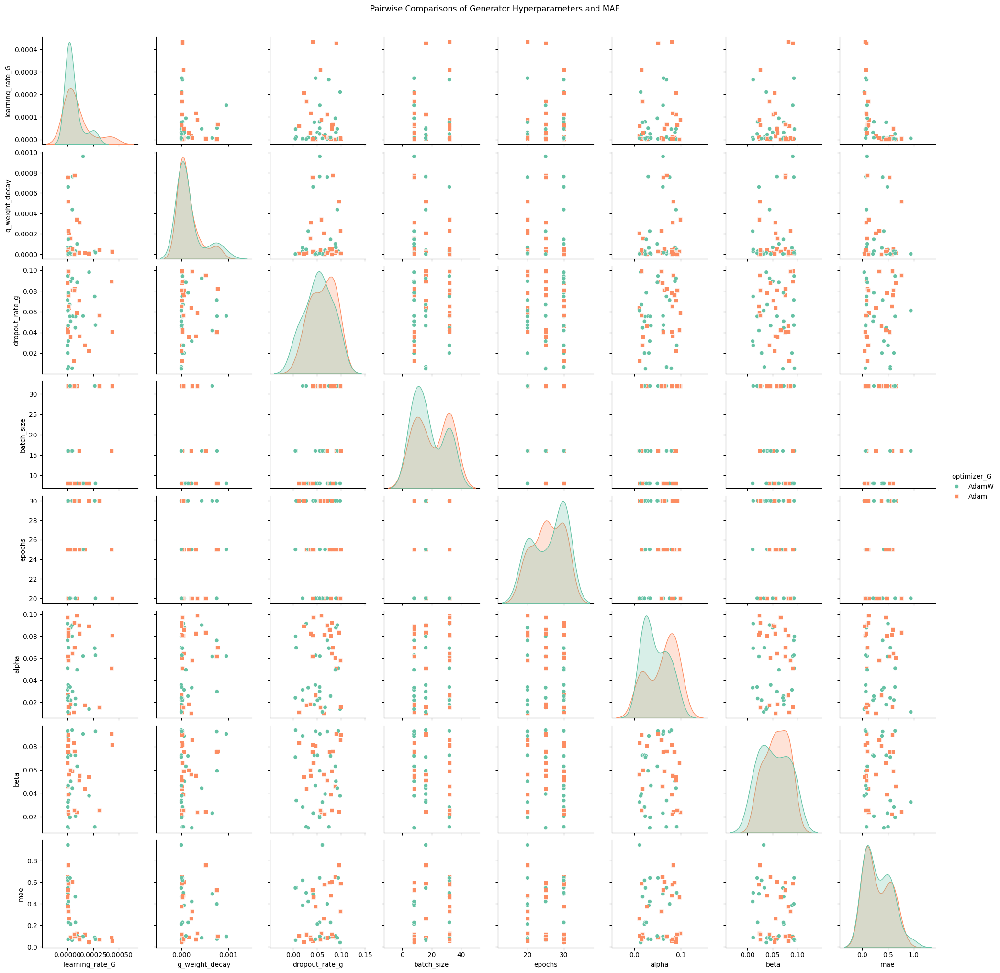

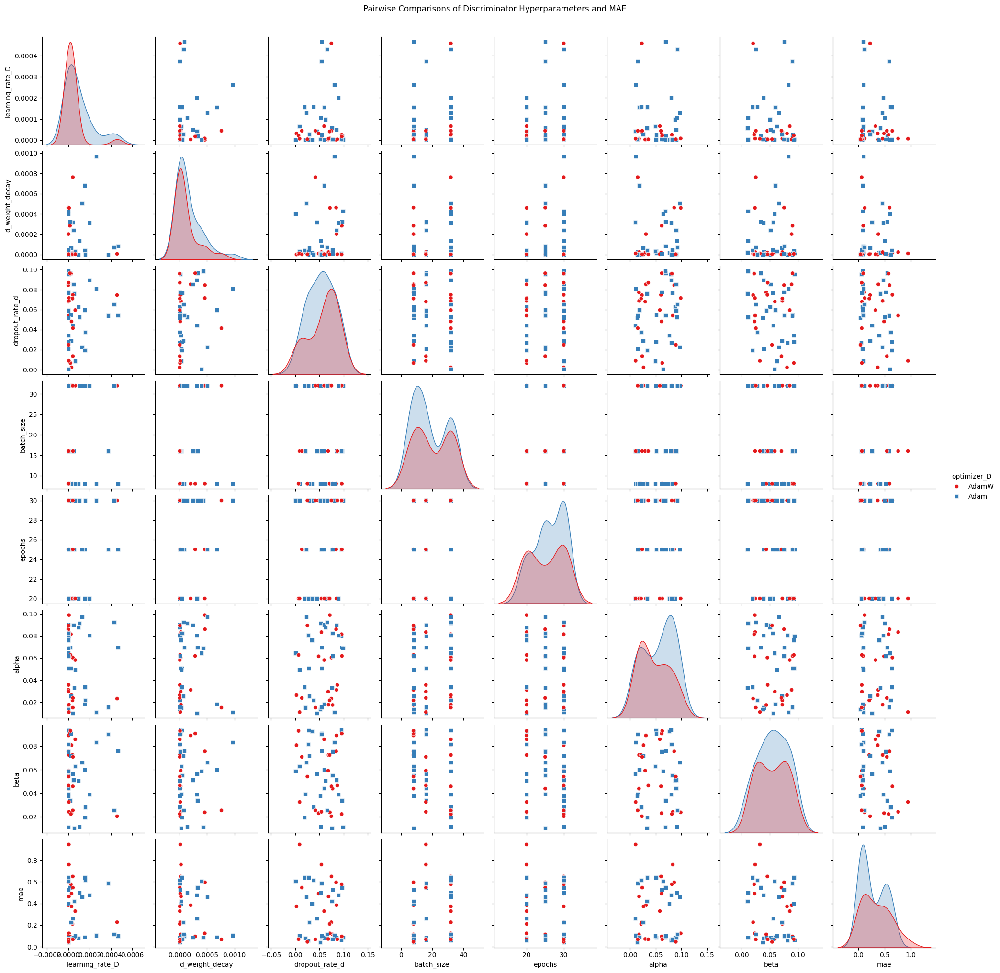

In [84]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select relevant hyperparameters and metrics for generator comparison
selected_vars_generator = ["learning_rate_G", "g_weight_decay", "dropout_rate_g", 
                           "batch_size", "epochs", "alpha", "beta", "mae"]

# Create a pairplot for generator hyperparameters with optimizer_G as hue
sns.pairplot(df, vars=selected_vars_generator, hue="optimizer_G", palette="Set2", markers=["o", "s"])

# Add a title to the plot
plt.suptitle("Pairwise Comparisons of Generator Hyperparameters and MAE", y=1.02)
plt.show()

# Select relevant hyperparameters and metrics for discriminator comparison
selected_vars_discriminator = ["learning_rate_D", "d_weight_decay", "dropout_rate_d", 
                               "batch_size", "epochs", "alpha", "beta", "mae"]

# Create a pairplot for discriminator hyperparameters with optimizer_D as hue
sns.pairplot(df, vars=selected_vars_discriminator, hue="optimizer_D", palette="Set1", markers=["o", "s"])

# Add a title to the plot
plt.suptitle("Pairwise Comparisons of Discriminator Hyperparameters and MAE", y=1.02)
plt.show()


/tmp/ipykernel_36866/79239711.py:56: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


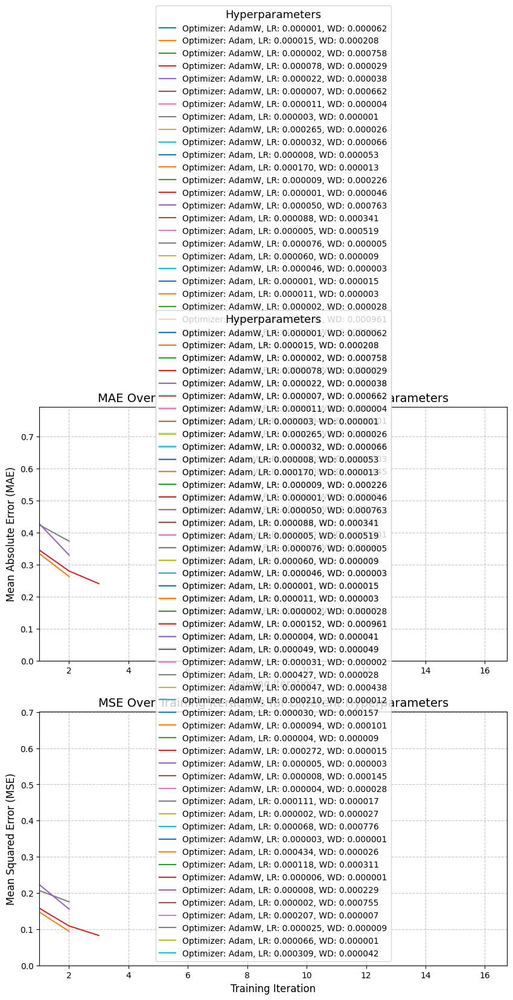

In [110]:
import matplotlib.pyplot as plt

# Initialize the subplot with 2 rows and 1 column
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12))

# Loop through results to plot MSE
for result in result_grid:
    # Access the metrics DataFrame from the result object
    metrics_df = result.metrics_dataframe

    # Filter metrics DataFrame based on the condition that MSE is between 0.09 and 0.6
    filtered_metrics_df = metrics_df[(metrics_df['mse'] >= 0.08) & (metrics_df['mse'] <= 1.01)]


    label = (f"Optimizer: {result.config['optimizer_G']}, "
             f"LR: {result.config['learning_rate_G']:.6f}, "
             f"WD: {result.config['g_weight_decay']:.6f}")
                # Plot MAE
    filtered_metrics_df.plot("training_iteration", "mae", label=label, ax=ax1)

    # Plot MSE
    filtered_metrics_df.plot("training_iteration", "mse", label=label, ax=ax2)

# Adding grid for MAE plot
ax1.grid(True, linestyle='--', alpha=0.7)

# Adding title and labels for MAE plot
ax1.set_title("MAE Over Training Iterations for Different Hyperparameters", fontsize=14)
ax1.set_xlabel("Training Iteration", fontsize=12)
ax1.set_ylabel("Mean Absolute Error (MAE)", fontsize=12)

# Adjusting legend for MAE plot
ax1.legend(title="Hyperparameters", loc='best', fontsize=10, title_fontsize='13')

# Customize the axis limits for MAE plot
ax1.set_xlim(left=1)
ax1.set_ylim(bottom=0)


# Adding grid for MSE plot
ax2.grid(True, linestyle='--', alpha=0.7)

# Adding title and labels for MSE plot
ax2.set_title("MSE Over Training Iterations for Different Hyperparameters", fontsize=14)
ax2.set_xlabel("Training Iteration", fontsize=12)
ax2.set_ylabel("Mean Squared Error (MSE)", fontsize=12)

# Adjusting legend for MSE plot
ax2.legend(title="Hyperparameters", loc='best', fontsize=10, title_fontsize='13')

# Customize the axis limits for MSE plot
ax2.set_xlim(left=1)
ax2.set_ylim(bottom=0)

# Adding a tight layout
plt.tight_layout()

# Save the figure
plt.savefig('training_iterations_plot.png', dpi=300)

# Display the plot
plt.show()


## Read the infer dataset

In [21]:
# Load X and Y datasets
with open(f'{output_pkl}/NE_X_Infer.pkl', 'rb') as f:
    x_data_model = pickle.load(f)
    
x_data_model = x_data_model[0]

with open(f'{output_pkl}/NE_Y_Infer.pkl', 'rb') as f:
    y_data_model, miss_matrix_model = pickle.load(f)

# Load date arrays
with open(f'{output_pkl}/NE_DATE_Infer.pkl', 'rb') as f:
    date_arr = pickle.load(f)

# Load grid information (latitude and longitude)
with open(f'{output_pkl}/NE_Grid_Infer.pkl', 'rb') as f:
    latitude, longitude = pickle.load(f)

# Load season array
with open(f'{output_pkl}/NE_Season_Infer.pkl', 'rb') as f:
    season_arr = pickle.load(f)

# Load month array
with open(f'{output_pkl}/NE_Month_Infer.pkl', 'rb') as f:
    month_arr = pickle.load(f)

In [22]:
# Load binary mask
with open(f'{output_pkl}/NE_BM_Infer.pkl', 'rb') as f:
    data_bm = pickle.load(f)
bm = data_bm[0]

In [23]:
blh_fp = '/opt/yarn/ml-model/Ancillary_files/Location/Northeast/blh_2021001.tif'
with rasterio.open(blh_fp) as src:
    blh_data = src.read(1)
    transform = src.transform  # Get the affine transformation
    width = src.width
    height = src.height

# Generate a grid of pixel coordinates
cols, rows = np.meshgrid(np.arange(width), np.arange(height))
print(cols.shape, rows.shape)
# Transform pixel coordinates to spatial coordinates
xs, ys = rasterio.transform.xy(transform, rows, cols)

# Convert to numpy arrays
lats = np.array(ys)
longs = np.array(xs)

print("Latitude array shape:", lats.shape)
print("Longitude array shape:", longs.shape)

(1171, 987) (1171, 987)
Latitude array shape: (1171, 987)
Longitude array shape: (1171, 987)


In [24]:
lulc_filepath

'/opt/yarn/ml-model/Ancillary_files/LULC/Northeast/NE_LULC.tif'

## Read lulc data

In [25]:
lulc_data, class_to_index = process_lulc_data(lulc_filepath)
lulc_data_remapped = remap_lulc_data(lulc_data, class_to_index)

In [26]:
adj_month_arr = month_arr - 1
y_data_model = np.where((y_data_model == -9999) | (y_data_model == -1.0), np.nan, y_data_model)
infer_dataset = CustomIterableDataset(x_data_model, y_data_model, miss_matrix_model, bm, adj_month_arr, season_arr, lulc_data_remapped, date_arr[0])

In [27]:
batch_size = best_result.config["batch_size"]
infer_loader = DataLoader(infer_dataset, batch_size=batch_size,num_workers=2)

NameError: name 'best_result' is not defined

In [ ]:
# Get the first batch from the DataLoader
first_batch = next(iter(infer_loader))
x_first_batch, y_first_batch = first_batch['X'], first_batch['Y']

In [ ]:
# Extracting the shape of your input data
num_y_segments, in_channels, height, width = y_first_batch.shape
num_x_segments, x_channels, height, width = x_first_batch.shape

In [ ]:
activation_fn = get_activation_function('LeakyReLU')
dropout_rate_g = best_result.config["dropout_rate_g"]
dropout_rate_d = best_result.config["dropout_rate_d"]
alpha = best_result.config["alpha"]
beta = best_result.config["beta"]

In [ ]:
# Instantiate the Generator
generator = Generator(in_channels, x_channels, activation_fn, dropout_rate_g)

# Instantiate the Discriminator
discriminator = Discriminator(in_channels, activation_fn, dropout_rate_d)

In [ ]:
device = "cuda:0" if torch.cuda.is_available() else "cpu"
generator.to(device)
discriminator.to(device)

In [ ]:
checkpoint_path = os.path.join(best_result.checkpoint.to_directory(), checkpoint_name)

model_state = torch.load(checkpoint_path)

generator.load_state_dict(model_state['generator_state_dict'])
discriminator.load_state_dict(model_state['discriminator_state_dict'])

## Run the inference for 2023 (infer), train, test, and validation data

In [11]:
def run_inference(loader):
    generator.eval() 
    discriminator.eval()

    total_g_test_loss = 0
    total_d_test_loss = 0
    total_mse_test_loss = 0
    total_mae_test_loss = 0
    total_test_samples = 0

    imputed_data_samples = []
    gain_data_samples = []
    y_raw_data = []
    y_mask_list = []
    all_dates = []

    # Initialize an empty DataFrame to store all metrics
    all_metrics_df = pd.DataFrame()
    
    with torch.no_grad():  
        for batch_data in loader:
            Y_mb = batch_data['Y']
            X_mb = batch_data['X']
            M_mb = batch_data['M']
            binary_mask = batch_data['binary_mask']
            month = batch_data['month']
            season = batch_data['season']
            lulc = batch_data['lulc']
            date_tensor = batch_data['date']
        
            # Convert date tensor to numpy datetime
            dates = convert_date_tensor_to_datetime(date_tensor)
    
            # Add a channel dimension to the mask, making it [batch_size, 1, height, width]
            binary_mask_expanded = binary_mask.unsqueeze(1)
            binary_mask_x_expanded = binary_mask_expanded.expand(-1, x_channels, -1, -1)
            binary_mask_y_expanded = binary_mask.unsqueeze(1)
    
            # Generate random noise Z_mb with the same shape as your data
            Z_mb = torch.rand_like(Y_mb)
    
            # Generate hint matrix H_mb with a fraction of the observed data points hidden
            H_mb1 = sample_M(Y_mb.shape[0], Y_mb.shape[1:], 1 - p_hint)
            H_mb = M_mb * H_mb1
    
            # Combine the mask and the random noise to create New_X_mb
            New_Y_mb = M_mb * Y_mb + (1 - M_mb) * Z_mb  # Missing Data Introduction
    
            # Apply the ROI mask to ensure operations are only applied within the ROI
            New_Y_mb = New_Y_mb * binary_mask_y_expanded
            X_mb = X_mb * binary_mask_x_expanded
            M_mb = M_mb * binary_mask_y_expanded
            H_mb = H_mb * binary_mask_y_expanded

            D_loss, G_sample = discriminator_loss(generator, discriminator, X_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc)
            G_loss, Adv_loss, MSE_test_loss, MAE_test_loss, G_sample  = generator_loss(generator, discriminator, X_mb, Y_mb, M_mb, New_Y_mb, H_mb, binary_mask_y_expanded, binary_mask_x_expanded, month, season, lulc, alpha, beta)
    
            total_g_test_loss += G_loss.item()
            total_d_test_loss += D_loss.item()
            total_mse_test_loss += MSE_test_loss.item() * Y_mb.size(0)  # Accumulate MSE with weighting by batch size
            total_mae_test_loss += MAE_test_loss.item() * Y_mb.size(0)  
            total_test_samples += Y_mb.size(0)

            # Generate imputed data using the generator
            Imputed_Y_mb = generator(New_Y_mb * binary_mask_y_expanded, M_mb * binary_mask_y_expanded, X_mb * binary_mask_y_expanded, month, season, lulc, binary_mask_y_expanded).detach()
            
            # Integrate imputed and observed data
            Final_Imputed_Y_mb = M_mb * Y_mb + (1 - M_mb) * Imputed_Y_mb
            Final_Imputed_Y_mb *= binary_mask_y_expanded
            Imputed_Y_mb *= binary_mask_y_expanded
            
            batch_metrics_df = calc_metrics(dates, M_mb, Imputed_Y_mb, Y_mb)

            # Append the current batch's metrics to the full DataFrame
            all_metrics_df = pd.concat([all_metrics_df, batch_metrics_df], ignore_index=True)

            imputed_data_samples.append(Final_Imputed_Y_mb.cpu().numpy())
            gain_data_samples.append(Imputed_Y_mb.cpu().numpy())
            y_raw_data.append(Y_mb.cpu().numpy())
            y_mask_list.append(M_mb)
            all_dates.extend(dates)
    
        avg_g_test_loss = total_g_test_loss / total_test_samples
        avg_d_test_loss = total_d_test_loss / total_test_samples
        avg_test_mse = total_mse_test_loss / total_test_samples
        avg_test_mae = total_mae_test_loss / total_test_samples
        avg_test_rmse = np.sqrt(total_mse_test_loss / total_test_samples) 

        # Print out the final average losses and total RMSE for training
        print(f'Average test G_loss: {avg_g_test_loss:.4f}')
        print(f'Average test D_loss: {avg_d_test_loss:.4f}')
        print(f'Average test MSE: {avg_test_mse:.4f}')
        print(f'Average test MAE: {avg_test_mae:.4f}')
        print(f'Average test RMSE: {avg_test_rmse:.4f}')
        
        return imputed_data_samples, gain_data_samples, y_raw_data, all_dates, y_mask_list, all_metrics_df

## Call the inference 2023

In [26]:
imputed_infer_data_samples, gain_infer_data_samples, y_infer_data, infer_dates, y_infer_mask_data, infer_df = run_inference(infer_loader)

2023-01-01 00:00:00 0.0063609667 0.5914043708413864
2023-01-02 00:00:00 0.007460312 0.5952550572072255
2023-01-03 00:00:00 0.015205579 0.694028515654883
2023-01-04 00:00:00 0.0117690815 0.33748884898596104
2023-01-05 00:00:00 0.0065989285 0.6475756796743326
2023-01-06 00:00:00 0.009169299 0.7125189373497198
2023-01-07 00:00:00 0.009385639 0.636668350720298
2023-01-08 00:00:00 0.0029222062 0.42101338697118107
2023-07-03 00:00:00 0.0044893594 0.7383812302271551
2023-07-04 00:00:00 0.006614959 0.5889121875001578
2023-07-05 00:00:00 0.006151958 0.7282071954551026
2023-07-06 00:00:00 0.0066125058 0.6780014834940744
2023-07-07 00:00:00 0.0040914724 0.8220708379026593
2023-07-08 00:00:00 0.0073257587 0.6946301234084761
2023-07-09 00:00:00 0.01213816 0.5734244722881303
2023-07-10 00:00:00 0.011050831 0.7187565335503373
2023-01-09 00:00:00 0.0036617098 0.6104584256370422
2023-01-10 00:00:00 0.005678477 0.5203964164284908
2023-01-11 00:00:00 0.0030952736 0.6463525157753729
2023-01-12 00:00:00 0.

/tmp/ipykernel_30037/1357054649.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_30037/1357054649.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_30037/1357054649.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_30037/1357054649.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2023-10-23 00:00:00 0.0004943881 0.7244286529199013
2023-10-24 00:00:00 0.0014681933 0.7011929994606765
2023-10-25 00:00:00 0.0022141584 0.7280790196132003
2023-10-26 00:00:00 0.0017111828 0.561313067038433
2023-10-27 00:00:00 0.0017463944 0.6612570578367398
2023-10-28 00:00:00 0.0017306173 0.5757785544940931
2023-10-29 00:00:00 0.0031091906 0.5550954670924154
2023-10-30 00:00:00 0.0031163285 0.8638150591461556
2023-05-01 00:00:00 0.008541373 0.7309758179864667
2023-05-02 00:00:00 0.5478906 0.9417129968831428
2023-05-03 00:00:00 0.004158886 0.707445685052663
2023-05-04 00:00:00 0.010715533 0.536852344954099
2023-05-05 00:00:00 0.005899535 0.728265921104468
2023-05-06 00:00:00 0.0016550733 0.623053077583702
2023-05-07 00:00:00 0.0009610455 0.6938500203681965
2023-05-08 00:00:00 0.03359847 0.9111228029007917
2023-10-31 00:00:00 0.0025736257 0.6183424660453631
2023-11-01 00:00:00 0.008052714 0.7262018896883926
2023-11-02 00:00:00 0.0015376157 0.616408637872874
2023-11-03 00:00:00 0.001603

/tmp/ipykernel_30037/1357054649.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_30037/1357054649.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_30037/1357054649.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_30037/1357054649.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2023-06-18 00:00:00 0.0072513474 0.5573100703358622
2023-06-19 00:00:00 0.0058402303 0.8505826157833771
2023-06-20 00:00:00 0.0022733798 0.8978885040883987
2023-06-21 00:00:00 0.0045441375 0.9076676657820573
2023-06-22 00:00:00 0.004340789 0.9429146844353475
2023-06-23 00:00:00 0.0031660637 0.9340194711589612
2023-06-24 00:00:00 0.005053581 0.45276442893707924
2023-06-25 00:00:00 0.13456419 0.9393300751552851
2023-12-18 00:00:00 0.0014222065 0.7966437496794466
2023-12-19 00:00:00 0.0007496306 0.6020557341494366
2023-12-20 00:00:00 0.0017056478 0.5093312062701225
2023-12-21 00:00:00 0.0010608734 0.7169792647778293
2023-12-22 00:00:00 0.00086830615 0.5859360408148375
2023-12-23 00:00:00 0.0013547976 0.5662935127788576
2023-12-24 00:00:00 0.003315666 0.6278984916510117
2023-12-25 00:00:00 0.0043394077 0.6268664624351268
2023-06-26 00:00:00 0.004504517 0.9780650304316657
2023-06-27 00:00:00 0.0046701725 0.7237943119931629
2023-06-28 00:00:00 0.5339977 0.7962704756507982
2023-06-29 00:00:00

In [29]:
infer_df.to_csv(f'{metrics_path}NE_infer_metrics_rt.csv')

## Process imputed data 2023

In [30]:
imputed_infer_aod, gain_infer_imputed_aod, y_infer_data, sorted_infer_dates = process_imputed_data(imputed_infer_data_samples, gain_infer_data_samples, miss_matrix_model, y_infer_data, infer_dates, bm)

## Visualize plot 2023

In [ ]:
date = datetime(2023, 10, 15, 0, 0)  # Replace with the desired date
create_plots(imputed_infer_aod, gain_infer_imputed_aod, y_infer_data, miss_matrix_model, sorted_infer_dates, date, 'rainbow')

In [37]:
imputed_infer_xr = transform_and_create_dataset(gain_infer_imputed_aod, date_arr[0], longs, lats, proj_string)
save_output(f'{tif_path}/GAIN/RT/', imputed_infer_xr)
# f'{tif_path}/GAIN/RT/'

<class 'xarray.core.dataset.Dataset'>
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023001_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023002_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023003_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023004_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023005_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023006_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023007_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023008_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023009_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023010_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023011_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2023012_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/

## UQ MCD

In [ ]:
from utils.model_utils import sample_M
def enable_dropout(model):
    """Function to enable dropout layers during evaluation."""
    for module in model.modules():
        if isinstance(module, (torch.nn.Dropout, torch.nn.Dropout2d)):
            module.train()  

def eval_with_mcd(loader, generator, discriminator, p_hint, alpha, beta, z_score, device, num_samples=10):
    generator.eval()  # Set the generator to evaluation mode
    discriminator.eval()  # Set the discriminator to evaluation mode
    
    # Enable dropout layers during evaluation
    enable_dropout(generator)
    
    # total_g_test_loss = 0
    # total_d_test_loss = 0
    # total_mse_test_loss = 0
    # total_mae_test_loss = 0
    # total_test_samples = 0
    
    # imputed_data_samples = []

    gain_data_samples = []
    variance_data_samples = []
    lower_bound_samples = []
    upper_bound_samples = []
    y_actual_samples = []
    date_list = []
    y_mask_list = []

    # all_metrics_df = pd.DataFrame()

    with torch.no_grad():  # No gradients needed for evaluation
        for batch_data in loader:
            
            X_mb = batch_data['X'].to(device)
            M_mb = batch_data['M'].to(device)
            Y_mb = batch_data['Y'].to(device)
            binary_mask = batch_data['binary_mask']
            month = batch_data['month']
            season = batch_data['season']
            lulc = batch_data['lulc']
            date_tensor = batch_data['date']

            dates = convert_tr_dt_to_dt(date_tensor)

            num_x_segments, x_channels, height, width = X_mb.shape
            num_y_segments, in_channels, height, width = Y_mb.shape

            # First, add a channel dimension to the mask, making it [batch_size, 1, height, width]
            binary_mask_expanded = binary_mask.unsqueeze(1) 
            binary_mask_x_expanded = binary_mask_expanded.expand(-1, x_channels, -1, -1) 
            binary_mask_y_expanded = binary_mask.unsqueeze(1)

            # Generate random noise Z_mb with the same shape as your data
            Z_mb = torch.rand_like(Y_mb)

            # Generate hint matrix H_mb1 with a fraction of the observed data points hidden
            H_mb1 = sample_M(Y_mb.shape[0], Y_mb.shape[1:], 1 - p_hint)
            H_mb = M_mb * H_mb1

            # Combine the mask and the random noise to create New_X_mb
            New_Y_mb = M_mb * Y_mb + (1 - M_mb) * Z_mb  # Missing Data Introduction

            # Apply the ROI mask to ensure operations are only applied within the ROI
            New_Y_mb = New_Y_mb * binary_mask_y_expanded
            X_mb = X_mb * binary_mask_x_expanded
            M_mb = M_mb * binary_mask_y_expanded
            H_mb = H_mb * binary_mask_y_expanded

            # Verify if dropout layers are in training mode
            for m in generator.modules():
                if isinstance(m, torch.nn.Dropout) or isinstance(m, torch.nn.Dropout2d):
                    print(f"Dropout layer {m} in training mode: {m.training}")

            # Perform multiple stochastic forward passes to capture uncertainty
            all_imputed_samples = []
            for i in range(num_samples):
                print(f'running the sample {i}')
                Imputed_Y_mb = generator(New_Y_mb * binary_mask_y_expanded, 
                                         M_mb * binary_mask_y_expanded, 
                                         X_mb * binary_mask_x_expanded, 
                                         month, season, lulc, binary_mask_y_expanded).detach()
                Imputed_Y_mb *= binary_mask_y_expanded  # Mask out outside ROI
                all_imputed_samples.append(Imputed_Y_mb)

            # Stack the predictions using torch.stack
            all_imputed_samples = torch.stack(all_imputed_samples, dim=0)
            binary_mask_y_expanded = binary_mask_y_expanded.unsqueeze(0).expand(all_imputed_samples.shape)
            
            nan_mask = ~binary_mask_y_expanded.bool()  # Identify outside-ROI pixels
            all_imputed_samples[nan_mask] = float('nan')

            valid_mask = binary_mask_y_expanded.bool() 
            mean_imputed_Y_mb = torch.sum(all_imputed_samples * valid_mask, dim=0) / valid_mask.sum(dim=0)
            variance_imputed_Y_mb = torch.sum(((all_imputed_samples - mean_imputed_Y_mb) ** 2) * valid_mask, dim=0) / valid_mask.sum(dim=0)
            std_imputed_Y_mb = torch.sqrt(
                torch.sum(((all_imputed_samples - mean_imputed_Y_mb) ** 2) * valid_mask, dim=0) / valid_mask.sum(dim=0)
            )
            lower_bound = mean_imputed_Y_mb - z_score * std_imputed_Y_mb
            upper_bound = mean_imputed_Y_mb + z_score * std_imputed_Y_mb

            # Compute single scalar values
            mean_value = torch.nanmean(mean_imputed_Y_mb).item()
            var_value = torch.nanmean(variance_imputed_Y_mb).item()
            std_value = torch.nanmean(std_imputed_Y_mb).item() 
            # Compute single scalar values while ignoring NaNs
            lb_value = torch.nanmean(lower_bound).item()
            ub_value = torch.nanmean(upper_bound).item()
            
            # Print the values
            print(f"Mean: {mean_value}, Variance: {var_value}, Standard deviation: {std_value}, lower bound: {lb_value}, upper bound: {ub_value}")

    
            # Store the mean imputed values and uncertainty
            # imputed_data_samples.append(Final_Imputed_Y_mb.cpu().numpy()) 
            gain_data_samples.append(mean_imputed_Y_mb.cpu().numpy())
            variance_data_samples.append(variance_imputed_Y_mb.cpu().numpy())
            lower_bound_samples.append(lower_bound.cpu().numpy())
            upper_bound_samples.append(upper_bound.cpu().numpy())
            y_actual_samples.append(Y_mb.cpu().numpy())
            y_mask_list.append(M_mb)
            date_list.extend(dates)

    
    return gain_data_samples, variance_data_samples, lower_bound_samples, upper_bound_samples, y_actual_samples, y_mask_list, date_list 

In [ ]:
z_score90 = 1.645
z_score95 = 1.96
z_score99 = 2.576

In [ ]:
uq_gain_infer_samples, uq_variance_infer_samples, lower_bound_infer_samples, upper_bound_infer_samples, uq_y_actual_infer_samples, uq_y_mask_infer_list, uq_date_infer_list  = eval_with_mcd(infer_loader, generator, discriminator, p_hint, alpha, beta, z_score95, device, num_samples=10)

In [ ]:

def process_imputed_data_uq(gain_data_samples, variance_data_samples, lower_data_samples, upper_data_samples, y_actual_samples, miss_data, all_dates, bm):
    
    gain_concat = np.concatenate(gain_data_samples, axis=0)
    var_concat = np.concatenate(variance_data_samples, axis=0)
    lower_b_concat = np.concatenate(lower_data_samples, axis=0)
    upper_b_concat = np.concatenate(upper_data_samples, axis=0)
    y_concat = np.concatenate(y_actual_samples, axis = 0)

    total_days, channels, height, width = var_concat.shape

    combined = list(zip(all_dates, gain_concat, var_concat, lower_b_concat, upper_b_concat, y_concat))
    combined.sort(key=lambda x: x[0])
    sorted_dates, sorted_gain_concat, sorted_var_concat, sorted_lower_data, sorted_upper_data, sorted_y_data = zip(*combined)

    sorted_gain_concat = np.array(sorted_gain_concat)
    sorted_var_concat = np.array(sorted_var_concat)
    sorted_lower_data = np.array(sorted_lower_data)
    sorted_upper_data = np.array(sorted_upper_data)
    sorted_y_data = np.array(sorted_y_data)

    expanded_bm = np.expand_dims(np.expand_dims(bm, axis=0), axis=0)
    expanded_bm = np.repeat(expanded_bm, total_days, axis=0)
    
    gain_imputed_aod = np.where(expanded_bm == 0, np.nan, sorted_gain_concat)
    var_aod = np.where(expanded_bm == 0, np.nan, sorted_var_concat)
    lower_bound_aod = np.where(expanded_bm == 0, np.nan, sorted_lower_data)
    upper_bound_aod = np.where(expanded_bm == 0, np.nan, sorted_upper_data)
    actual_aod = np.where((expanded_bm == 0)|(miss_data==0), np.nan, sorted_y_data)
    
    return gain_imputed_aod, var_aod, lower_bound_aod, upper_bound_aod, actual_aod, sorted_dates

In [ ]:
gain_imputed_infer_aod, var_infer_aod, lower_bound_infer_aod, upper_bound_infer_aod, actual_infer_aod, sorted_infer_dates = process_imputed_data_uq(uq_gain_infer_samples, uq_variance_infer_samples, lower_bound_infer_samples, upper_bound_infer_samples, uq_y_actual_infer_samples, miss_matrix_model, uq_date_infer_list, data_bm[0])

In [189]:

def create_xr(imputed_aod, date_arr, longitude, latitude, proj_string):
    x_prj = longitude[0,:]
    y_prj = latitude[:,0]
    date_xr = np.array(date_arr, dtype='datetime64[ns]')
    imputed_data = xr.Dataset(
        {
            "data": (["time", "latitude", "longitude"], imputed_aod[:,0,:])
        },
        coords={
            "time": ("time", date_xr),
            "longitude": ("longitude", x_prj),
            "latitude": ("latitude", y_prj),
        }
    )
    imputed_data.rio.write_crs(proj_string, inplace=True)
    return imputed_data
    
def save_output(output_path, file_substr, imputed_data, save_mode = 1):
    print(type(imputed_data))
    if save_mode == 1:
        for time_idx in range(len(imputed_data.time)):
            # Select the data at this particular time
            single_time_slice = imputed_data.isel(time=time_idx)
            timestamp = pd.to_datetime(single_time_slice.time.values)
            year_doy = timestamp.strftime('%Y%j')  
            print(f'Saving {output_path}MAIAC_{year_doy}_{file_substr}.tif')
            tif_filename = f"{output_path}MAIAC_{year_doy}_{file_substr}.tif"
            single_time_slice.rio.to_raster(tif_filename)

    elif save_mode == 2:
        date_arr = imputed_data.time.values
        pd_date = pd.Timestamp(date_arr[0])
        year = pd_date.year
        nc4_filename = f"output_path{output_nc4}MAIAC_{year}_GAIN.nc"
        imputed_data.to_netcdf(path=output_filename)

In [190]:
import os
uq_path = '/data/Imputation/Northeast/Output/Version3/UQ/'
if not os.path.exists(f'{uq_path}/'):
    os.makedirs(f'{uq_path}/')
var_infer_xr = create_xr(var_infer_aod, date_arr[0], longs, lats, proj_string)
save_output(f'{uq_path}/', 'GAIN_UQ', var_infer_xr)

<class 'xarray.core.dataset.Dataset'>
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023001_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023002_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023003_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023004_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023005_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023006_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023007_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023008_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023009_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023010_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023011_GAIN_UQ.tif
Saving /data/Imputation/Northeast/Output/Version3/UQ//MAIAC_2023012_GAIN_UQ.tif
Sa

In [ ]:
pi_width_infer = upper_bound_infer_aod - lower_bound_infer_aod

In [191]:
ci_path = '/data/Imputation/Northeast/Output/Version3/CI/'
ci_infer_xr = create_xr(pi_width_infer, date_arr[0], longs, lats, proj_string)
save_output(f'{ci_path}/', 'GAIN_CI', ci_infer_xr)

<class 'xarray.core.dataset.Dataset'>
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023001_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023002_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023003_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023004_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023005_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023006_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023007_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023008_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023009_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023010_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023011_GAIN_CI.tif
Saving /data/Imputation/Northeast/Output/Version3/CI//MAIAC_2023012_GAIN_CI.tif
Sa

/tmp/ipykernel_28761/1230756836.py:10: RuntimeWarning: Mean of empty slice
  actual_mean = np.nanmean(actual_infer_aod[:, 0, :, :], axis=(1, 2))


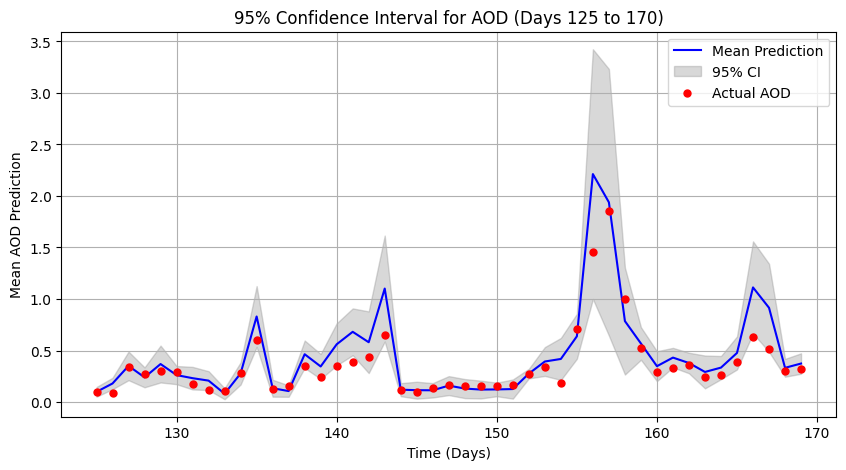

In [193]:
import matplotlib.pyplot as plt
import numpy as np

# Compute the spatial mean for each day (ignoring NaNs)
mean_lower_bound = np.nanmean(lower_bound_infer_aod[:, 0, :, :], axis=(1, 2))
mean_upper_bound = np.nanmean(upper_bound_infer_aod[:, 0, :, :], axis=(1, 2))
mean_prediction = (mean_lower_bound + mean_upper_bound) / 2  # If mean is not separately available

# Compute actual AOD values (ignoring NaNs)
actual_mean = np.nanmean(actual_infer_aod[:, 0, :, :], axis=(1, 2))
# actual_mean = np.nanmean(actual_infer_aod[:, 0, :, :], axis=(1, 2))

# Define time range
time = np.arange(len(mean_prediction))  # Full time range
start_day, end_day = 125, 170  # Selected time range

# Plot confidence interval and mean prediction
plt.figure(figsize=(10, 5))
plt.plot(time[start_day:end_day], mean_prediction[start_day:end_day], 'b-', label="Mean Prediction")  # Line plot
plt.fill_between(time[start_day:end_day], mean_lower_bound[start_day:end_day], mean_upper_bound[start_day:end_day], 
                 color='gray', alpha=0.3, label="95% CI")

# **Add blue dots for actual AOD values**
plt.scatter(time[start_day:end_day], actual_mean[start_day:end_day], color='red', 
            label="Actual AOD", zorder=3, s=25)

# Labels and title
plt.xlabel("Time (Days)")
plt.ylabel("Mean AOD Prediction")
plt.title(f"95% Confidence Interval for AOD (Days {start_day} to {end_day})")
plt.legend()
plt.grid()
plt.savefig("AOD_Confidence_Interval.png", dpi=300, bbox_inches="tight")  # High-res PNG

plt.show()


######### 0###############
0.11484182
0.608567
0.0004968764
0.01395292
0.0
0.427


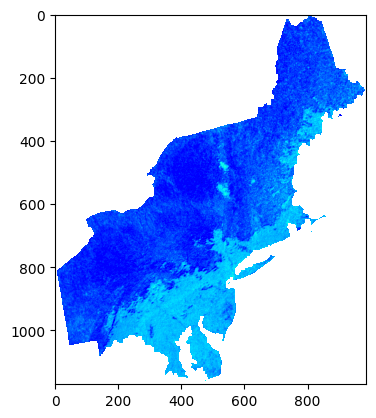

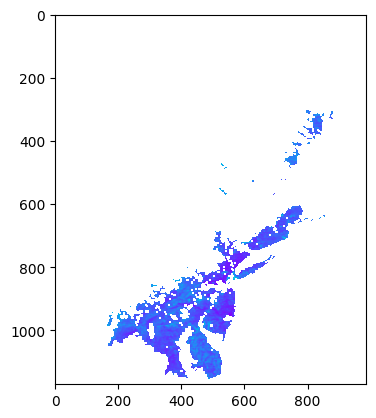

######### 1###############
0.09194659
0.5090873
0.00031850734
0.009764118
0.0
0.392


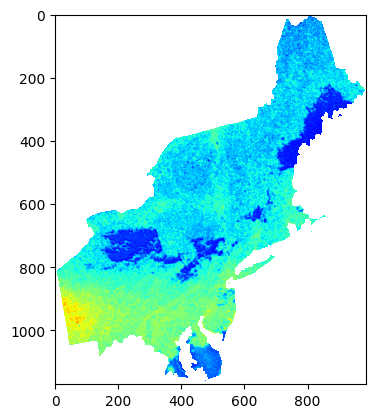

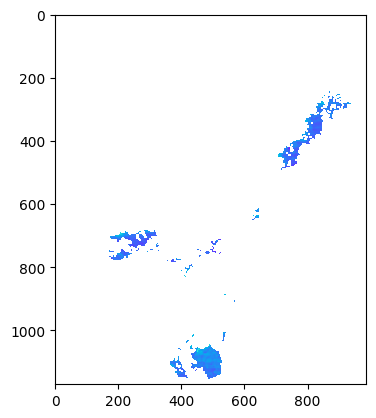

######### 2###############
0.07432163
0.51146865
0.0002081031
0.009855675
0.11
0.434


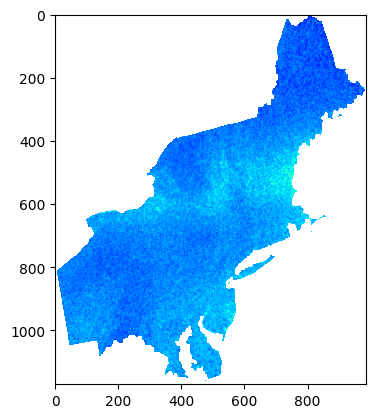

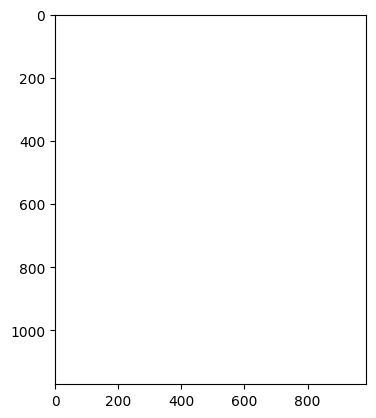

######### 3###############
0.08994937
0.5952368
0.0003048209
0.013348361
0.024
0.393


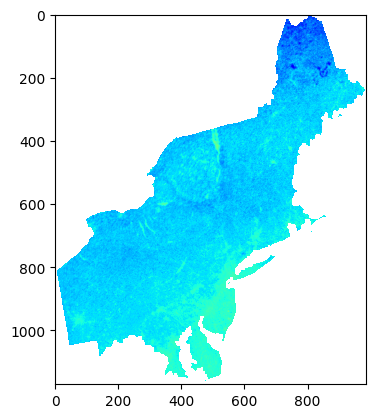

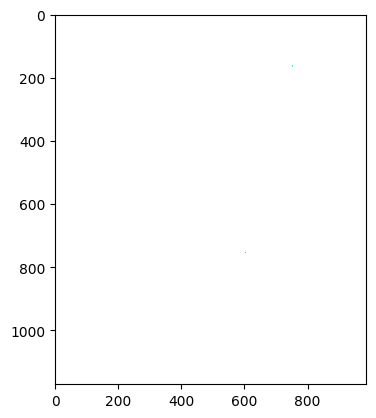

######### 4###############
0.0837315
0.4507239
0.00026413507
0.007653664
0.0
0.432


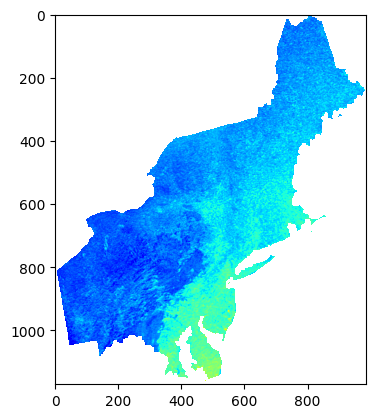

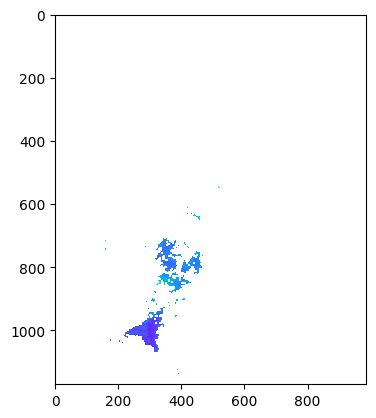

######### 5###############
0.09510398
0.41001385
0.0003407577
0.0063335234
0.0
0.625


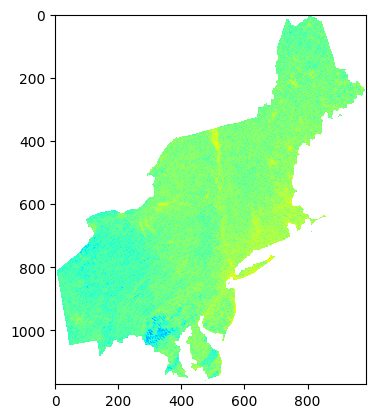

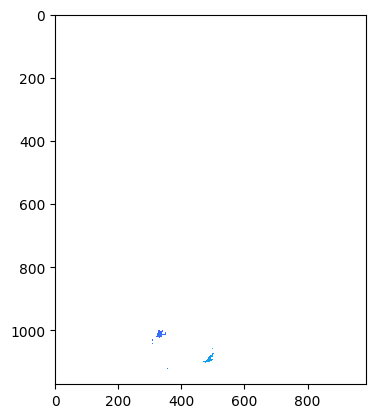

######### 6###############
0.06916076
0.46289068
0.00018020545
0.008072445
0.0
0.435


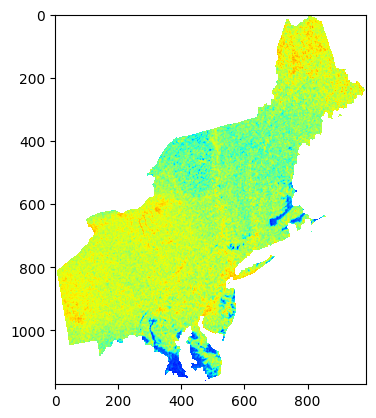

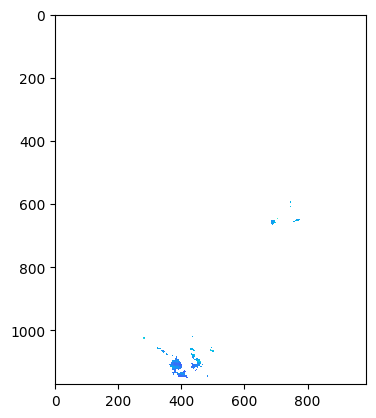

######### 7###############
0.09556383
0.4353702
0.00034406074
0.007141112
0.0
0.383


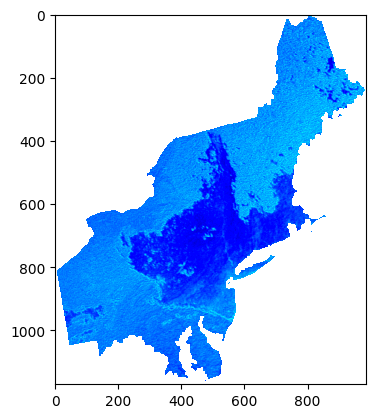

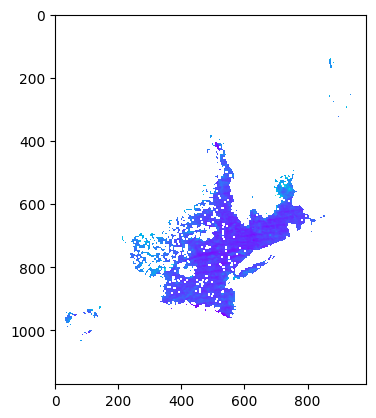

######### 8###############
0.062073708
0.6541852
0.00014516563
0.016123142
0.0
0.415


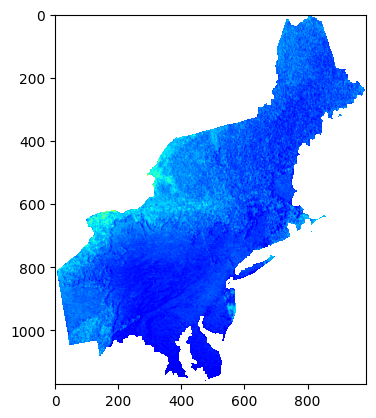

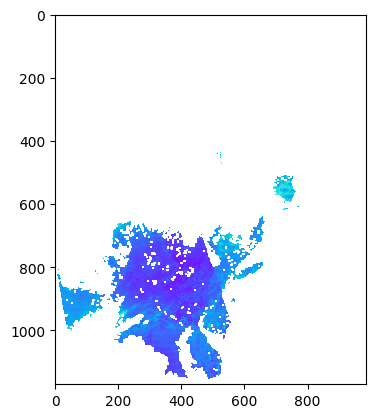

######### 9###############
0.046356354
0.5063852
8.095933e-05
0.009660737
0.0
0.434


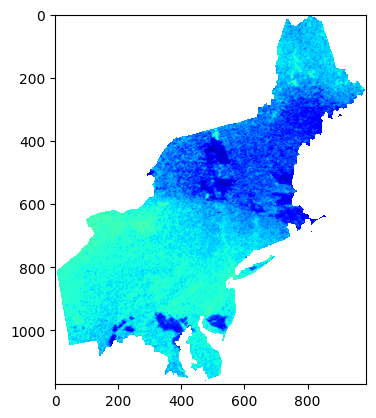

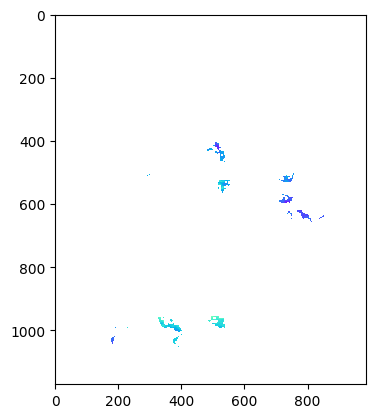

######### 10###############
0.06085986
0.56698465
0.00013954373
0.0121113015
0.0
0.427


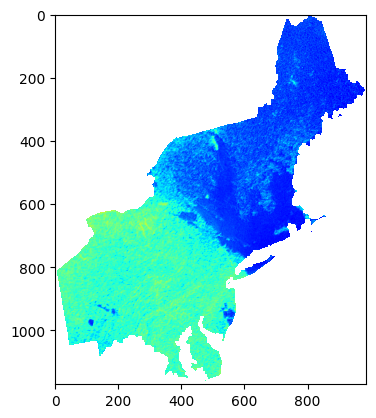

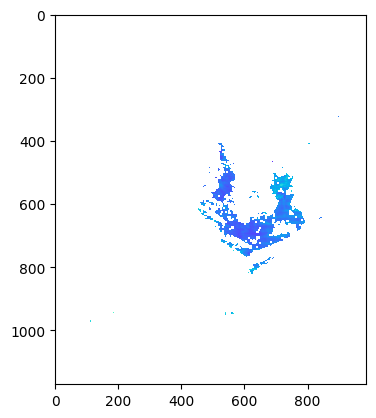

######### 11###############
0.09742707
0.54536784
0.00035760837
0.011205399
0.165
0.404


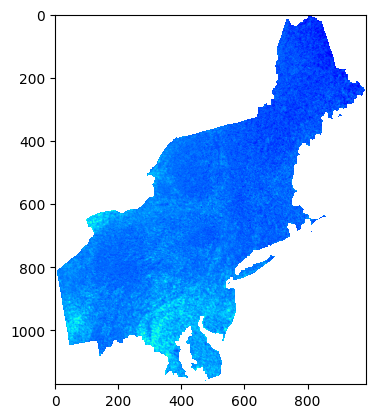

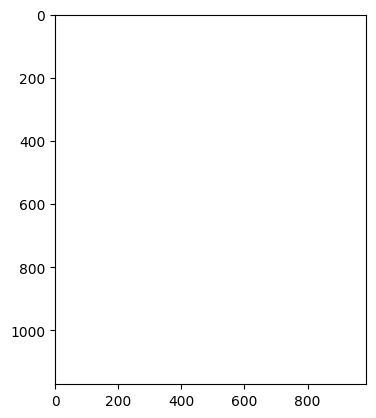

######### 12###############
0.09019768
0.5799298
0.00030650603
0.01267066
0.0
0.419


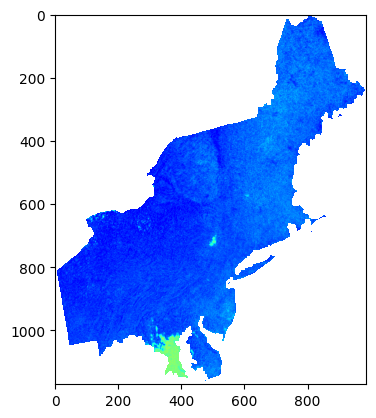

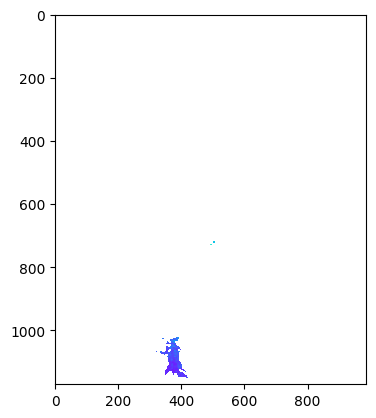

######### 13###############
0.08968651
0.4806075
0.00030304198
0.0087022055
0.0
0.427


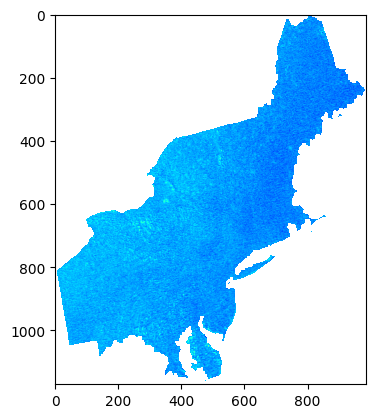

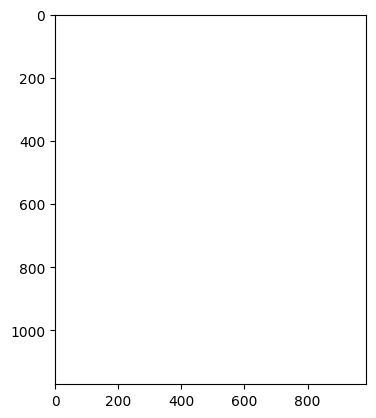

######### 14###############
0.059786543
0.5449846
0.0001346652
0.011189654
0.0
0.436


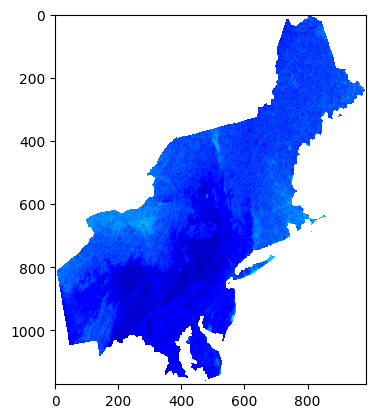

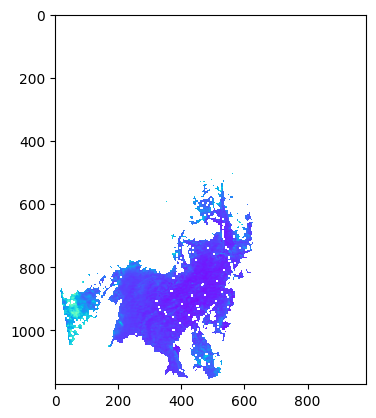

######### 15###############
0.08897948
0.516294
0.0002982827
0.0100425165
0.0
0.445


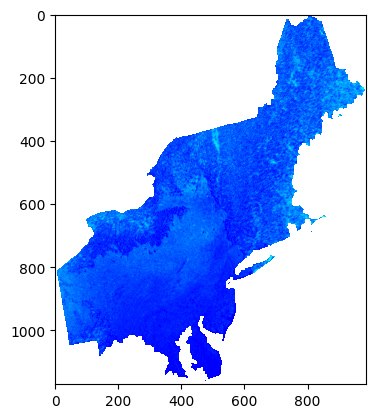

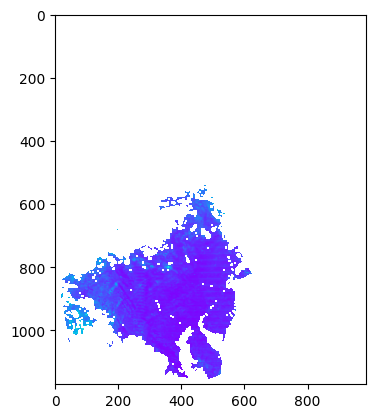

######### 16###############
0.06405932
0.6397517
0.00015460122
0.0154195335
0.0
0.567


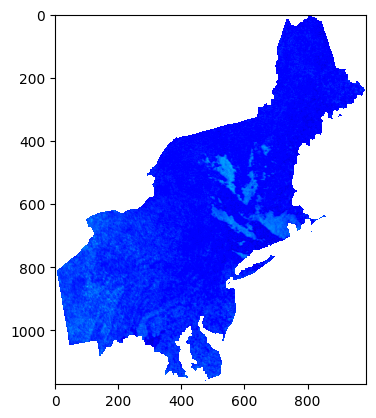

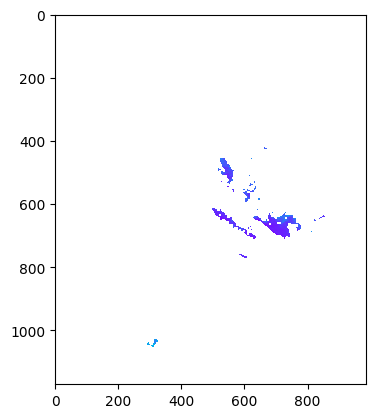

######### 17###############
0.07115781
0.5179645
0.00019076277
0.010107605
0.0
0.431


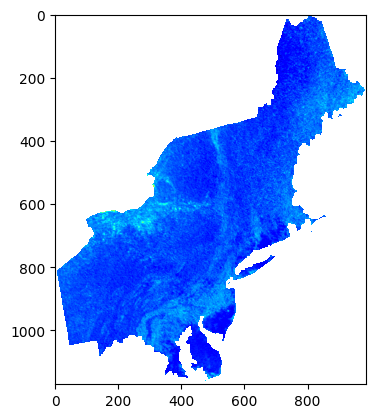

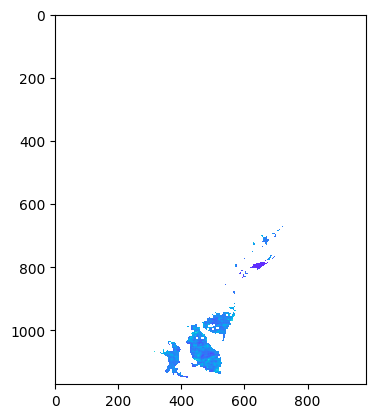

######### 18###############
0.08764908
0.51156473
0.00028942965
0.00985938
0.009
0.365


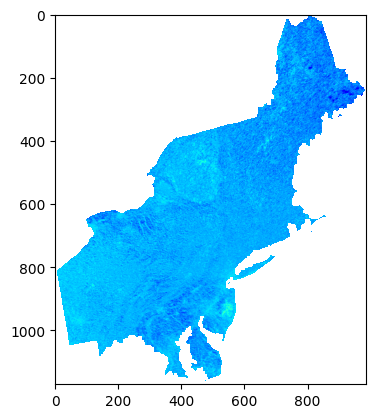

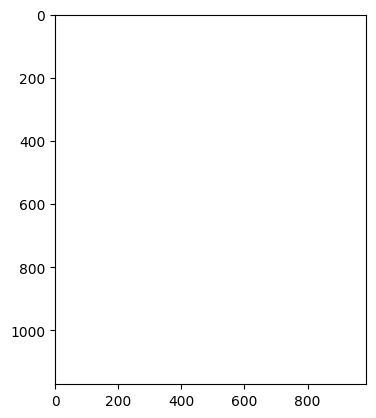

######### 19###############
0.057172753
0.58638203
0.00012314774
0.012954173
0.0
0.529


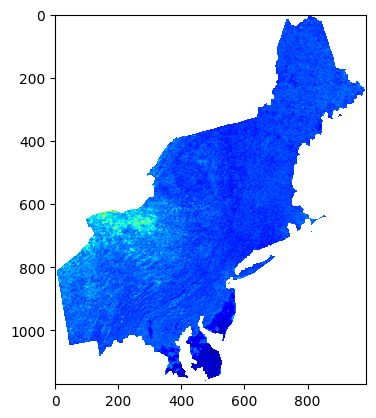

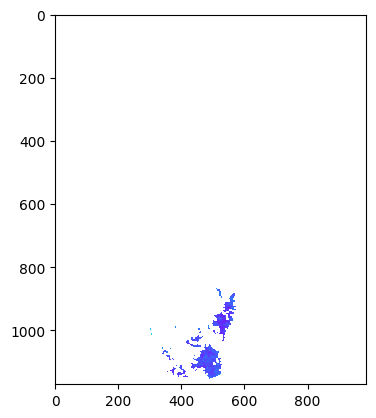

######### 20###############
0.0659948
0.5901613
0.00016408456
0.013121689
0.0
0.41


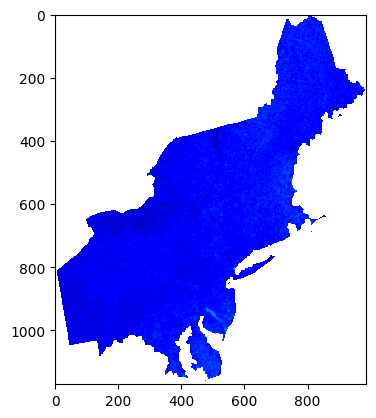

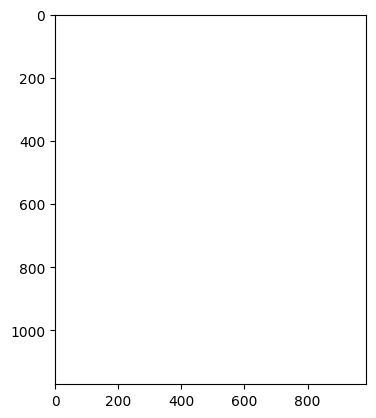

######### 21###############
0.10021442
0.64379203
0.00037836318
0.01561491
0.0
0.422


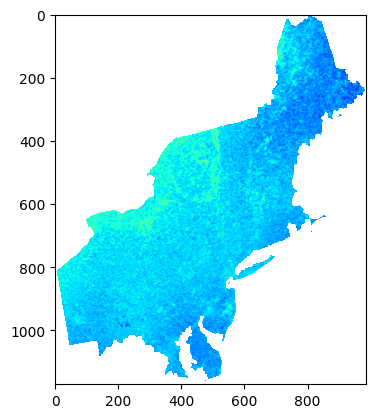

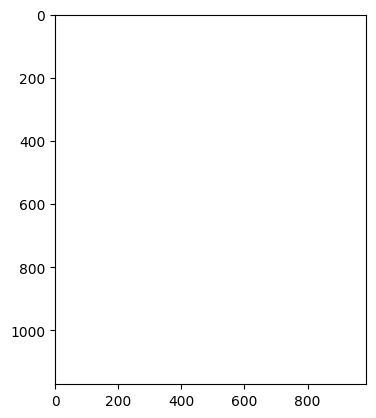

######### 22###############
0.10275139
0.59220195
0.00039776246
0.013212587
0.0
0.425


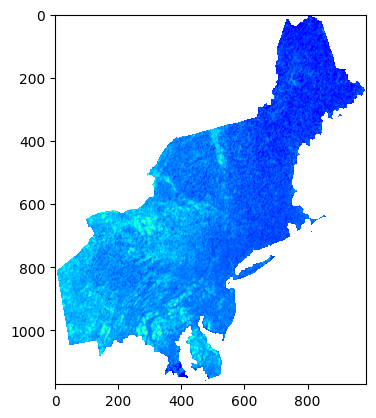

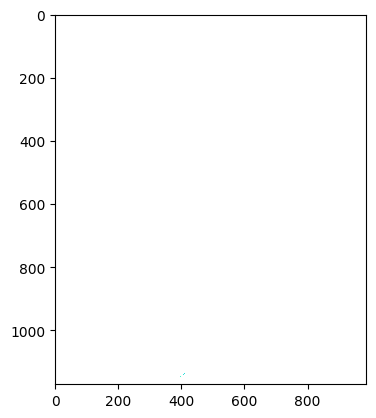

######### 23###############
0.08423446
0.60040104
0.00026731778
0.013580983
0.0
0.434


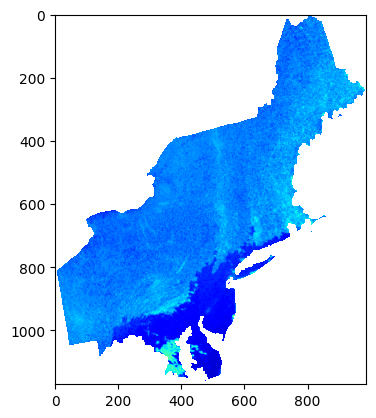

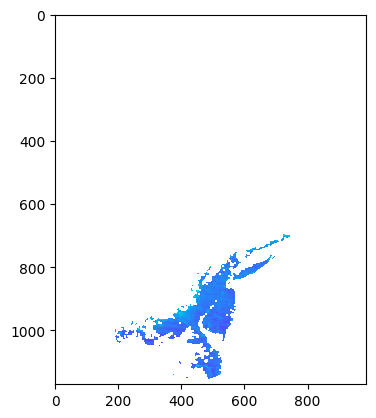

######### 24###############
0.04306197
0.4598684
6.986126e-05
0.007967378
0.108
0.404


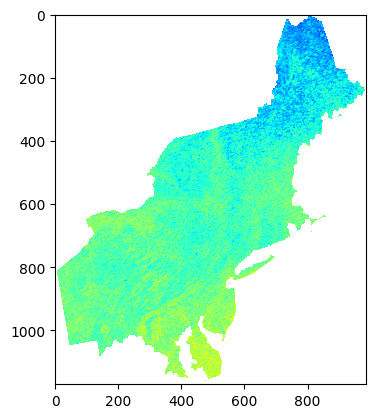

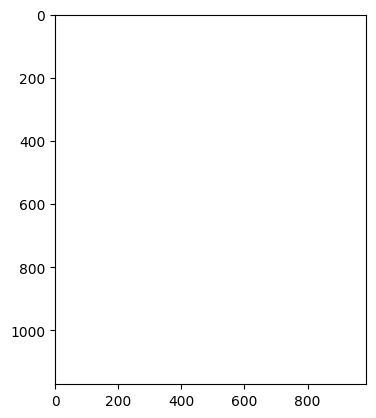

######### 25###############
0.0701368
0.6849622
0.00018532768
0.017675903
0.0
0.419


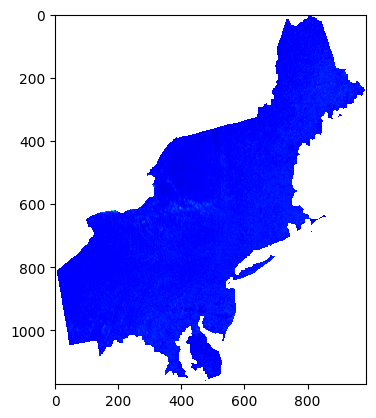

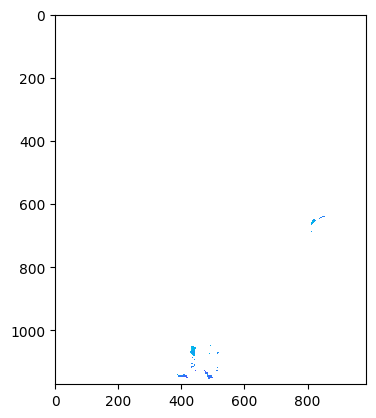

######### 26###############
0.053017616
0.45695734
0.00010589814
0.007866827
0.0
0.436


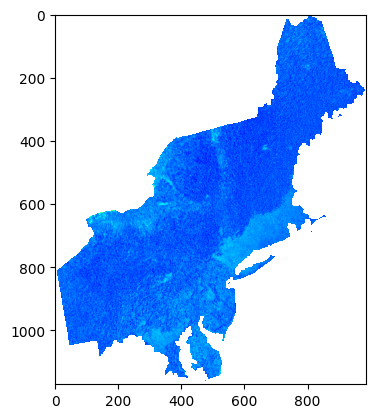

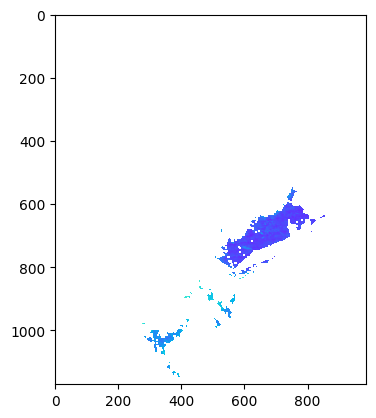

######### 27###############
0.054413676
0.46686673
0.00011154865
0.008211722
0.0
0.435


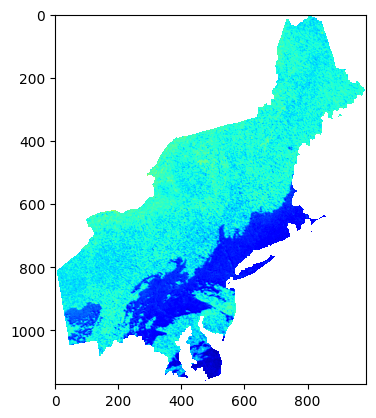

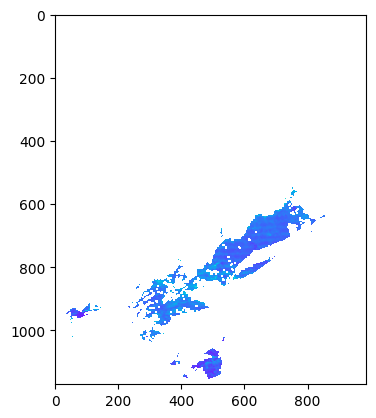

######### 28###############
0.110319376
0.7232244
0.0004585133
0.019705813
0.042
0.373


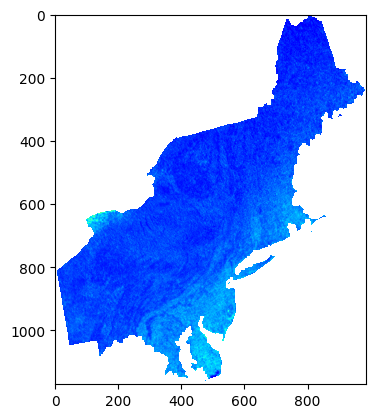

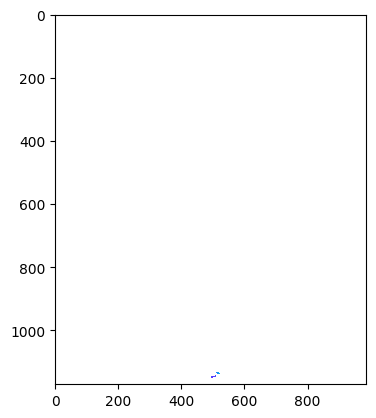

######### 29###############
0.08823007
0.7406032
0.0002932793
0.020664241
0.0
0.435


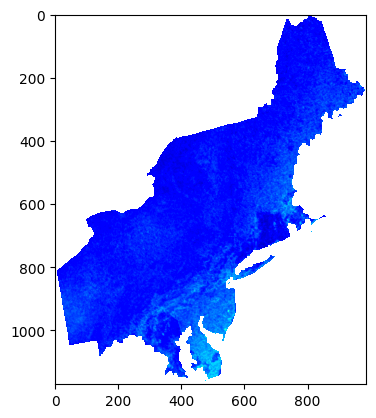

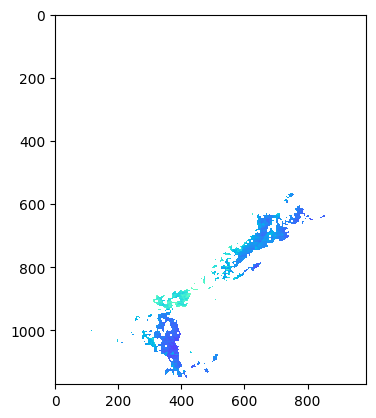

######### 30###############
0.10976584
0.62804914
0.0004539236
0.014860576
0.0
0.431


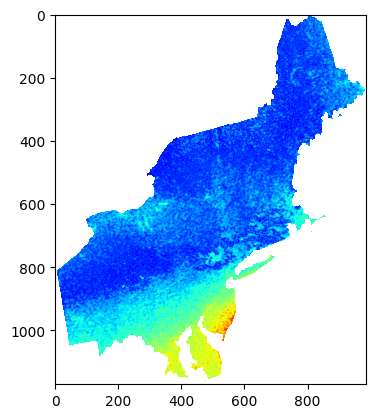

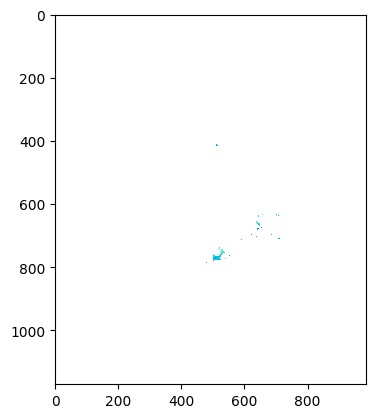

######### 31###############
0.04674358
0.52541184
8.2317514e-05
0.010400349
0.0
0.49


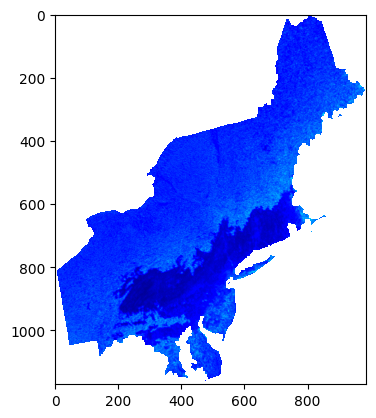

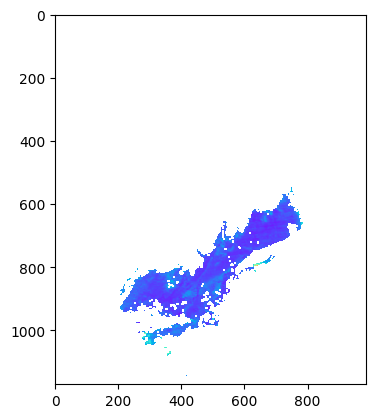

######### 32###############
0.04231152
0.77654666
6.744742e-05
0.022718694
0.0
0.701


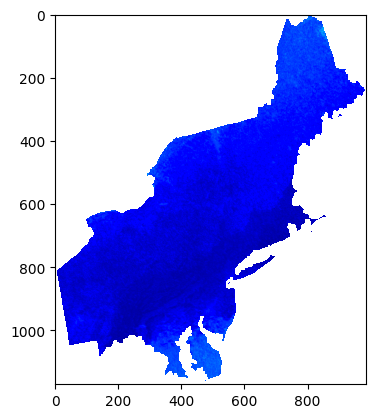

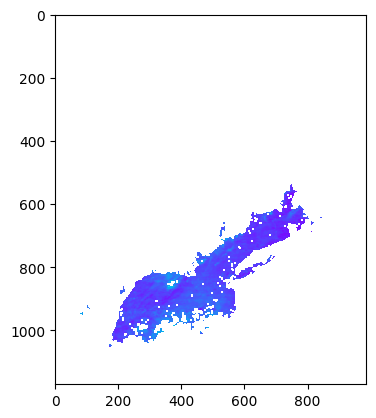

######### 33###############
0.042889066
0.99366736
6.93013e-05
0.03719892
0.0
0.431


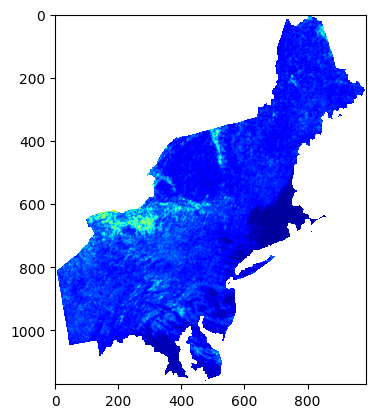

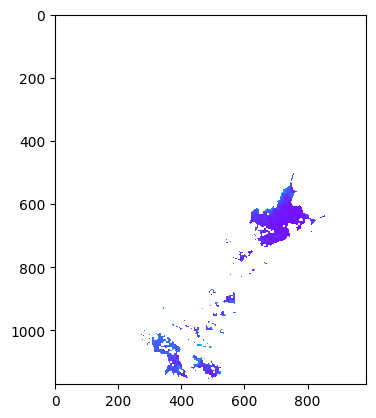

######### 34###############
0.042767465
0.7842453
6.890887e-05
0.023171399
0.0
0.454


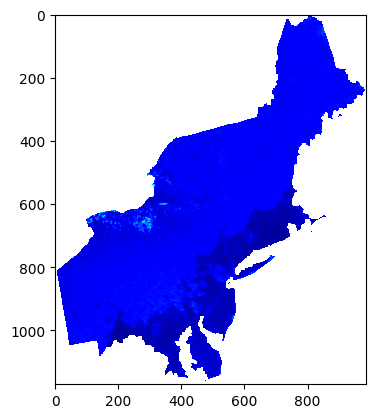

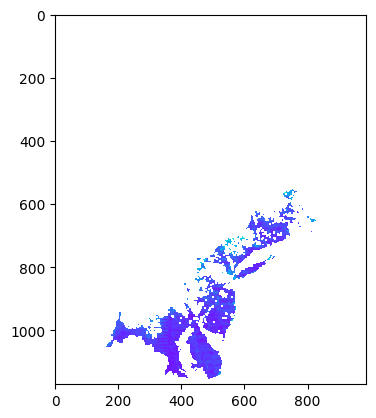

######### 35###############
0.08625386
1.015129
0.00028028857
0.038823146
0.043
0.418


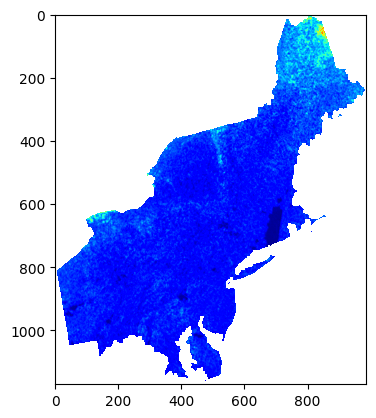

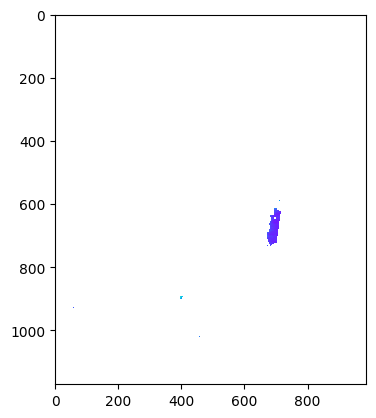

######### 36###############
0.05180227
0.41171145
0.000101098754
0.006386078
0.0
0.427


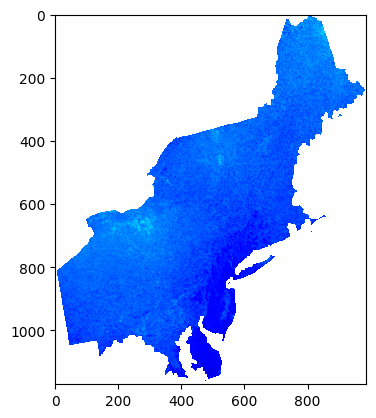

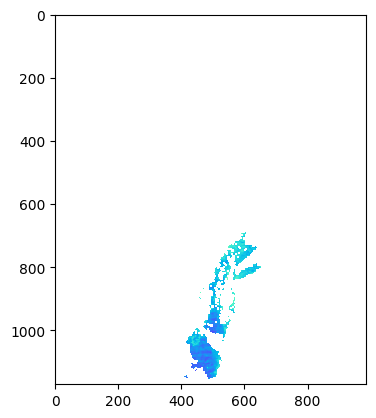

######### 37###############
0.016186848
0.81526136
9.871269e-06
0.025040448
0.0
1.44


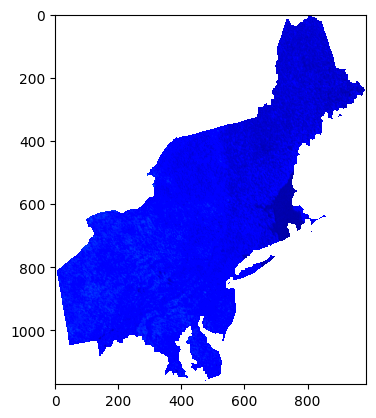

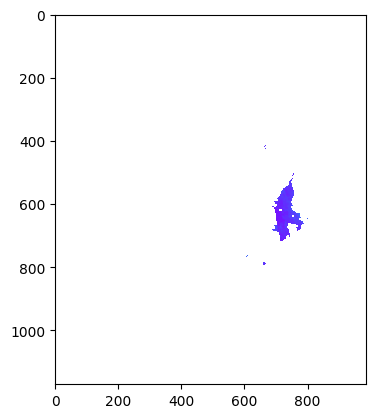

######### 38###############
0.12005845
0.5375407
0.0005430424
0.010886066
0.0
0.411


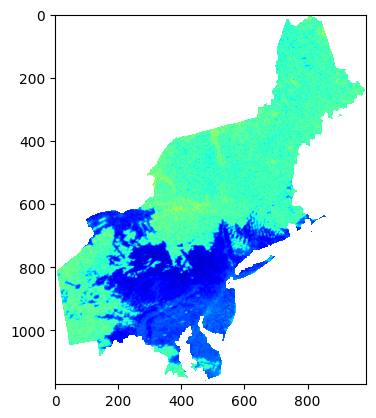

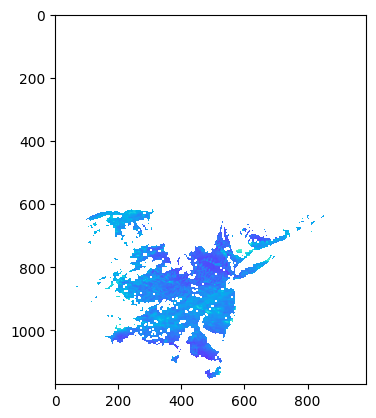

######### 39###############
0.09800865
0.6842394
0.0003618905
0.017638616
0.05
0.42


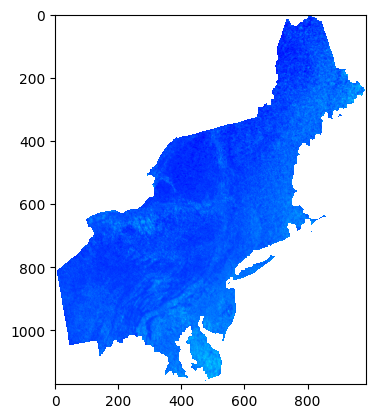

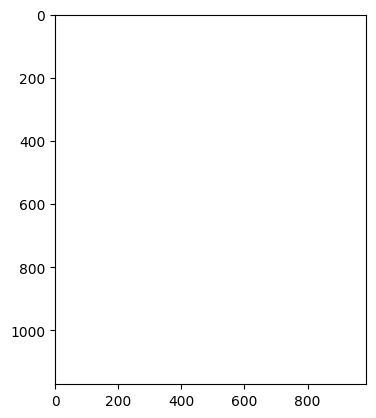

######### 40###############
0.062562466
0.772971
0.00014746061
0.022509959
0.0
0.435


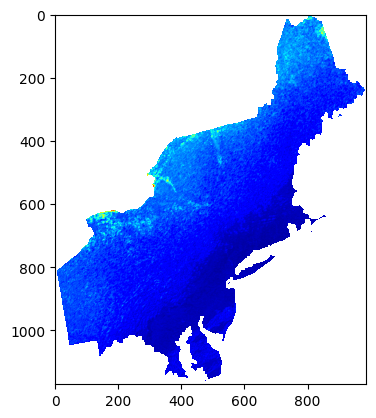

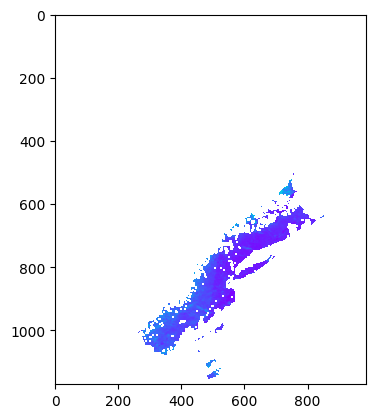

######### 41###############
0.09044188
0.6566503
0.0003081678
0.016244883
0.0
0.422


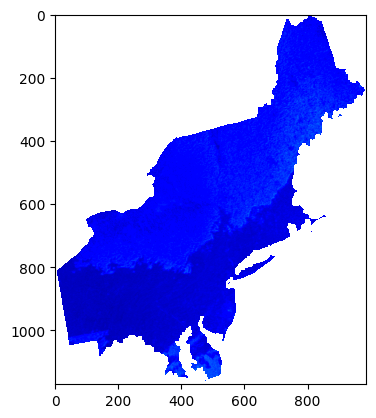

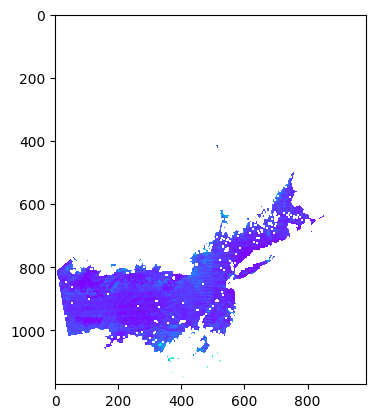

######### 42###############
0.031090677
0.6152967
3.6417383e-05
0.01426322
0.0
0.425


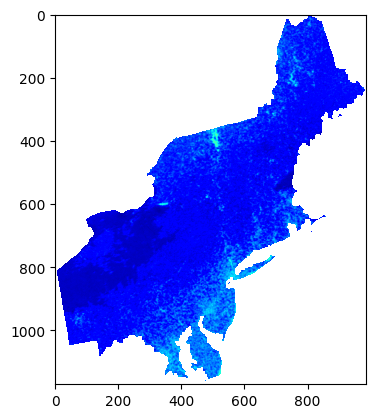

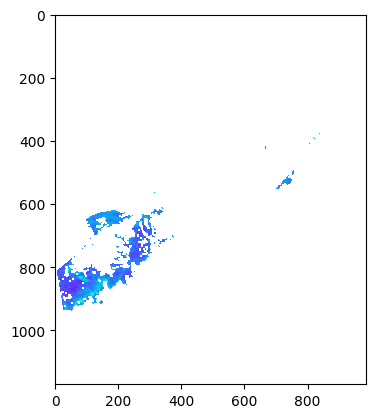

######### 43###############
0.03985256
0.7018527
5.983577e-05
0.018558387
0.0
0.417


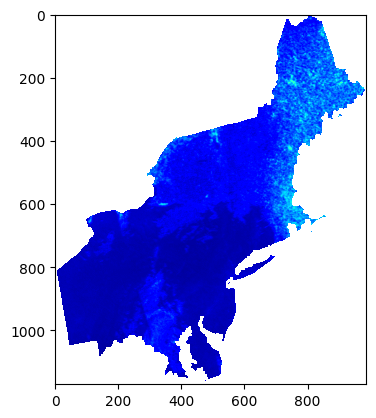

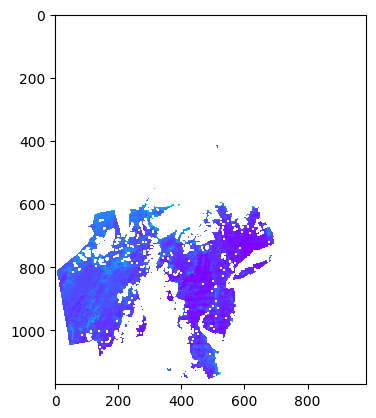

######### 44###############
0.05489306
0.6581814
0.00011352281
0.016320731
0.0
0.538


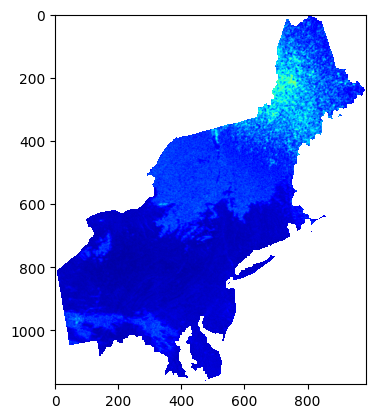

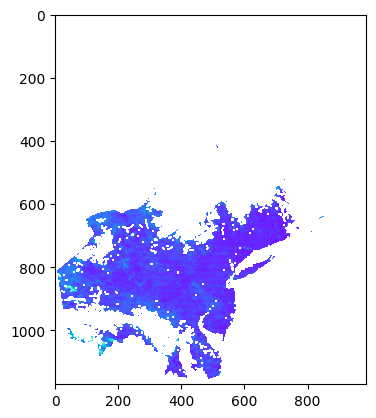

######### 45###############
0.047364056
0.7489139
8.45174e-05
0.021130614
0.0
0.426


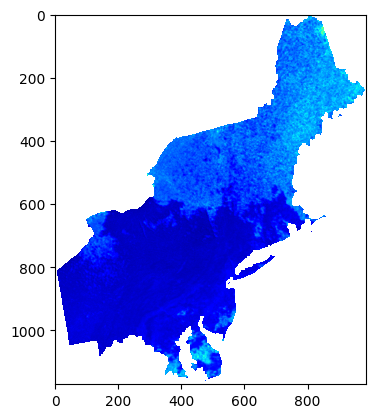

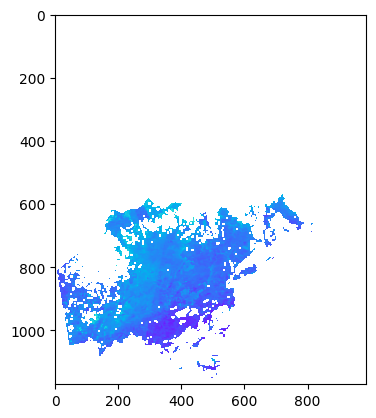

######### 46###############
0.031894624
0.70737314
3.832508e-05
0.018851478
0.014
0.486


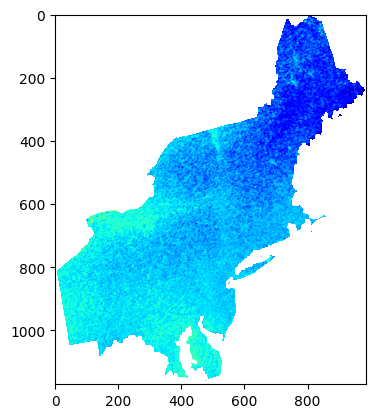

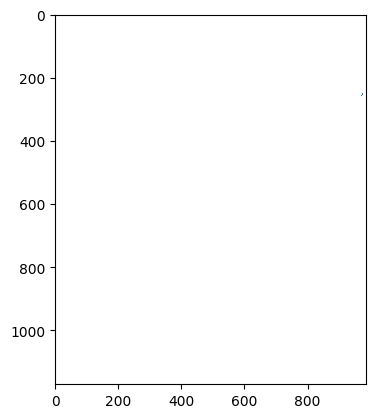

######### 47###############
0.15560399
1.1972288
0.00091219915
0.054001104
0.147
0.387


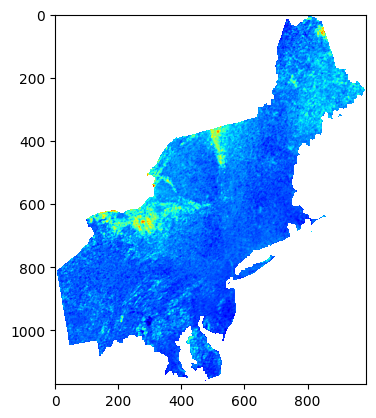

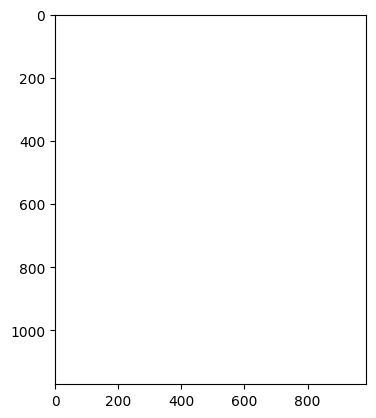

######### 48###############
0.06355891
0.47669792
0.00015219531
0.008561205
0.0
0.429


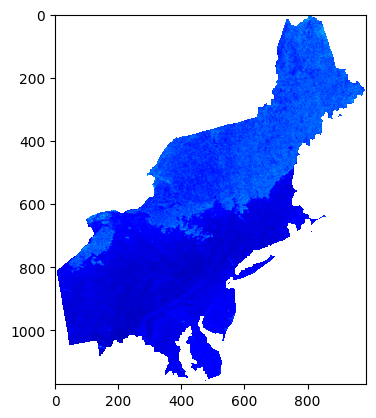

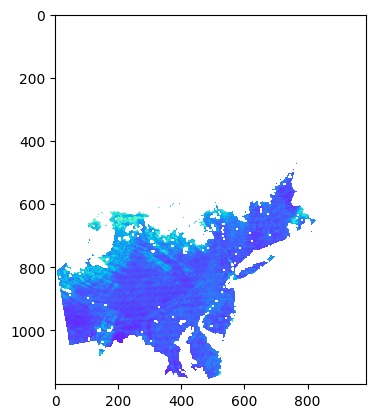

######### 49###############
0.066699386
0.88437045
0.00016760695
0.0294657
0.059
0.356


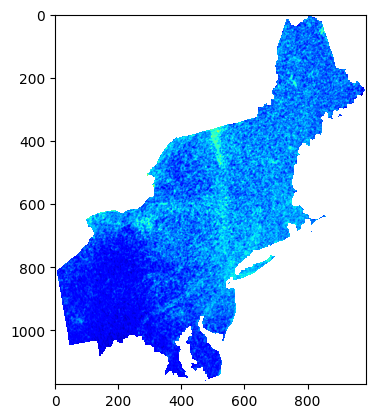

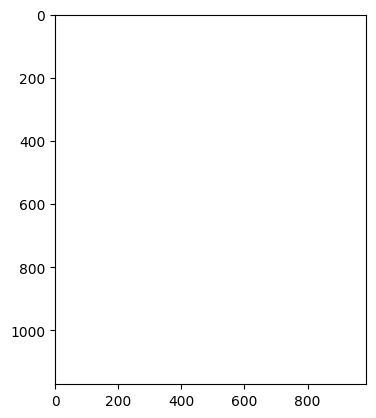

######### 50###############
0.07693043
0.78516865
0.00022296907
0.023225987
0.013
0.437


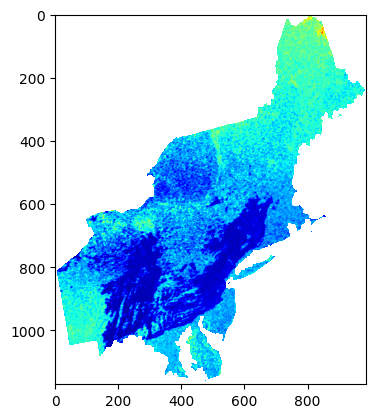

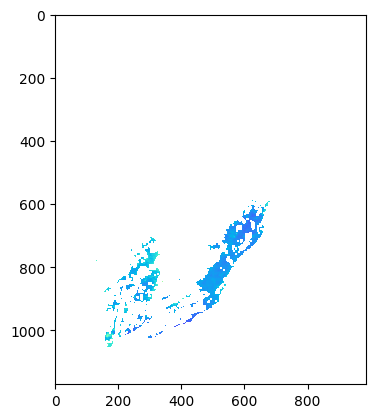

######### 51###############
0.043598317
0.7501584
7.161232e-05
0.021200899
0.0
0.437


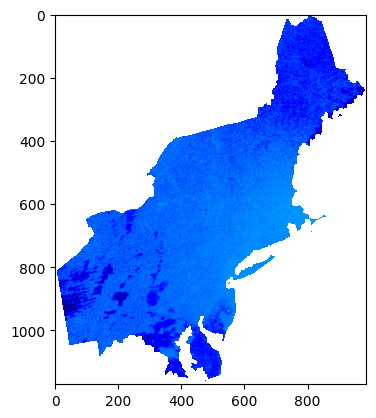

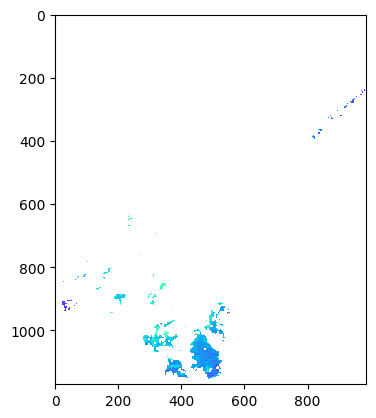

######### 52###############
0.073018186
0.516845
0.00020086777
0.010063961
0.0
0.45


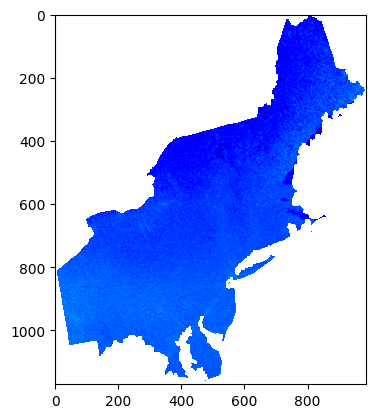

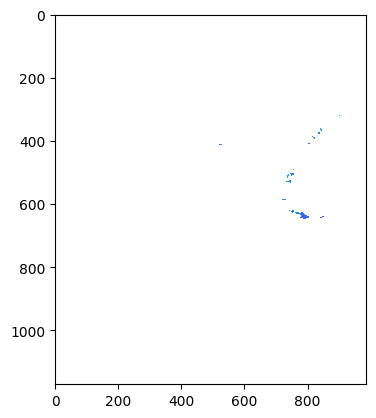

######### 53###############
0.06355554
0.5442234
0.00015217911
0.011158418
0.0
0.429


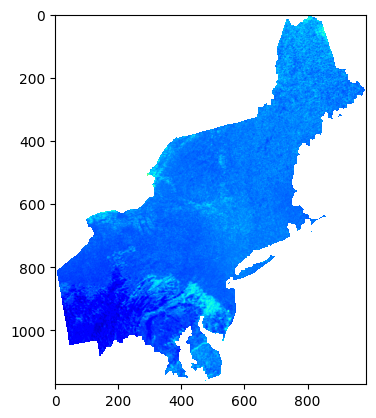

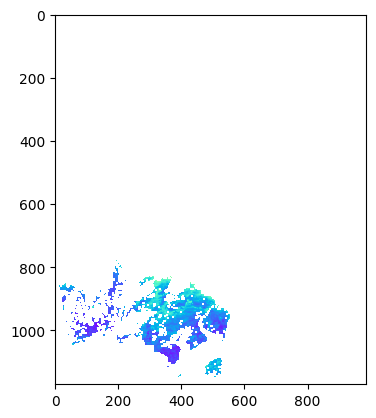

######### 54###############
0.039680764
0.8296933
5.9320977e-05
0.025934841
0.0
0.435


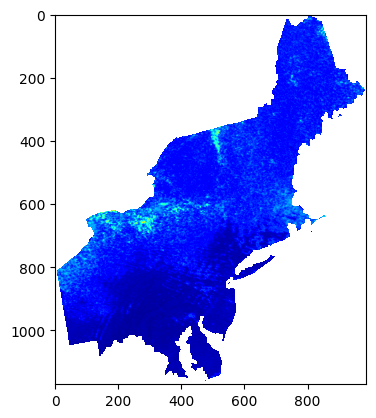

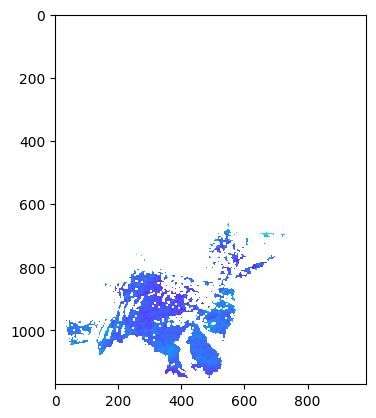

######### 55###############
0.0947949
0.81786096
0.0003385464
0.025200387
0.034
0.387


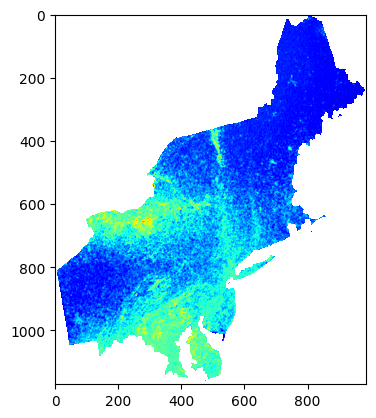

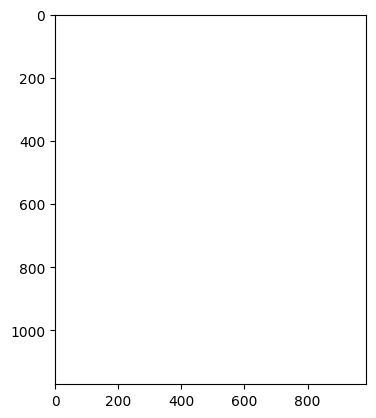

######### 56###############
0.08224574
1.2048596
0.00025484446
0.054691672
0.0
0.438


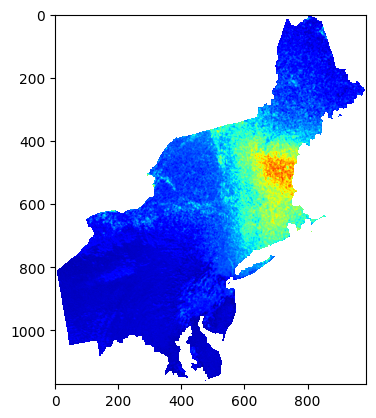

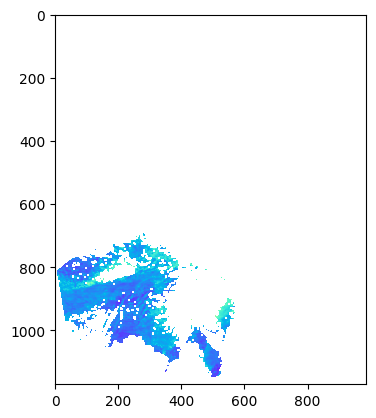

######### 57###############
0.060494483
0.54556537
0.0001378733
0.011213518
0.0
0.542


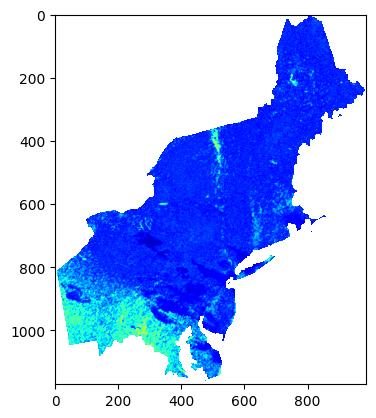

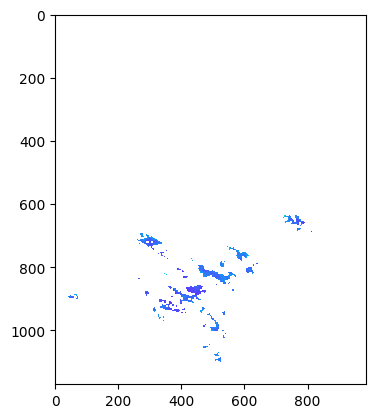

######### 58###############
0.10170621
0.9489022
0.00038971135
0.03392276
0.0
0.437


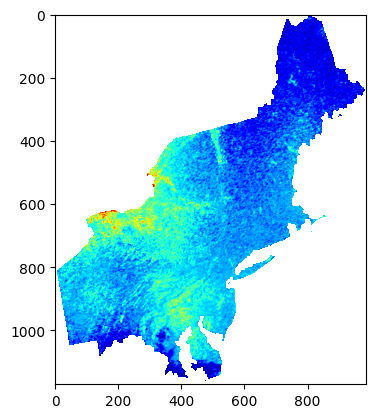

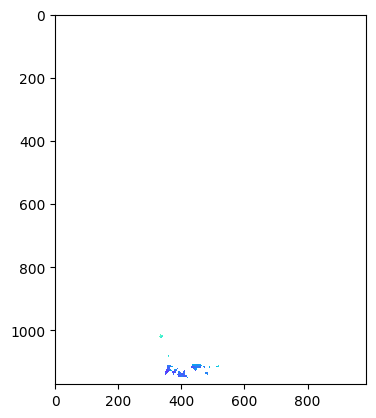

######### 59###############
0.03553553
0.33090773
4.7574453e-05
0.004125363
0.0
0.437


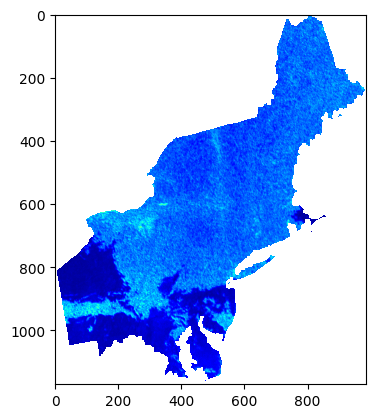

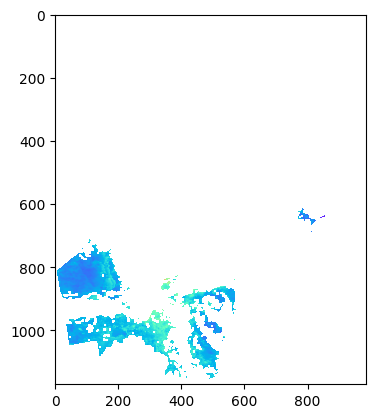

######### 60###############
0.09330475
0.5305819
0.00032798643
0.0106060365
0.0
0.454


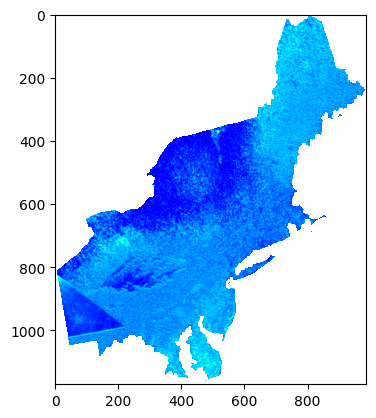

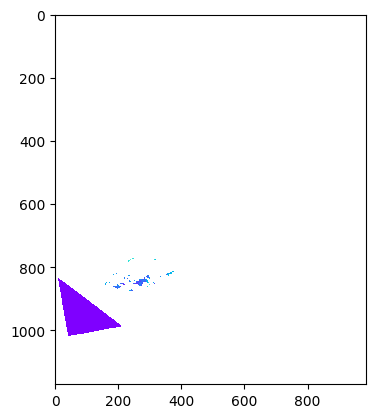

######### 61###############
0.03635279
0.6652578
4.9787894e-05
0.016673561
0.0
0.433


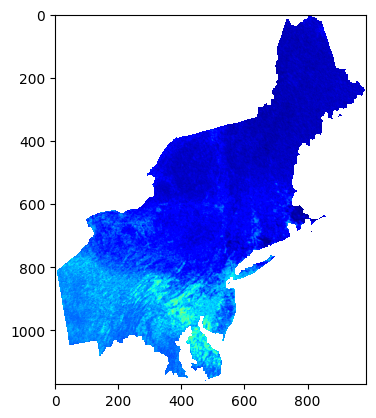

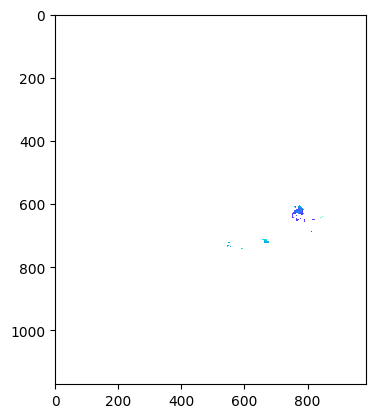

######### 62###############
0.084506825
0.47155082
0.0002690493
0.008377323
0.0
0.434


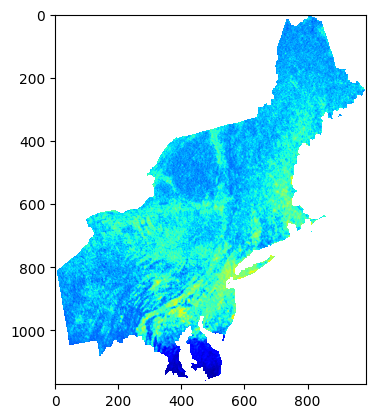

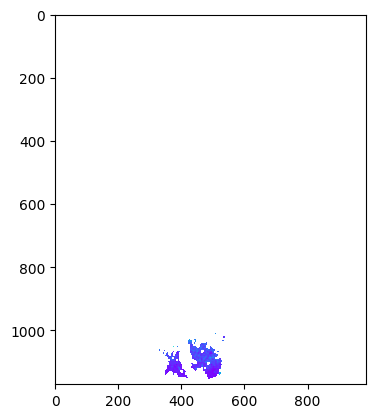

######### 63###############
0.040704653
0.36579168
6.242177e-05
0.005040991
0.0
0.438


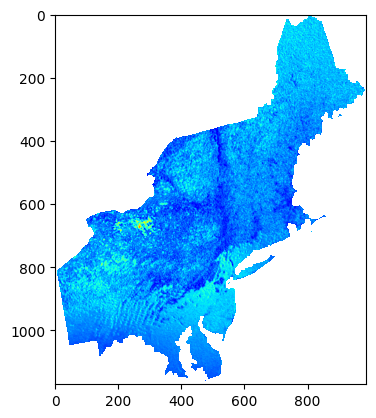

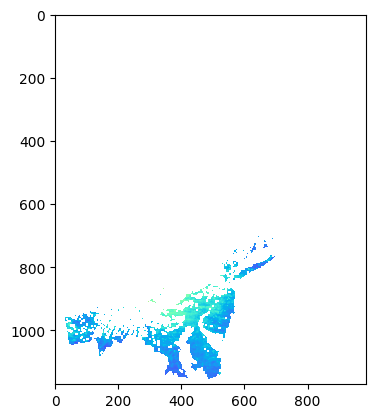

######### 64###############
0.020876693
0.33898342
1.6419948e-05
0.004329176
0.0
0.569


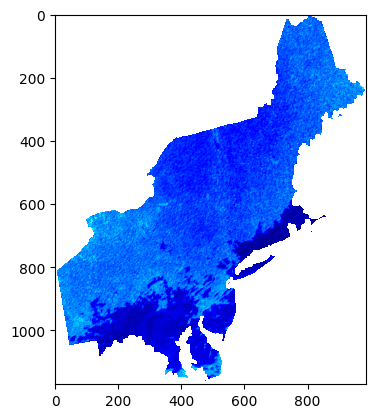

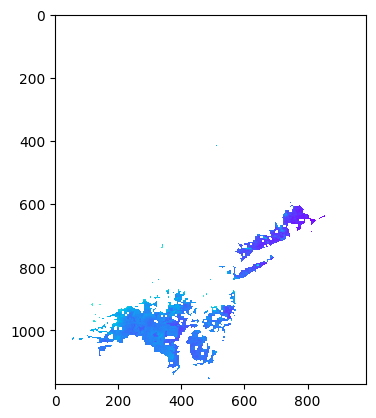

######### 65###############
0.054256767
0.55822235
0.000110906294
0.011739855
0.0
0.437


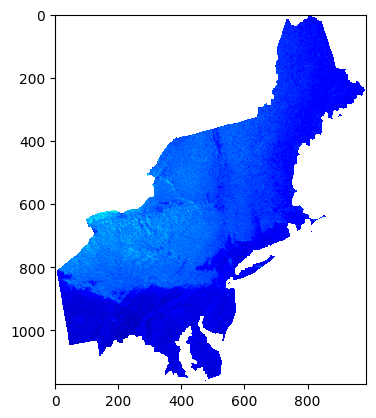

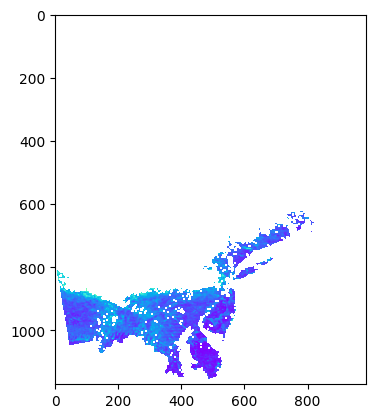

######### 66###############
0.02823542
0.37332684
3.003563e-05
0.0052508162
0.0
0.434


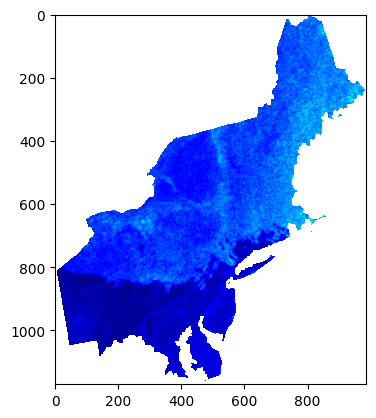

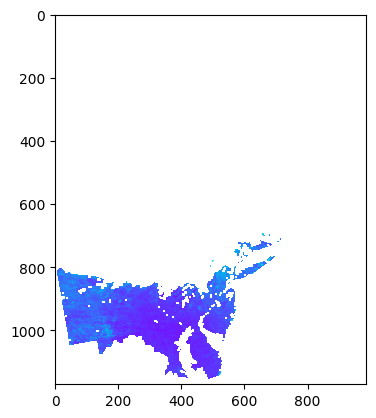

######### 67###############
0.07904163
0.69393545
0.00023537483
0.018142056
0.0
0.436


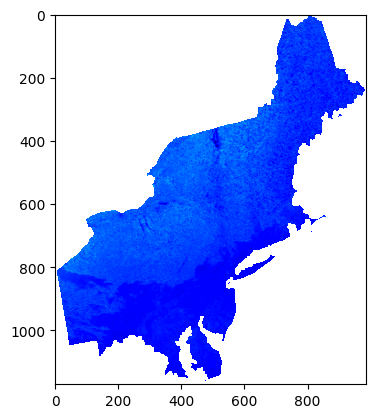

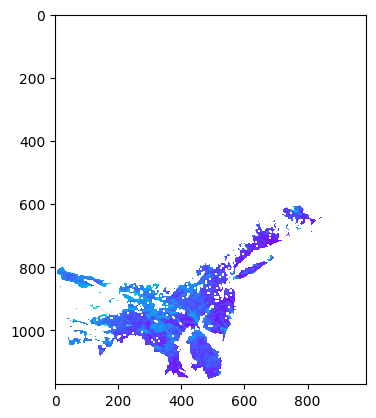

######### 68###############
0.058237646
0.60899425
0.00012777795
0.013972516
0.0
0.422


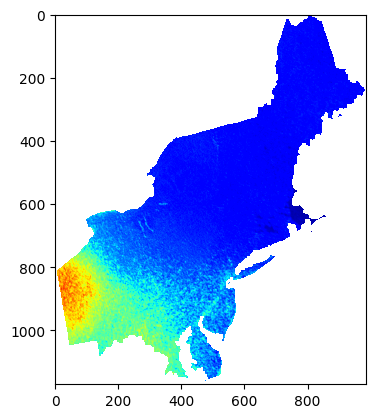

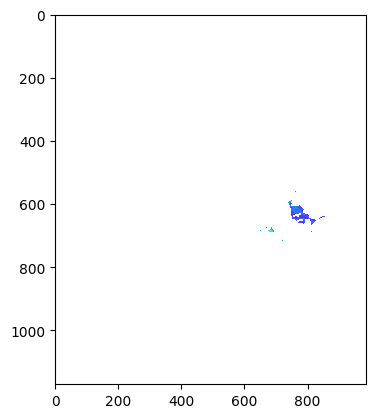

######### 69###############
0.058576554
0.5619004
0.00012926947
0.01189507
0.046
0.437


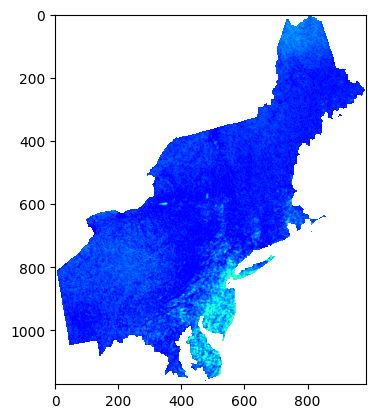

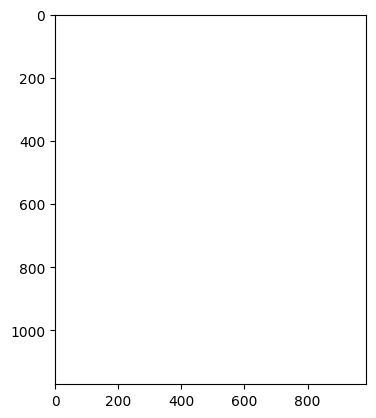

######### 70###############
0.058348063
0.7368375
0.00012826294
0.020454638
0.013
0.431


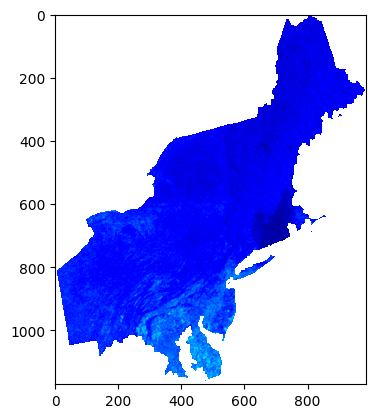

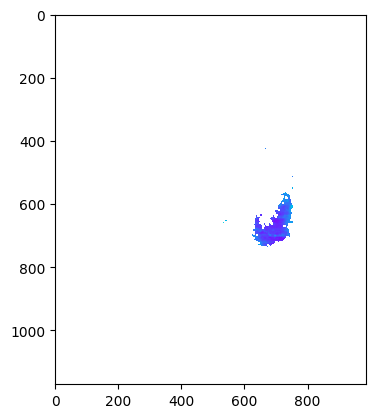

######### 71###############
0.05098024
0.5196121
9.7915625e-05
0.010172008
0.0
0.271


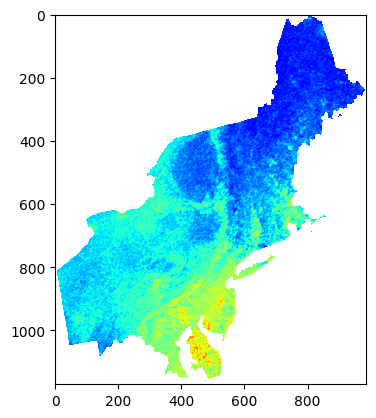

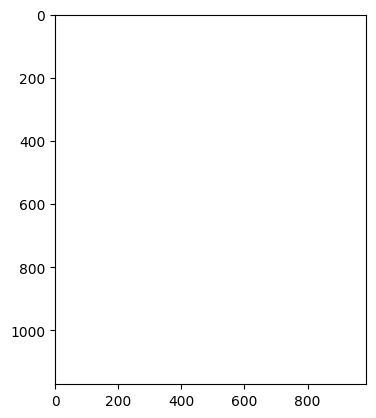

######### 72###############
0.022501528
0.51769495
1.9075354e-05
0.010097089
0.0
0.437


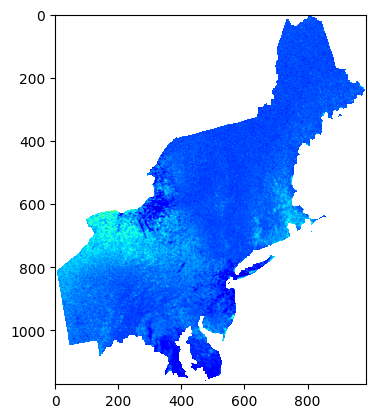

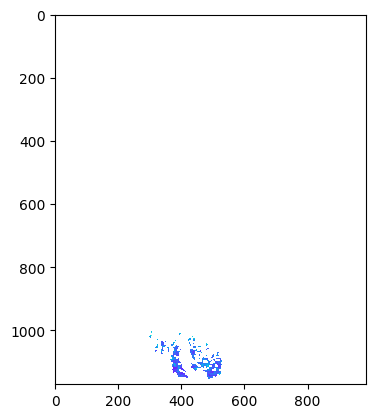

######### 73###############
0.06322825
0.491845
0.00015061583
0.0091139125
0.0
0.438


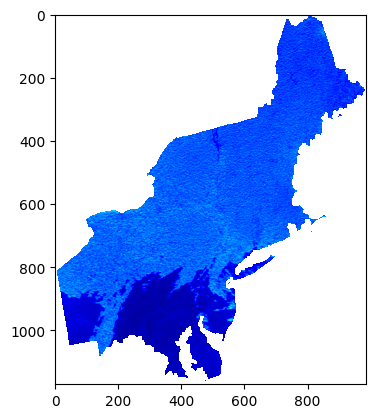

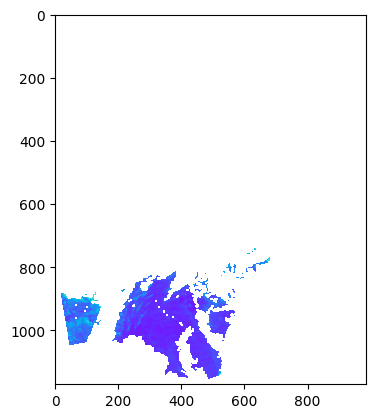

######### 74###############
0.06093914
0.61586916
0.00013990745
0.014289769
0.0
0.431


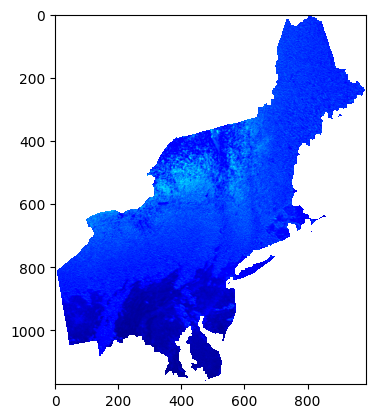

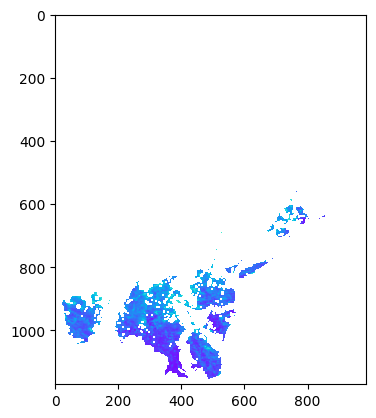

######### 75###############
0.107242525
0.7732005
0.0004332937
0.022523323
0.18
0.3515


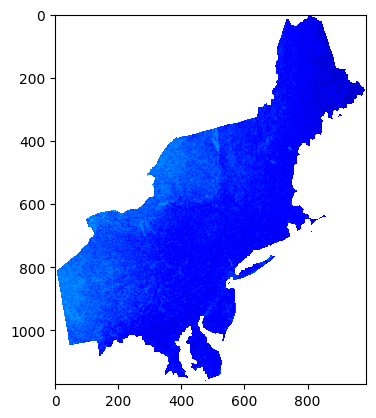

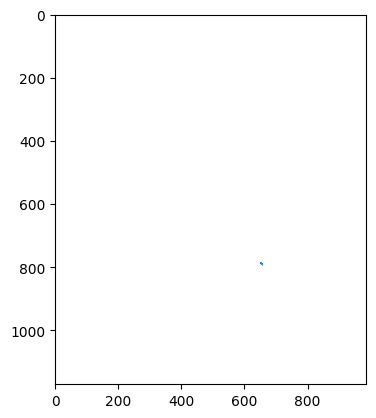

######### 76###############
0.028782308
0.70372957
3.1210373e-05
0.01865778
0.0
0.431


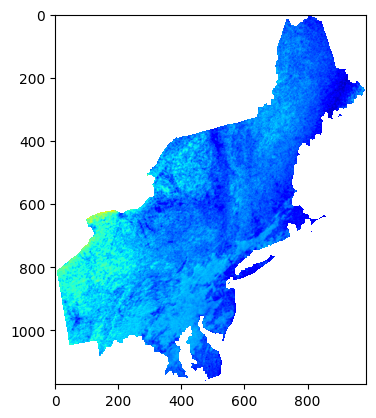

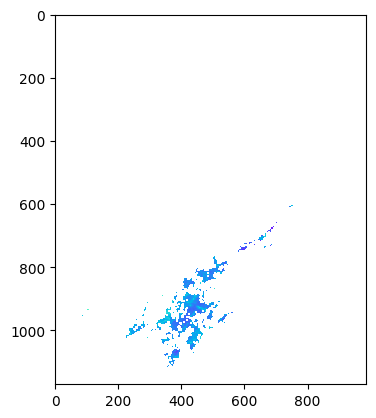

######### 77###############
0.039587226
0.4305442
5.9041653e-05
0.0069836713
0.0
0.43


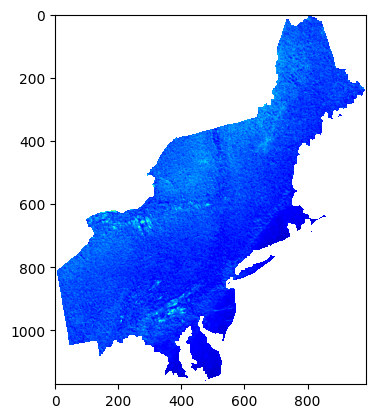

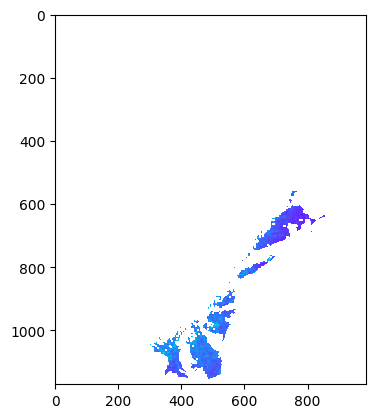

######### 78###############
0.0332932
0.54570305
4.175989e-05
0.011219177
0.0
0.436


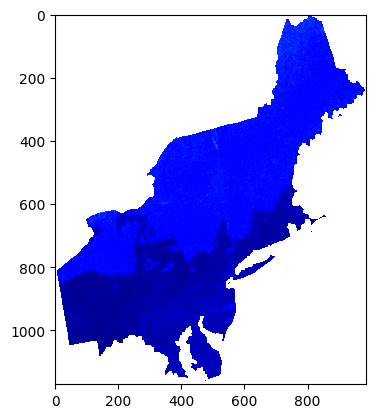

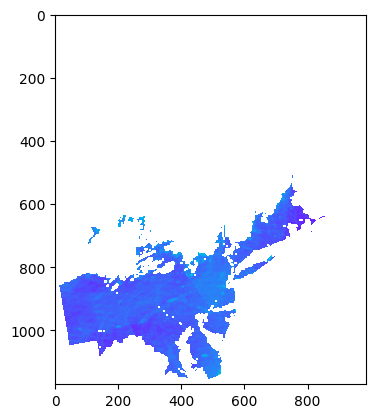

######### 79###############
0.12204346
0.6622039
0.00056114787
0.016520824
0.0
0.45


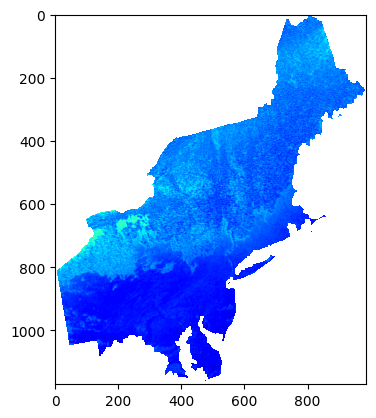

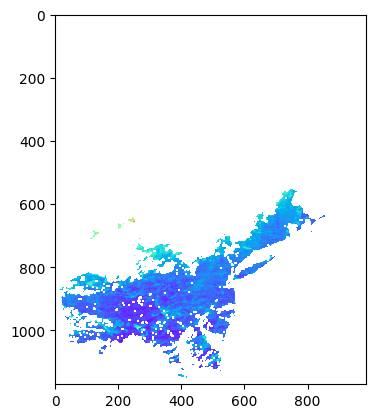

######### 80###############
0.03100927
0.44937754
3.6226913e-05
0.0076080076
0.0
0.733


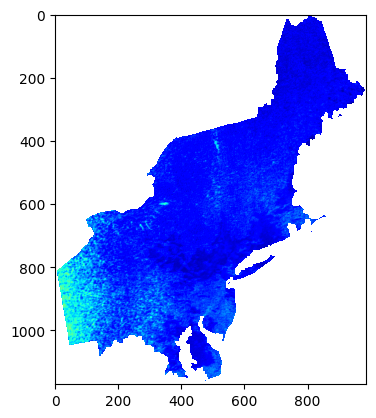

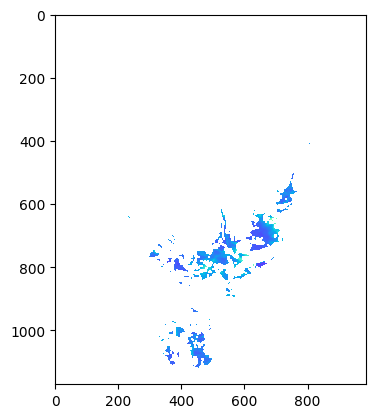

######### 81###############
0.027890265
0.82165265
2.9305753e-05
0.025434595
0.075
0.437


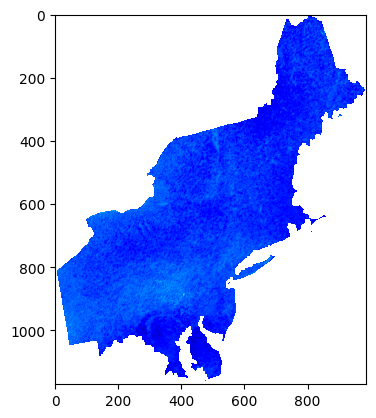

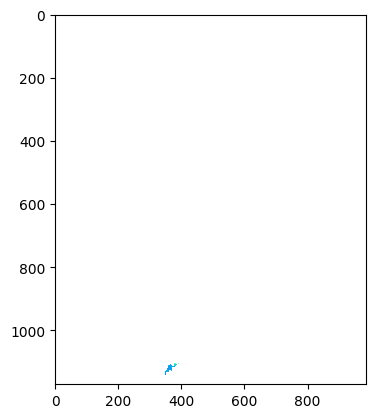

######### 82###############
0.069238305
0.7255031
0.00018060973
0.019830188
0.0
0.432


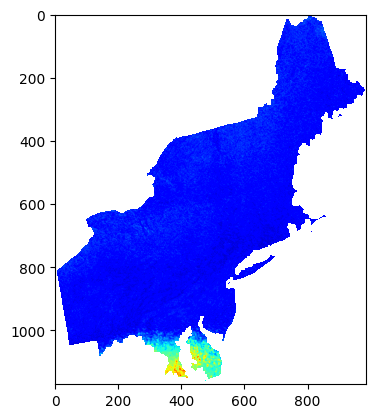

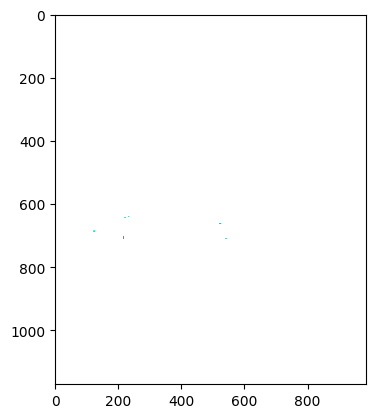

######### 83###############
0.11069542
0.8450383
0.00046164443
0.026903024
0.093
0.431


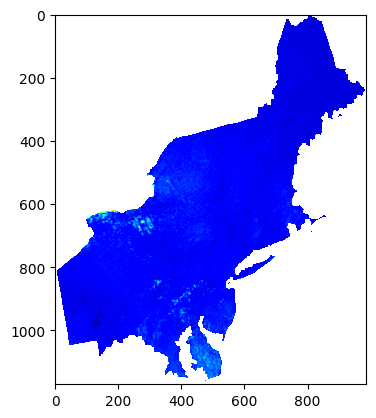

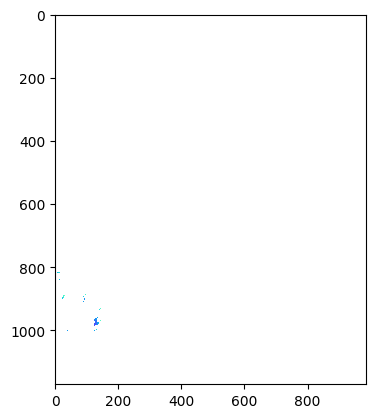

######### 84###############
0.023039665
0.42109698
1.9998643e-05
0.0066805542
0.0
0.442


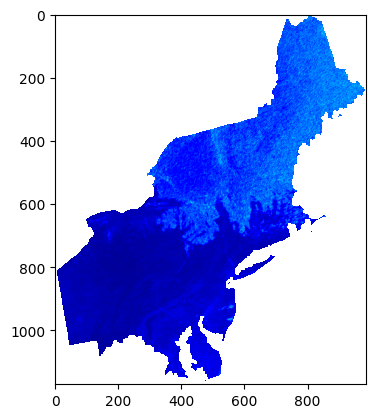

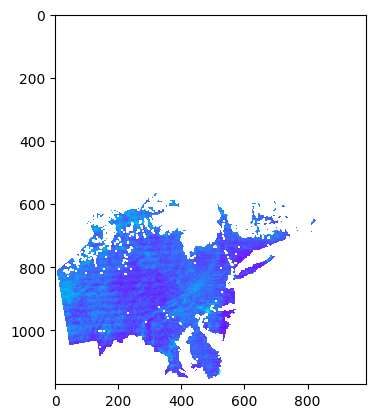

######### 85###############
0.028463155
0.5978445
3.052212e-05
0.013465571
0.0
0.433


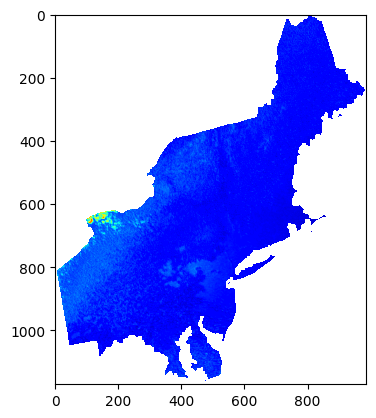

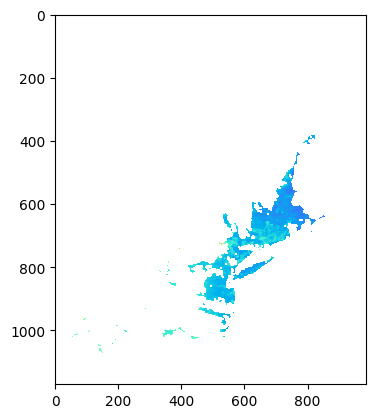

######### 86###############
0.023323774
0.5932409
2.0494945e-05
0.013258991
0.0
0.47


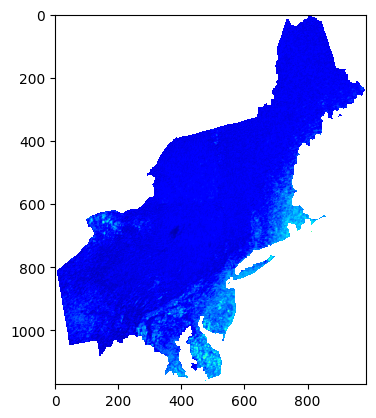

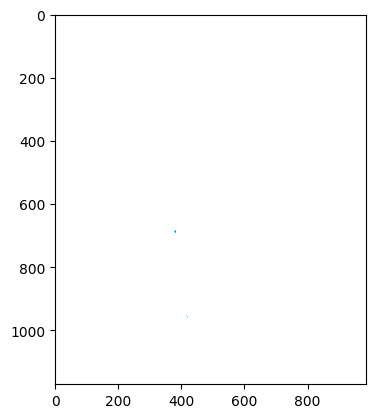

######### 87###############
0.03800364
0.31208682
5.44125e-05
0.003669434
0.0
0.437


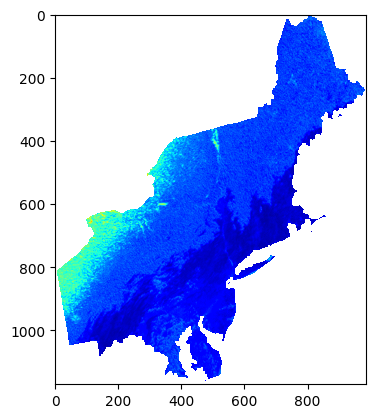

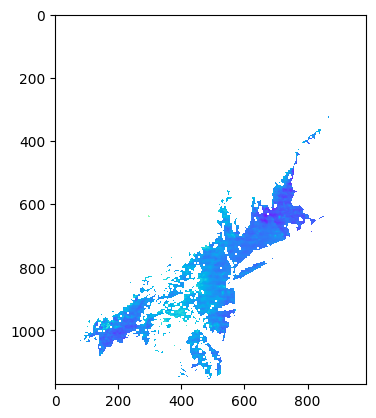

######### 88###############
0.051905878
0.5978083
0.0001015036
0.013463941
0.0
0.8425


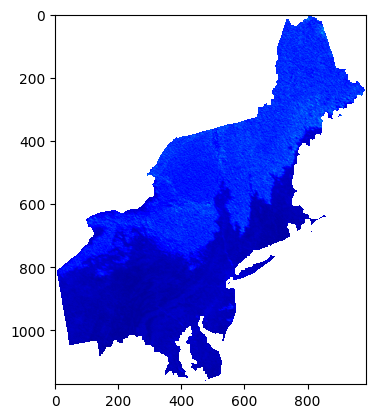

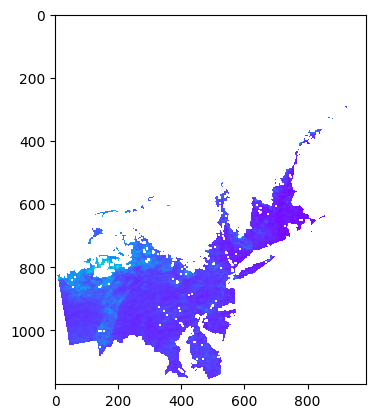

######### 89###############
0.060022175
0.5731226
0.00013572865
0.012374947
0.008
0.457


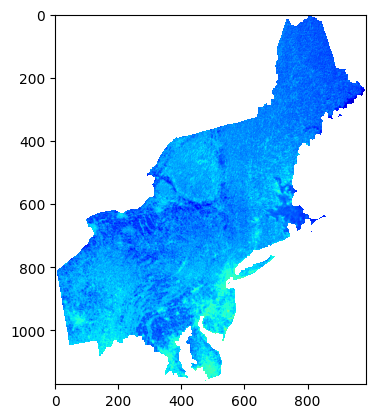

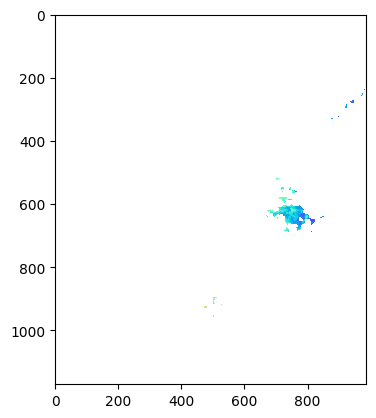

######### 90###############
0.054002255
0.751446
0.00010986822
0.021273741
0.0
0.637


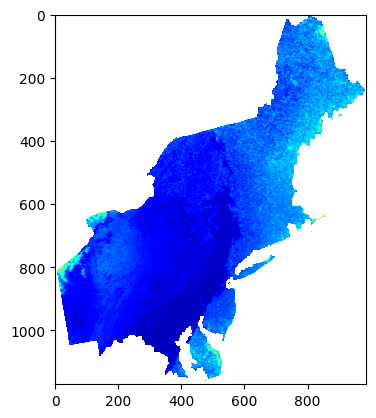

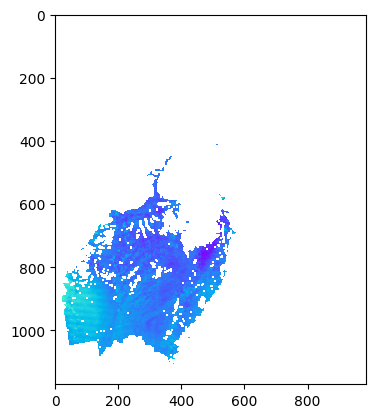

######### 91###############
0.050622225
0.5706214
9.654516e-05
0.01226717
0.0
0.448


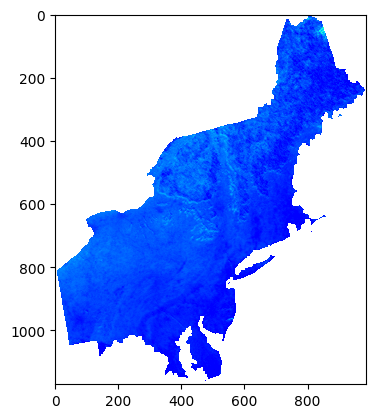

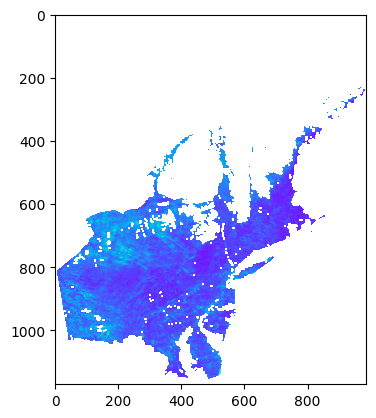

######### 92###############
0.03369558
0.5839864
4.2775362e-05
0.012848539
0.0
2.05


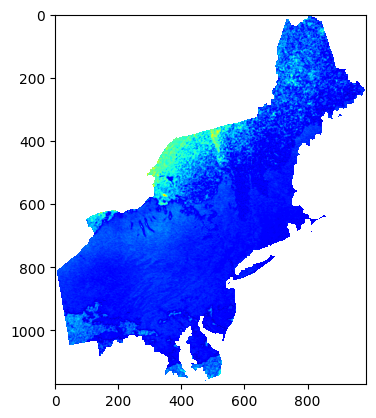

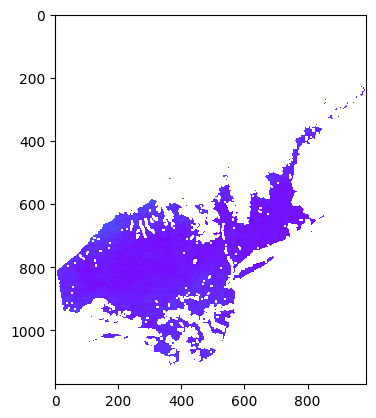

######### 93###############
0.057013214
0.40321517
0.00012246141
0.0061252248
0.0
1.443


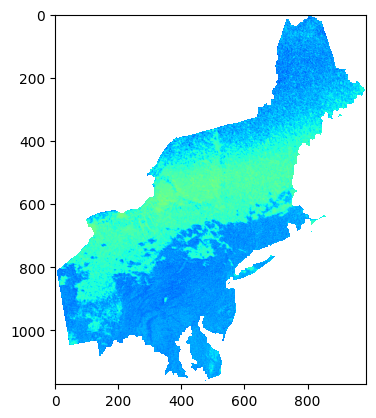

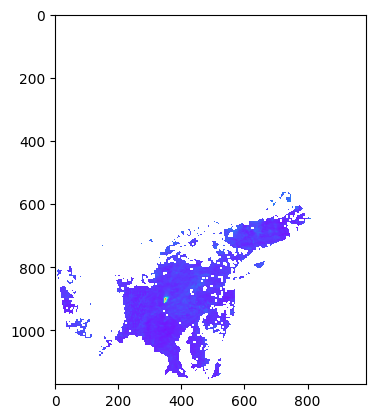

######### 94###############
0.08499372
0.6339184
0.00027215856
0.015139623
0.0
0.687


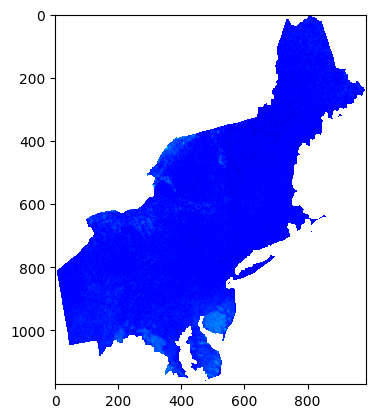

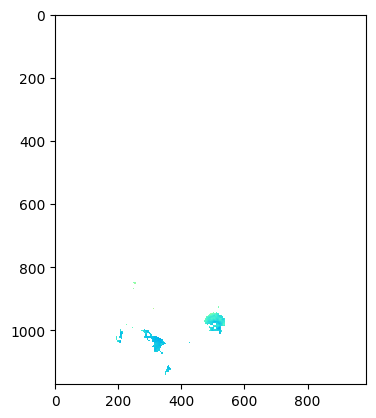

######### 95###############
0.14495724
0.6118164
0.0007916405
0.014102323
0.0
0.777


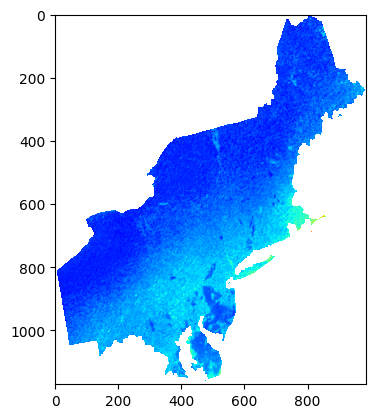

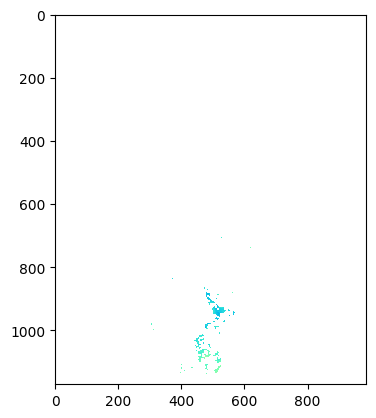

######### 96###############
0.03833458
0.6884873
5.5364326e-05
0.017858304
0.0
0.419


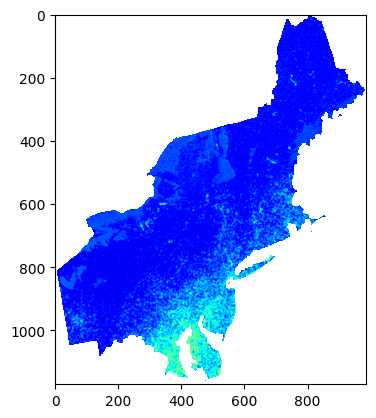

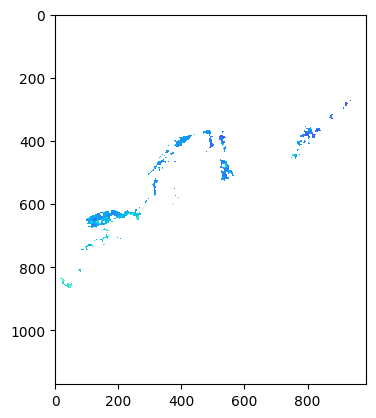

######### 97###############
0.055251803
0.48209602
0.00011501149
0.008756196
0.0
0.93


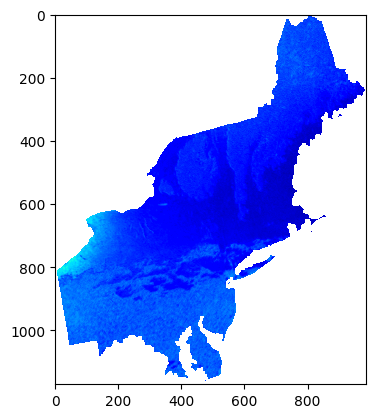

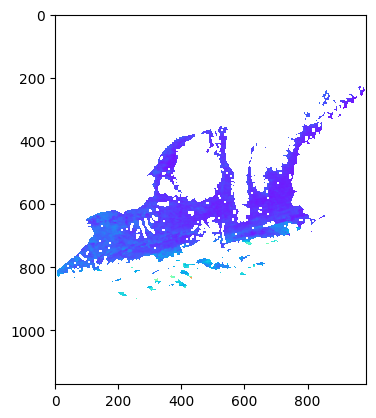

######### 98###############
0.047972925
0.50554127
8.6704335e-05
0.009628565
0.0
0.399


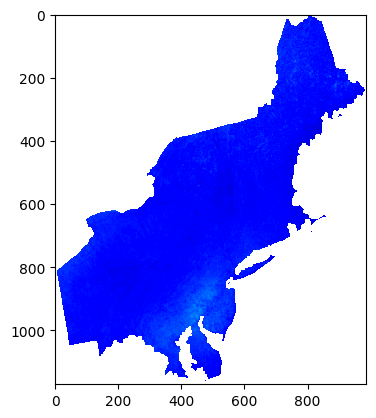

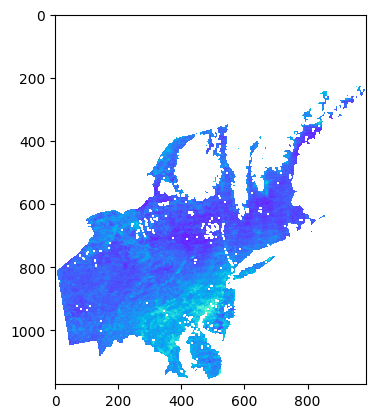

######### 99###############
0.041753665
0.3976953
6.5680644e-05
0.0059586675
0.0
0.541


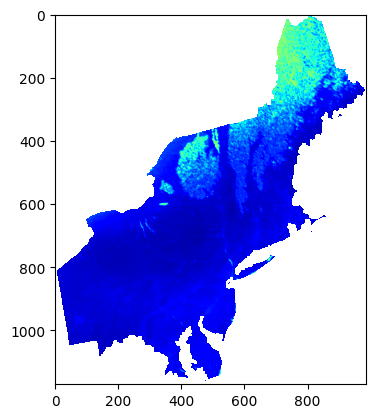

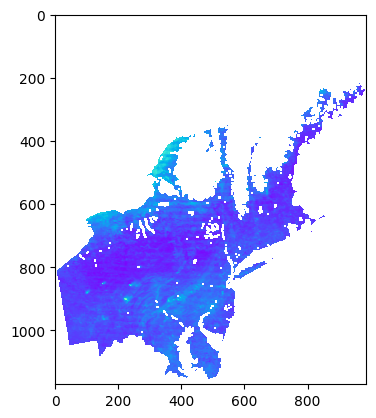

######### 100###############
0.035780817
0.67281246
4.8233494e-05
0.017054396
0.0
0.513


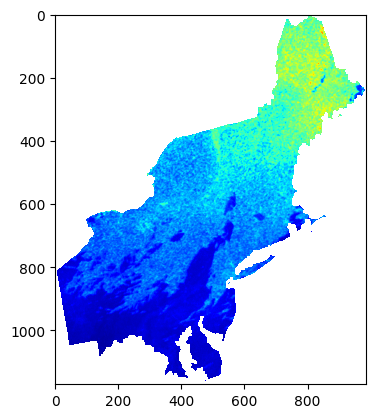

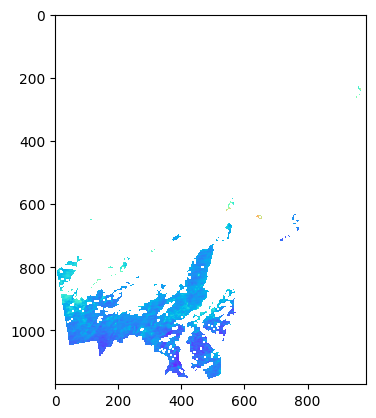

######### 101###############
0.054890215
0.5483469
0.000113511065
0.011328151
0.0
0.43


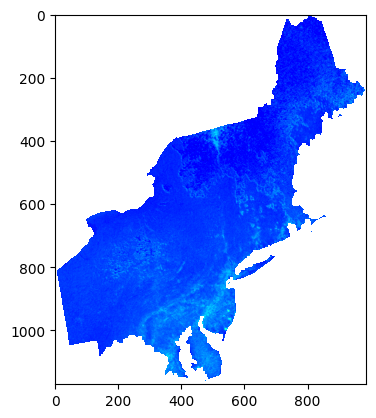

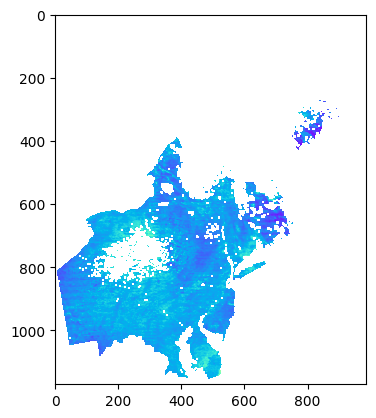

######### 102###############
0.07940997
0.5064919
0.00023757368
0.009664809
0.0
0.423


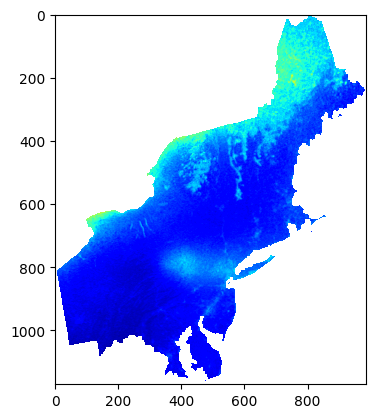

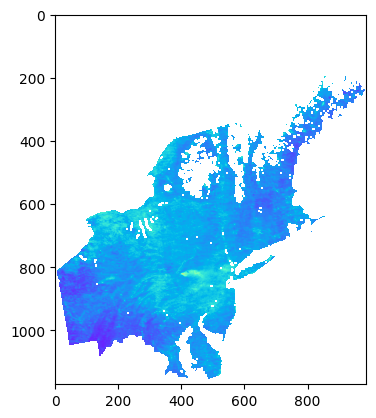

######### 103###############
0.030715078
0.7201516
3.5542802e-05
0.01953872
0.0
0.416


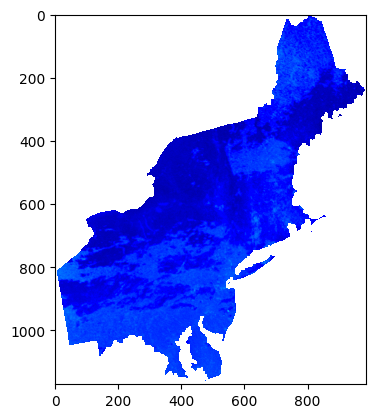

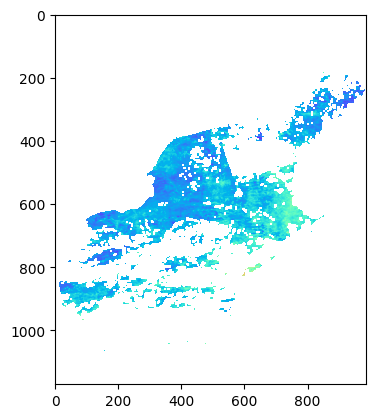

######### 104###############
0.06318125
0.6679656
0.00015039199
0.016809564
0.0
2.211


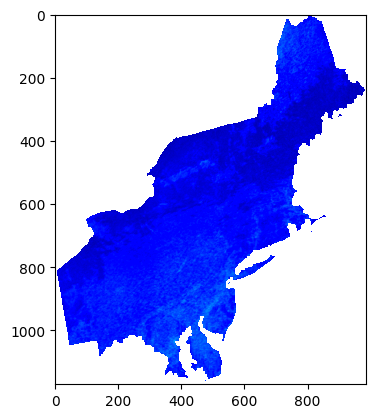

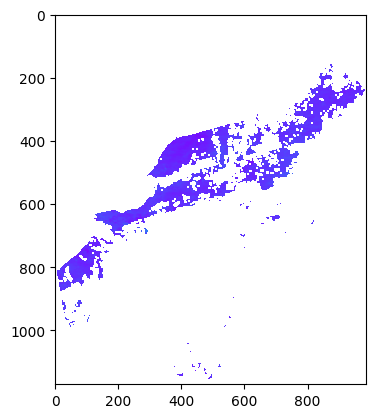

######### 105###############
0.05582513
0.54708815
0.00011741072
0.011276204
0.0
1.961


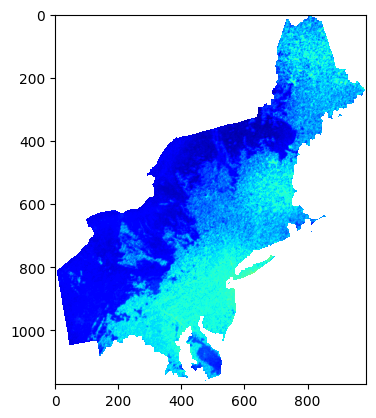

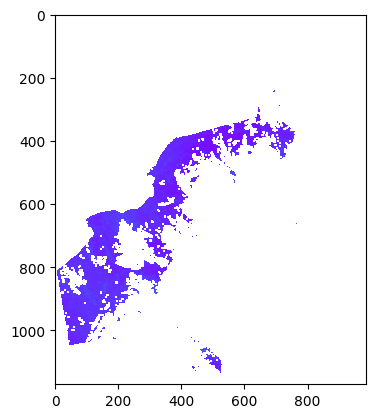

######### 106###############
0.13496554
0.70649207
0.0006862687
0.018804546
0.0
0.437


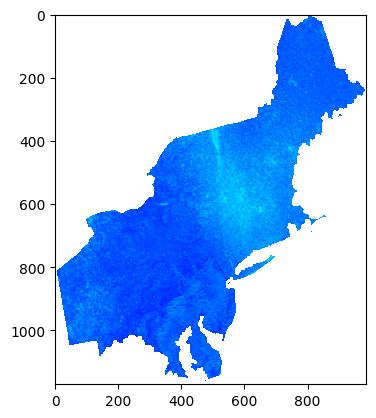

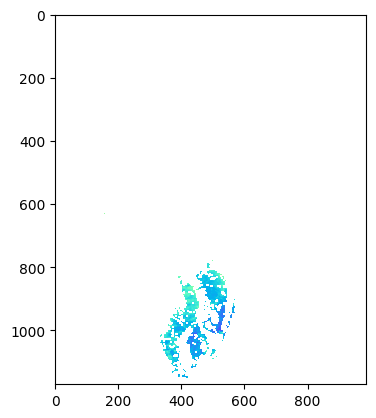

######### 107###############
0.022175044
0.68312216
1.8525827e-05
0.017581057
0.0
0.437


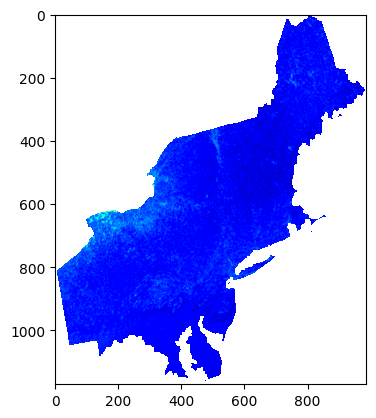

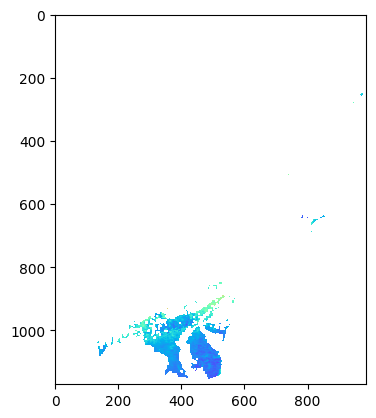

######### 108###############
0.05350882
0.56047666
0.00010786955
0.011834865
0.0
0.437


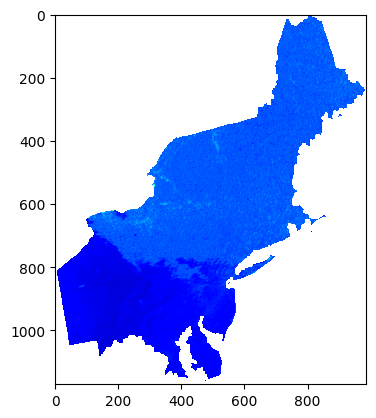

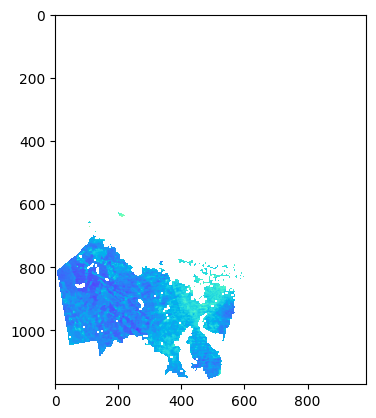

######### 109###############
0.04186763
0.49507394
6.603968e-05
0.00923397
0.0
0.425


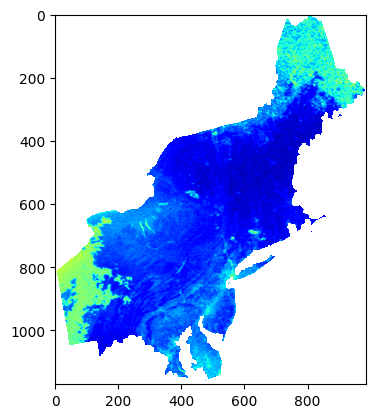

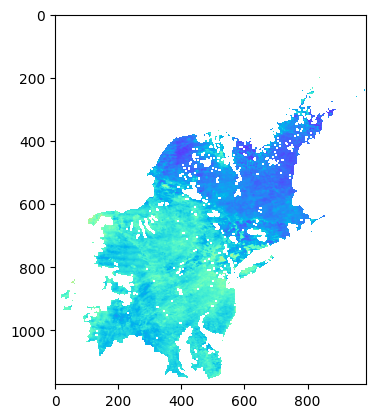

######### 110###############
0.05745314
0.45141947
0.0001243586
0.0076773055
0.0
0.449


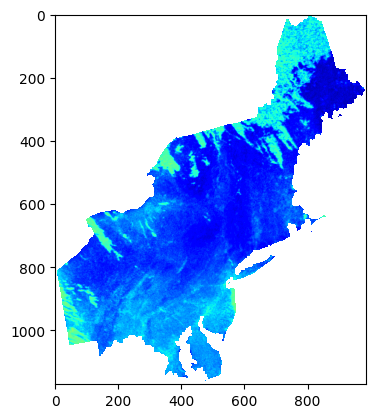

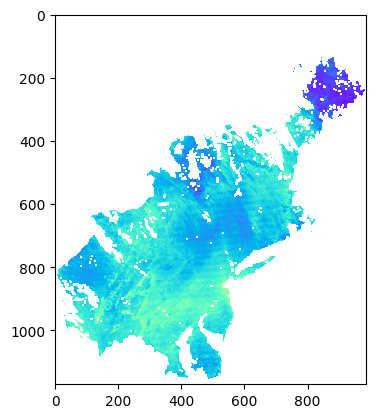

######### 111###############
0.048636407
1.0127254
8.9119174e-05
0.038639504
0.046
0.657


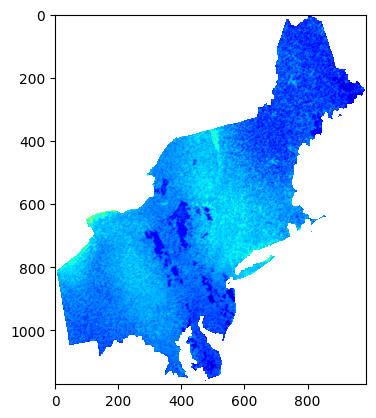

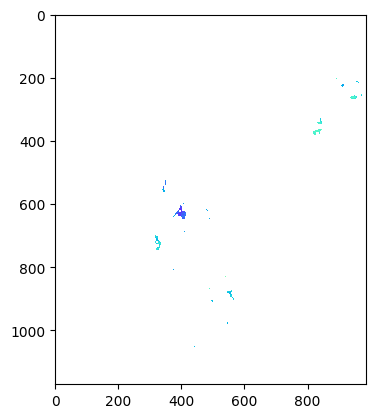

######### 112###############
0.060253322
0.58744955
0.00013677603
0.01300138
0.0
0.62


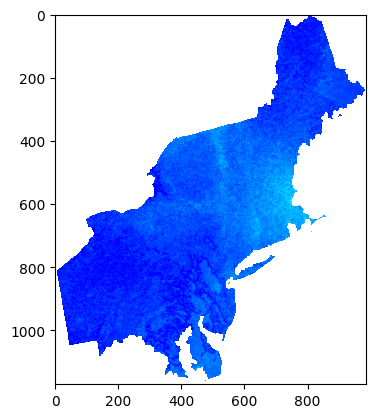

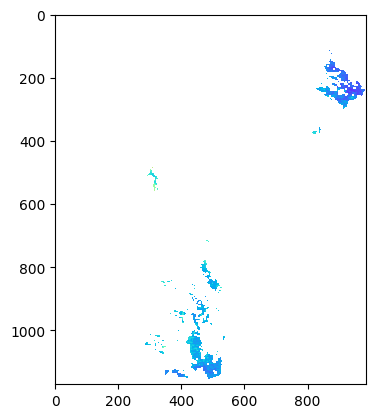

######### 113###############
0.06548541
0.5987743
0.00016156127
0.013507488
0.0
0.471


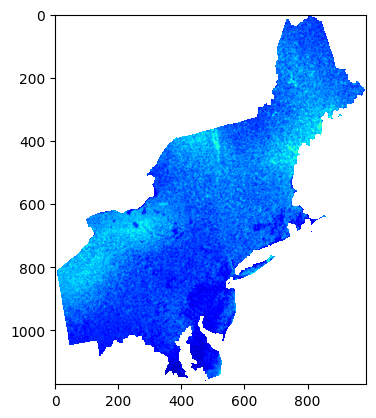

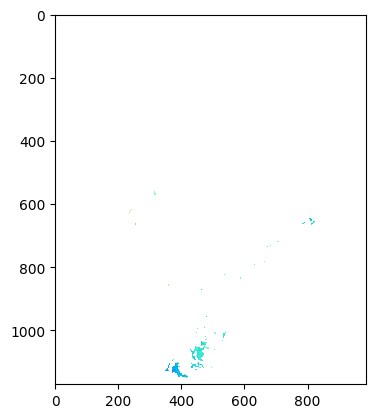

######### 114###############
0.057729155
0.54968
0.00012555634
0.0113833
0.0
0.709


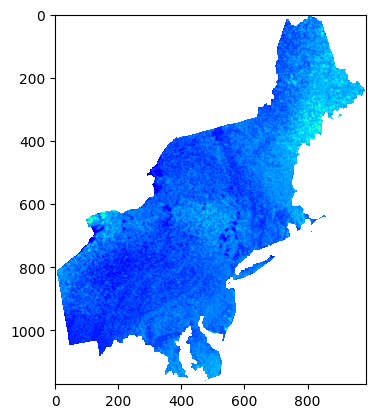

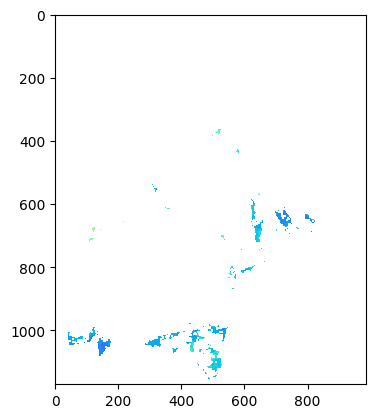

######### 115###############
0.030880809
0.8553788
3.5927398e-05
0.027565459
0.0
0.573


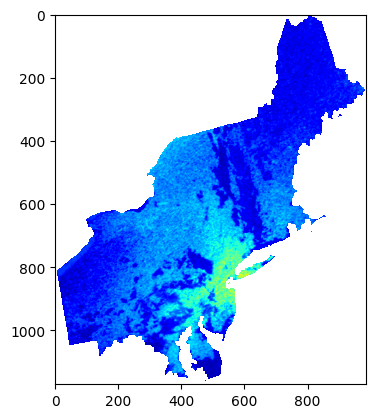

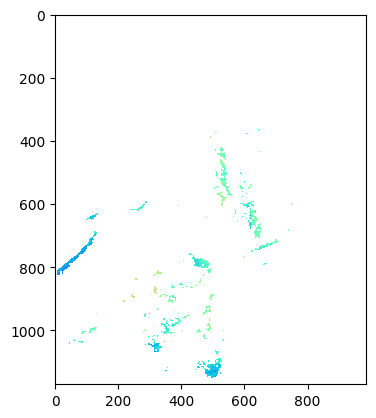

######### 116###############
0.07995735
0.66117156
0.00024086024
0.016469358
0.0
1.651


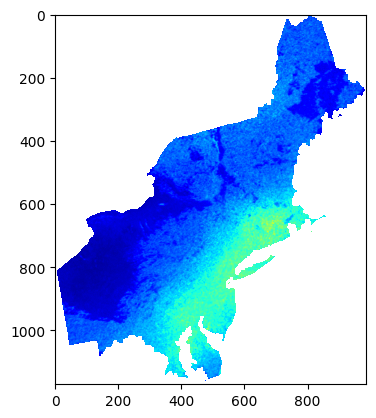

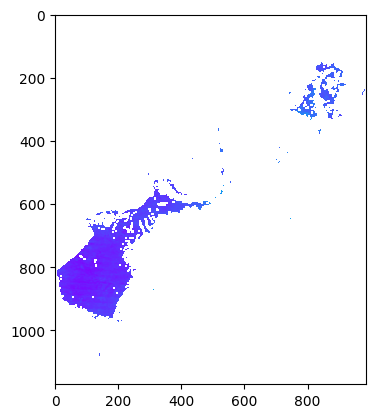

######### 117###############
0.10192448
0.48223284
0.00039138607
0.008761167
0.0
0.437


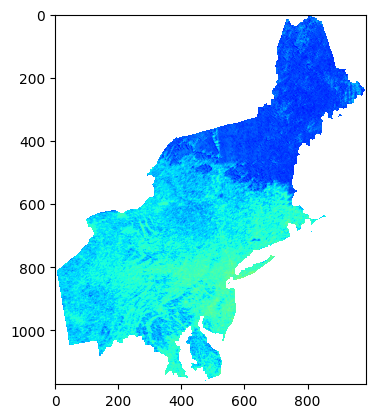

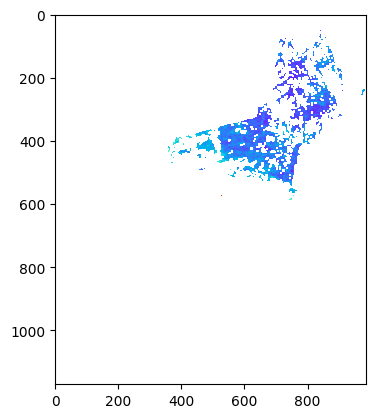

######### 118###############
0.14912888
0.8058369
0.000837861
0.02446485
0.0
0.435


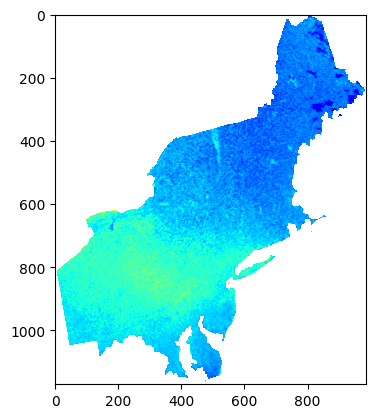

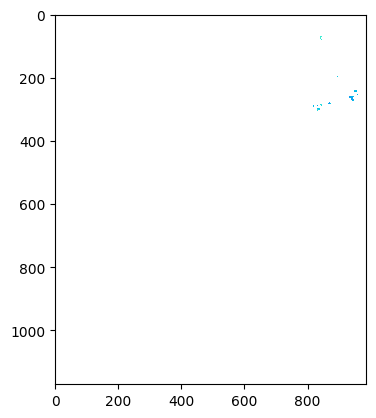

######### 119###############
0.11996561
0.6794462
0.0005422029
0.017392358
nan
nan


/tmp/ipykernel_28761/3154667228.py:13: RuntimeWarning: All-NaN slice encountered
  print(np.nanmin(actual_infer_aod[idx, 0, :]))
/tmp/ipykernel_28761/3154667228.py:14: RuntimeWarning: All-NaN slice encountered
  print(np.nanmax(actual_infer_aod[idx, 0, :]))


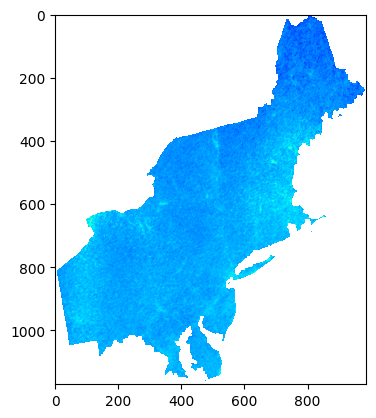

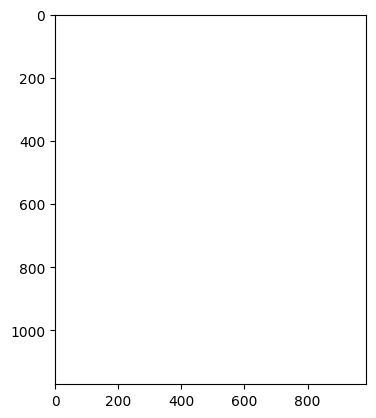

######### 120###############
0.049314737
0.5249474
9.162243e-05
0.010381972
0.0
0.454


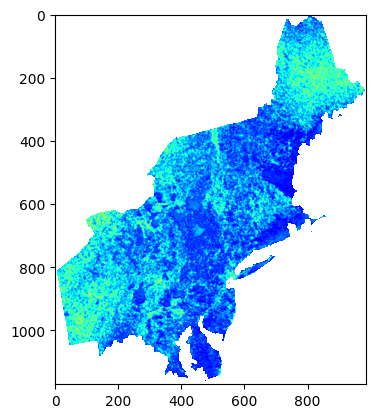

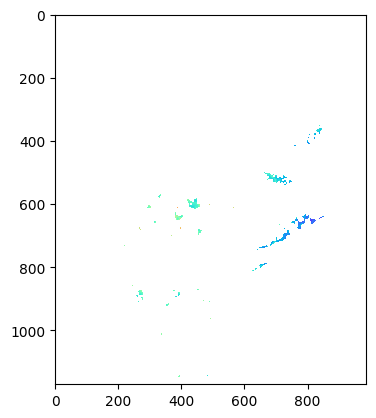

######### 121###############
0.056247234
1.7524178
0.000119192875
0.11569743
0.0
5.159


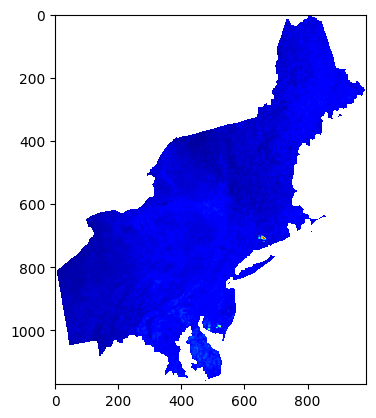

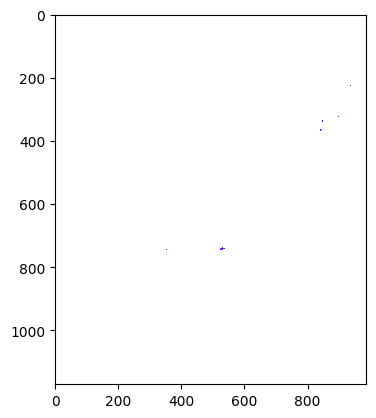

######### 122###############
0.07613701
0.7422683
0.0002183937
0.02075727
0.0
0.436


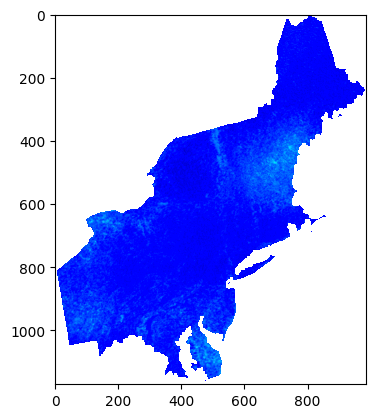

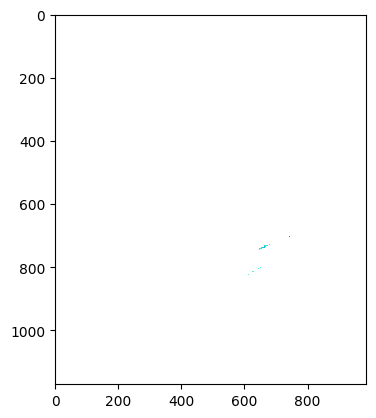

######### 123###############
0.054012775
0.64477587
0.00010991101
0.015662672
0.0
0.438


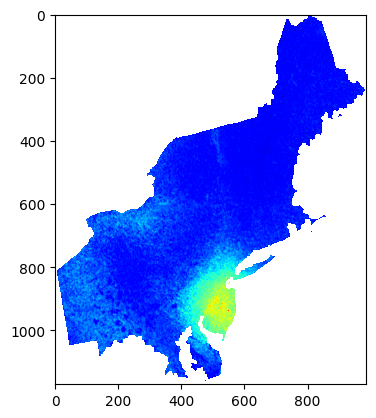

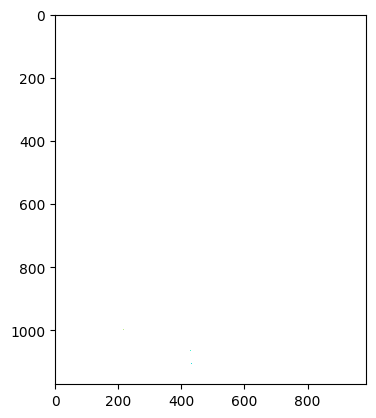

######### 124###############
0.03420347
0.48263192
4.4074557e-05
0.008775671
0.0
0.438


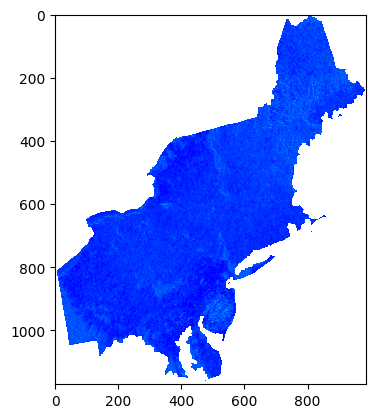

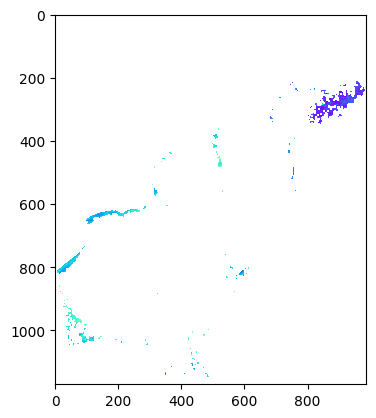

######### 125###############
0.044383626
0.58048487
7.421535e-05
0.012694925
0.0
2.065


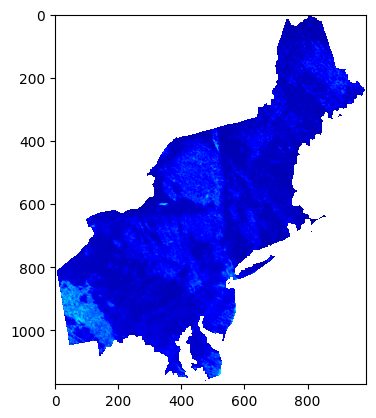

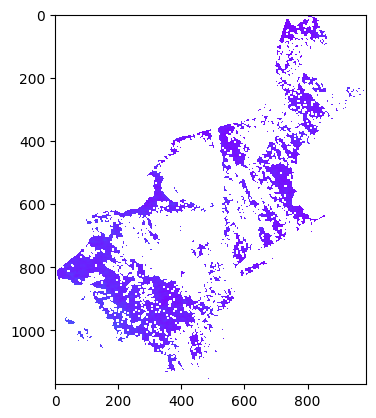

######### 126###############
0.03627847
0.5259079
4.9584534e-05
0.010419998
0.0
0.398


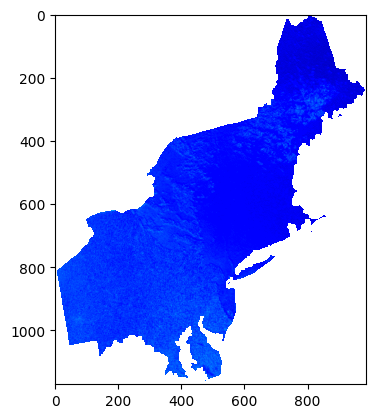

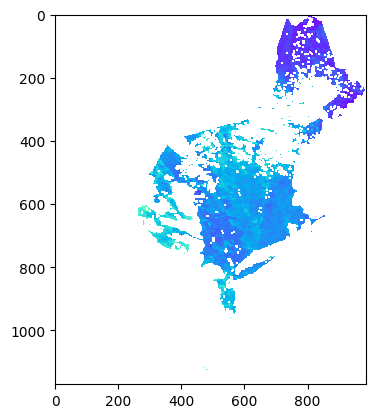

######### 127###############
0.036168307
1.3314989
4.9283837e-05
0.06679283
0.0
1.395


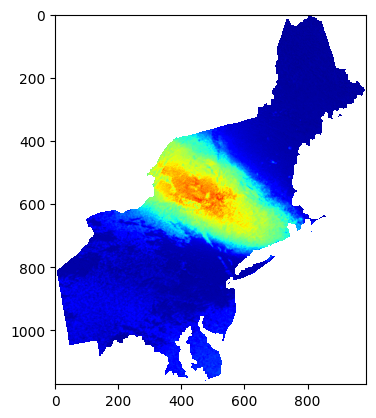

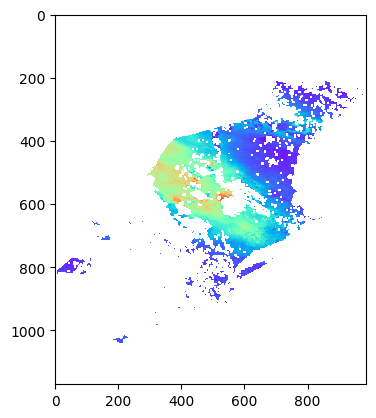

######### 128###############
0.037418485
0.97629356
5.2749812e-05
0.03590948
0.0
1.467


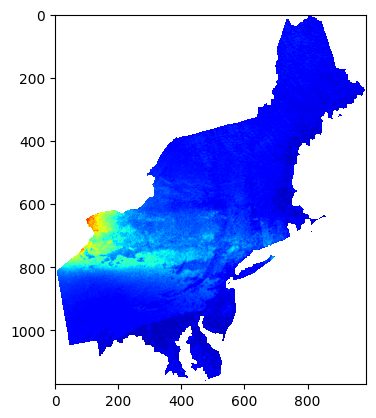

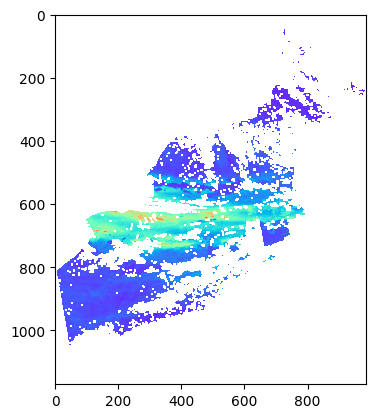

######### 129###############
0.0687055
2.1656098
0.00017784083
0.17668867
0.0
1.599


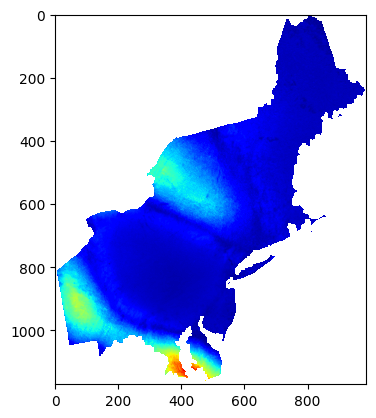

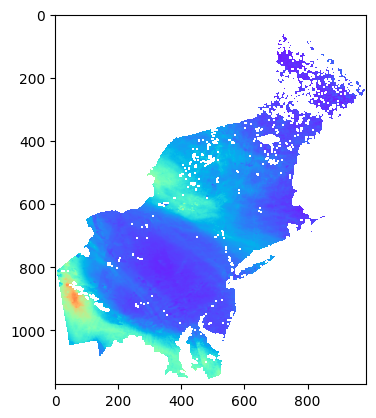

######### 130###############
0.0533557
0.89067316
0.000107253145
0.02988718
0.0
1.229


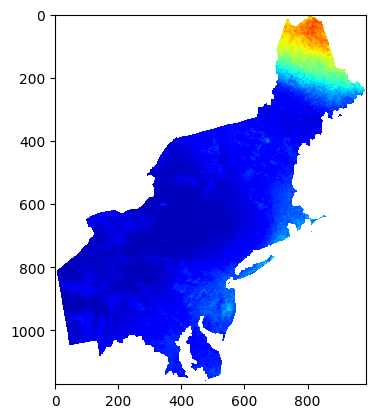

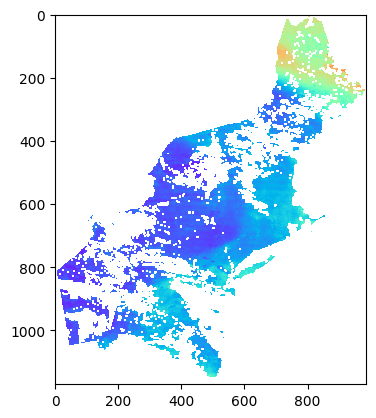

######### 131###############
0.06439024
0.9227432
0.00015620282
0.0320782
0.0
0.556


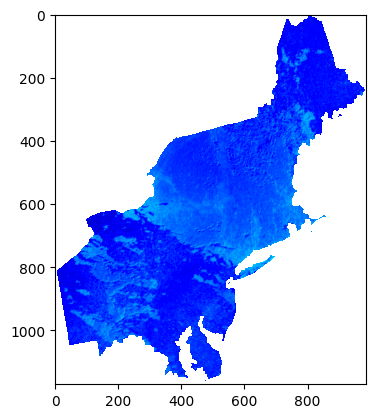

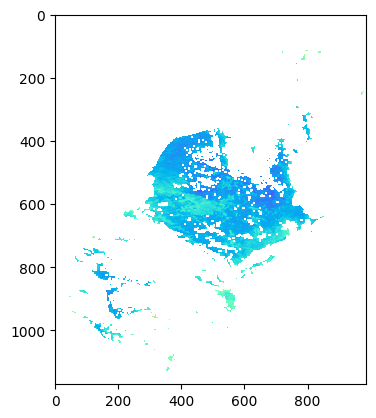

######### 132###############
0.074035764
0.743235
0.00020650546
0.02081137
0.0
0.438


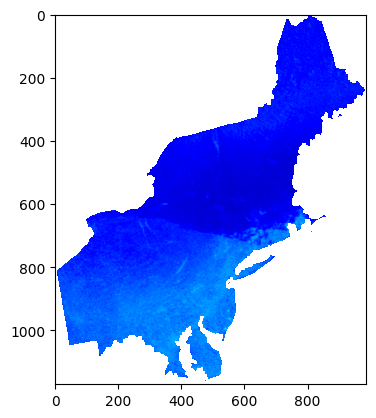

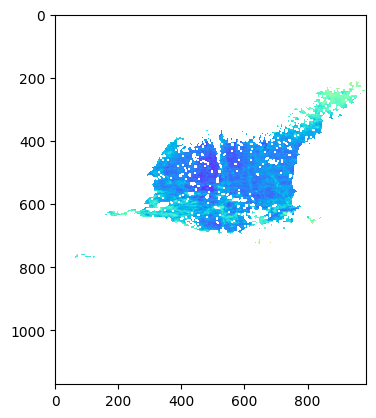

######### 133###############
0.058031976
0.48885846
0.00012687697
0.009003567
0.0
0.5


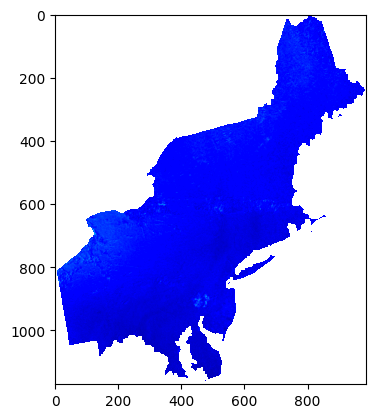

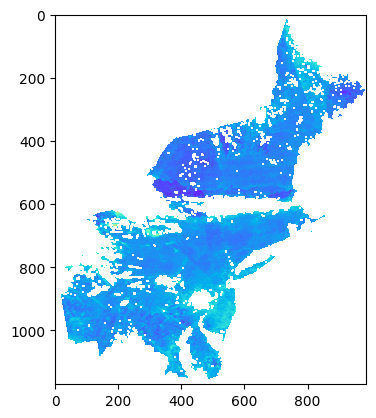

######### 134###############
0.043376565
0.75423574
7.088567e-05
0.021431994
0.0
1.4195


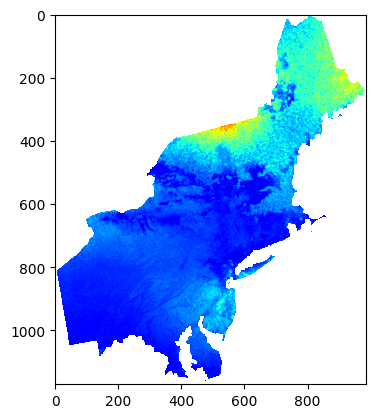

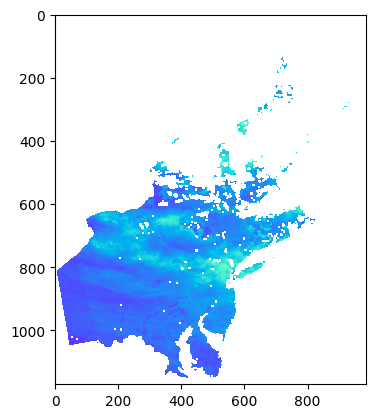

######### 135###############
0.06206119
2.934978
0.00014510703
0.3245323
0.0
2.116


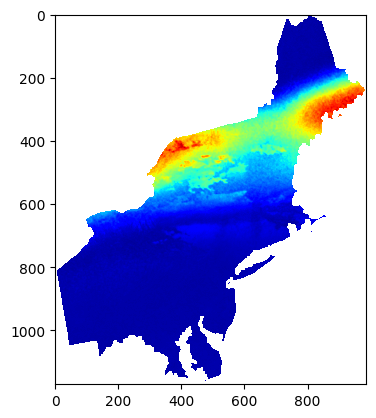

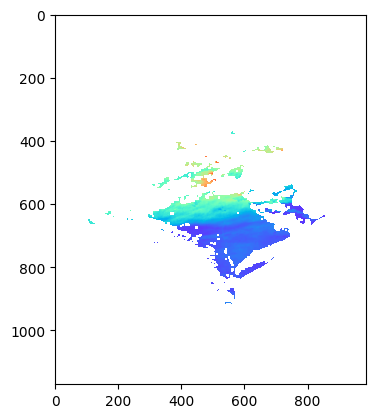

######### 136###############
0.06000805
0.71637285
0.00013566502
0.019334218
0.0
1.105


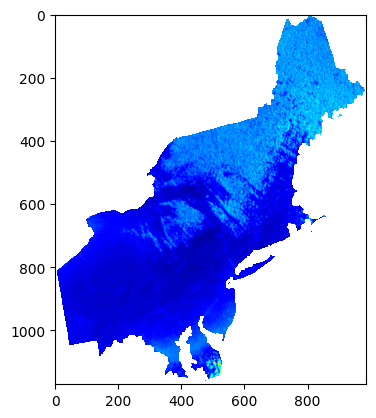

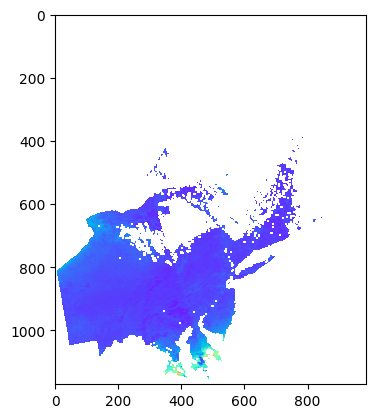

######### 137###############
0.02889897
0.73285115
3.1463933e-05
0.020233912
0.0
0.696


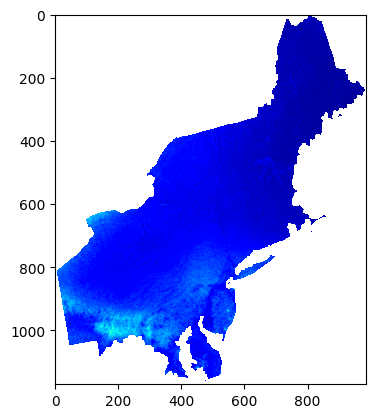

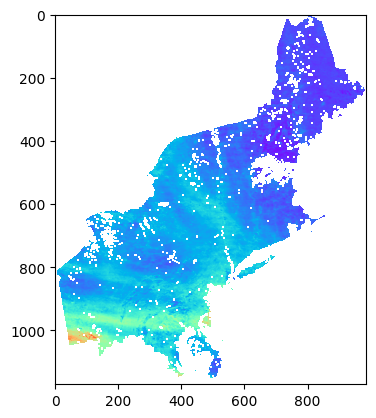

######### 138###############
0.023489118
1.090385
2.078657e-05
0.044792783
0.0
1.387


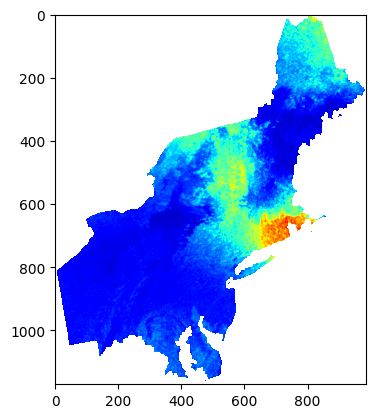

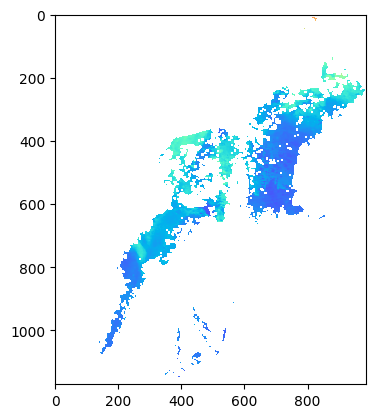

######### 139###############
0.08346963
0.8536197
0.00026248553
0.027452197
0.0
0.486


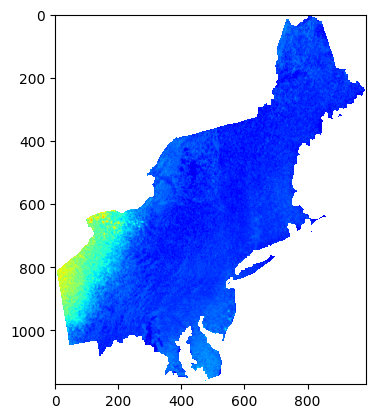

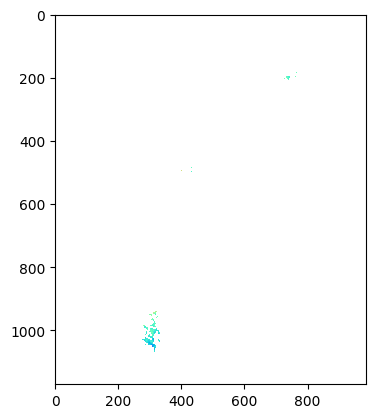

######### 140###############
0.053218365
1.3218586
0.00010670167
0.065829165
0.0
1.652


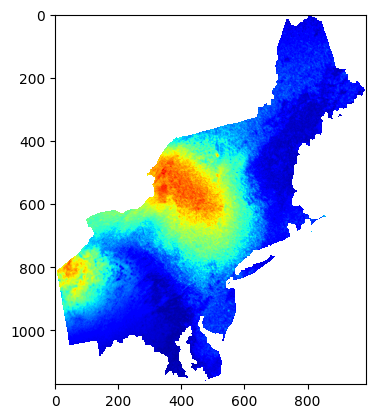

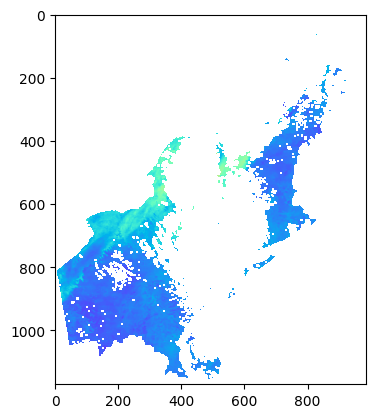

######### 141###############
0.02389684
1.755178
2.1514401e-05
0.11606218
0.0
2.249


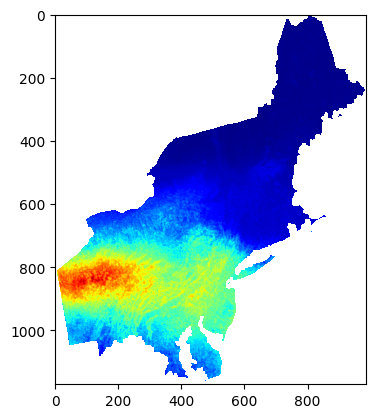

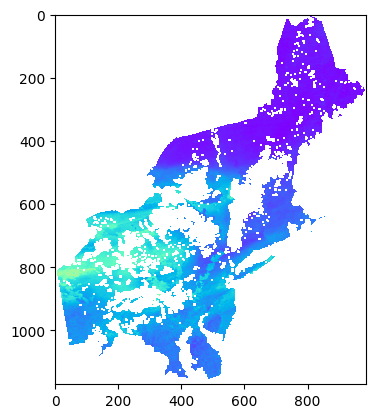

######### 142###############
0.0427652
1.9813331
6.8901565e-05
0.14789832
0.0
1.335


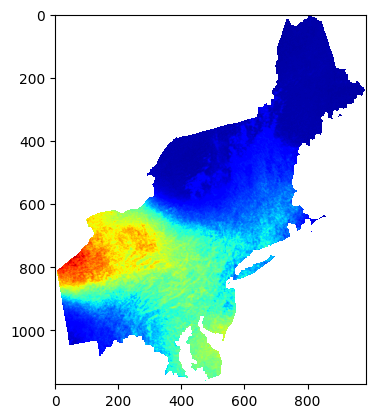

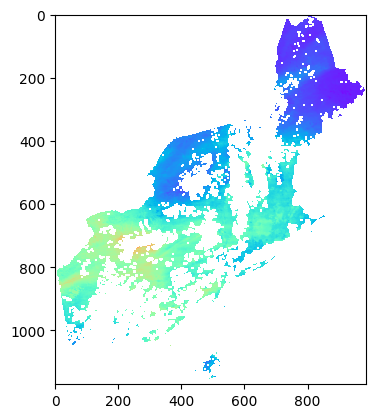

######### 143###############
0.10516393
2.3434496
0.00041665984
0.20689957
0.0
2.265


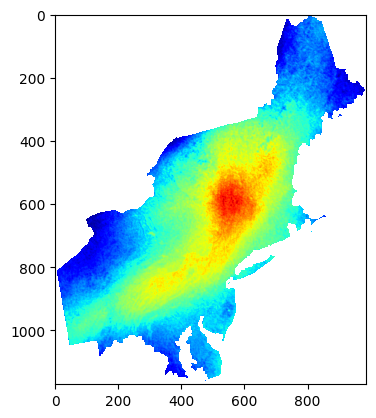

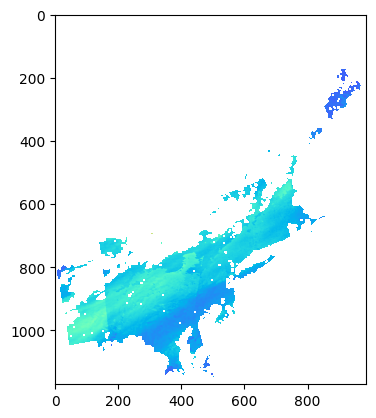

######### 144###############
0.034790903
0.7423056
4.560155e-05
0.020759346
0.0
0.456


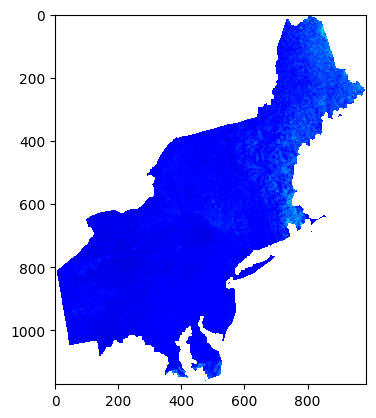

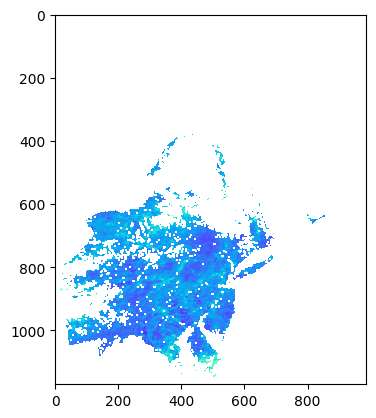

######### 145###############
0.099703655
2.8008103
0.0003745161
0.29553962
0.0
5.968


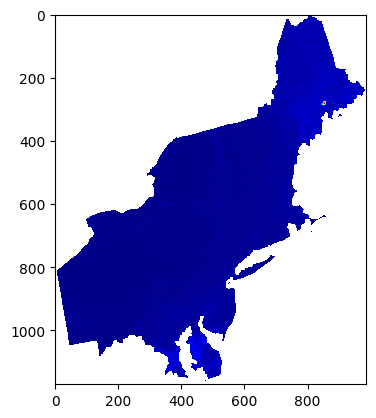

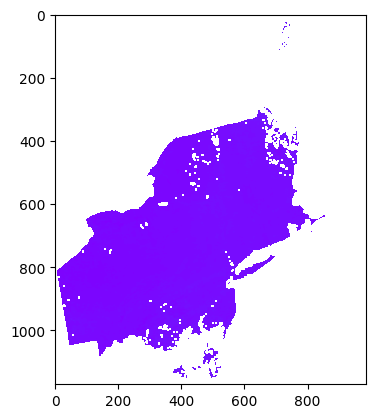

######### 146###############
0.053799048
0.59607947
0.00010904293
0.013386178
0.0
0.508


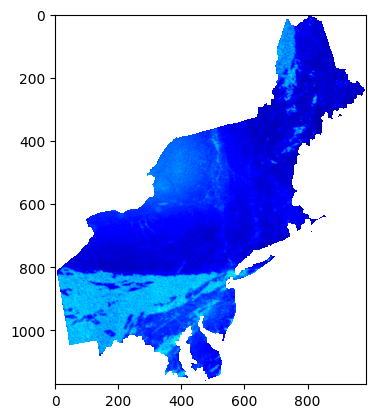

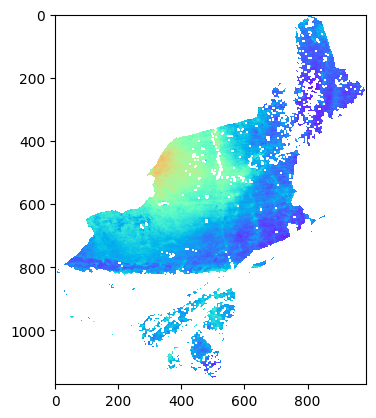

######### 147###############
0.06550181
0.8158659
0.00016164233
0.025077593
0.0
0.482


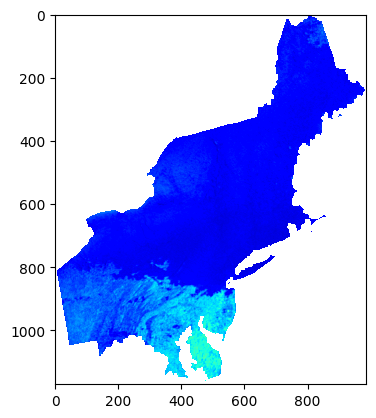

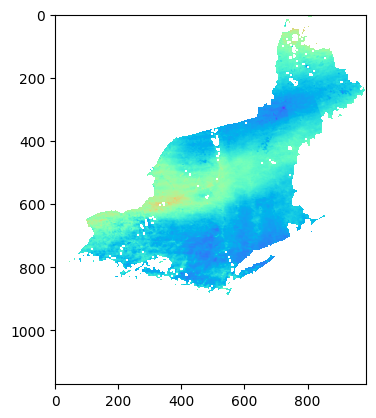

######### 148###############
0.07391878
0.6812092
0.00020585334
0.017482733
0.0
0.613


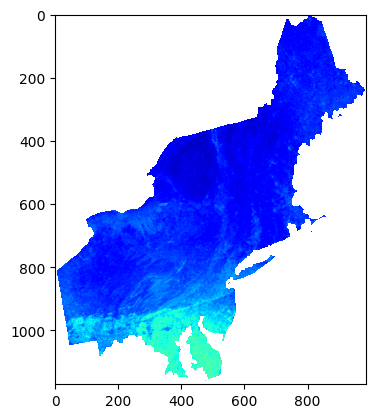

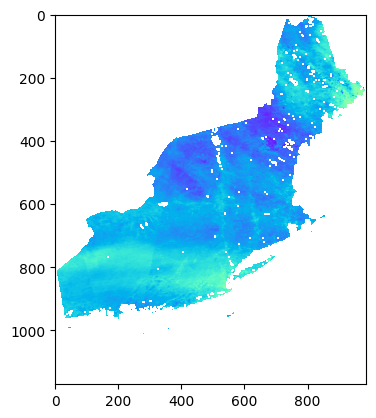

######### 149###############
0.06385362
0.7099602
0.00015361005
0.01898962
0.0
0.661


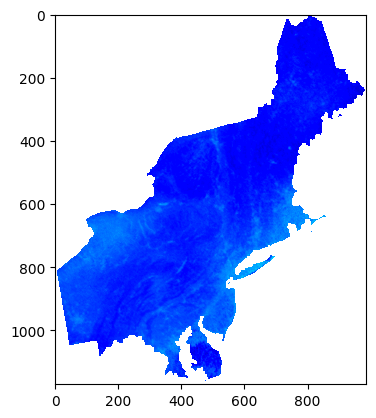

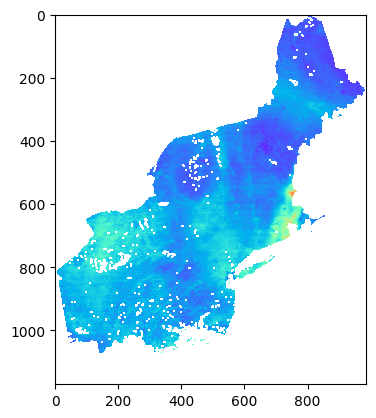

######### 150###############
0.05049592
0.6514933
9.6064025e-05
0.015990727
0.0
0.988


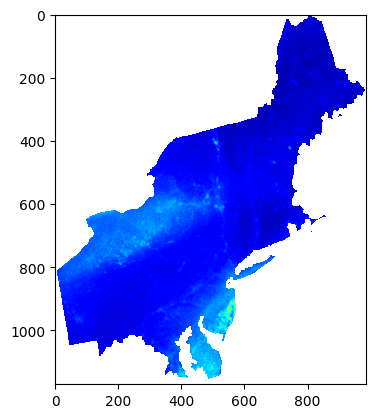

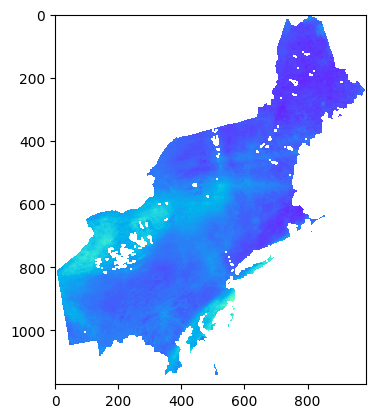

######### 151###############
0.05552864
0.67095554
0.00011616693
0.016960386
0.0
2.443


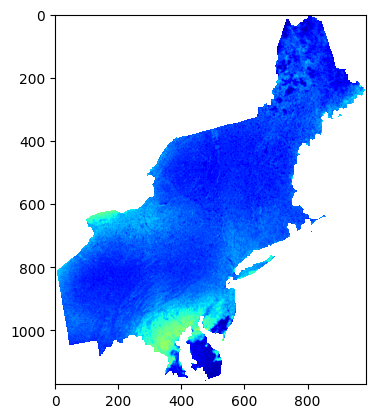

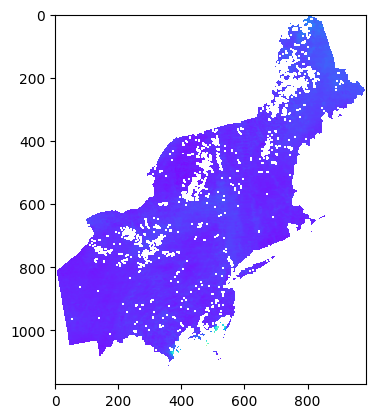

######### 152###############
0.037414372
0.4254606
5.273811e-05
0.0068197288
0.0
0.713


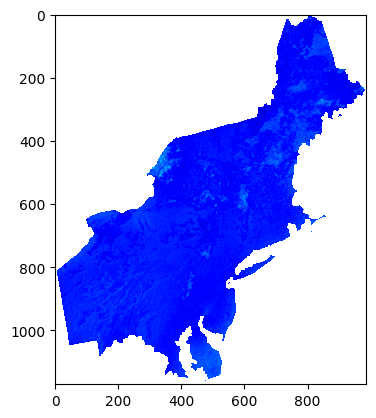

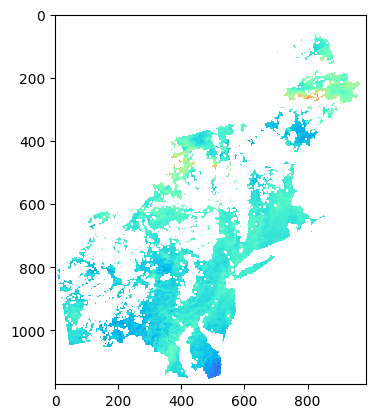

######### 153###############
0.12494594
0.8974438
0.00058815593
0.030343305
0.0
1.309


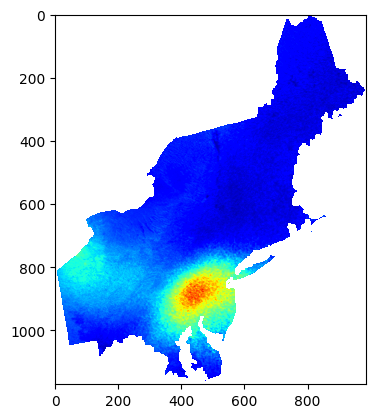

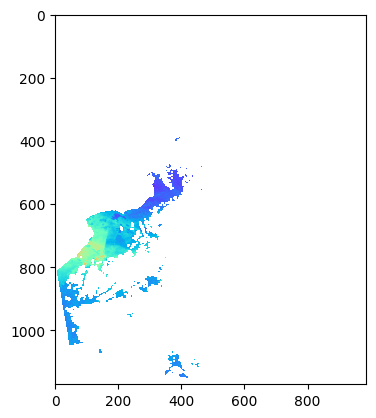

######### 154###############
0.14475965
1.5670581
0.000789484
0.092516355
0.0
2.267


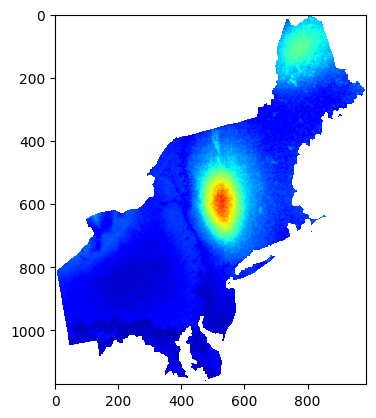

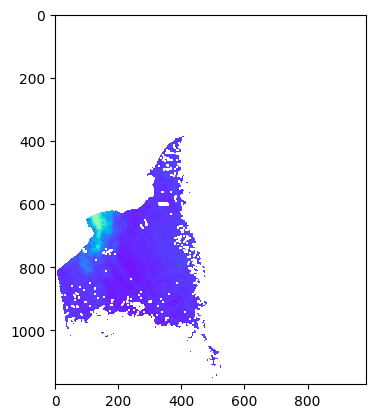

######### 155###############
0.050215483
3.81843
9.4999996e-05
0.5493105
0.0
2.848


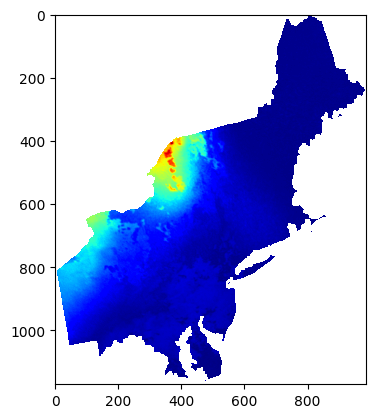

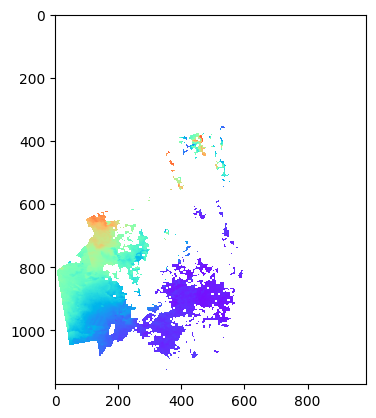

######### 156###############
0.13904244
8.994829
0.00072835496
3.0481353
0.0
4.091


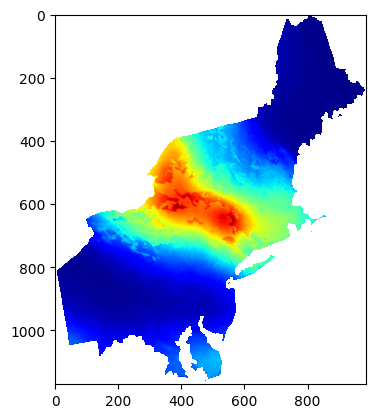

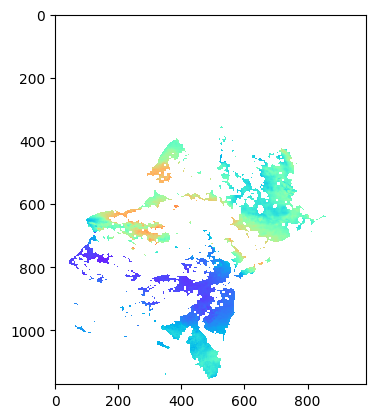

######### 157###############
0.26262736
7.625827
0.0025985334
2.1908982
0.0
4.155


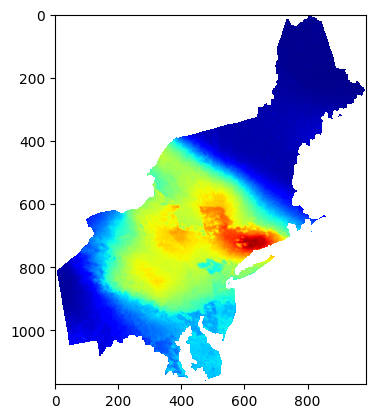

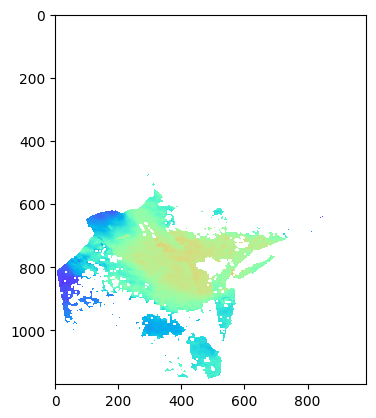

######### 158###############
0.10816842
4.5317755
0.00044080772
0.77372205
0.0
2.434


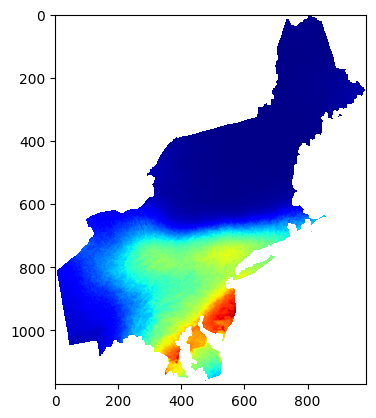

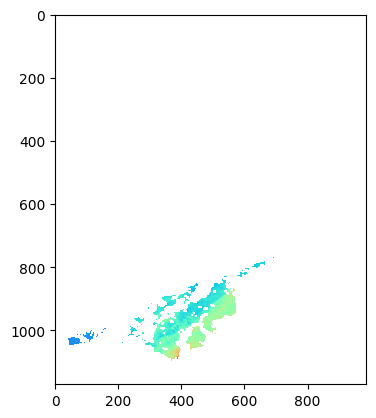

######### 159###############
0.09217745
0.8777356
0.00032010901
0.029025236
0.0
1.104


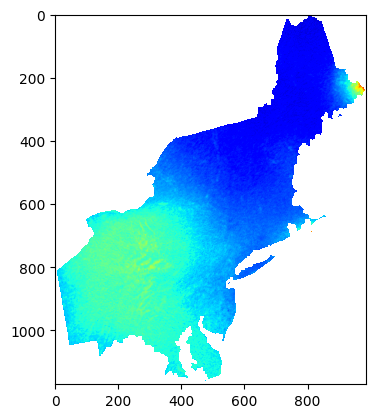

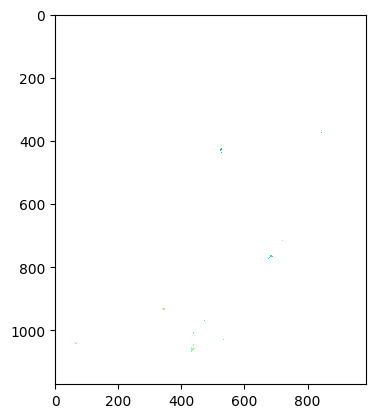

######### 160###############
0.07635397
0.7614853
0.00021964006
0.02184597
0.0
0.997


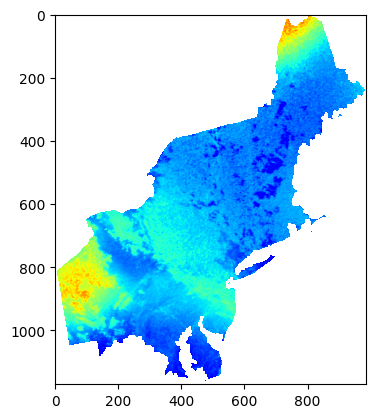

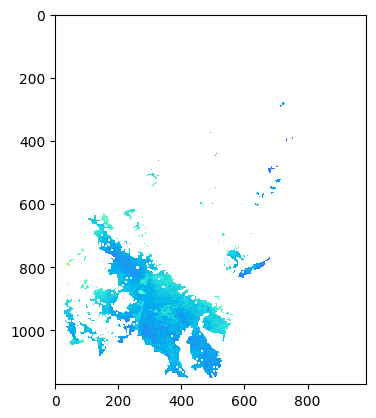

######### 161###############
0.030814469
0.57931733
3.577317e-05
0.012643909
0.0
1.214


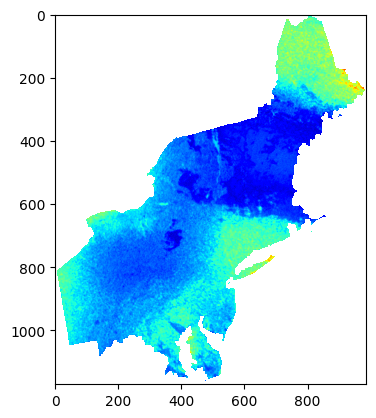

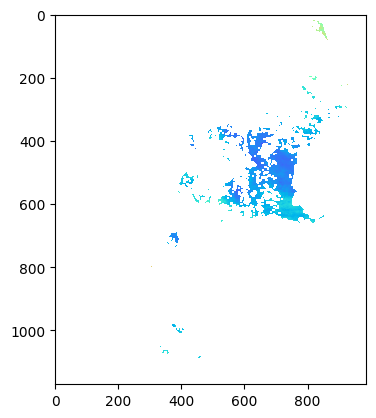

######### 162###############
0.113230765
0.6547276
0.00048303342
0.016149892
0.0
0.635


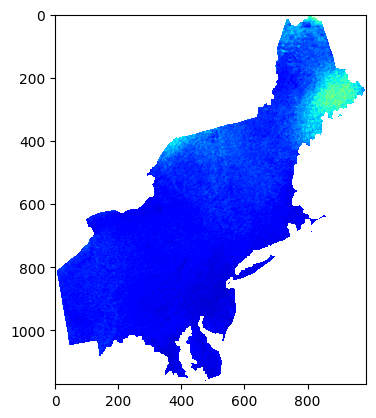

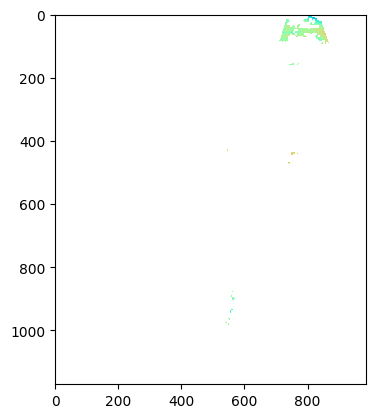

######### 163###############
0.099081725
0.6157454
0.00036985823
0.01428403
0.0
0.453


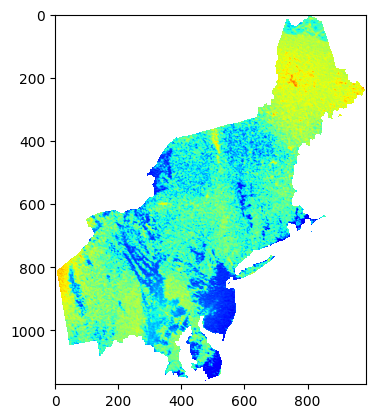

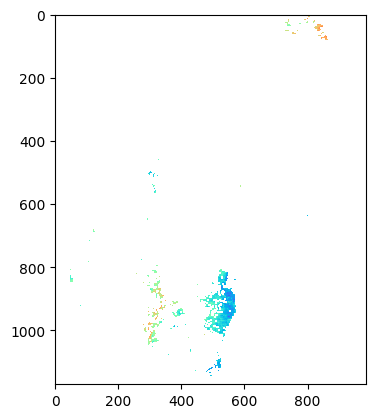

######### 164###############
0.082351565
0.49783725
0.0002555008
0.009337337
0.0
0.507


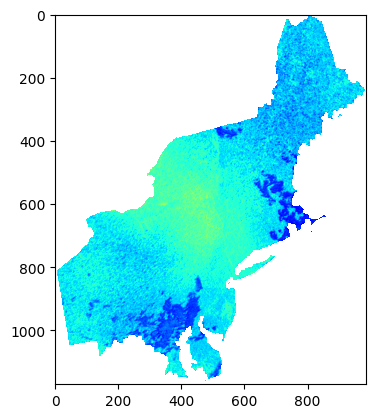

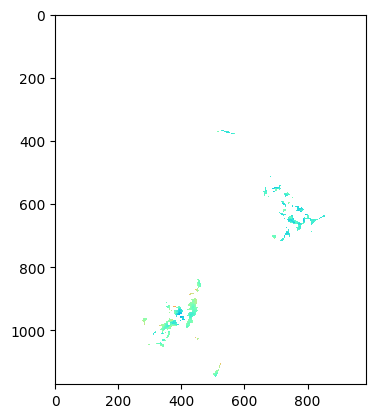

######### 165###############
0.062457263
1.5373062
0.00014696505
0.08903672
0.0
1.698


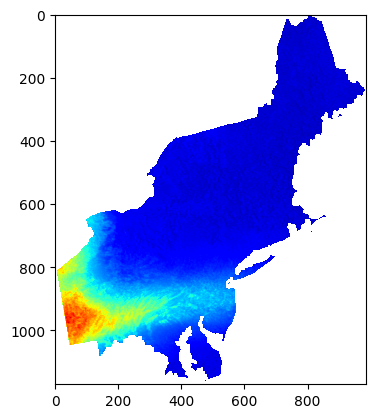

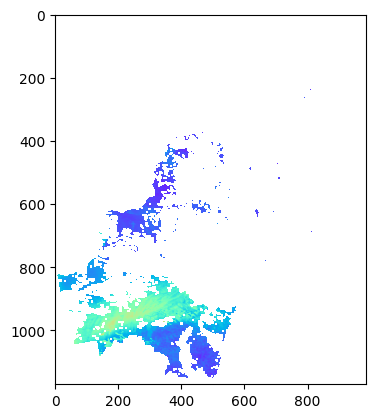

######### 166###############
0.06985313
3.8070164
0.00018383148
0.5460316
0.0
1.748


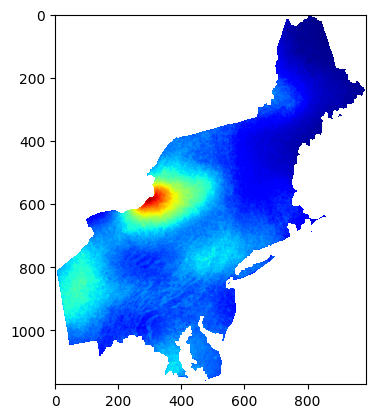

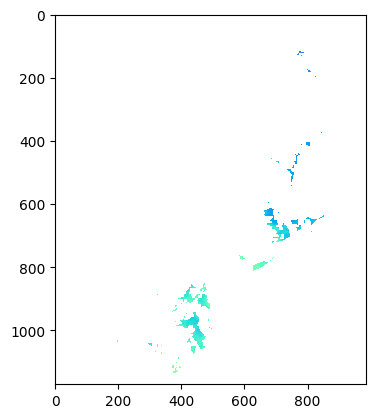

######### 167###############
0.056916118
6.54915
0.00012204454
1.6159134
0.0
2.408


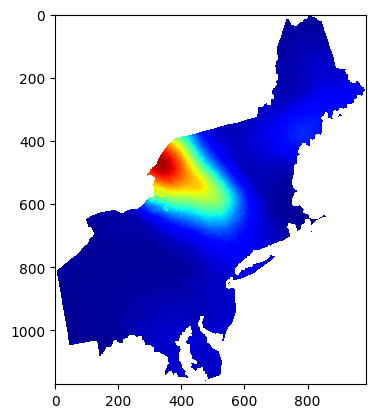

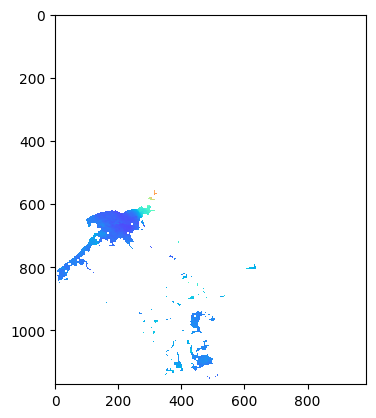

######### 168###############
0.0780344
0.7385281
0.00022941435
0.020548604
0.0
2.952


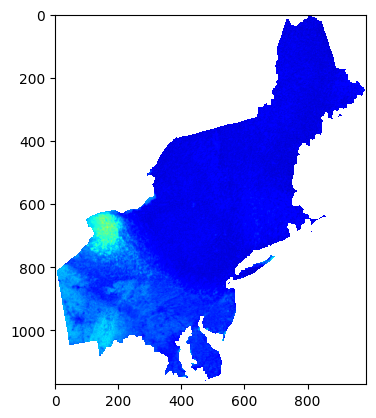

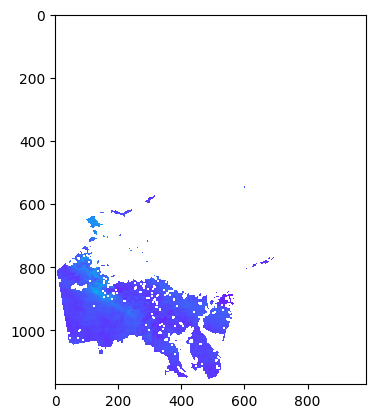

######### 169###############
0.04017225
0.7652418
6.079961e-05
0.022062043
0.0
1.21


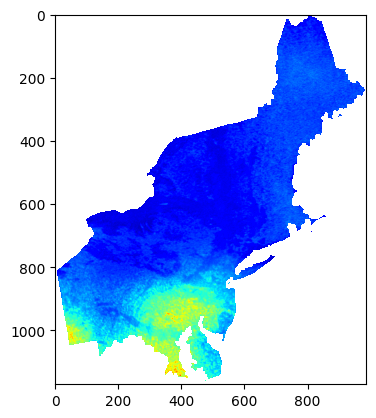

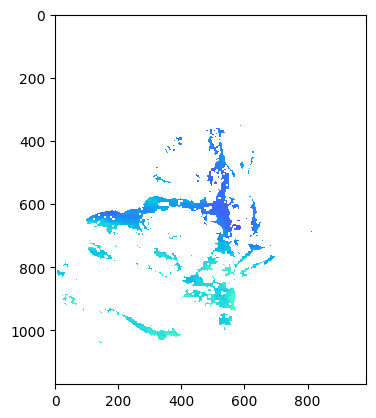

######### 170###############
0.033139035
0.689669
4.1374024e-05
0.017919656
0.0
0.6


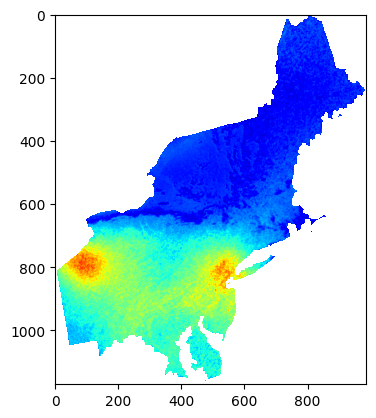

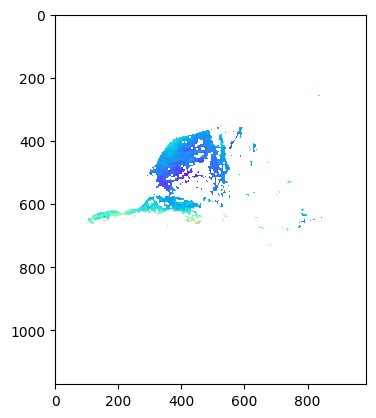

######### 171###############
0.053902388
0.87690604
0.0001094622
0.028970396
0.0
0.925


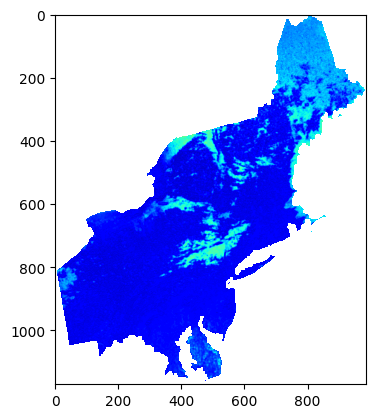

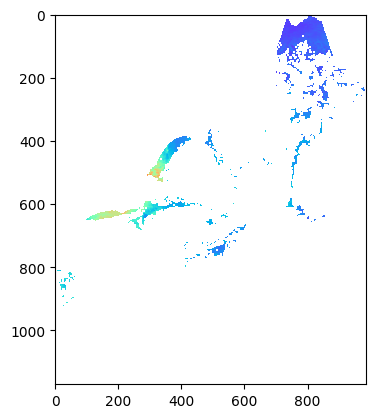

######### 172###############
0.09055513
0.7604135
0.00030894016
0.02178452
0.0
0.979


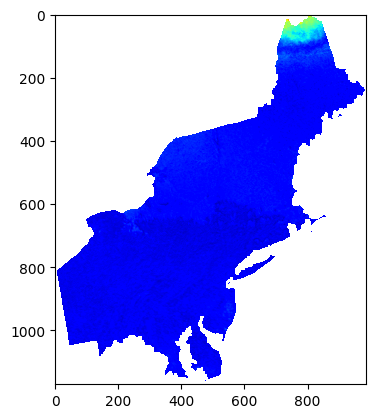

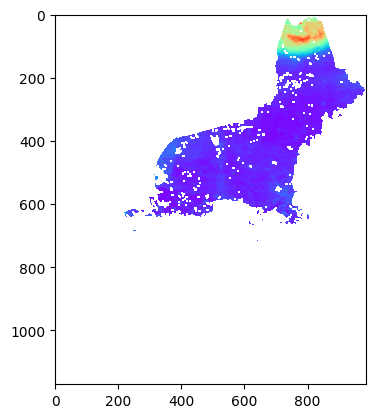

######### 173###############
0.094577745
2.3143463
0.00033699704
0.20179248
0.0
3.569


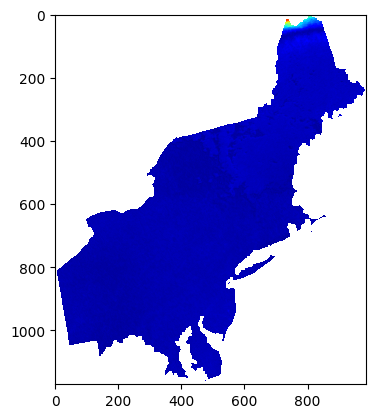

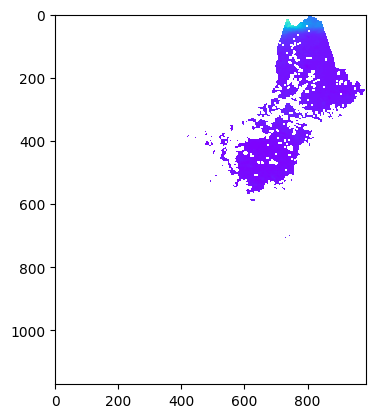

######### 174###############
0.07156849
0.67605805
0.00019297101
0.017219335
0.0
0.469


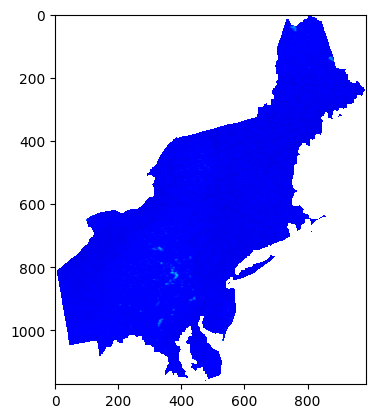

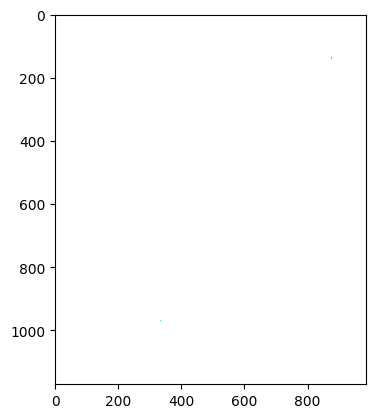

######### 175###############
0.038692534
7.8952127
5.6403125e-05
2.3484209
0.0
3.423


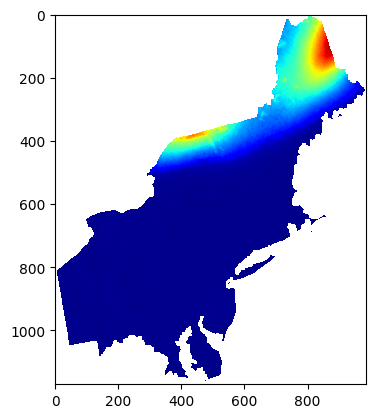

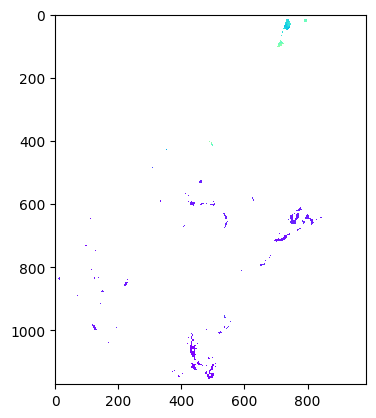

######### 176###############
0.07084888
2.4149656
0.00018910997
0.21972033
0.0
2.26


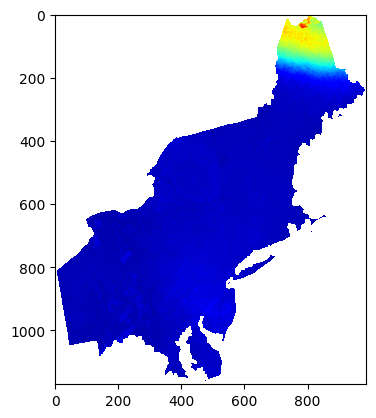

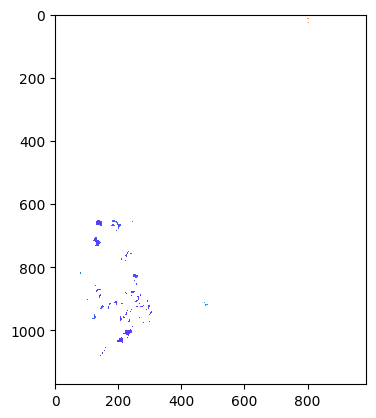

######### 177###############
0.10511541
0.54701906
0.00041627552
0.011273356
0.0
0.448


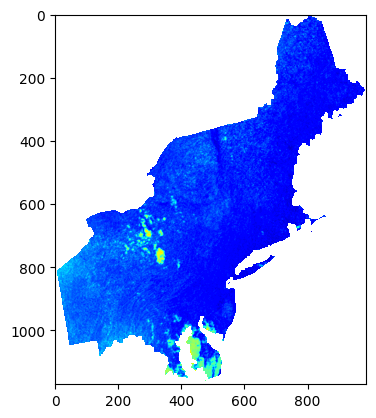

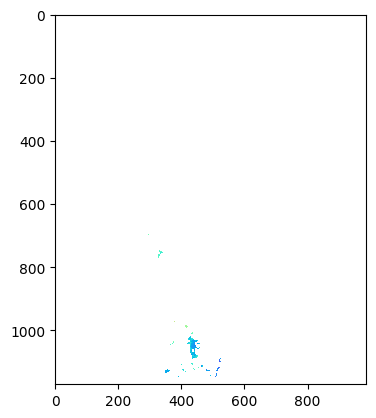

######### 178###############
0.08553152
11.668623
0.00027561357
5.1296473
0.0
3.374


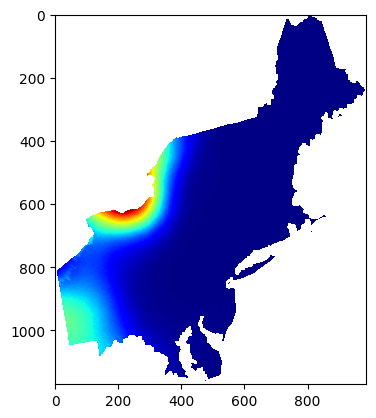

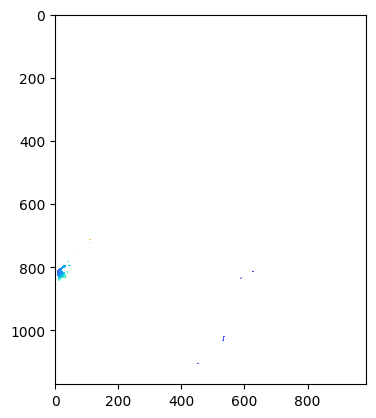

######### 179###############
0.09529388
3.787135
0.00034211986
0.5403433
0.0
3.108


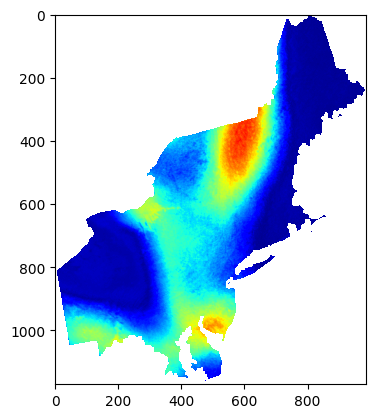

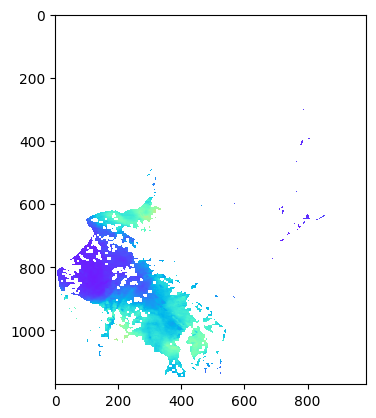

######### 180###############
0.114567995
3.2293224
0.00049451
0.39289016
0.0
2.923


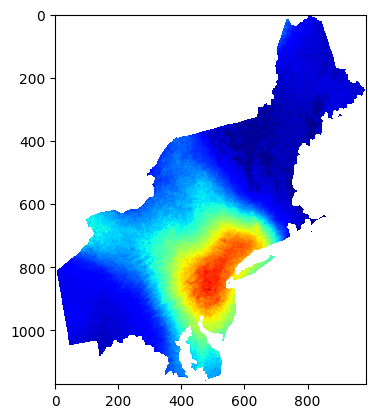

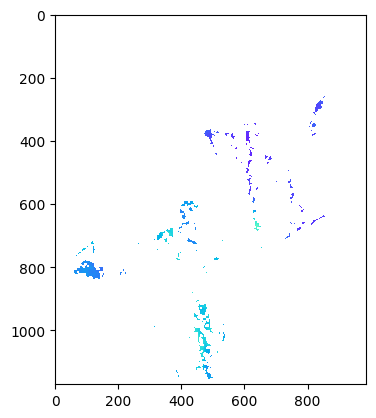

######### 181###############
0.097355515
1.9309459
0.00035708322
0.14047158
0.0
1.423


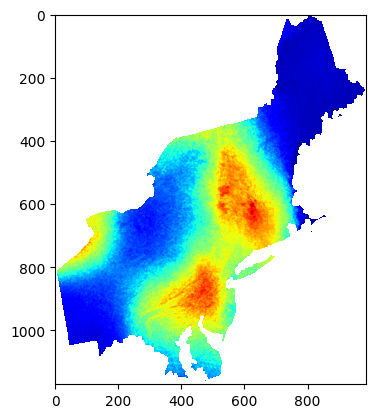

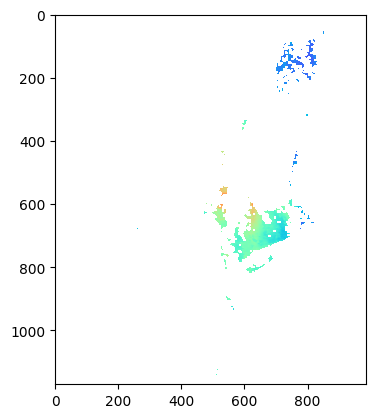

######### 182###############
0.1164031
0.961672
0.00051047874
0.034841936
0.0
0.6825


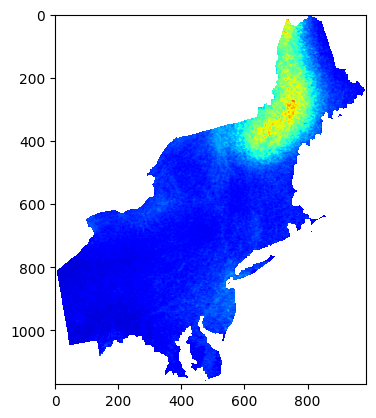

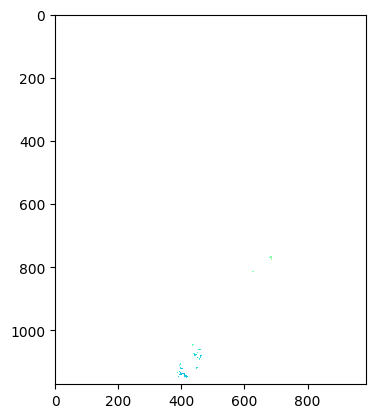

######### 183###############
0.17445512
1.1175863
0.0011466102
0.0470555
0.0
0.46


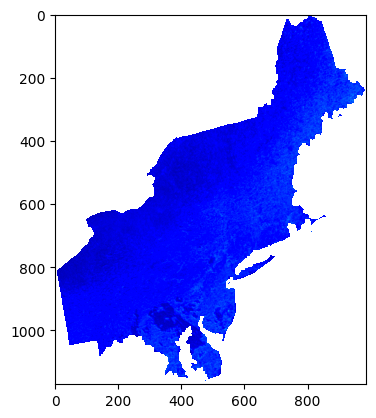

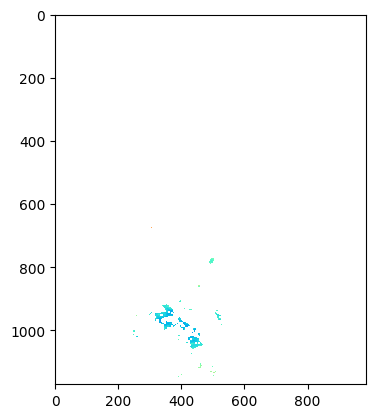

######### 184###############
0.09687037
0.68657506
0.00035353325
0.017759237
0.0
2.801


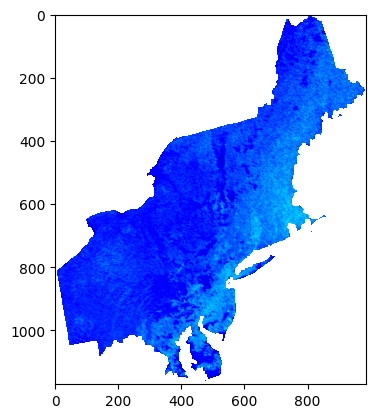

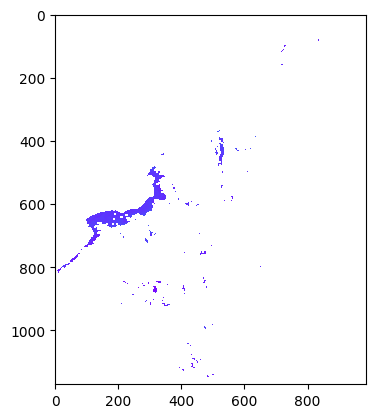

######### 185###############
0.056959637
0.69901407
0.00012223142
0.018408576
0.0
0.487


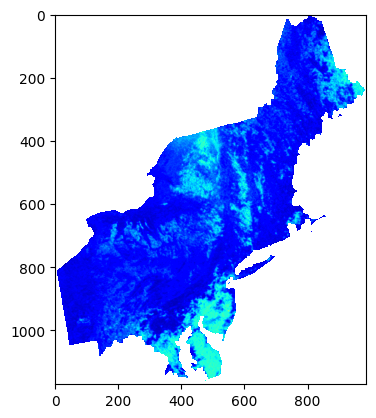

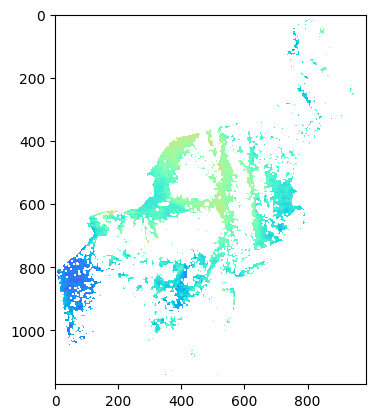

######### 186###############
0.060302317
0.53564805
0.0001369987
0.0108095445
0.0
0.502


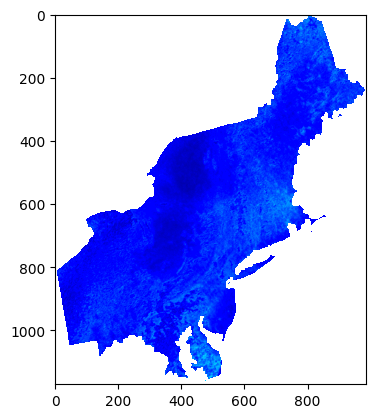

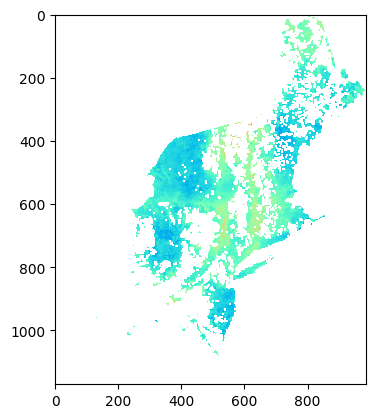

######### 187###############
0.11416721
0.8032196
0.00049105595
0.02430619
0.0
2.845


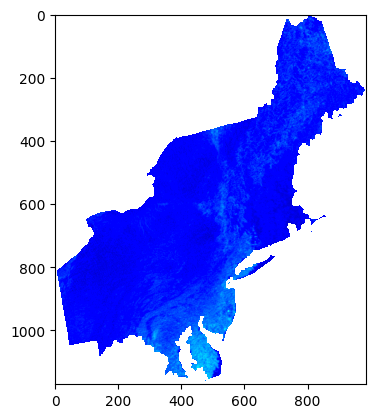

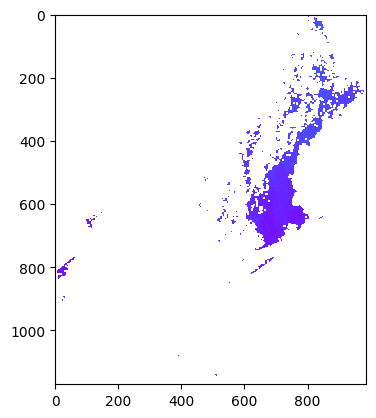

######### 188###############
0.05777529
0.45611796
0.00012575716
0.007837953
0.0
0.656


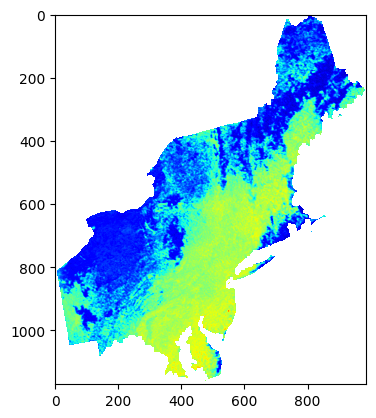

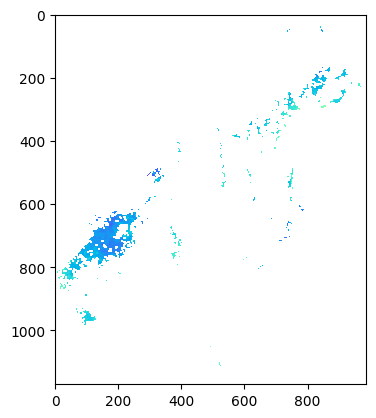

######### 189###############
0.09273924
0.92921805
0.0003240227
0.03252996
0.035
0.438


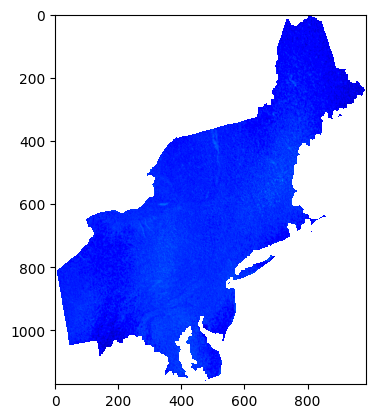

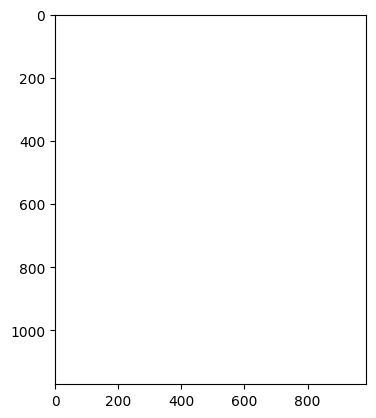

######### 190###############
0.054373235
0.62658966
0.000111382906
0.014791587
0.0
0.438


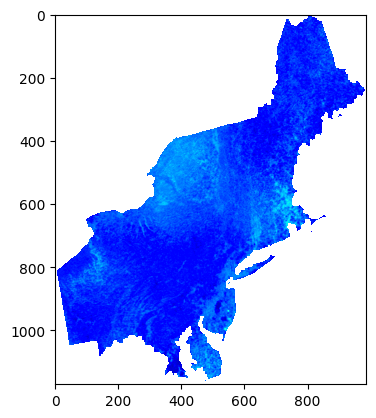

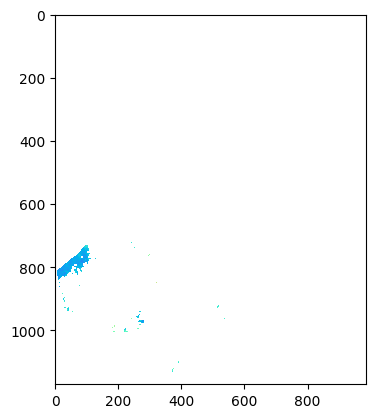

######### 191###############
0.070162654
0.77286434
0.0001854643
0.022503749
0.0
2.471


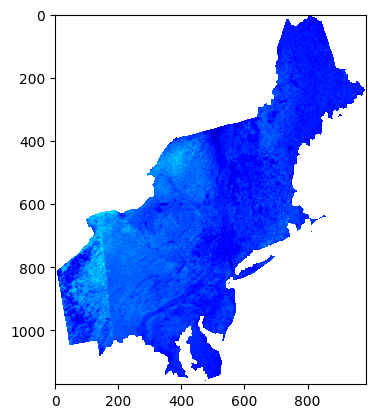

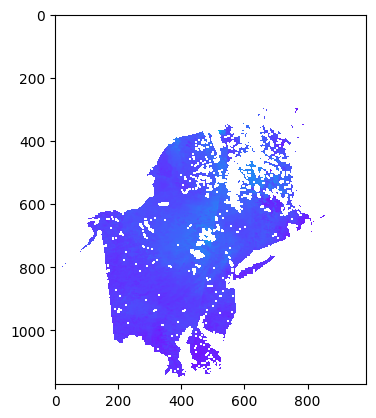

######### 192###############
0.0964424
0.89293694
0.00035041623
0.030039305
0.0
0.782


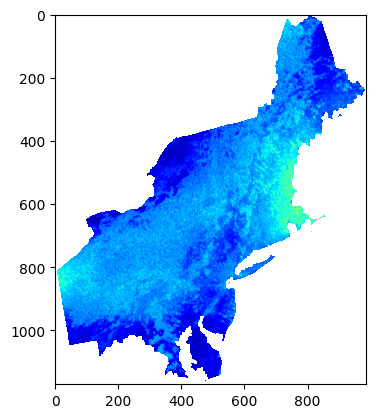

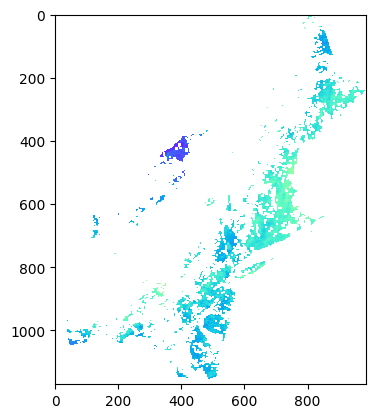

######### 193###############
0.07653778
0.4683715
0.00022069884
0.00826474
0.0
0.541


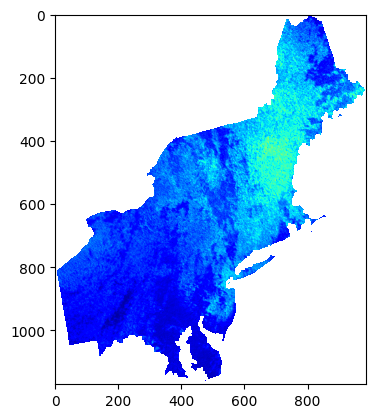

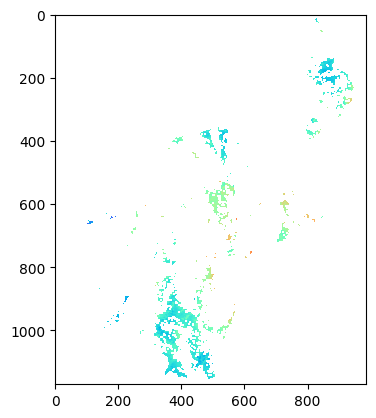

######### 194###############
0.092683256
0.9375838
0.00032363148
0.03311833
0.0
0.461


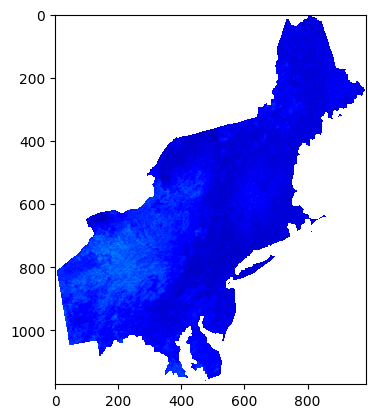

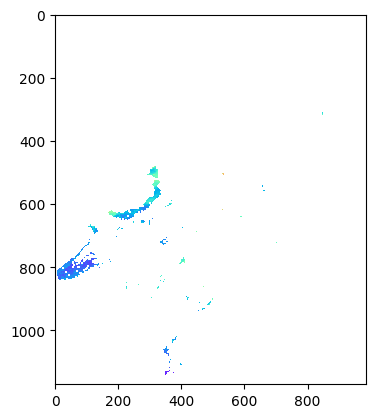

######### 195###############
0.103297874
0.71706736
0.00040200452
0.019371718
0.0
2.846


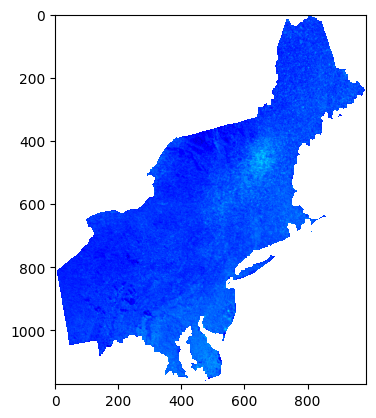

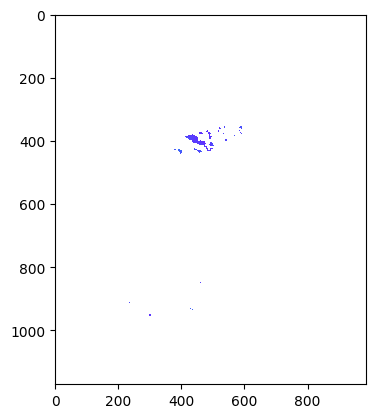

######### 196###############
0.050900936
1.8576789
9.761119e-05
0.13001382
0.0
1.287


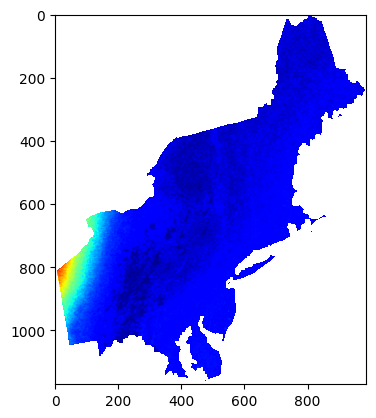

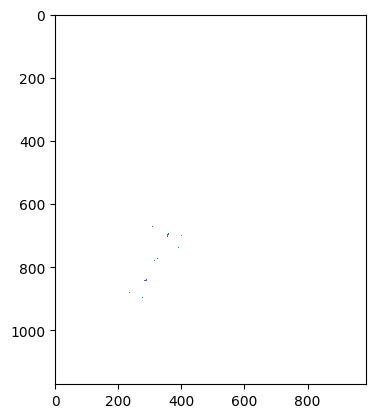

######### 197###############
0.13858598
2.7802143
0.0007235805
0.291209
0.0
2.658


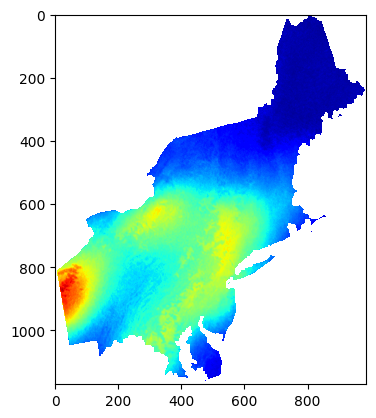

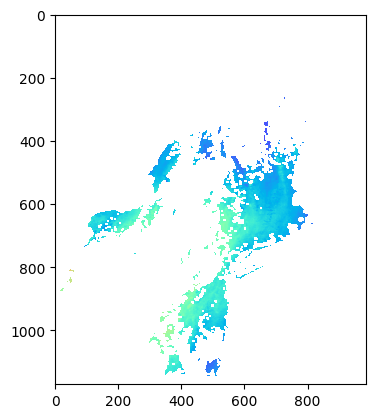

######### 198###############
0.0997777
2.0432358
0.00037507247
0.15728426
0.0
1.9155


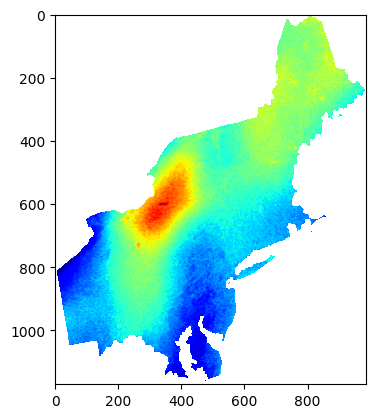

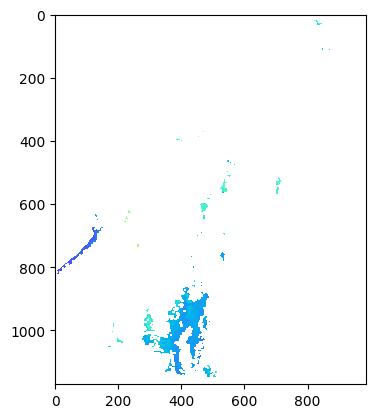

######### 199###############
0.055225804
1.7110745
0.00011490326
0.11030269
0.0
3.108


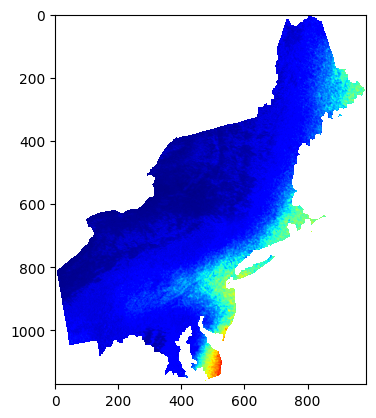

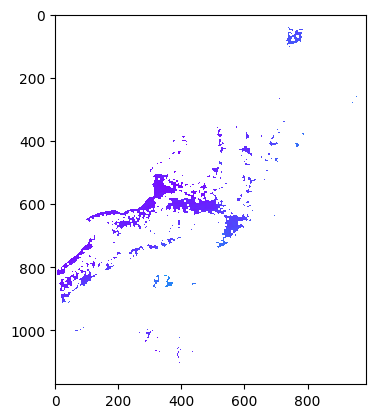

######### 200###############
0.1335643
0.61766887
0.0006720924
0.014373407
0.0
0.694


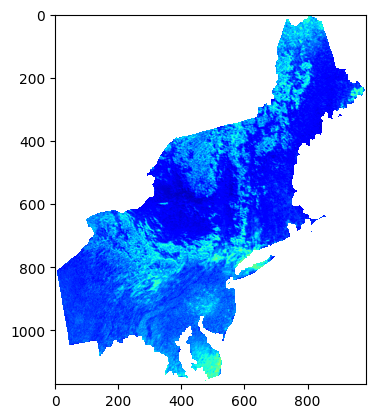

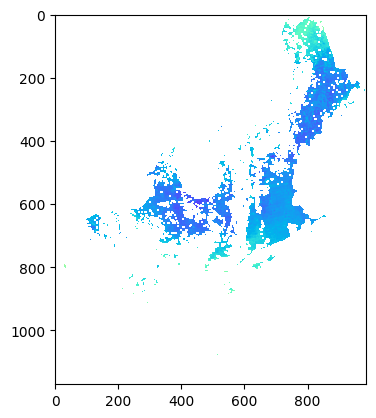

######### 201###############
0.1561122
1.0793005
0.00091816735
0.043886714
0.0
0.57


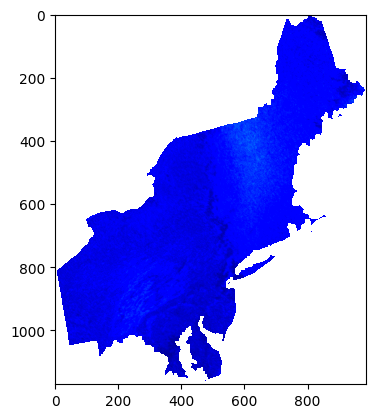

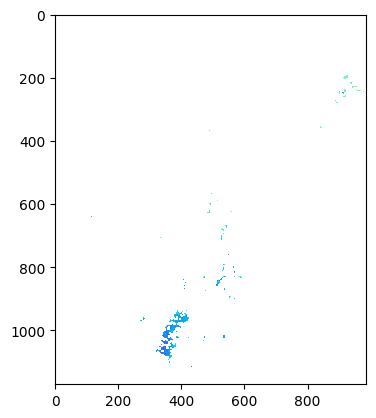

######### 202###############
0.15643544
1.0775093
0.00092197413
0.04374116
0.0
2.019


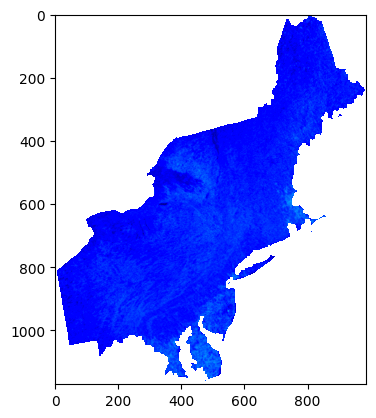

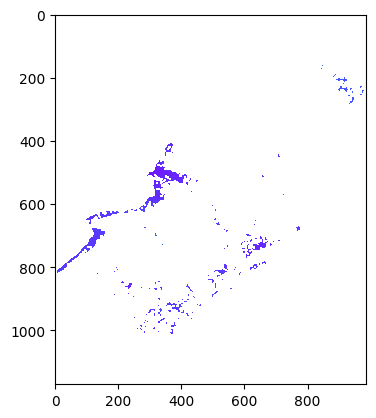

######### 203###############
0.06290406
0.40983814
0.00014907532
0.0063280957
0.0
0.473


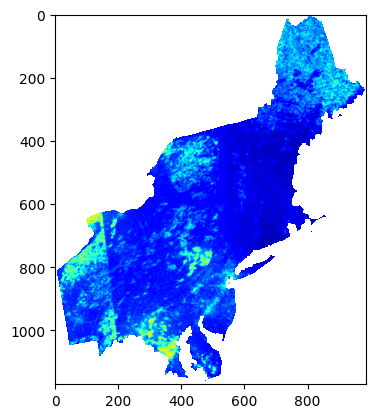

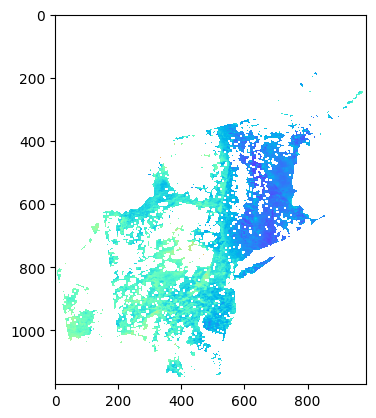

######### 204###############
0.10179295
0.5641197
0.00039037658
0.011989217
0.0
0.745


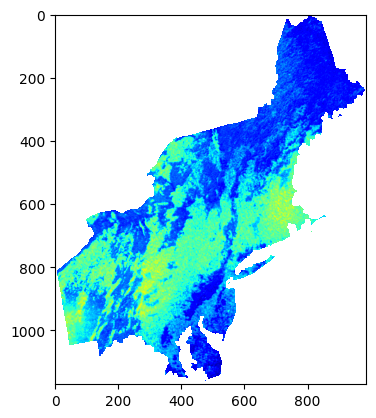

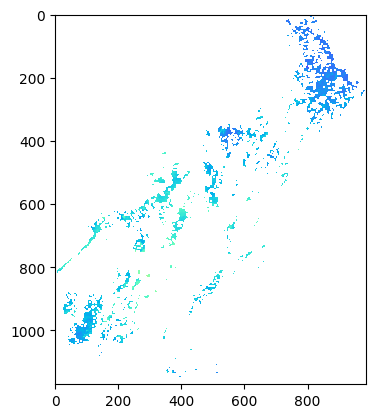

######### 205###############
0.049892753
0.9707463
9.378277e-05
0.03550256
0.0
1.3535


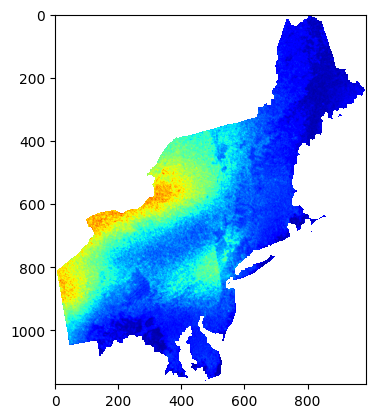

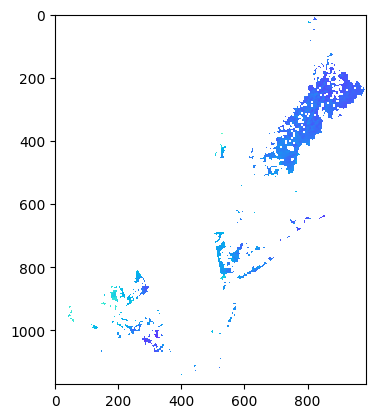

######### 206###############
0.07246095
0.62692094
0.00019781364
0.01480723
0.0
0.812


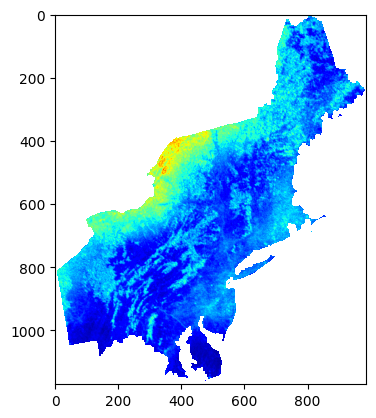

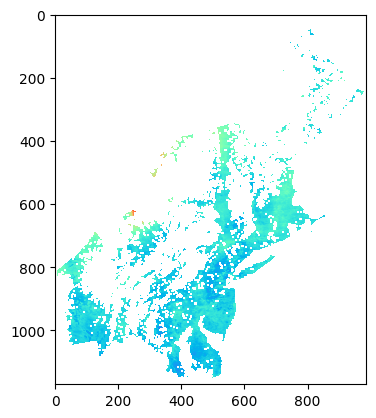

######### 207###############
0.08800626
0.6763294
0.00029179337
0.017233156
0.0
0.515


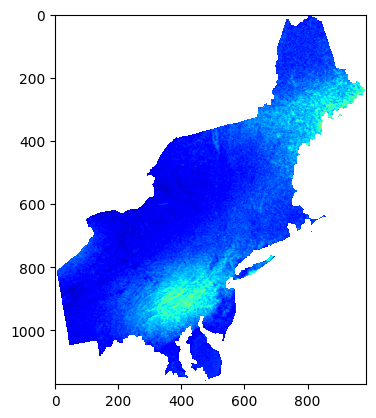

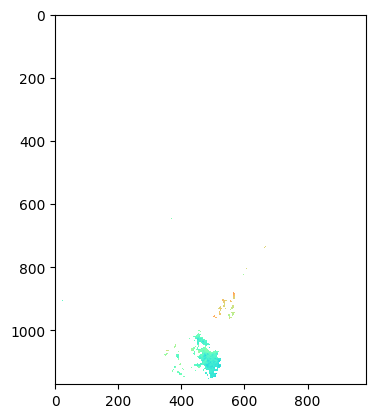

######### 208###############
0.048935294
0.48352566
9.021793e-05
0.008808204
0.0
0.847


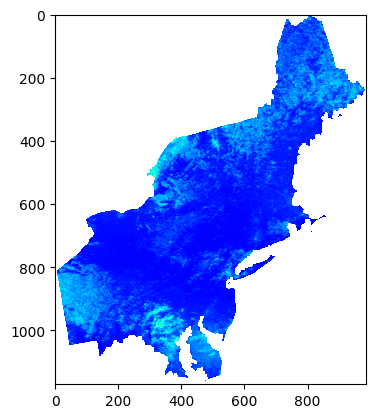

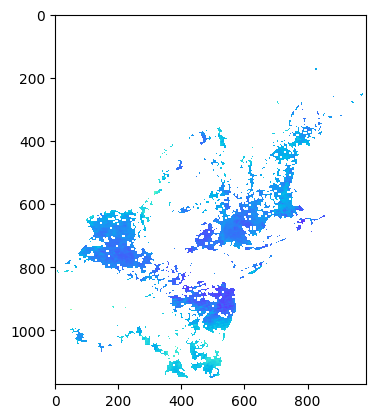

######### 209###############
0.096931785
0.84388065
0.00035398148
0.026829366
0.0
0.456


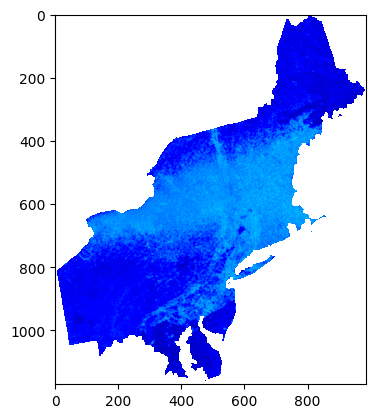

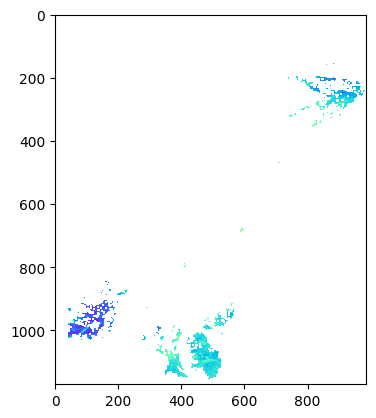

######### 210###############
0.0661653
0.5066391
0.00016493347
0.00967043
0.0
0.433


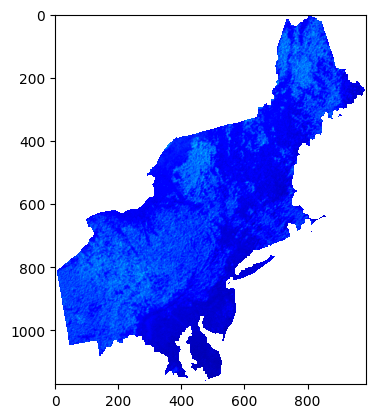

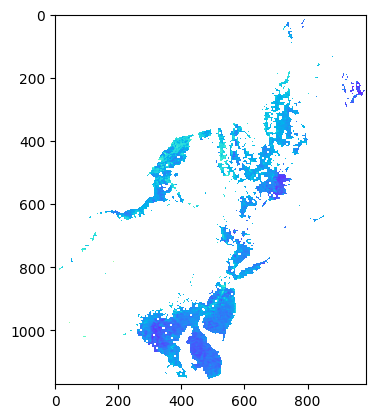

######### 211###############
0.096324265
0.6829102
0.00034955848
0.017570151
0.0
0.808


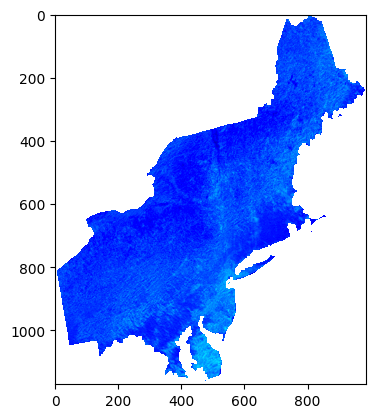

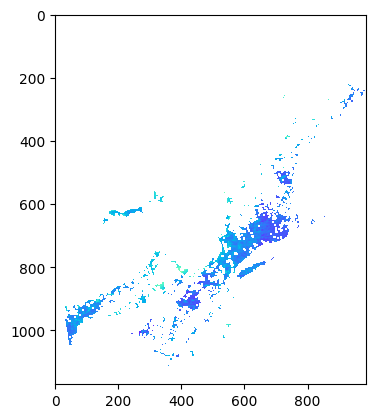

######### 212###############
0.0823265
4.3079042
0.00025534508
0.6991663
0.0
2.36


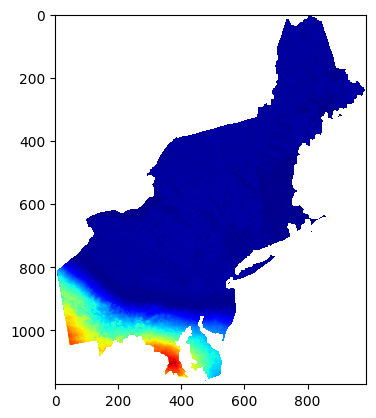

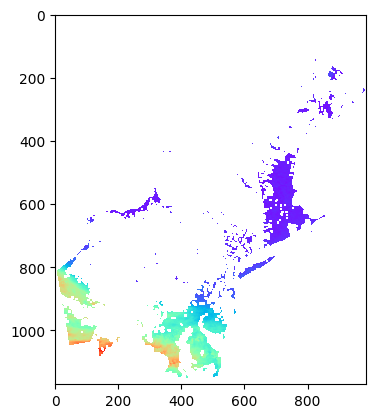

######### 213###############
0.08942121
3.0472097
0.0003012517
0.34982675
0.0
1.593


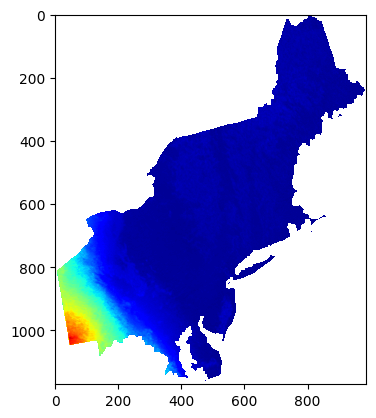

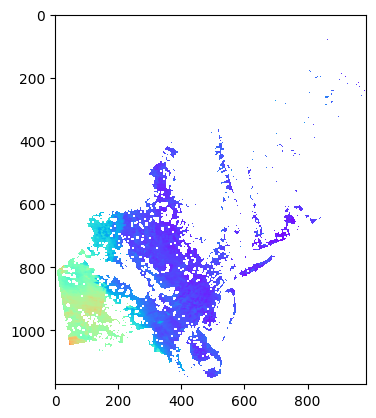

######### 214###############
0.07132512
2.1080766
0.00019166086
0.1674253
0.0
1.86


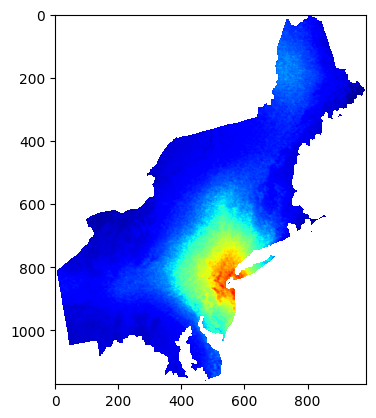

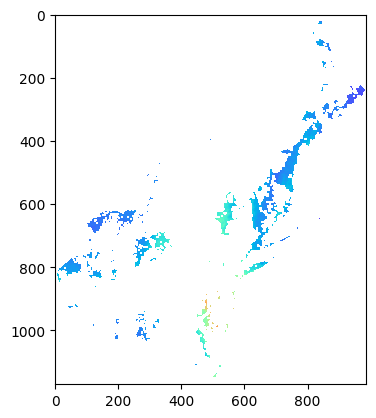

######### 215###############
0.044629008
0.74236774
7.5038304e-05
0.020762827
0.0
2.061


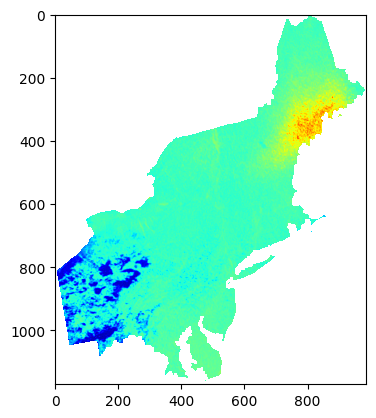

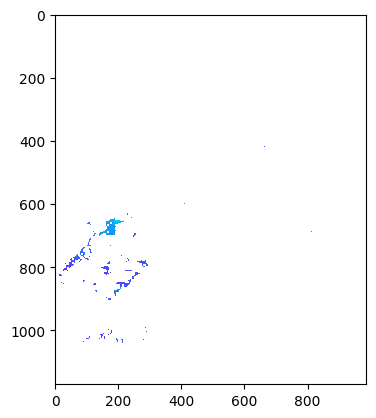

######### 216###############
0.045061707
0.3135432
7.650043e-05
0.003703763
0.0
1.7


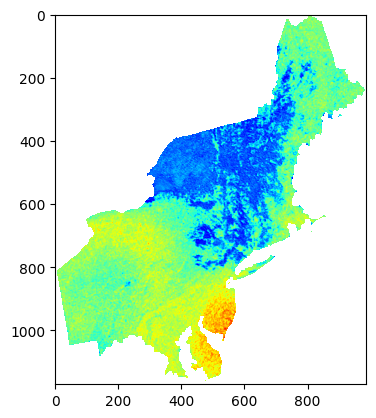

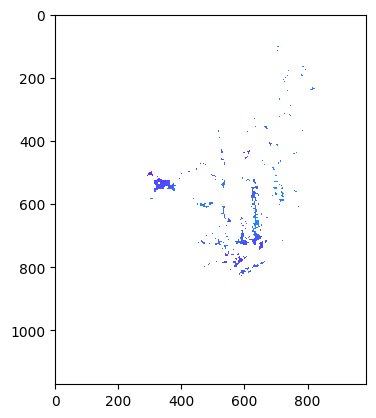

######### 217###############
0.042851567
0.44852704
6.9180154e-05
0.007579237
0.0
0.916


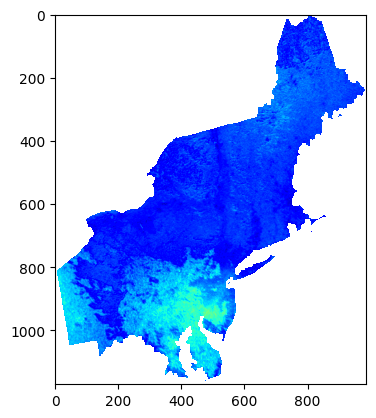

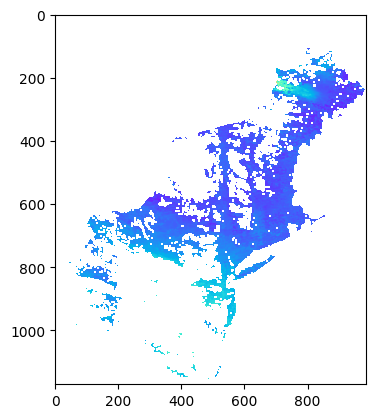

######### 218###############
0.057982117
0.37465838
0.00012665904
0.005288339
0.0
0.53


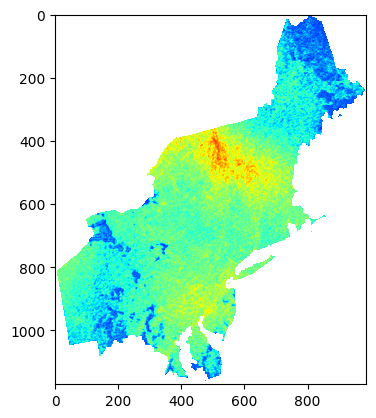

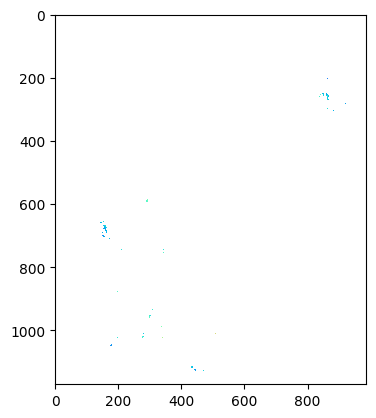

######### 219###############
0.072738096
0.3408122
0.00019932973
0.004376012
0.0
0.438


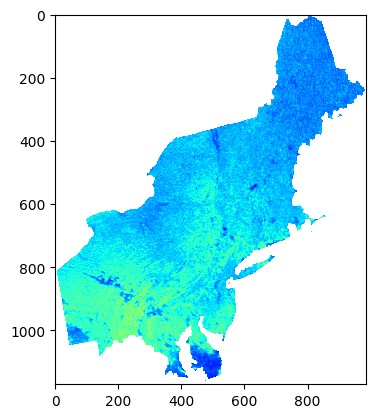

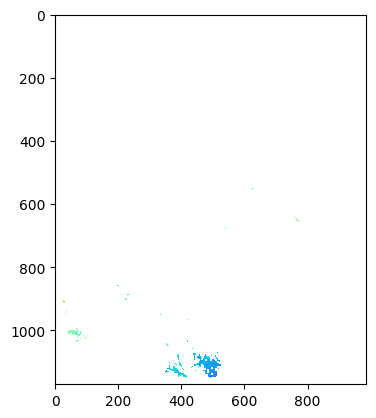

######### 220###############
0.06142883
0.39640796
0.00014216511
0.0059201536
0.0
1.539


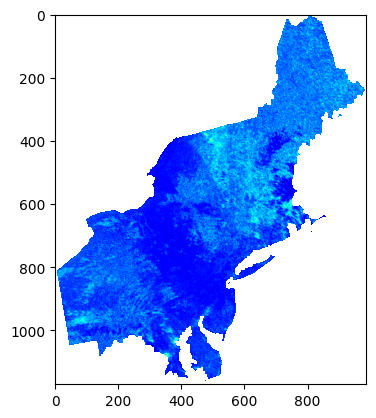

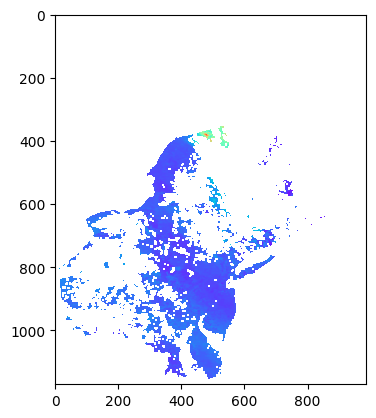

######### 221###############
0.09043673
0.44843927
0.00030813282
0.007576272
0.0
0.995


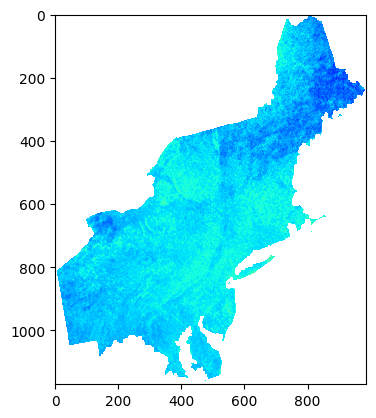

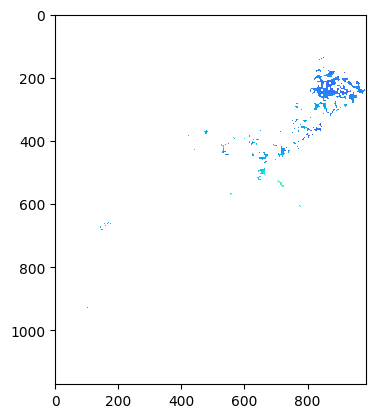

######### 222###############
0.07298899
0.36048174
0.00020070716
0.0048957015
0.0
0.437


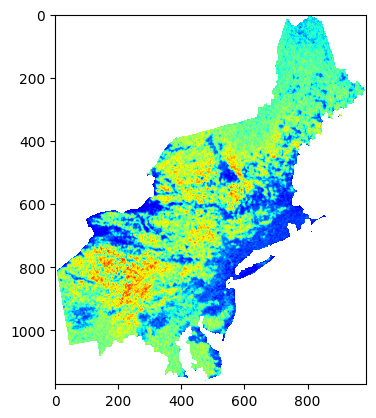

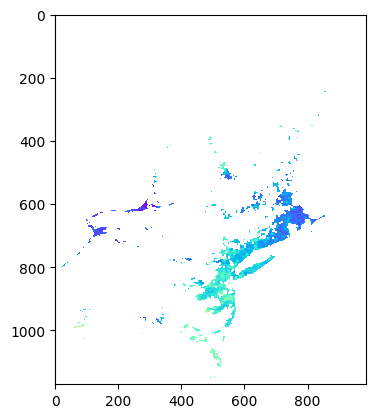

######### 223###############
0.09825998
0.3618418
0.00036374875
0.0049327123
0.0
0.521


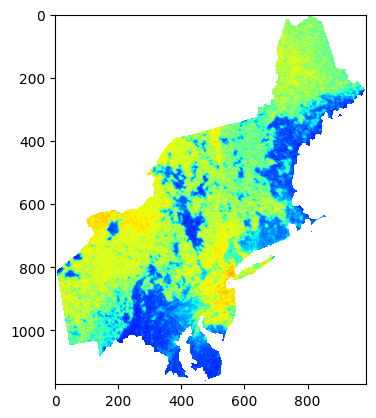

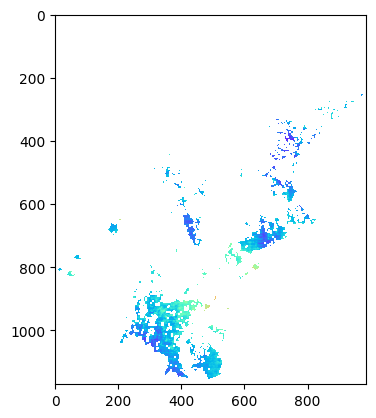

######### 224###############
0.07419211
0.37956446
0.00020737846
0.005427744
0.0
0.48


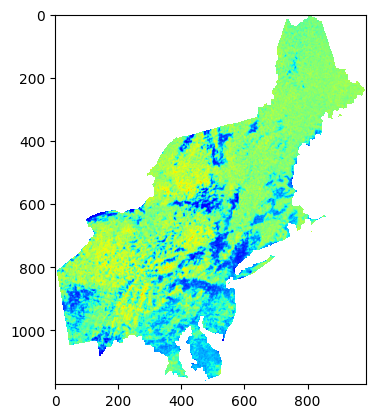

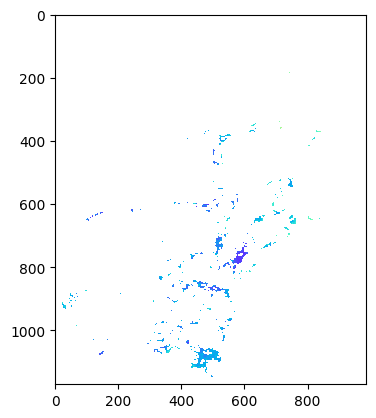

######### 225###############
0.070010655
0.3511641
0.00018466158
0.0046458854
0.0
0.437


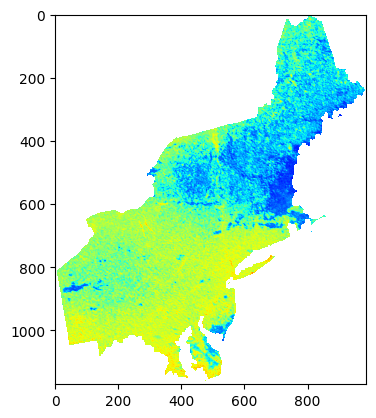

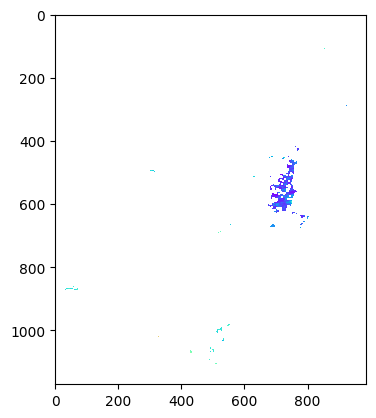

######### 226###############
0.10356012
0.41337508
0.00040404833
0.0064377896
0.0
0.48


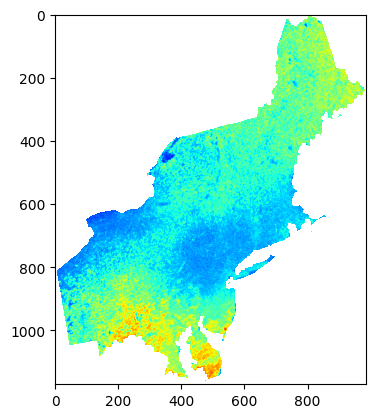

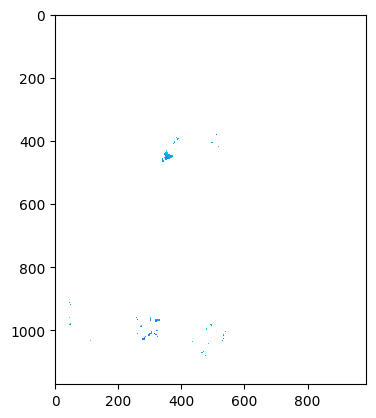

######### 227###############
0.052843124
0.421858
0.0001052023
0.0067047225
0.0
0.444


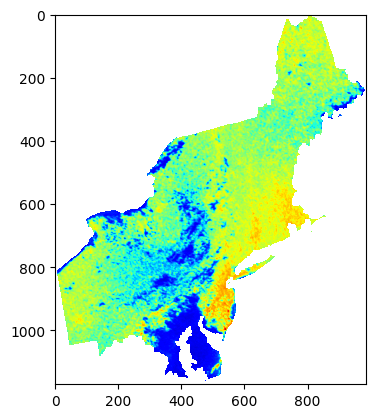

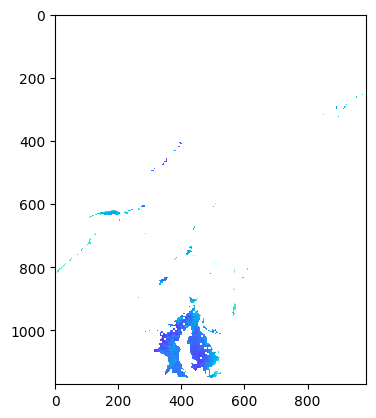

######### 228###############
0.039871633
0.34877712
5.989307e-05
0.0045829406
0.0
0.446


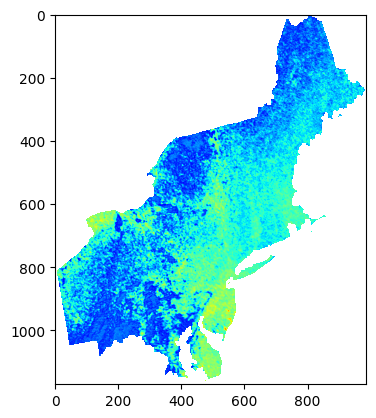

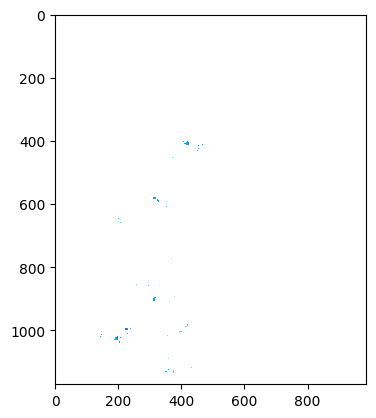

######### 229###############
0.06442257
0.36042336
0.0001563595
0.0048941136
0.0
0.546


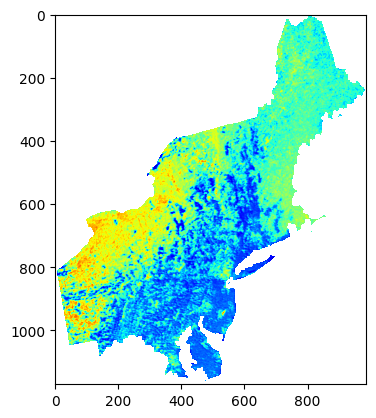

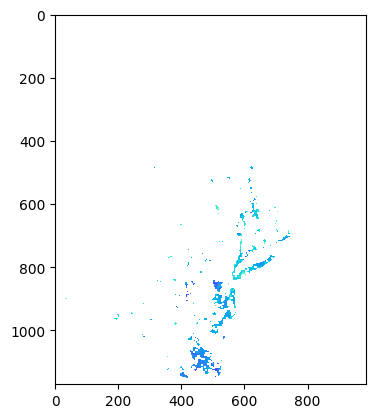

######### 230###############
0.07905924
0.38631728
0.00023547986
0.005622592
0.0
0.436


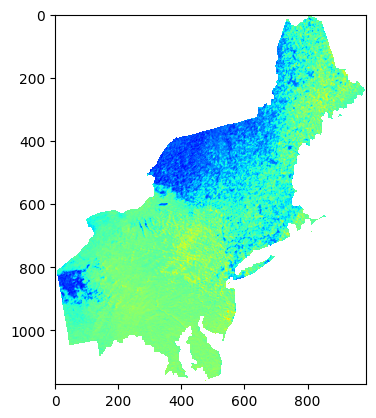

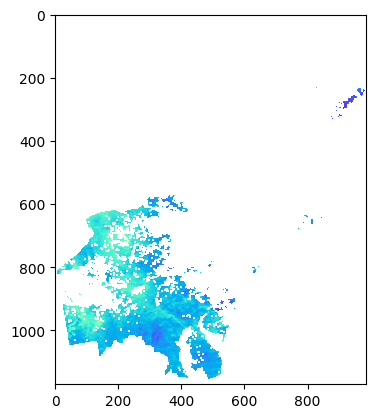

######### 231###############
0.059848174
0.35418552
0.00013494291
0.0047261766
0.0
0.62


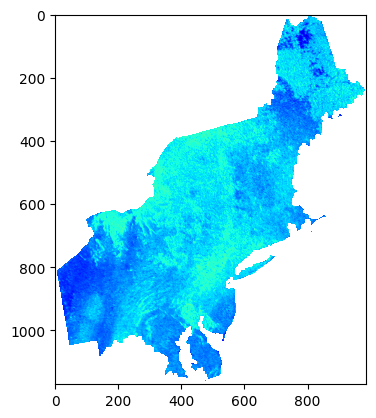

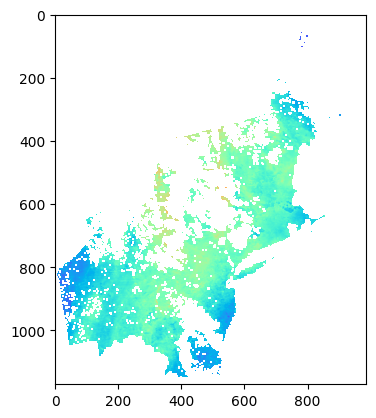

######### 232###############
0.07273024
0.44690168
0.00019928682
0.0075244075
0.0
0.585


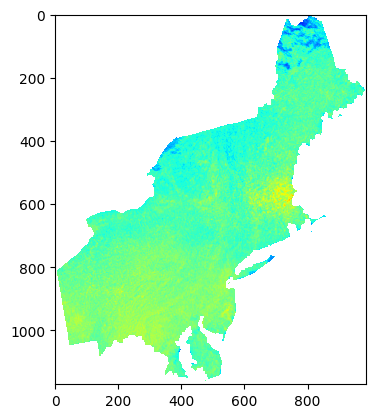

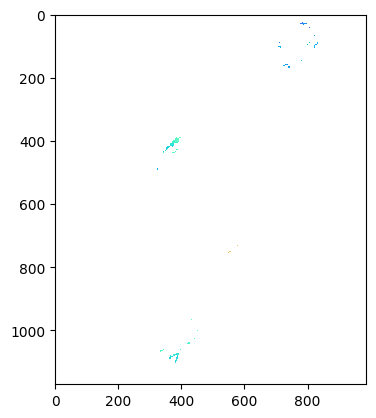

######### 233###############
0.07449162
0.4383264
0.00020905622
0.007238414
0.0
0.69


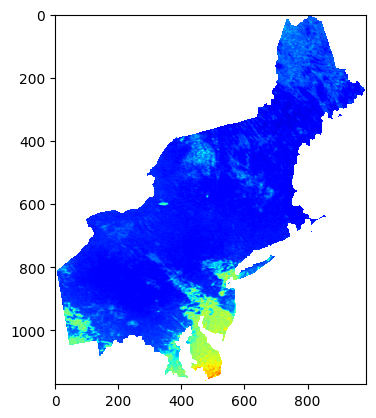

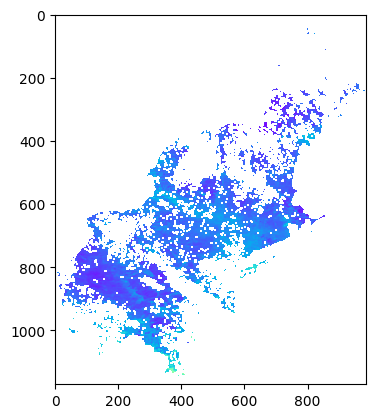

######### 234###############
0.08456448
0.44146365
0.0002694165
0.007342403
0.0
0.542


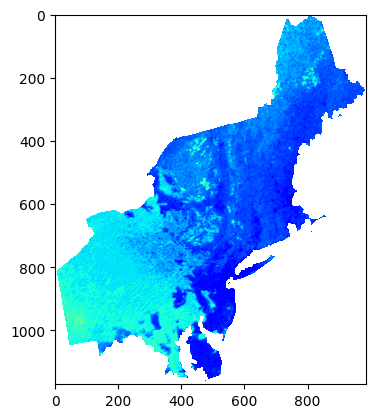

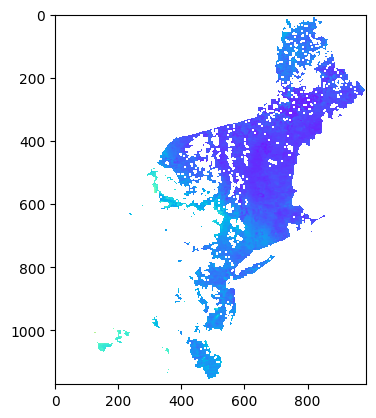

######### 235###############
0.053982675
0.42283106
0.000109788576
0.006735691
0.0
0.436


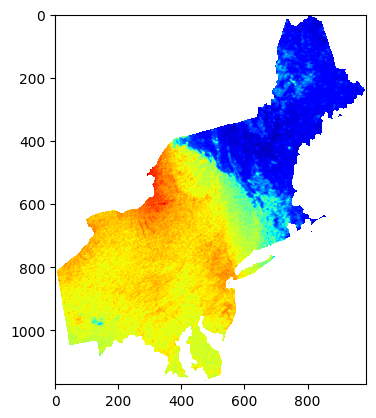

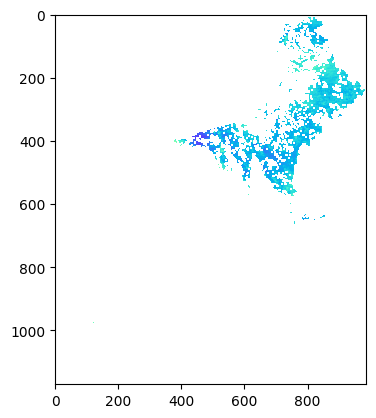

######### 236###############
0.07441062
0.3050472
0.00020860186
0.003505762
0.0
0.438


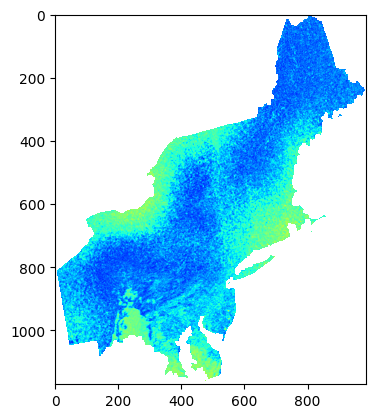

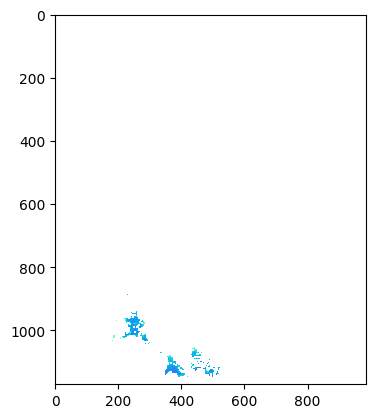

######### 237###############
0.09544659
0.41075915
0.00034321725
0.006356568
0.0
0.657


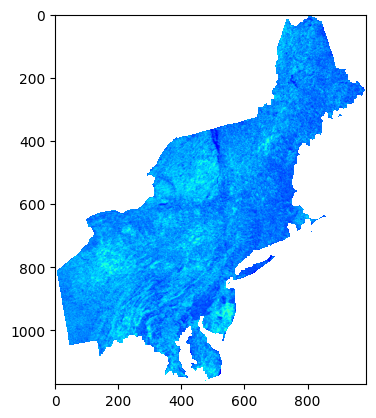

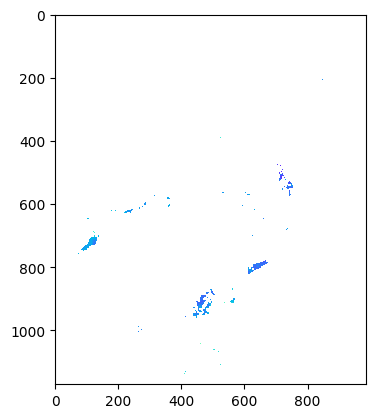

######### 238###############
0.049028445
0.32552615
9.056172e-05
0.003992271
0.0
1.03


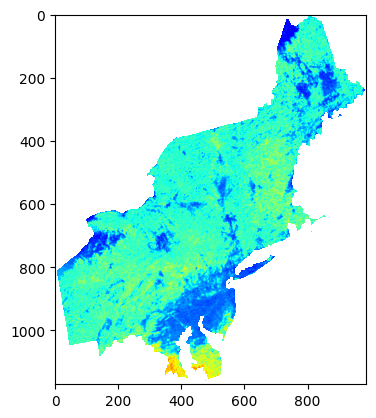

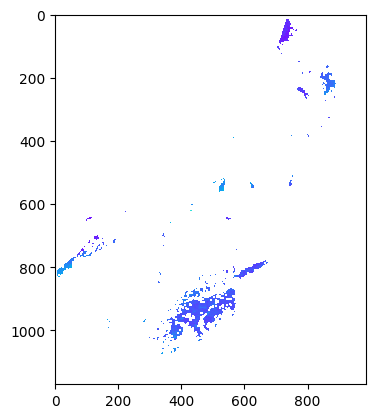

######### 239###############
0.07229535
0.4094866
0.00019691062
0.006317246
0.0
0.437


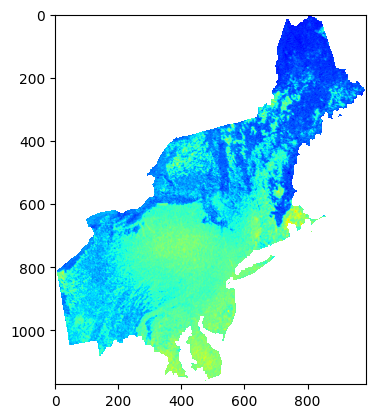

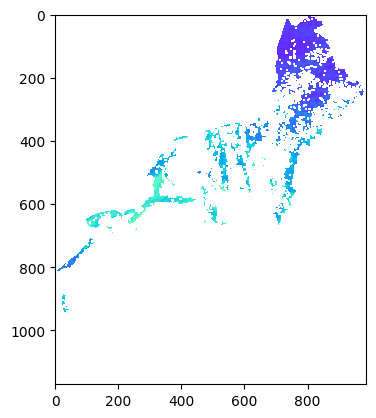

######### 240###############
0.1105454
0.60141754
0.0004603939
0.013627008
0.0
1.957


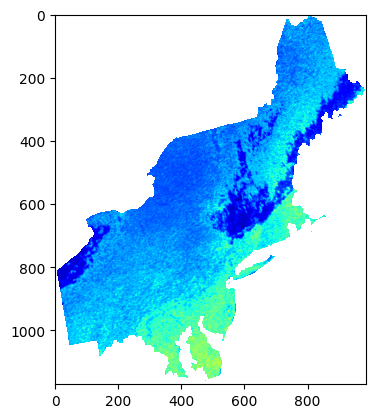

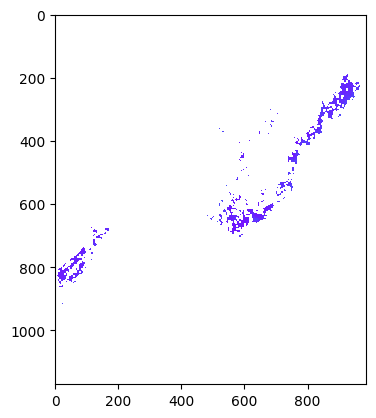

######### 241###############
0.0926221
0.49373412
0.00032320461
0.009184057
0.0
0.523


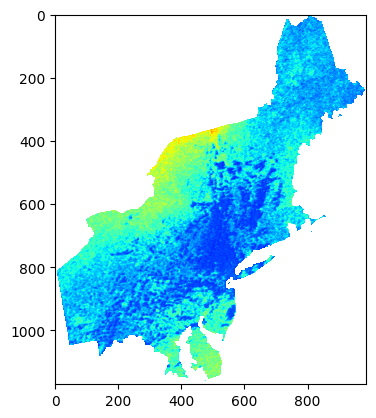

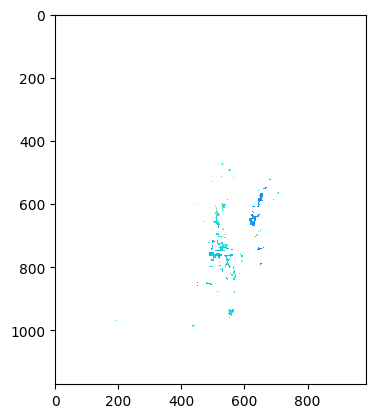

######### 242###############
0.08668965
0.59136623
0.00028312785
0.013175326
0.0
0.449


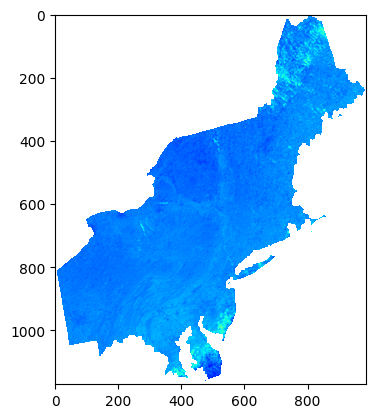

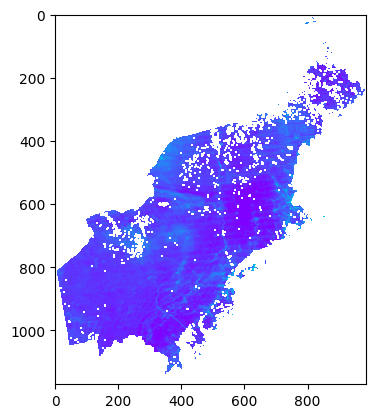

######### 243###############
0.030706473
0.34695107
3.5522873e-05
0.0045350785
0.0
0.396


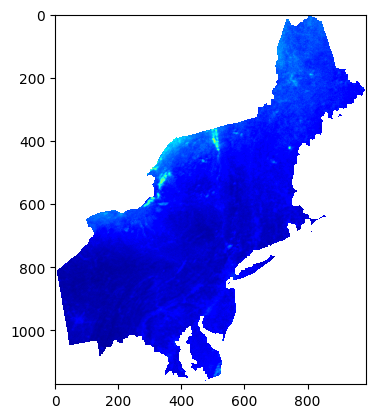

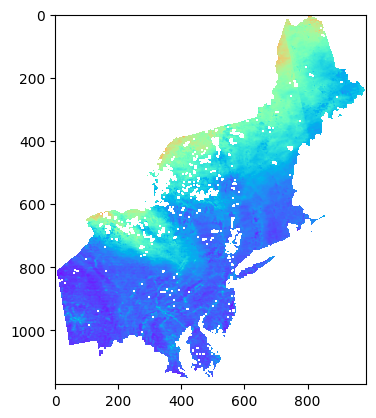

######### 244###############
0.08201465
0.22263677
0.00025341427
0.0018674203
0.0
0.434


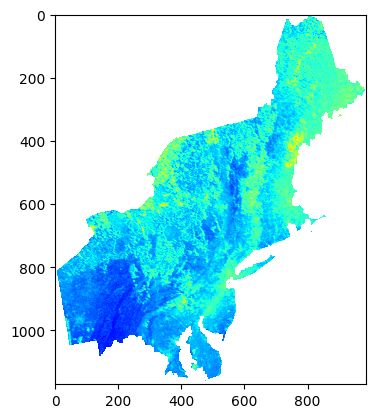

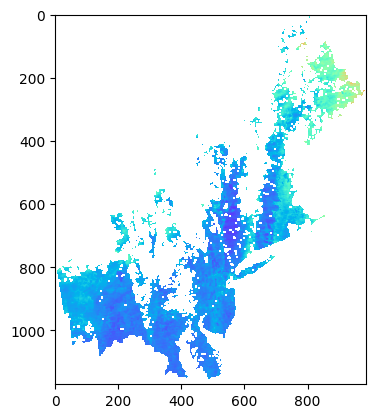

######### 245###############
0.07593806
0.3174199
0.00021725376
0.003795917
0.0
0.482


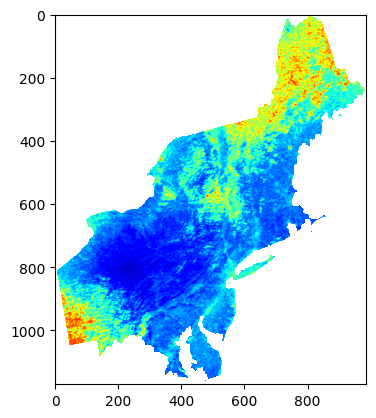

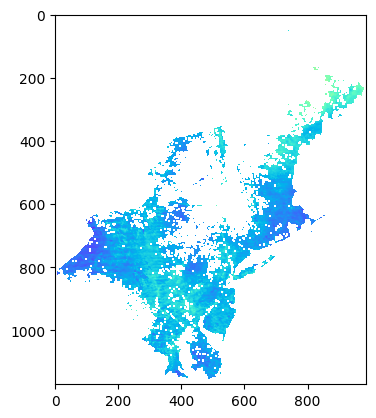

######### 246###############
0.025836855
0.1791285
2.5149397e-05
0.0012088649
0.0
0.478


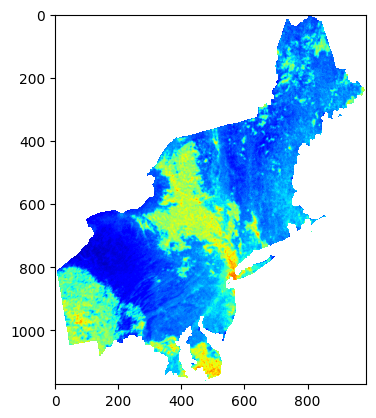

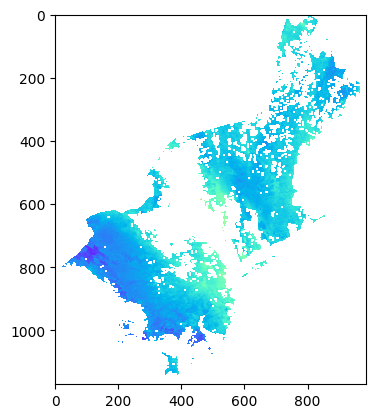

######### 247###############
0.07284014
0.4335397
0.00019988946
0.0070811873
0.0
1.234


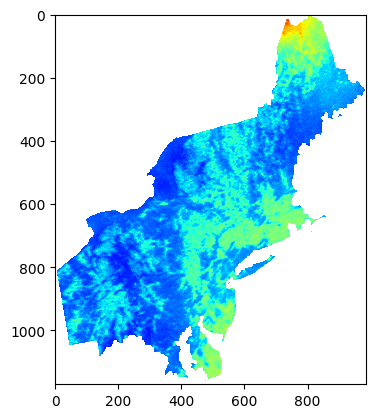

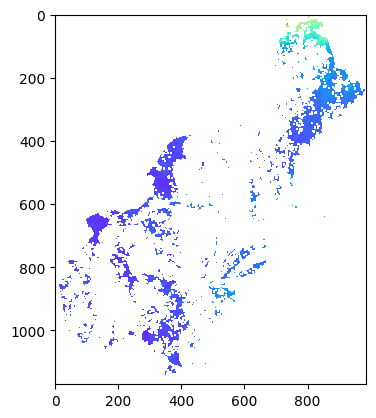

######### 248###############
0.039001822
1.0059793
5.730833e-05
0.03812645
0.0
1.214


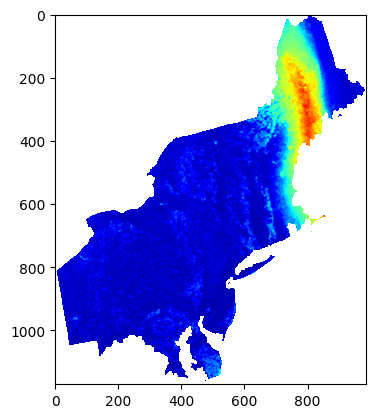

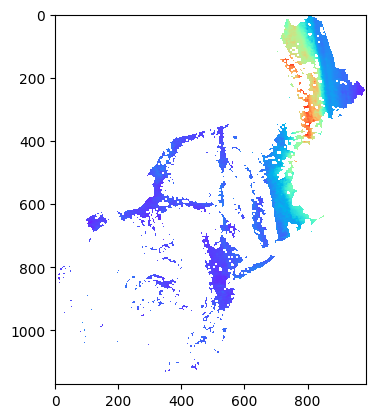

######### 249###############
0.05513169
0.29147667
0.00011451195
0.0032007813
0.0
0.45


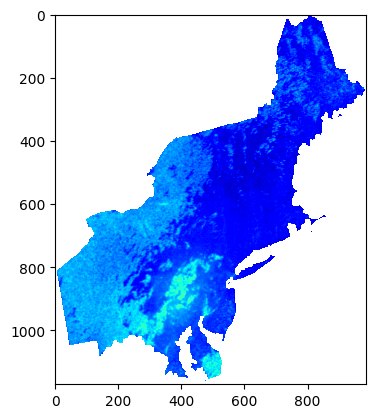

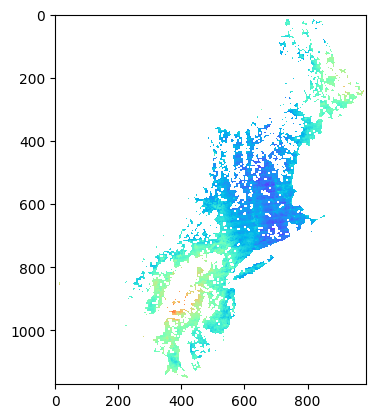

######### 250###############
0.18821177
0.44285357
0.0013345716
0.0073887086
0.0
0.687


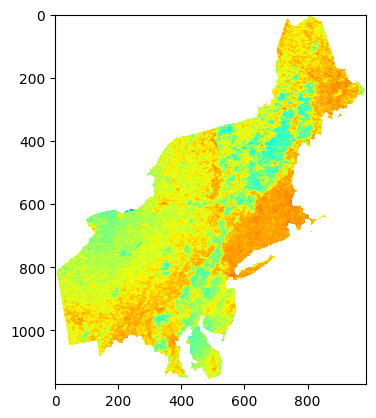

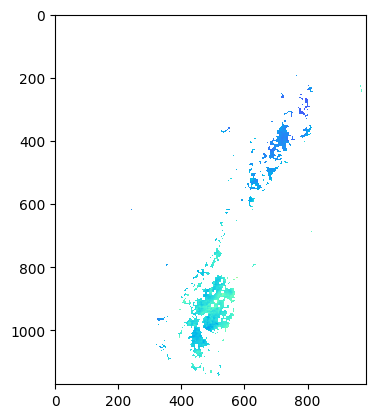

######### 251###############
0.06575145
0.7752242
0.00016287665
0.022641387
0.0
0.52


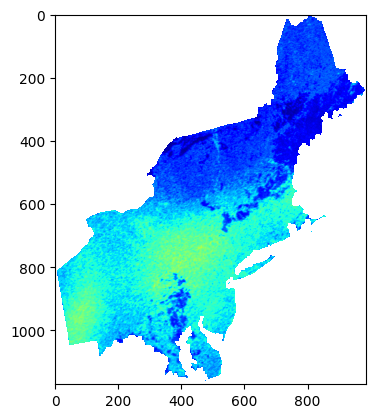

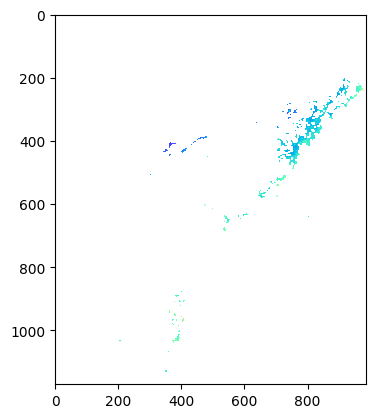

######### 252###############
0.045603357
0.3481382
7.8350524e-05
0.004566166
0.0
0.547


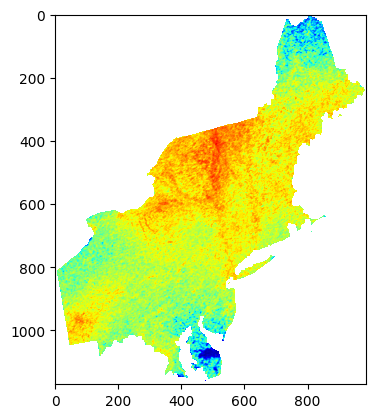

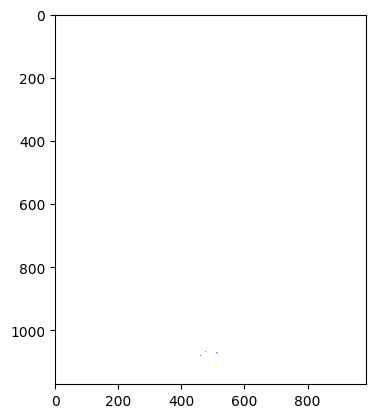

######### 253###############
0.0850393
0.32197088
0.00027245056
0.0039055427
0.0
0.449


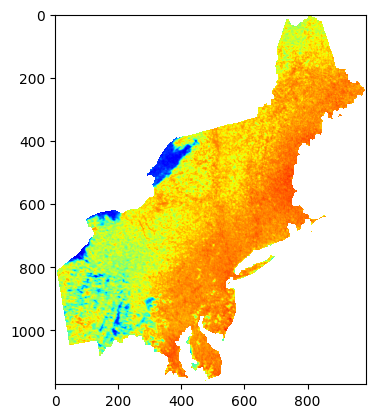

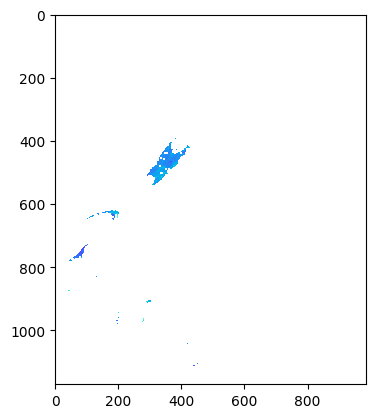

######### 254###############
0.06935874
0.32909185
0.00018123856
0.004080211
0.0
0.423


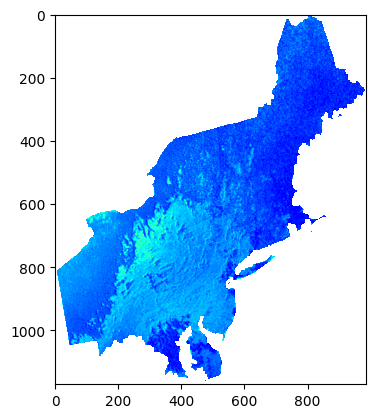

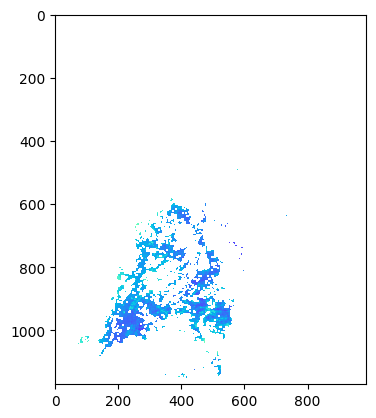

######### 255###############
0.11924262
0.3553673
0.00053568726
0.004757768
0.0
0.436


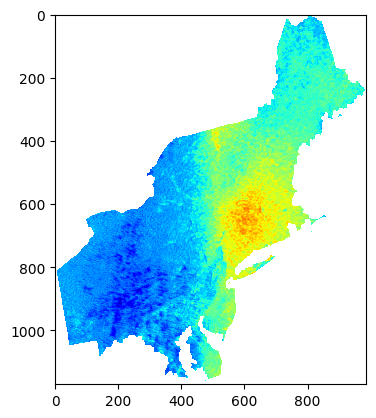

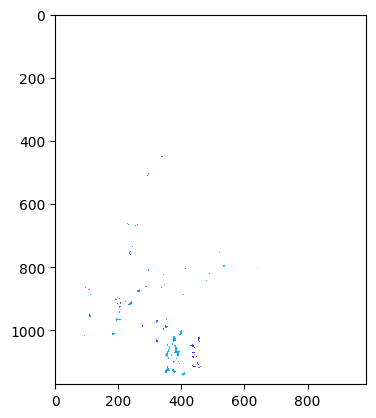

######### 256###############
0.040148932
0.43896282
6.072903e-05
0.0072594522
0.0
0.437


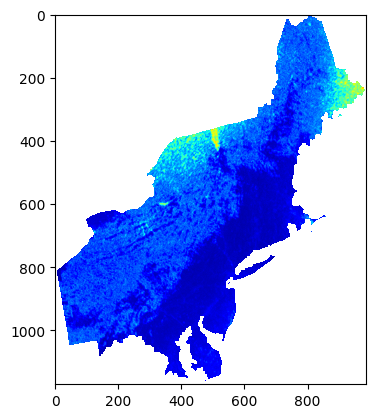

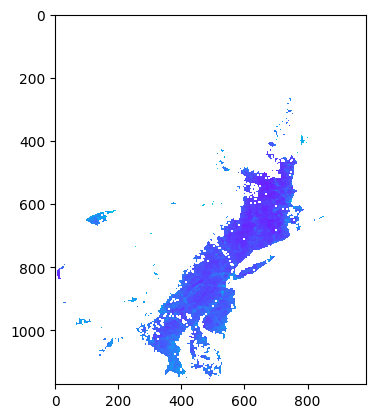

######### 257###############
0.03698051
0.29541314
5.152216e-05
0.003287819
0.0
0.434


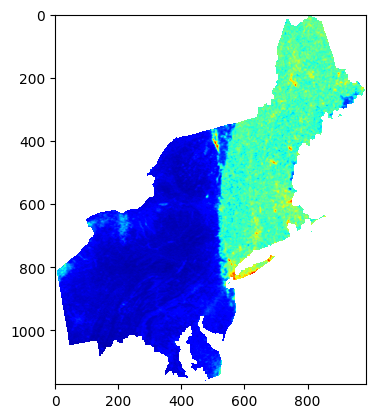

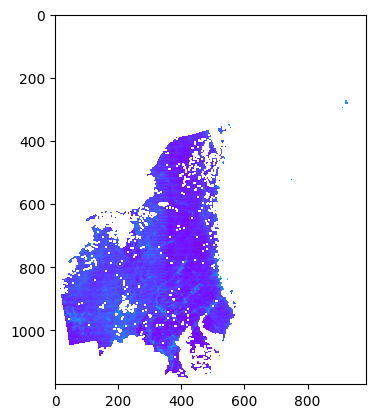

######### 258###############
0.03468895
0.38155764
4.5334702e-05
0.0054848986
0.0
0.412


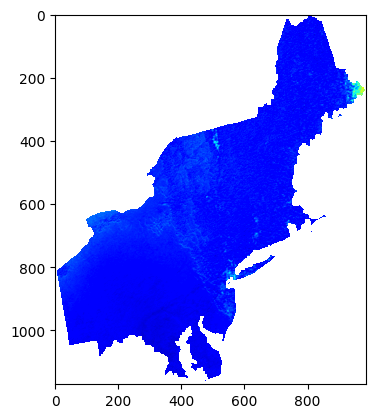

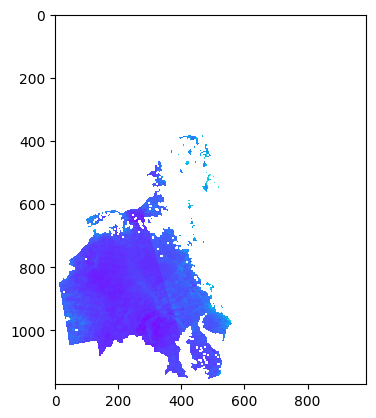

######### 259###############
0.028559
0.42013937
3.072799e-05
0.0066502057
0.0
0.403


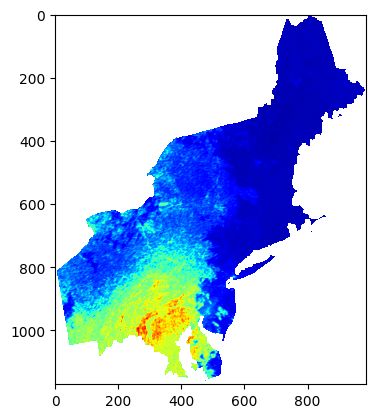

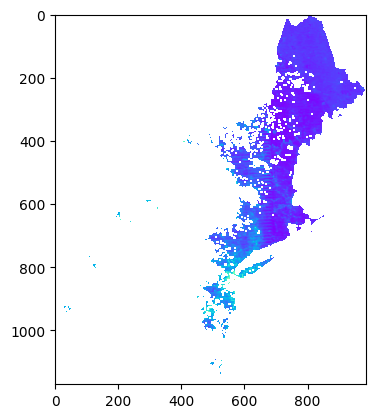

######### 260###############
0.02505073
0.26102227
2.3642237e-05
0.0025668673
0.0
0.438


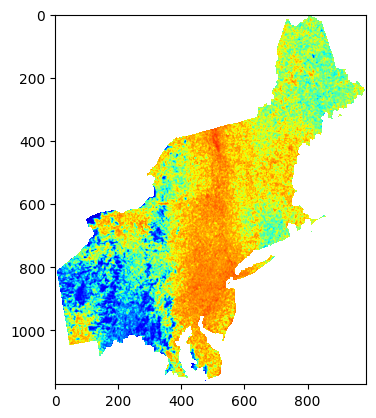

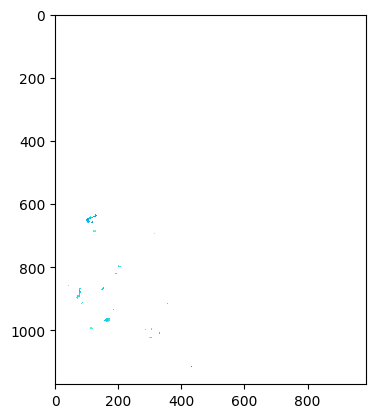

######### 261###############
0.04665342
0.27796715
8.200028e-05
0.0029109528
0.0
0.625


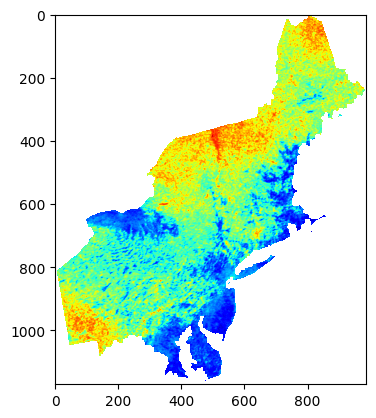

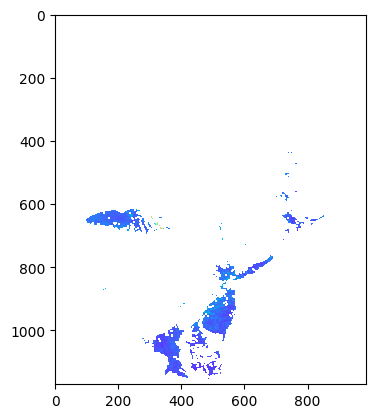

######### 262###############
0.060137108
0.36457193
0.00013624903
0.0050074286
0.0
0.437


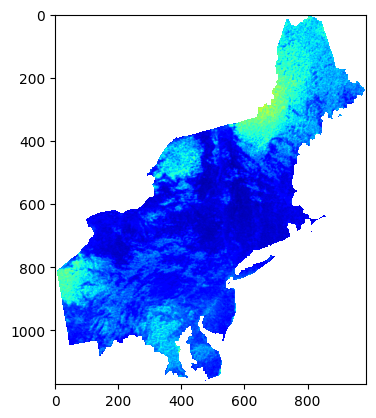

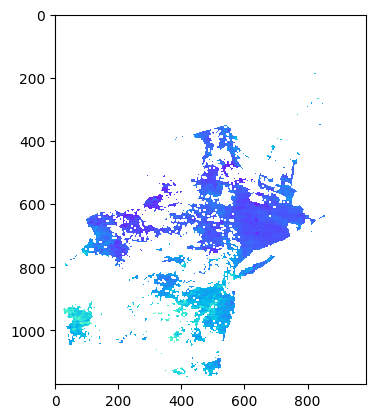

######### 263###############
0.047502182
0.428492
8.501105e-05
0.0069172545
0.0
0.438


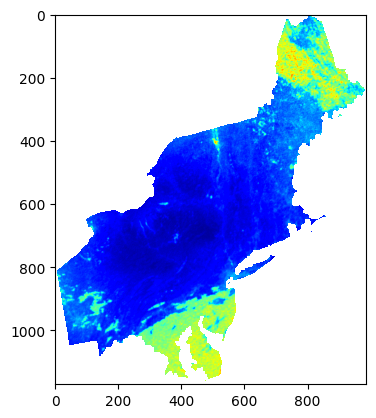

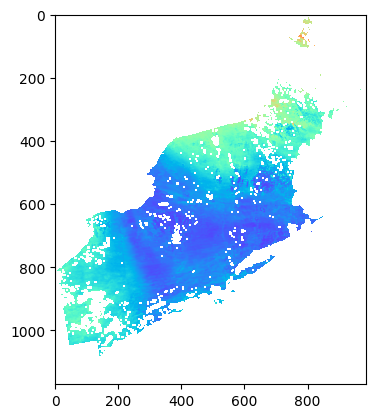

######### 264###############
0.05567388
0.264902
0.00011677536
0.002643741
0.0
0.528


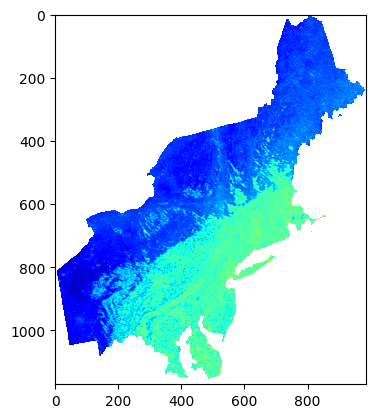

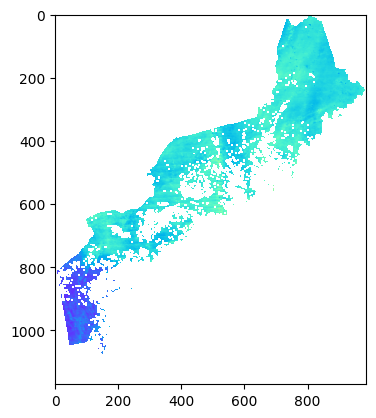

######### 265###############
0.06663886
0.29217583
0.00016730282
0.0032161535
0.0
0.435


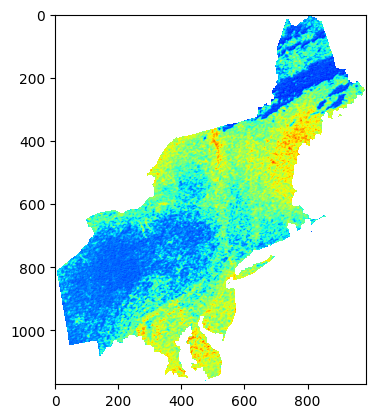

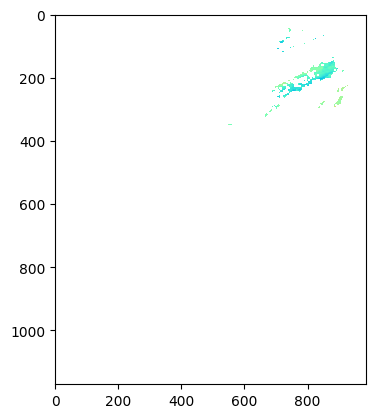

######### 266###############
0.07085532
0.24770322
0.00018914424
0.0023115943
0.0
0.402


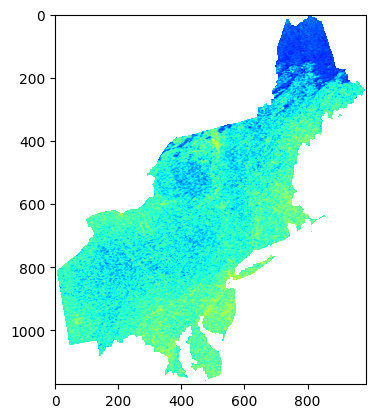

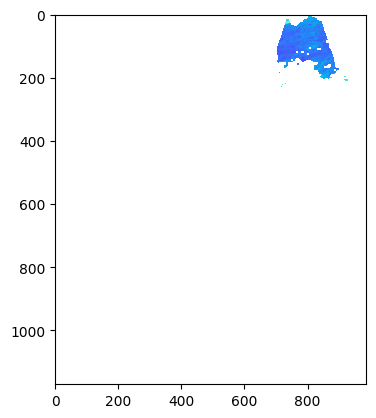

######### 267###############
0.07662208
0.3263052
0.0002211853
0.0040114033
0.0
0.753


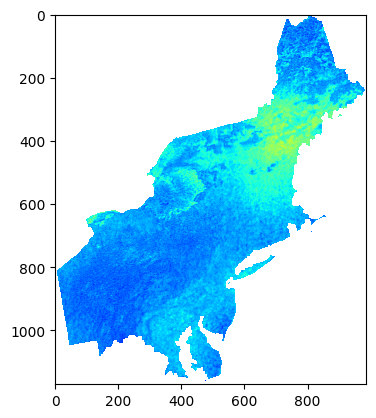

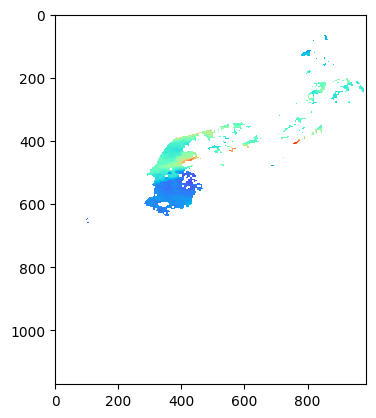

######### 268###############
0.086259276
0.7930143
0.0002803238
0.02369247
0.0
0.772


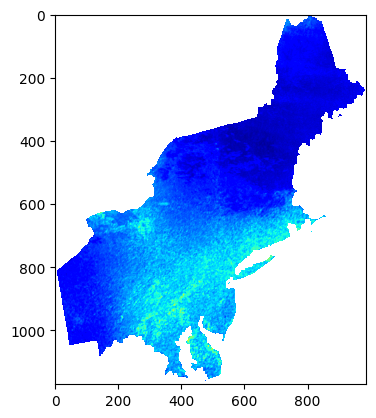

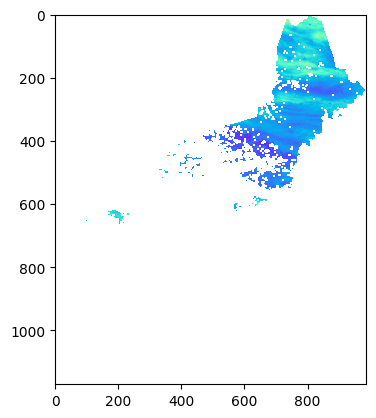

######### 269###############
0.02232106
0.39901698
1.8770588e-05
0.005998339
0.0
1.883


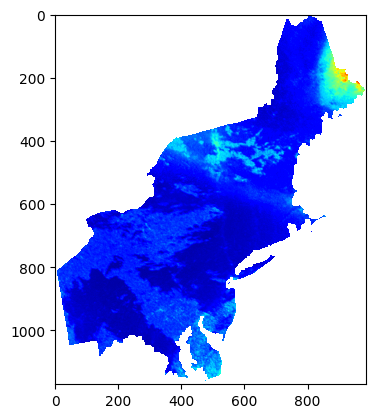

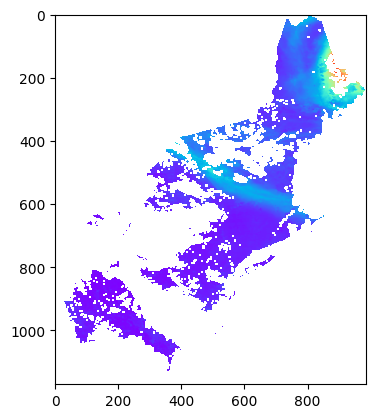

######### 270###############
0.08396292
2.221681
0.00026559702
0.18595664
0.0
2.0745


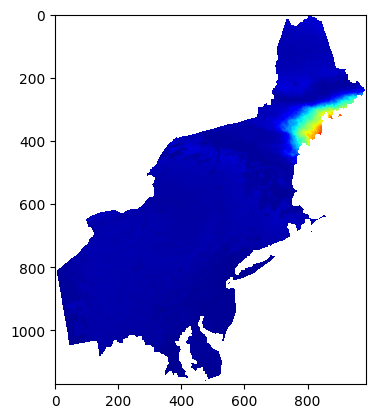

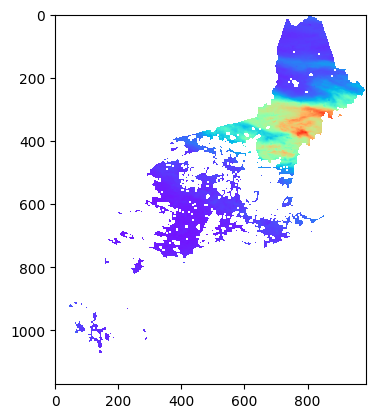

######### 271###############
0.09594929
3.554742
0.00034684213
0.47606295
0.0
2.587


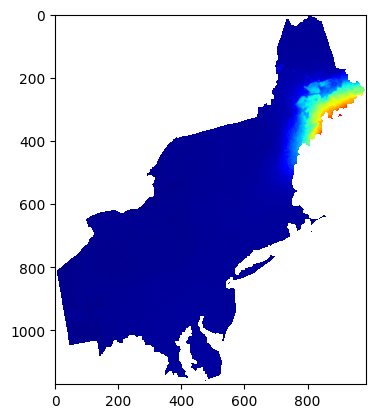

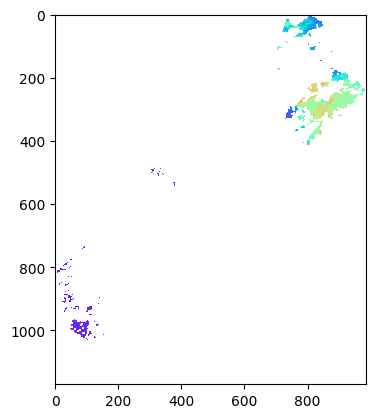

######### 272###############
0.051670358
1.8865676
0.00010058454
0.13408896
0.0
3.164


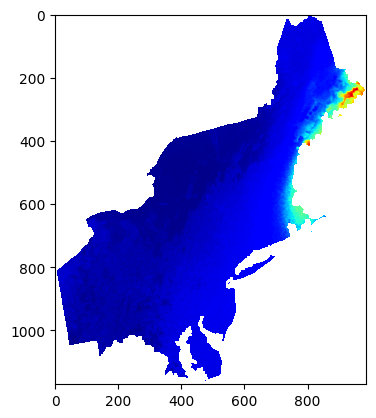

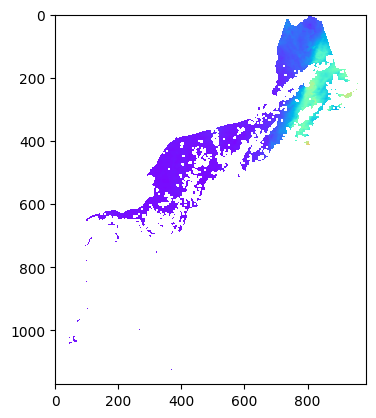

######### 273###############
0.089215636
3.3788042
0.000299868
0.4301049
0.0
2.264


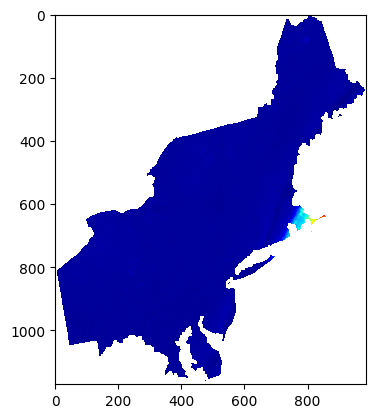

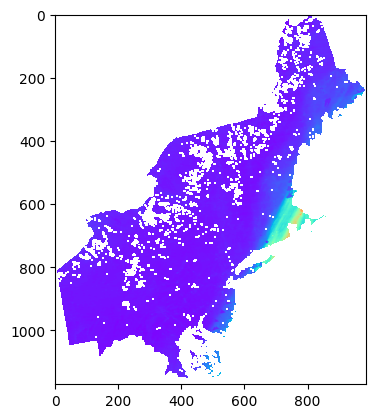

######### 274###############
0.027264941
0.76708436
2.8006412e-05
0.02216841
0.0
0.332


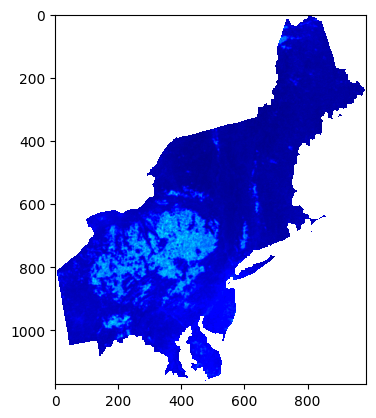

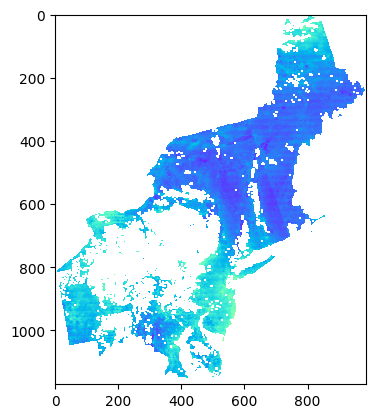

######### 275###############
0.0262608
0.21995035
2.5981502e-05
0.0018226262
0.0
0.824


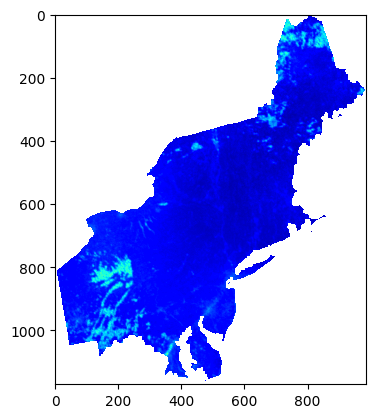

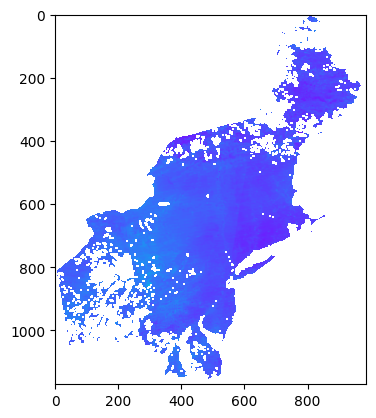

######### 276###############
0.06832887
0.46476328
0.00017589636
0.008137892
0.0
0.386


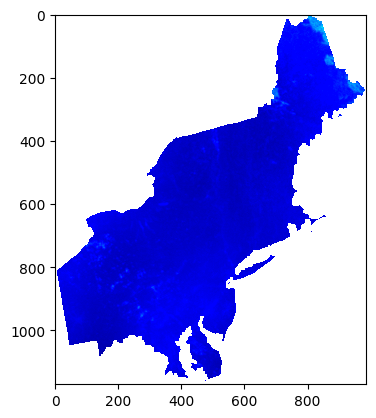

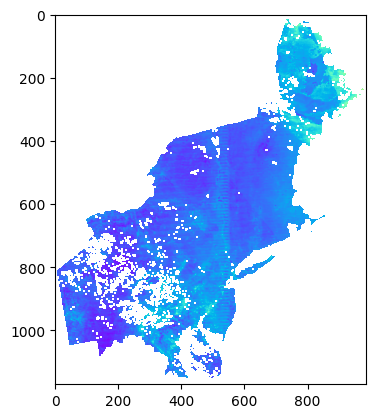

######### 277###############
0.053710967
0.45823938
0.00010868614
0.00791103
0.0
0.416


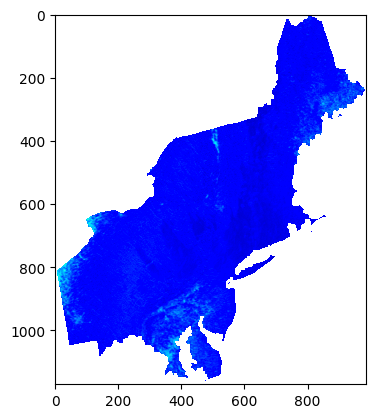

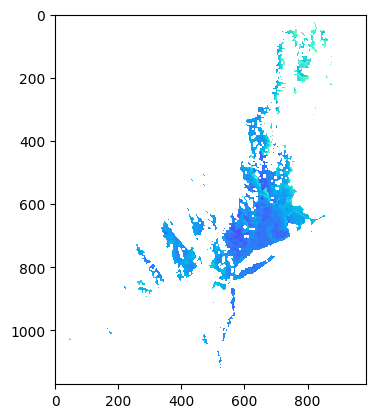

######### 278###############
0.07792888
0.9043076
0.00022879434
0.030809218
0.0
0.436


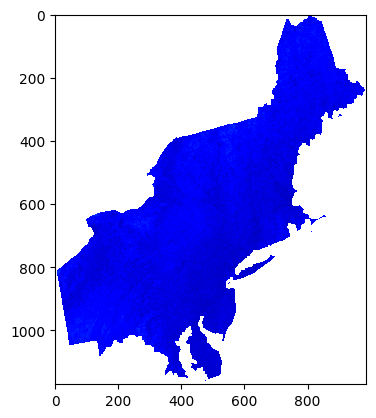

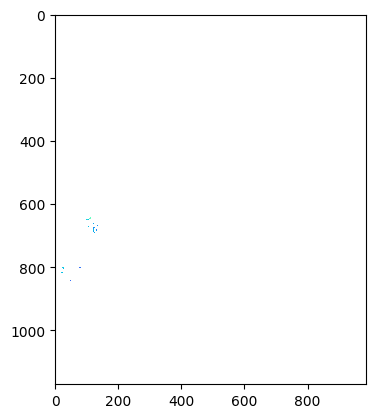

######### 279###############
0.061085895
0.41200256
0.00014058218
0.0063951137
0.0
0.443


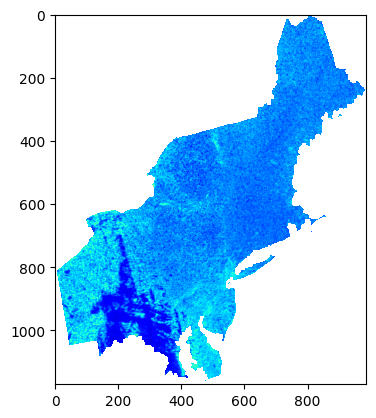

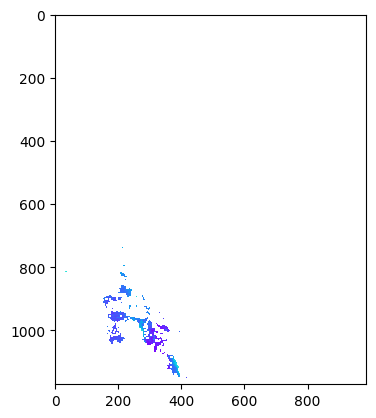

######### 280###############
0.03822226
0.7720964
5.504034e-05
0.02245905
0.0
0.435


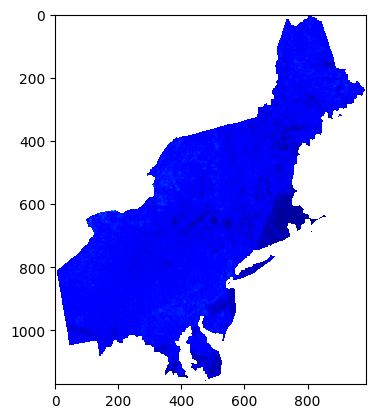

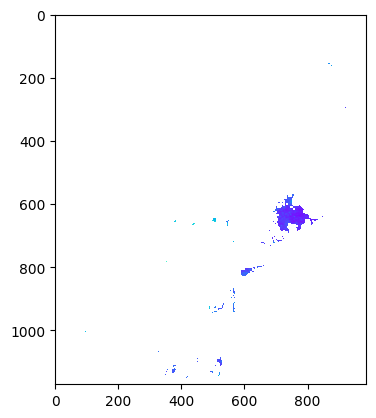

######### 281###############
0.082122445
0.76031816
0.00025408083
0.021779057
0.0
0.432


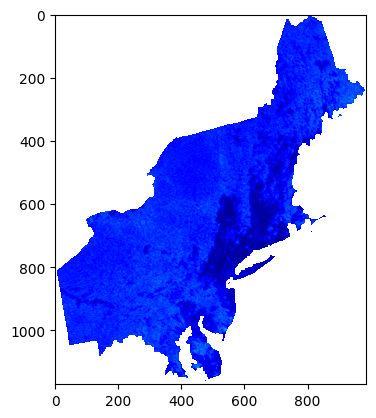

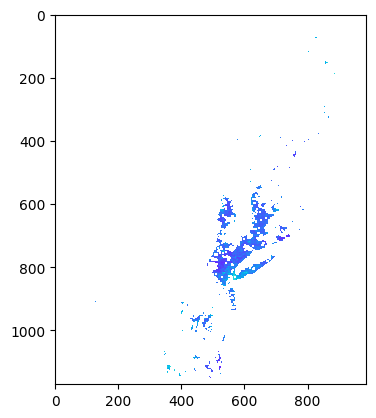

######### 282###############
0.042937145
0.5866641
6.945677e-05
0.012966635
0.0
0.418


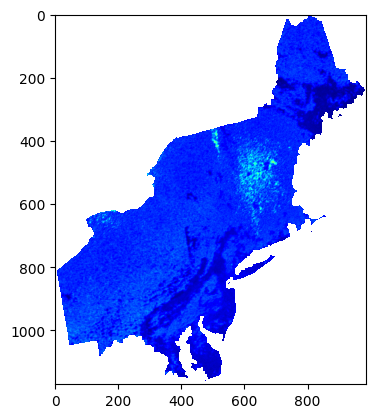

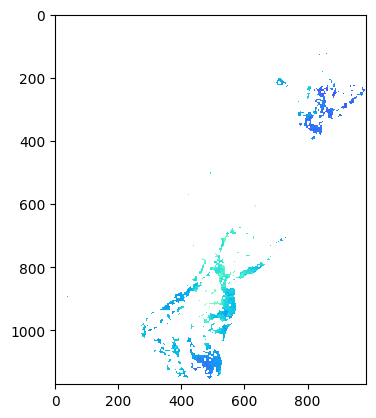

######### 283###############
0.04987733
0.45757258
9.3724826e-05
0.007888025
0.0
0.436


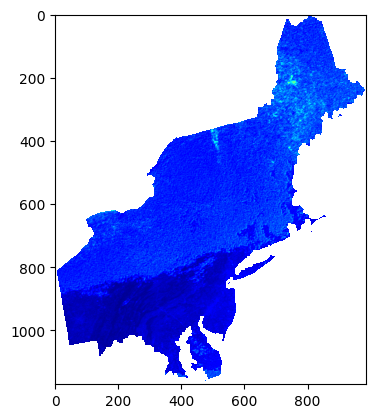

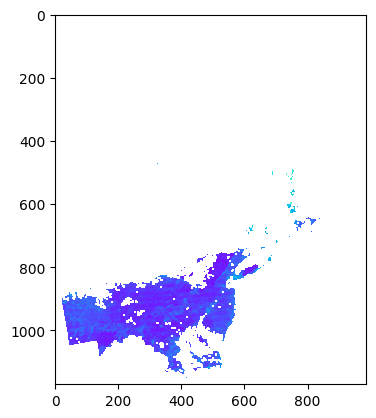

######### 284###############
0.09435244
0.88753426
0.00033539344
0.0296769
0.0
0.411


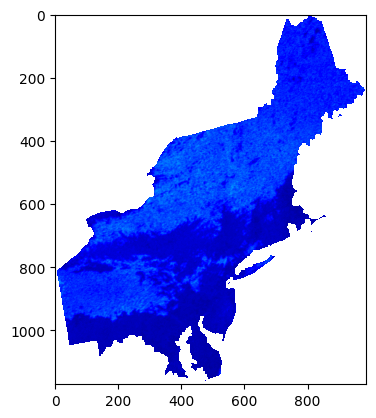

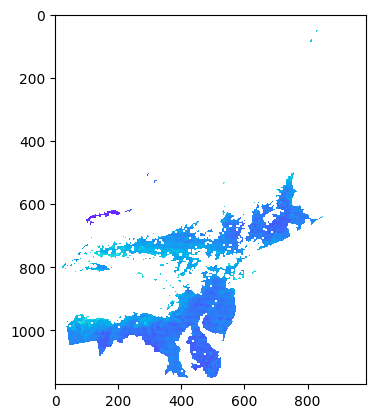

######### 285###############
0.10319355
0.7319808
0.00040119304
0.020185884
0.0
0.431


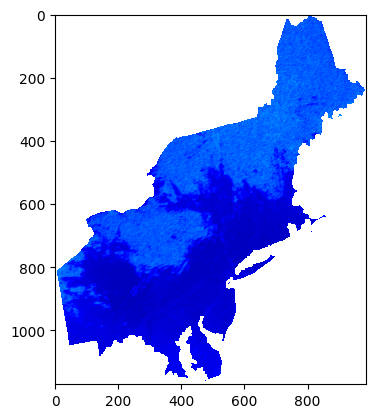

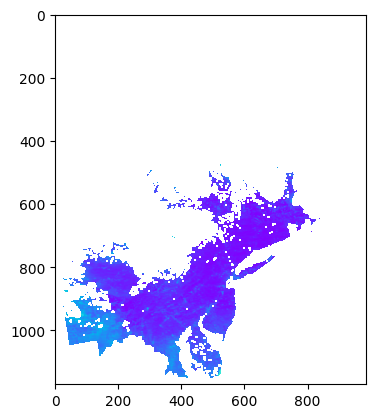

######### 286###############
0.044359334
0.46637496
7.4134165e-05
0.00819443
0.0
0.417


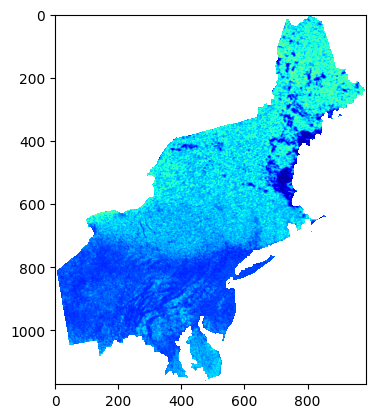

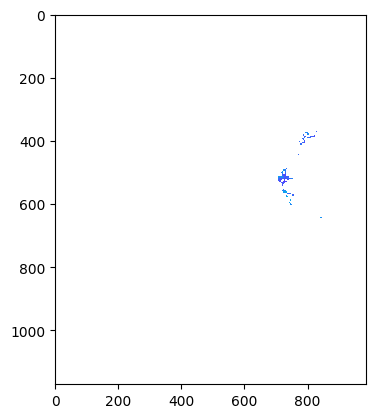

######### 287###############
0.05197271
0.41970003
0.000101765116
0.0066363043
0.0
0.488


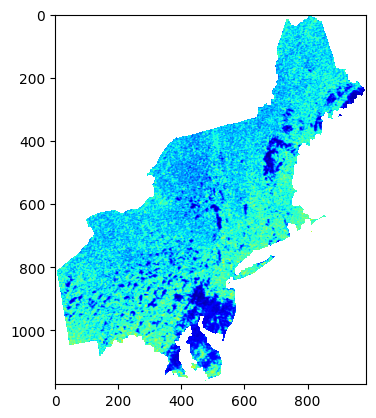

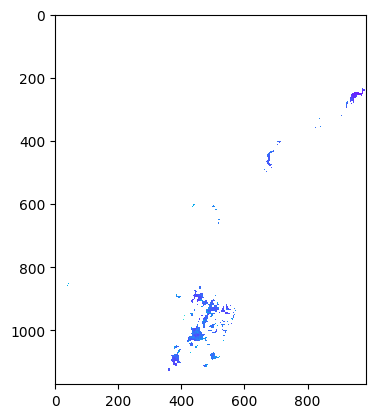

######### 288###############
0.04357442
0.39220446
7.153384e-05
0.005795266
0.0
0.434


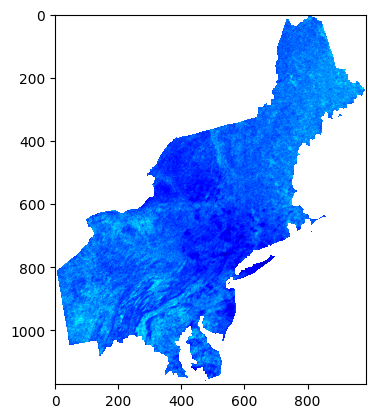

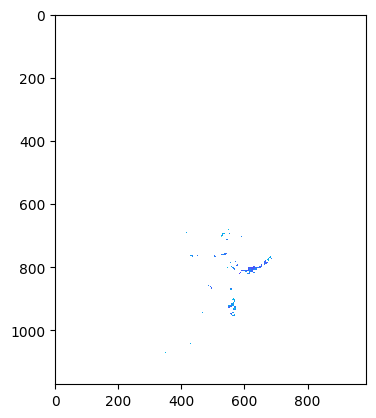

######### 289###############
0.020257816
0.32200062
1.546086e-05
0.003906266
0.0
0.436


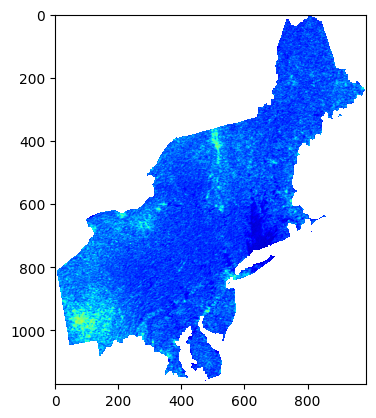

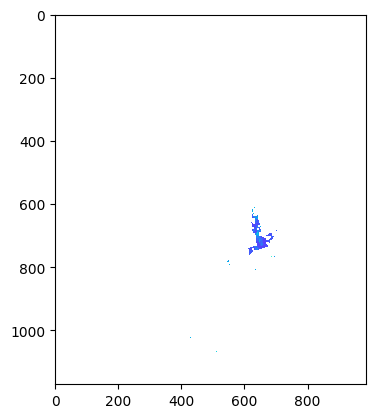

######### 290###############
0.03789653
0.7835802
5.4106215e-05
0.023132106
0.0
0.434


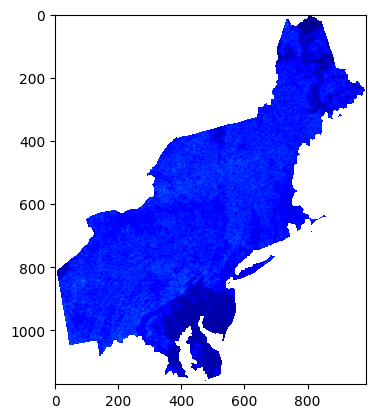

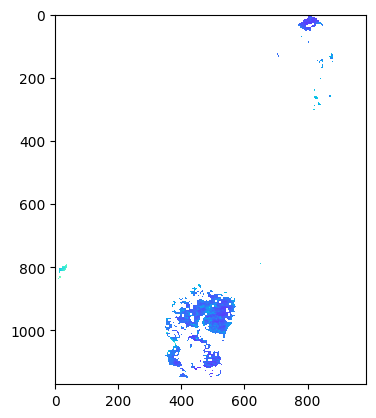

######### 291###############
0.02282463
0.26451737
1.962707e-05
0.0026360678
0.0
0.405


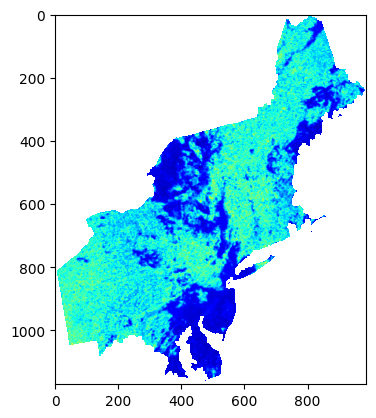

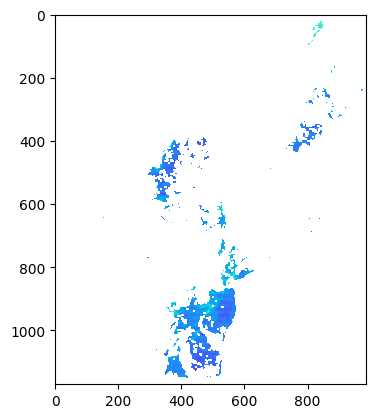

######### 292###############
0.054736525
0.72560894
0.00011287631
0.01983598
0.0
0.436


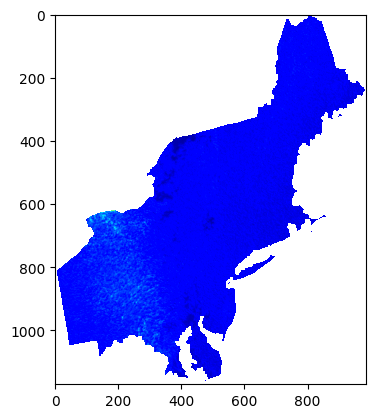

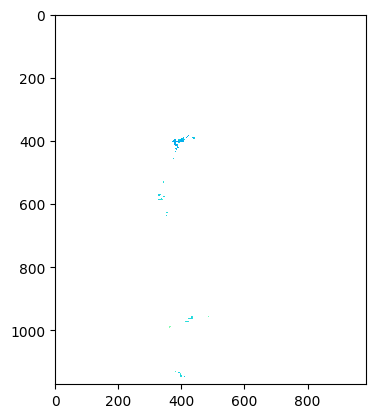

######### 293###############
0.030523196
0.63005555
3.510012e-05
0.014955672
0.0
0.436


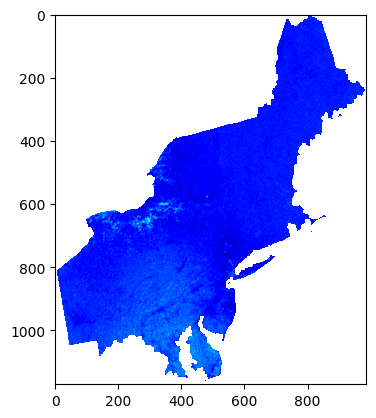

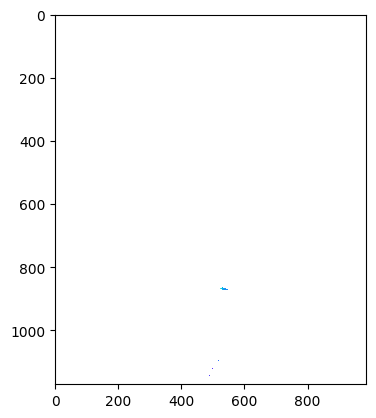

######### 294###############
0.042737745
0.44500157
6.881316e-05
0.0074605606
0.0
0.406


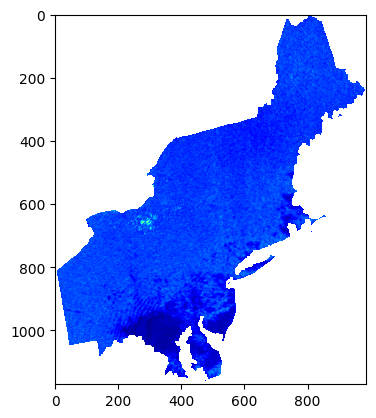

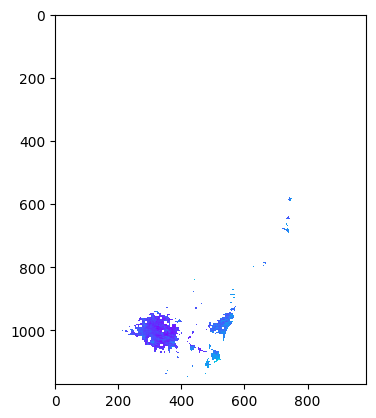

######### 295###############
0.020011153
0.24968195
1.5086642e-05
0.0023486735
0.0
0.431


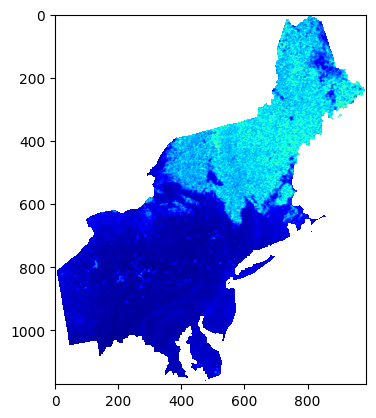

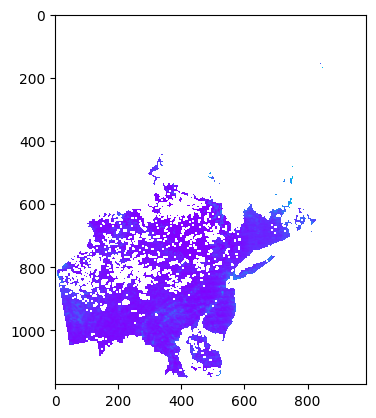

######### 296###############
0.033171926
0.6876077
4.1456216e-05
0.017812701
0.0
0.437


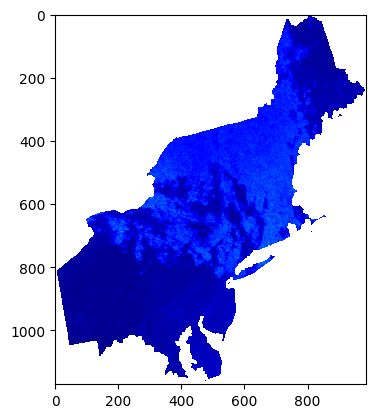

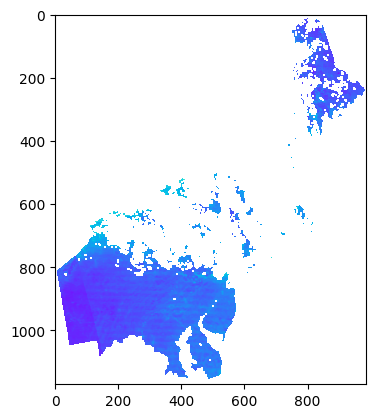

######### 297###############
0.040675487
0.5890599
6.2332394e-05
0.013072756
0.0
0.545


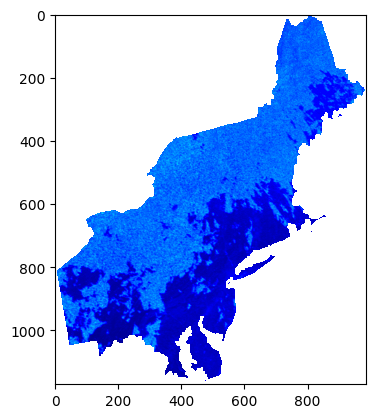

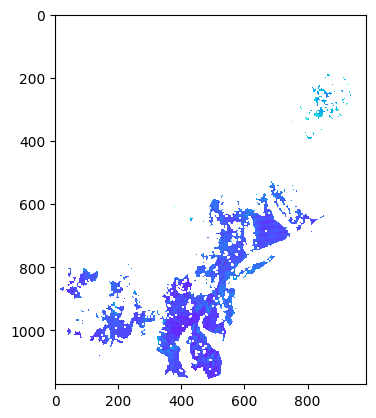

######### 298###############
0.039056927
0.67944777
5.7470425e-05
0.017392442
0.0
0.44


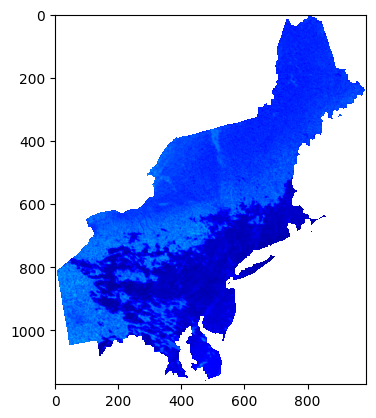

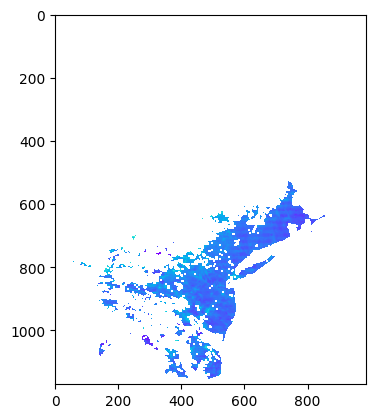

######### 299###############
0.05163402
0.6403841
0.00010044312
0.015450028
0.0
0.376


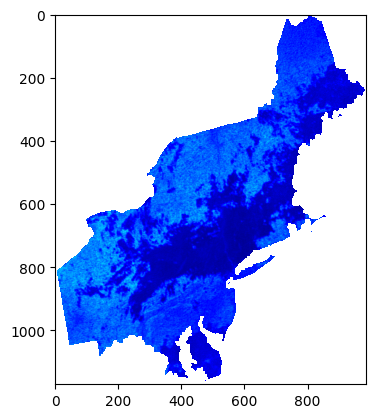

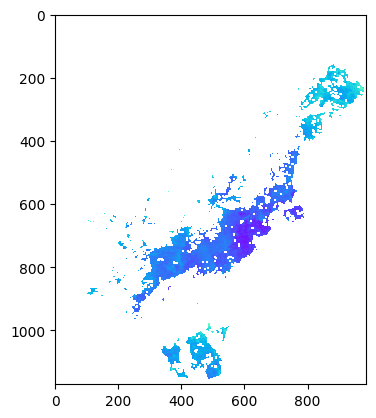

######### 300###############
0.03784401
0.4356202
5.3956355e-05
0.0071493126
0.0
0.734


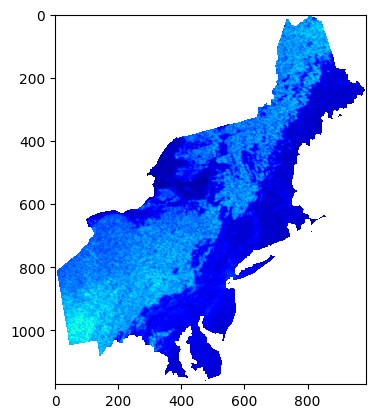

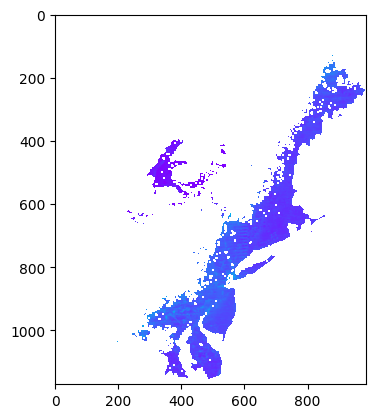

######### 301###############
0.05140692
0.77474856
9.9561505e-05
0.02261361
0.0
0.424


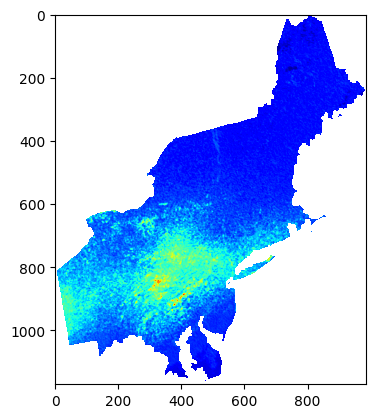

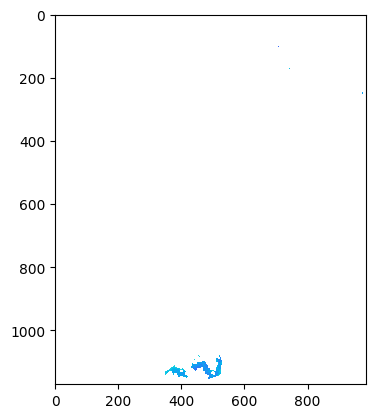

######### 302###############
0.04749114
0.40714407
8.497154e-05
0.006245173
0.0
0.428


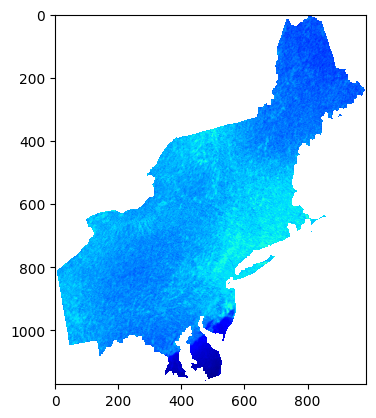

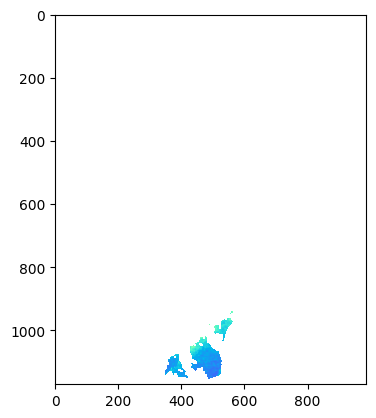

######### 303###############
0.08336657
0.9644867
0.0002618378
0.035046186
0.0
0.722


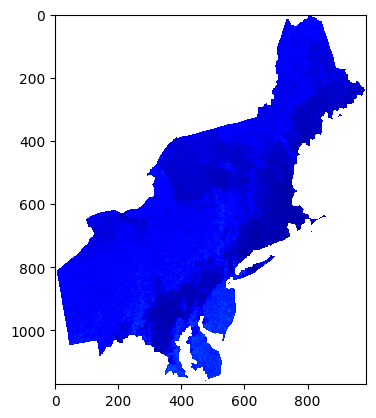

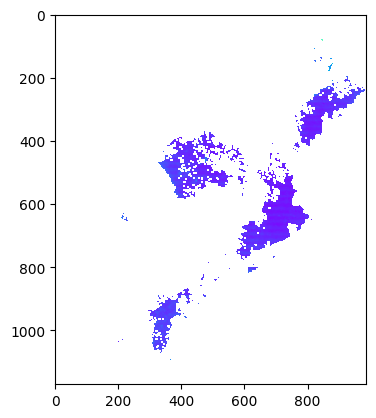

######### 304###############
0.05430162
0.6238129
0.00011108971
0.0146607775
0.0
0.515


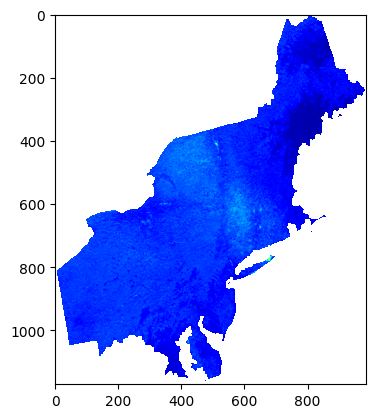

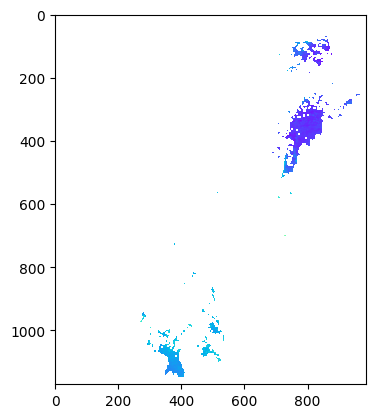

######### 305###############
0.079049565
0.72838944
0.00023542212
0.019988287
0.0
0.465


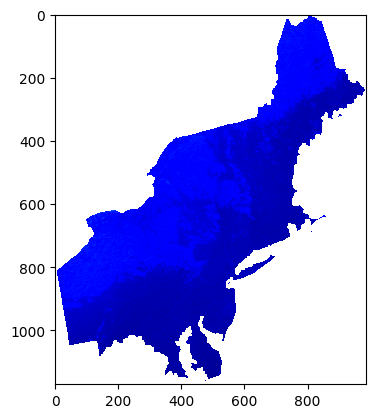

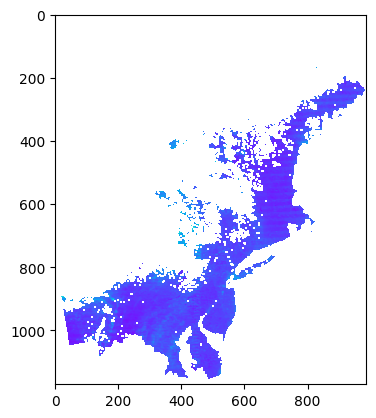

######### 306###############
0.05152291
0.5327969
0.0001000113
0.010694776
0.0
0.684


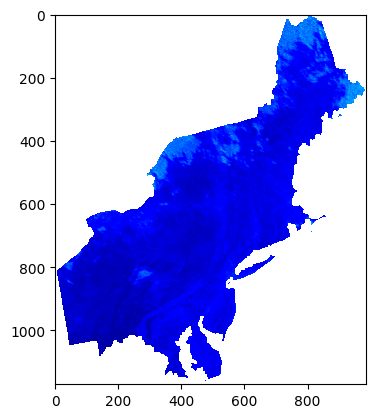

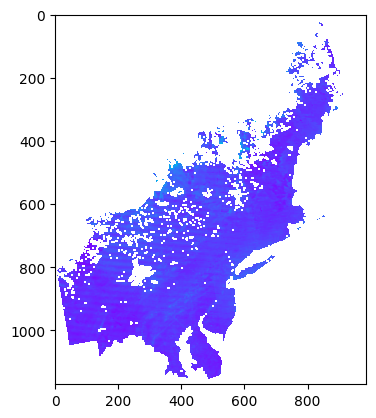

######### 307###############
0.042740285
0.4678927
6.882132e-05
0.008247852
0.0
0.433


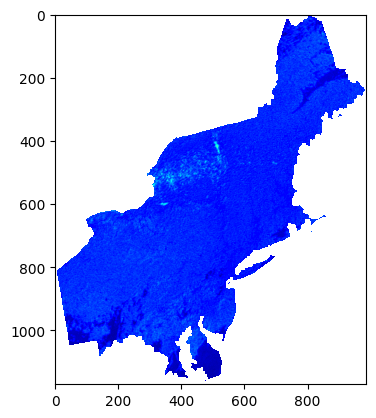

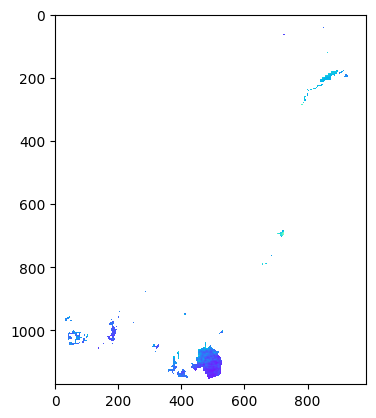

######### 308###############
0.064051226
0.53046364
0.00015456216
0.01060131
0.0
0.424


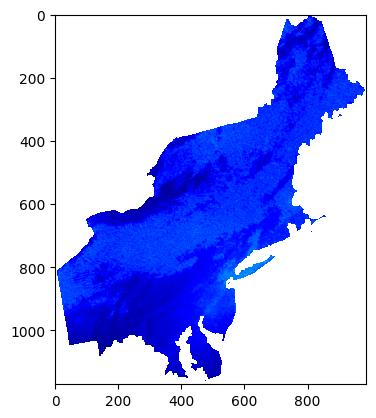

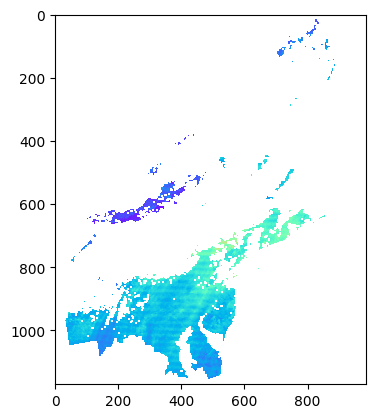

######### 309###############
0.04561274
0.45031738
7.838277e-05
0.0076398654
0.0
0.333


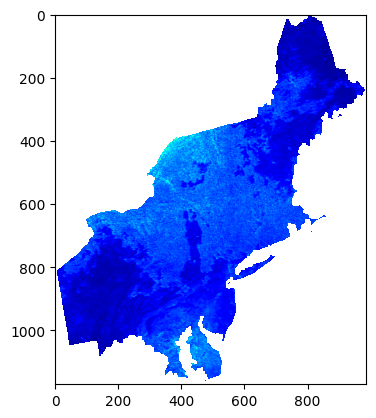

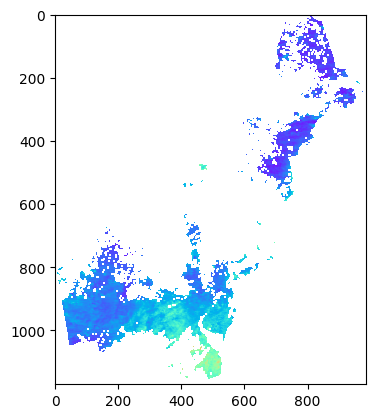

######### 310###############
0.024021108
0.49093604
2.173874e-05
0.009080255
0.0
0.436


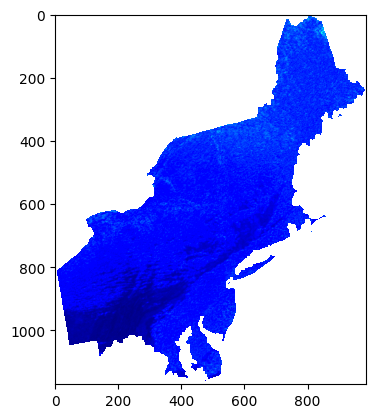

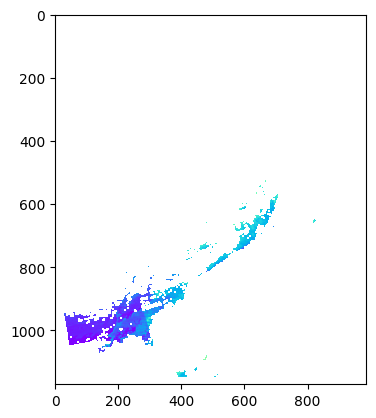

######### 311###############
0.028722886
0.7208401
3.108168e-05
0.019576097
0.0
0.53


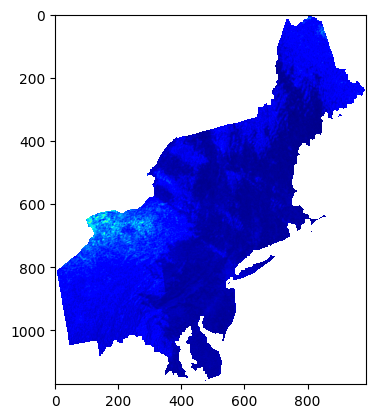

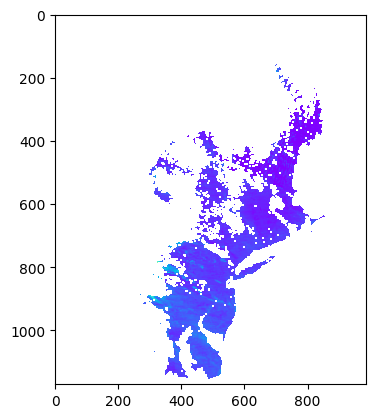

######### 312###############
0.020181231
0.36298203
1.534418e-05
0.0049638487
0.0
0.432


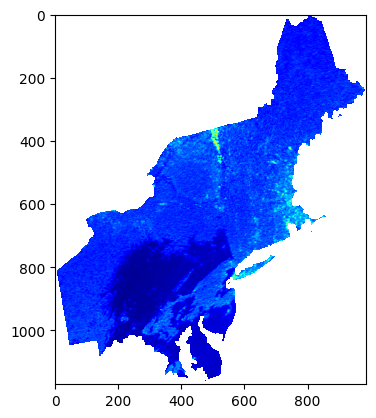

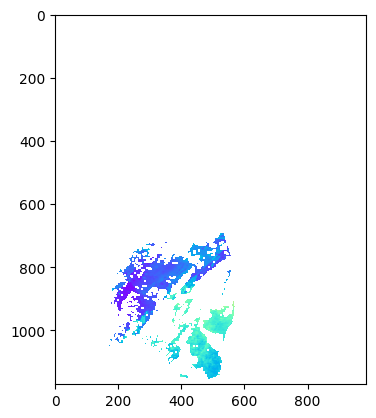

######### 313###############
0.0434367
0.6227799
7.1082366e-05
0.014612262
0.0
0.43


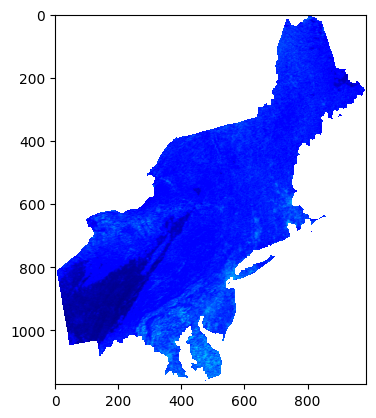

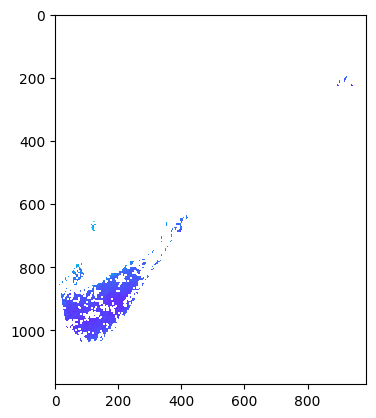

######### 314###############
0.03077233
0.44833067
3.5675417e-05
0.0075726025
0.0
0.436


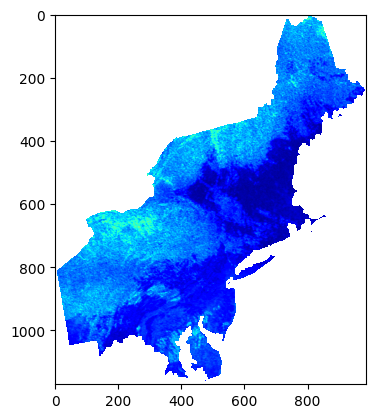

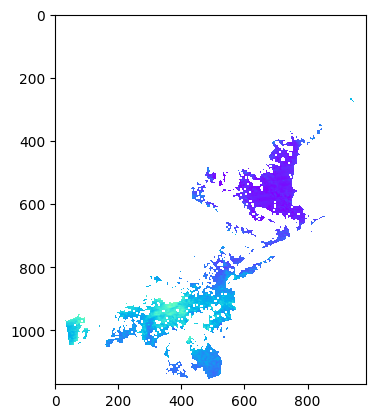

######### 315###############
0.10036637
0.46414685
0.0003795113
0.008116321
0.0
0.396


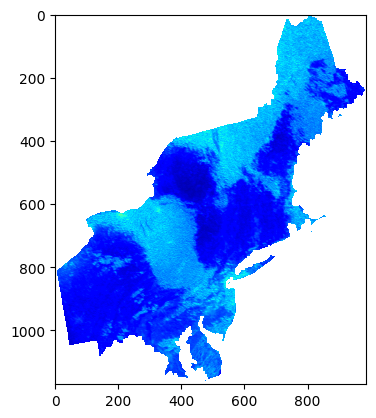

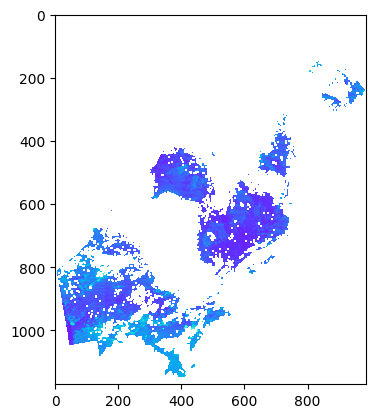

######### 316###############
0.029176012
0.61241555
3.2070086e-05
0.014129954
0.0
0.437


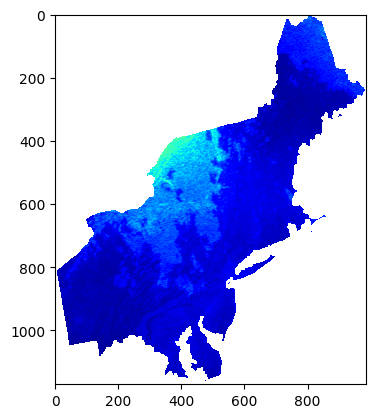

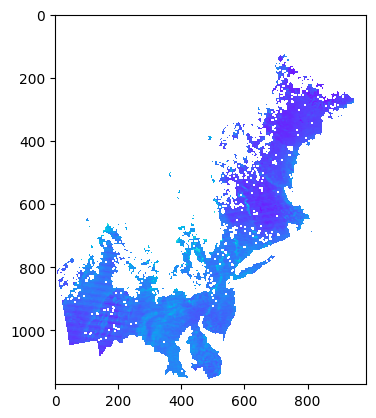

######### 317###############
0.06347472
0.6735431
0.00015179238
0.017091457
0.0
0.437


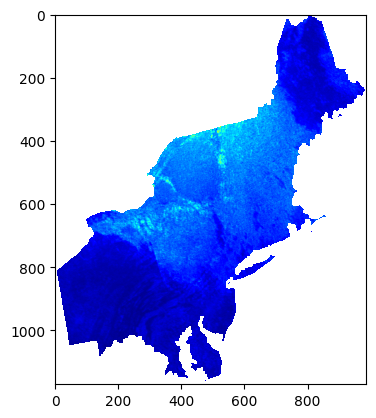

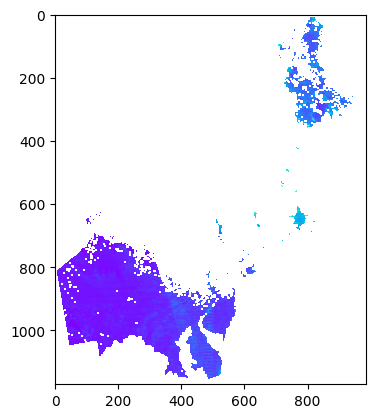

######### 318###############
0.0459916
0.39120644
7.969026e-05
0.0057658097
0.0
0.439


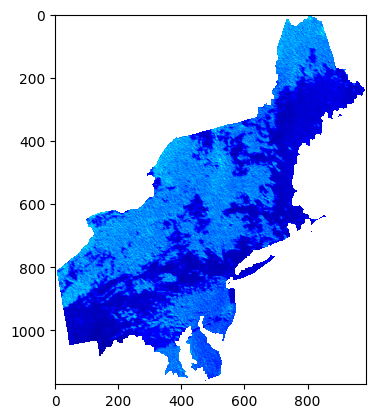

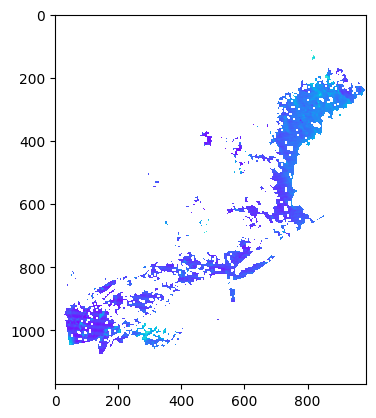

######### 319###############
0.054002833
0.41187936
0.00010987057
0.006391287
0.0
0.277


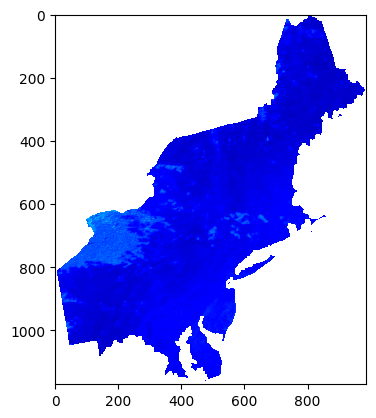

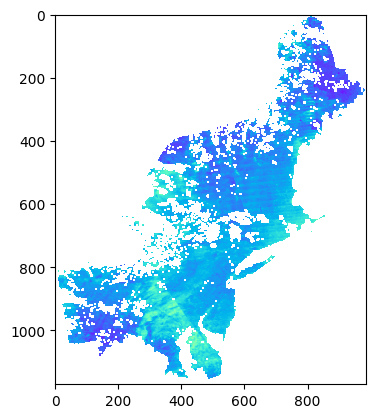

######### 320###############
0.06541848
0.8147812
0.00016123126
0.025010958
0.0
0.267


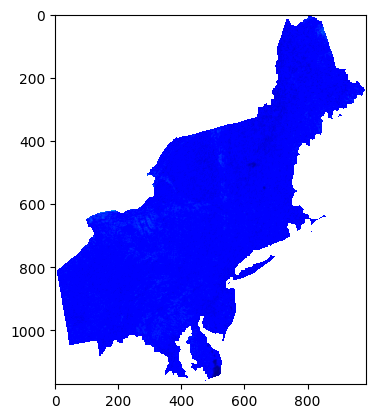

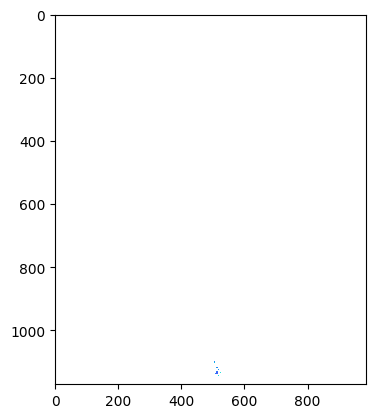

######### 321###############
0.029941421
0.4392321
3.3774824e-05
0.007268361
0.0
0.436


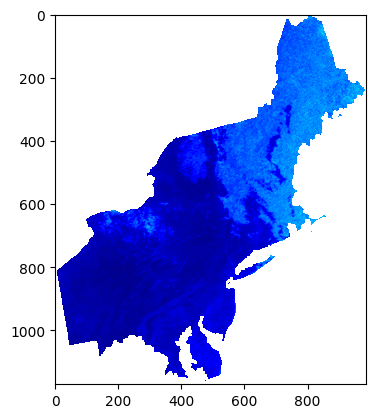

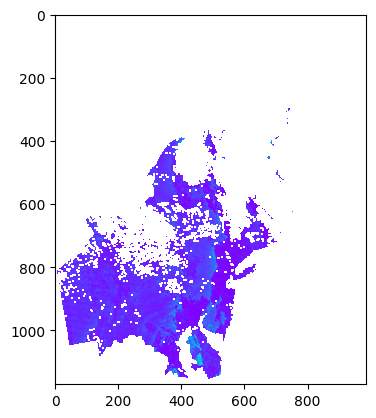

######### 322###############
0.086993806
0.41338295
0.00028511827
0.0064380364
0.0
0.424


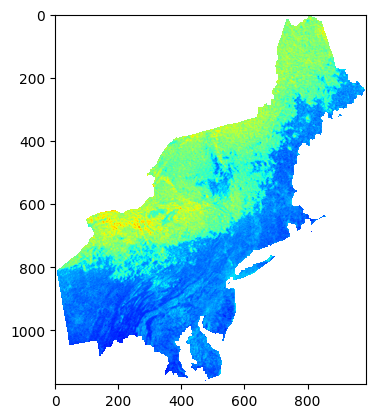

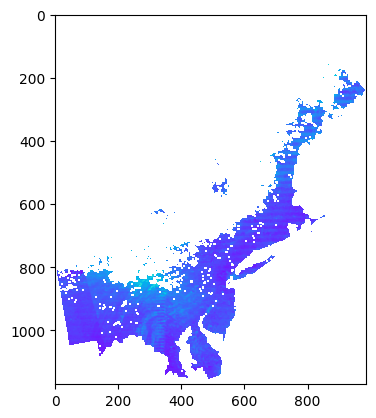

######### 323###############
0.02929663
0.56629544
3.2335804e-05
0.012081878
0.0
0.438


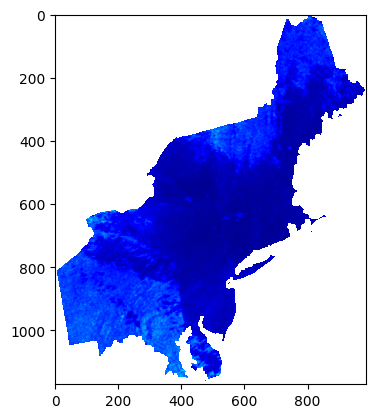

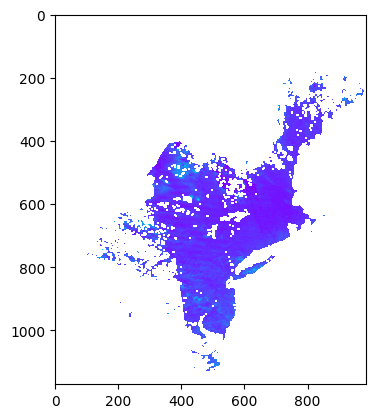

######### 324###############
0.034257907
0.5884636
4.4215027e-05
0.013046304
0.0
0.434


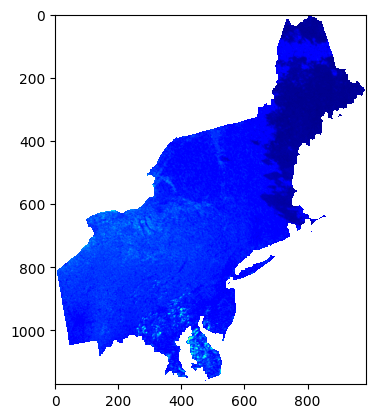

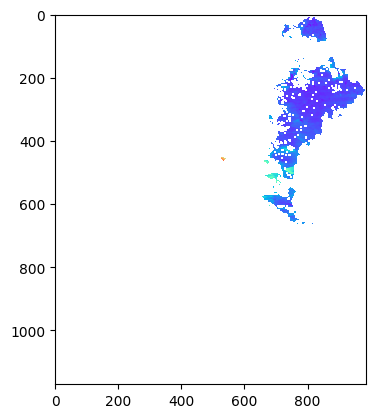

######### 325###############
0.07367861
0.65793526
0.00020451777
0.016308524
0.0
2.067


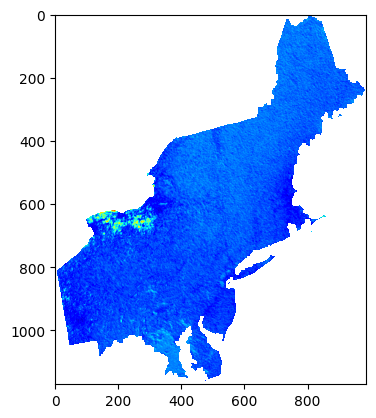

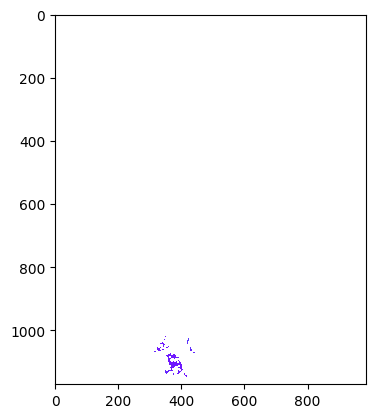

######### 326###############
0.031479225
0.7194038
3.73333e-05
0.019498166
0.0
0.905


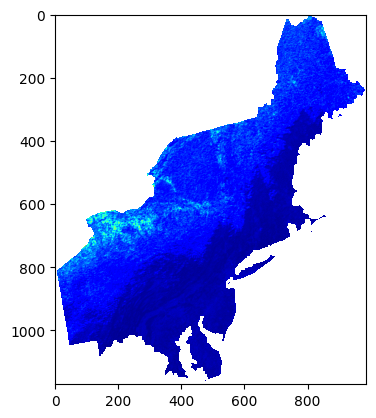

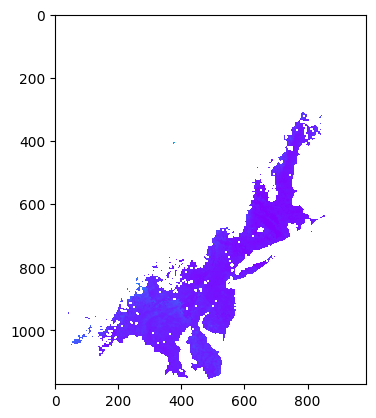

######### 327###############
0.050916735
0.44735485
9.767184e-05
0.0075396746
0.0
0.432


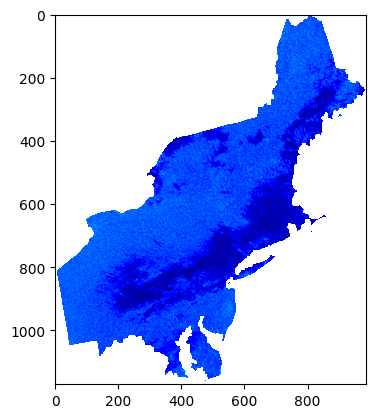

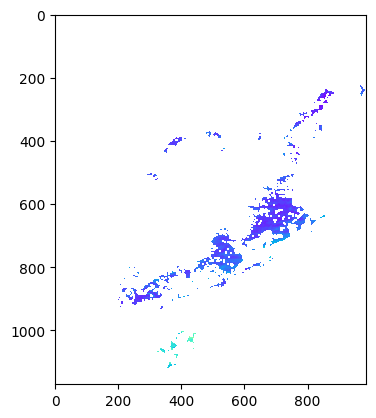

######### 328###############
0.01786896
0.75270057
1.2029481e-05
0.021344837
0.0
0.437


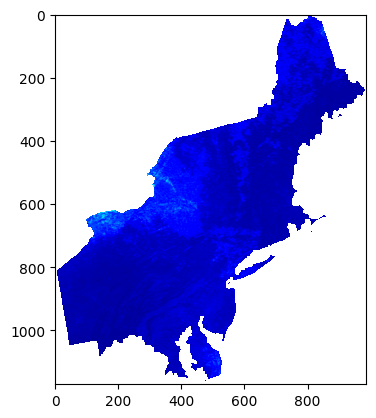

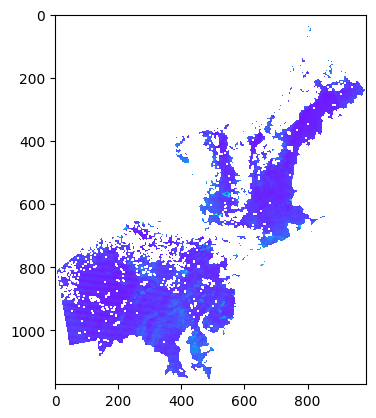

######### 329###############
0.052610643
0.44547623
0.000104278675
0.0074764835
0.0
0.435


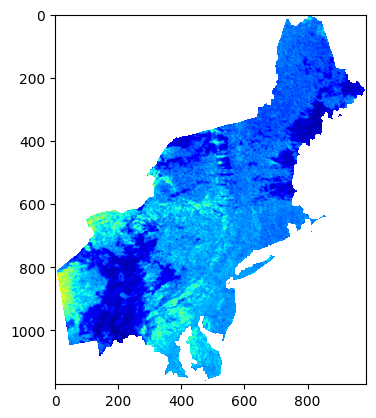

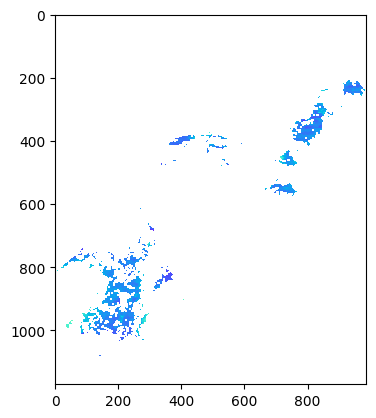

######### 330###############
0.036072083
0.58758575
4.9021975e-05
0.01300741
0.0
0.438


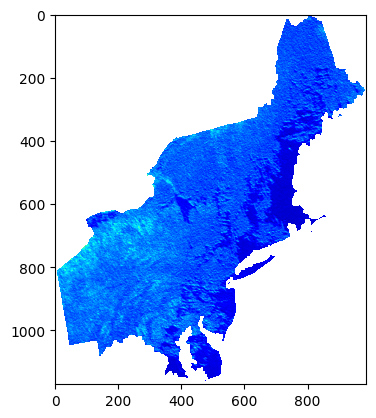

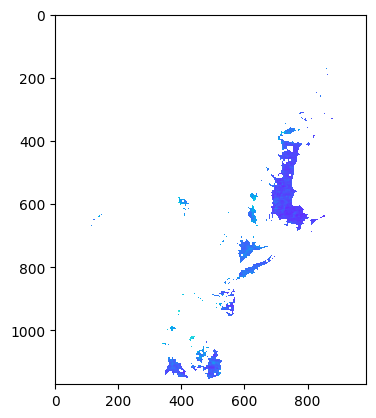

######### 331###############
0.056206413
0.466951
0.00011902002
0.008214685
0.0
0.435


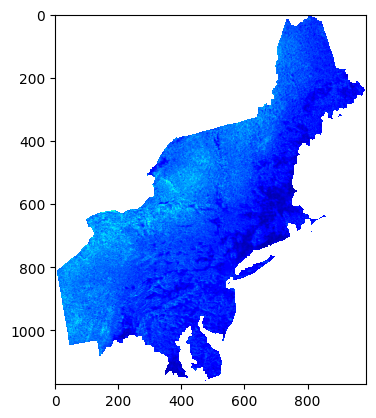

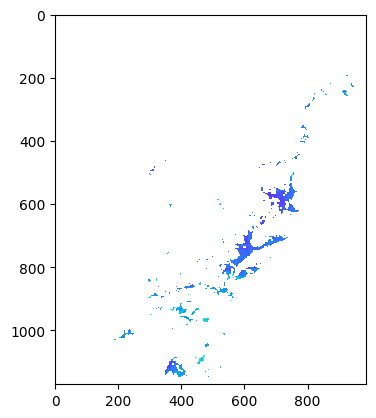

######### 332###############
0.026236875
0.4878849
2.5934181e-05
0.008967742
0.0
0.817


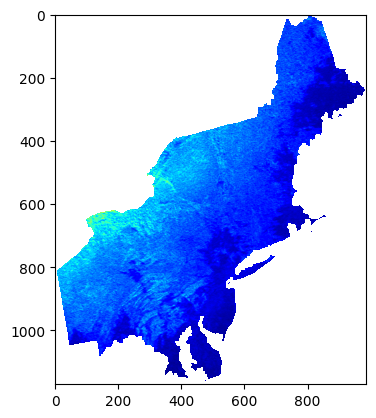

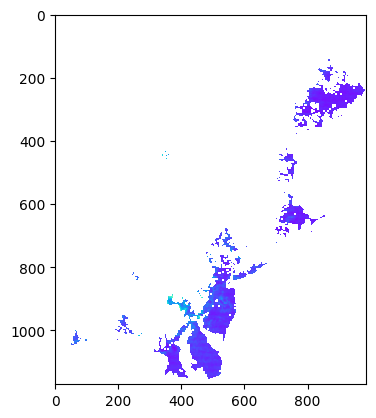

######### 333###############
0.033253882
0.57526386
4.1661322e-05
0.012467591
0.0
0.455


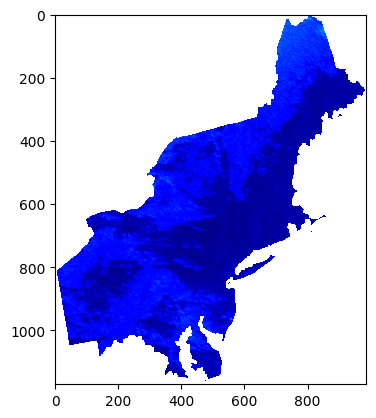

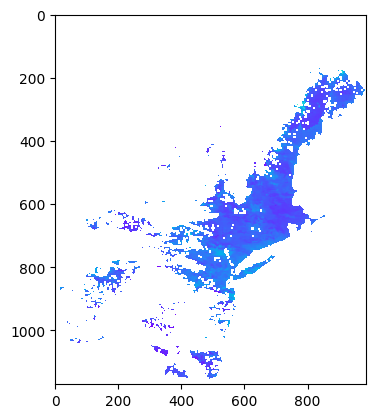

######### 334###############
0.04959325
0.23697737
9.2660244e-05
0.0021157383
0.012
0.421


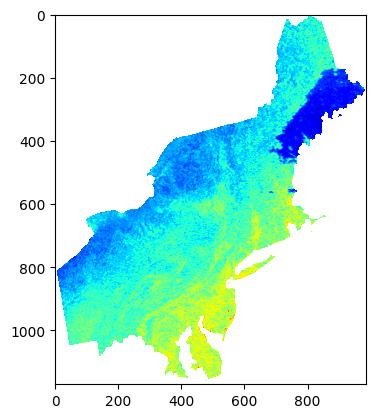

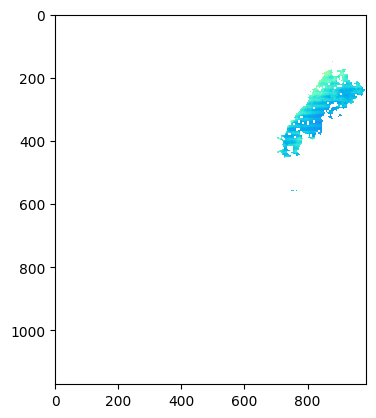

######### 335###############
0.04129088
0.17567223
6.4232736e-05
0.0011626647
0.0
0.665


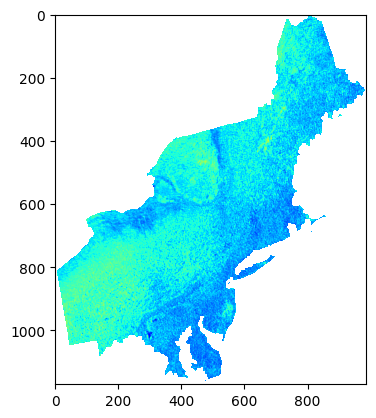

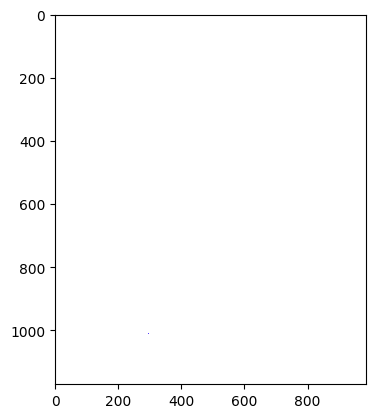

######### 336###############
0.08796083
0.31785774
0.00029149218
0.003806396
0.041
0.437


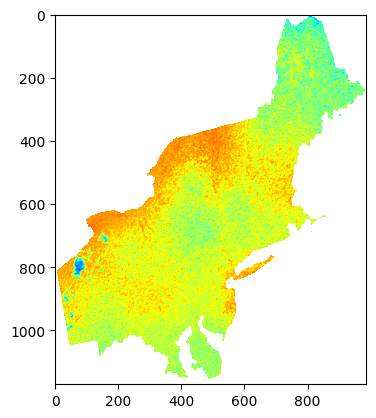

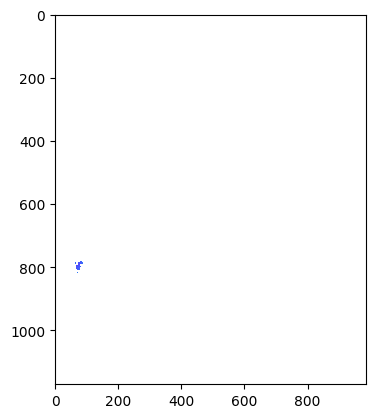

######### 337###############
0.054401282
0.23027265
0.000111497895
0.0019977128
0.0
0.42


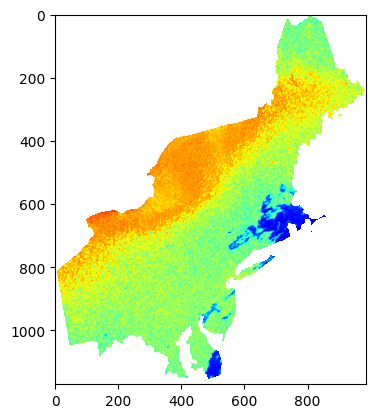

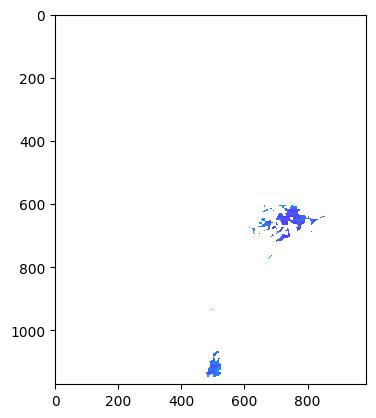

######### 338###############
0.04661243
0.25159046
8.185622e-05
0.0023847157
0.0
0.432


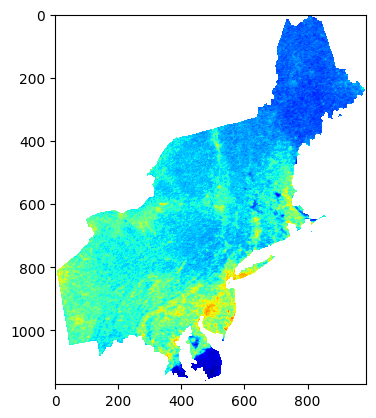

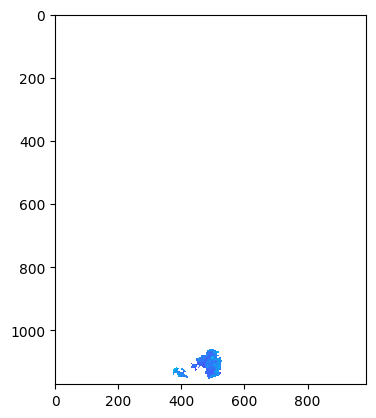

######### 339###############
0.09682139
0.32317427
0.00035317577
0.0039347927
0.0
3.781


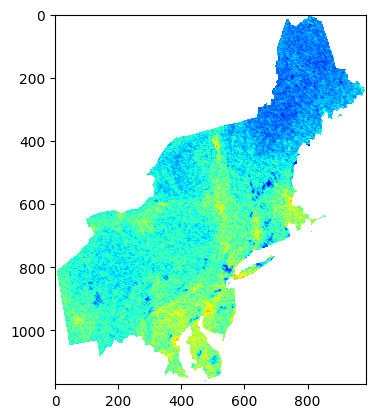

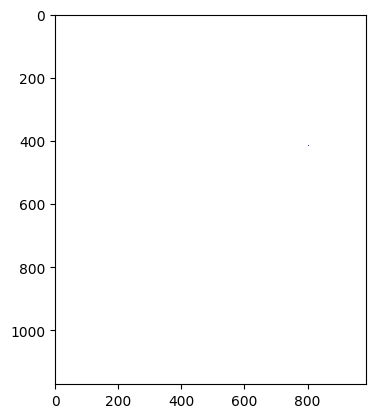

######### 340###############
0.0227518
0.26187658
1.9502037e-05
0.002583697
0.0
0.587


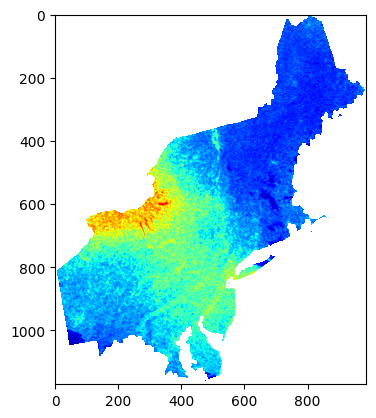

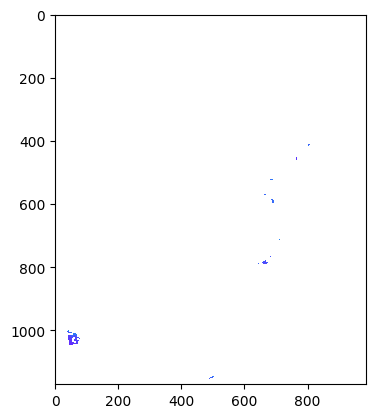

######### 341###############
0.03693597
0.32346228
5.1398132e-05
0.0039418093
0.0
0.432


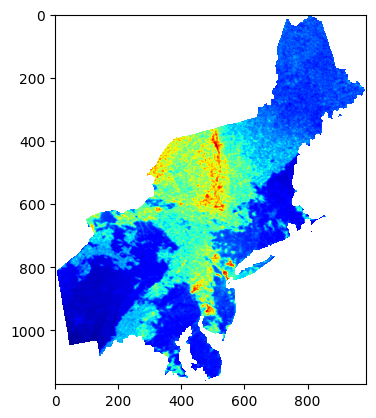

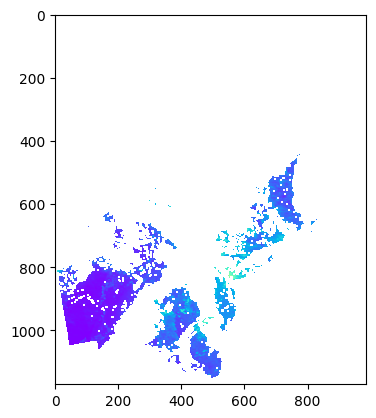

######### 342###############
0.055235617
0.23764864
0.00011494409
0.0021277415
0.0
0.429


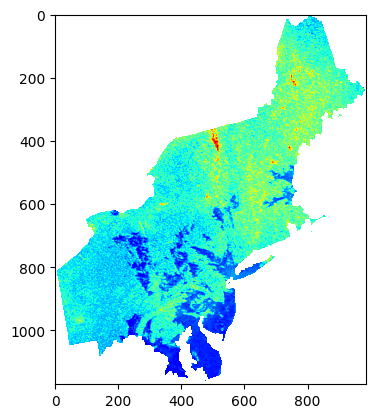

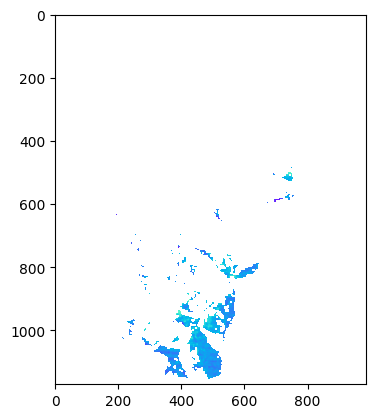

######### 343###############
0.07580851
0.3298723
0.00021651314
0.004099586
0.006
0.374


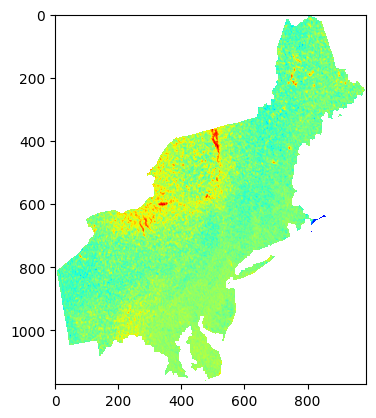

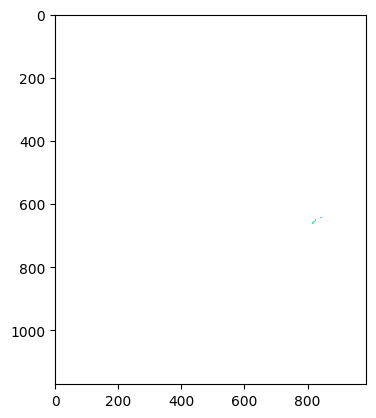

######### 344###############
0.072583914
0.24008834
0.00019848556
0.0021716529
0.0
1.803


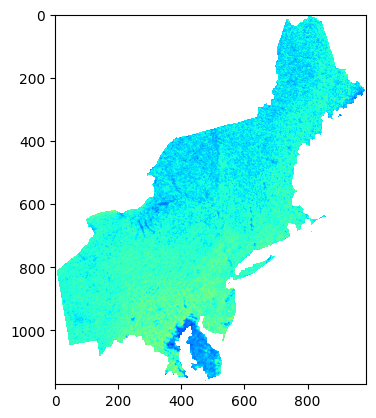

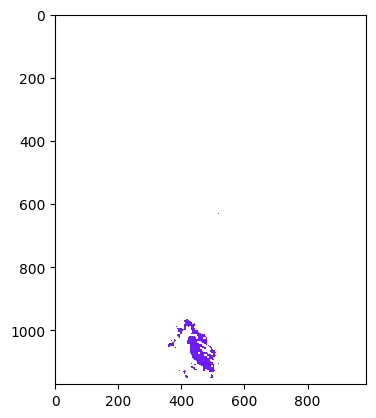

######### 345###############
0.028014839
0.20113218
2.9568171e-05
0.001524093
0.0
0.453


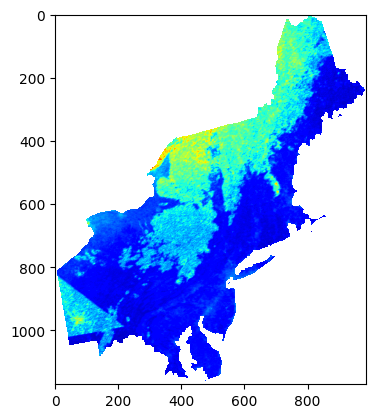

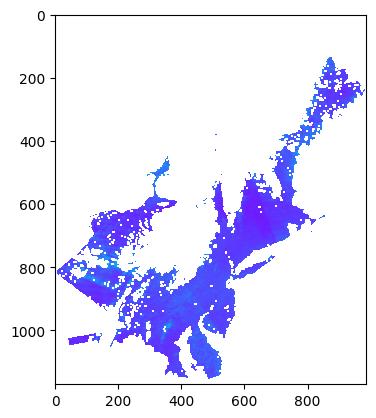

######### 346###############
0.056515586
0.2224086
0.00012033299
0.0018635944
0.0
0.681


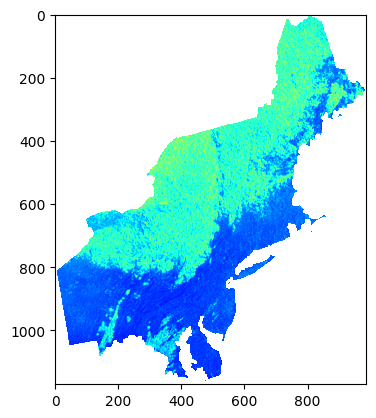

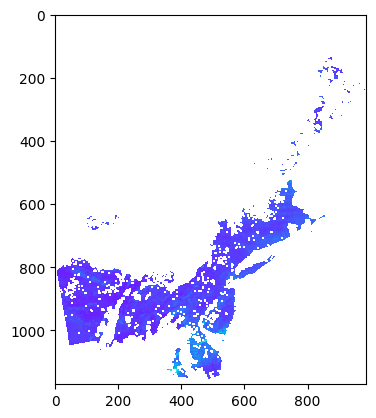

######### 347###############
0.050194956
0.19746667
9.492235e-05
0.0014690476
0.0
0.441


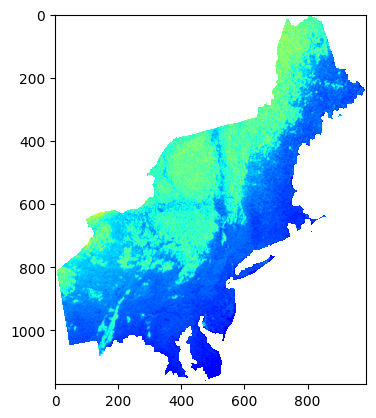

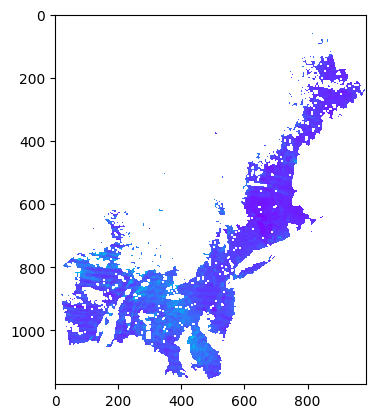

######### 348###############
0.10638948
0.27515966
0.000426428
0.0028524487
0.0
0.419


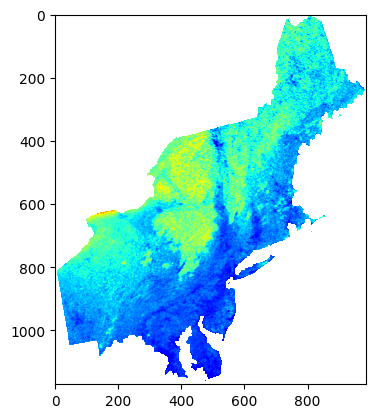

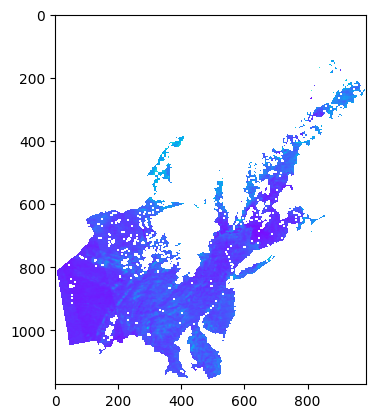

######### 349###############
0.016909033
0.17267933
1.077174e-05
0.0011233863
0.0
0.408


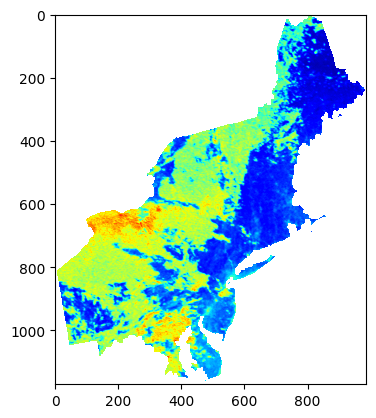

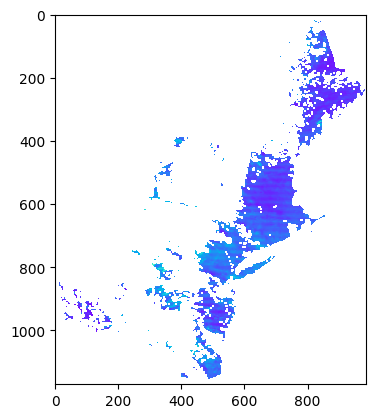

######### 350###############
0.021497577
0.18962419
1.7411148e-05
0.0013546769
nan
nan


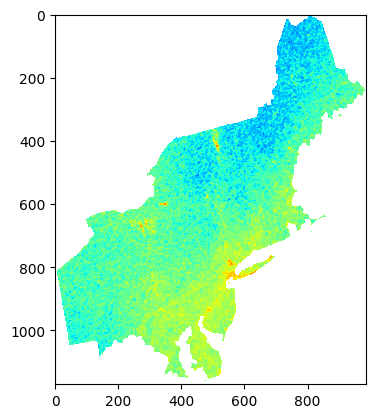

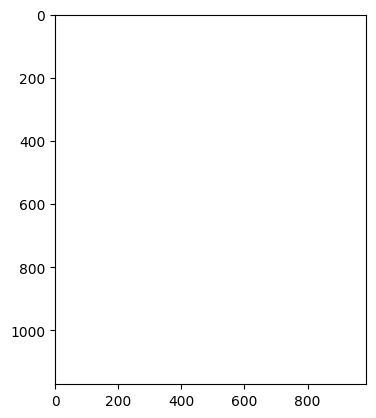

######### 351###############
0.0469269
0.55408734
8.296446e-05
0.011566574
0.0
0.433


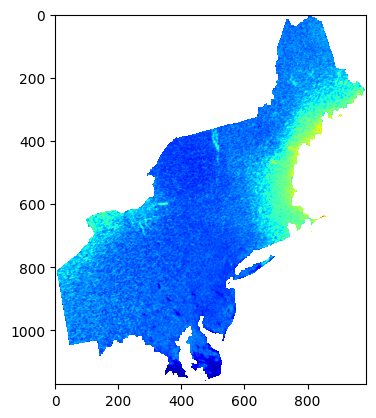

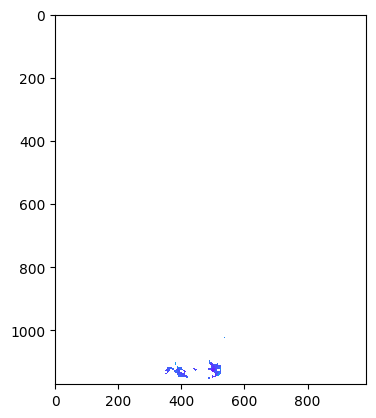

######### 352###############
0.03226954
0.26272762
3.9231407e-05
0.0026005174
0.0
0.419


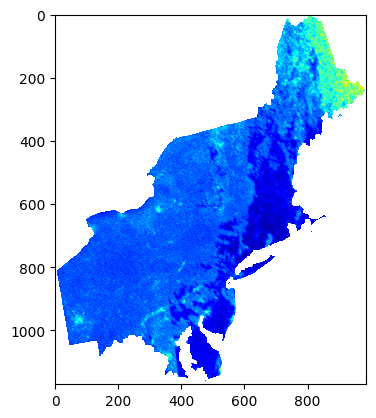

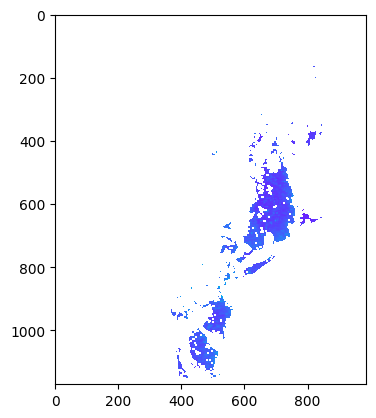

######### 353###############
0.06555543
0.25446904
0.00016190701
0.002439597
0.0
0.432


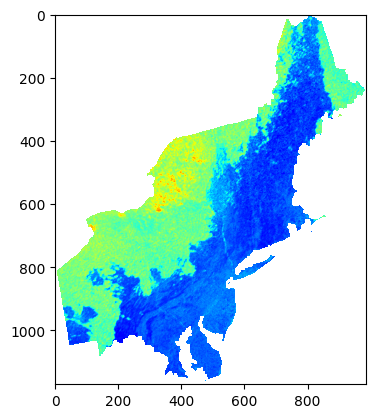

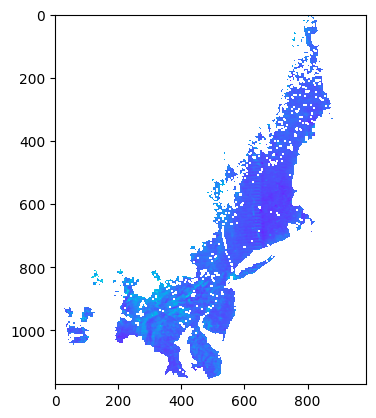

######### 354###############
0.13321923
0.42556208
0.00066862436
0.00682298
0.0
0.423


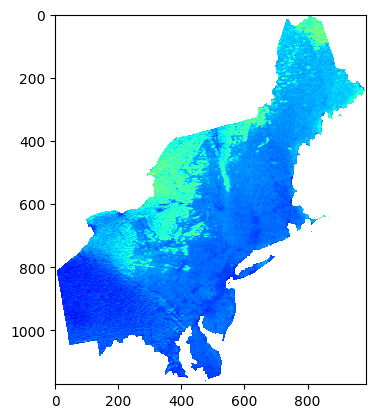

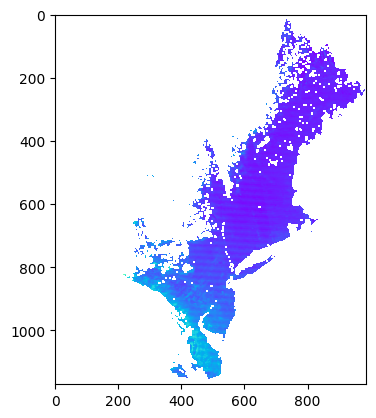

######### 355###############
0.11450211
0.41721353
0.0004939413
0.006557904
0.0
0.354


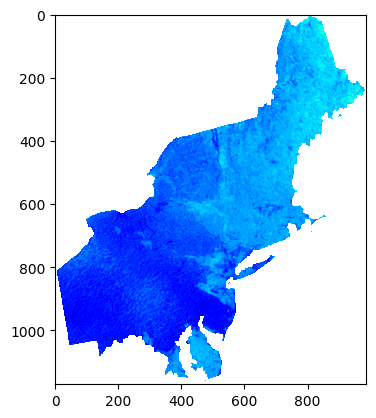

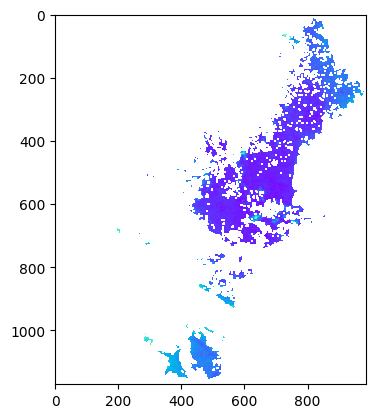

######### 356###############
0.026081614
0.38447267
2.5628146e-05
0.0055690263
0.0
0.378


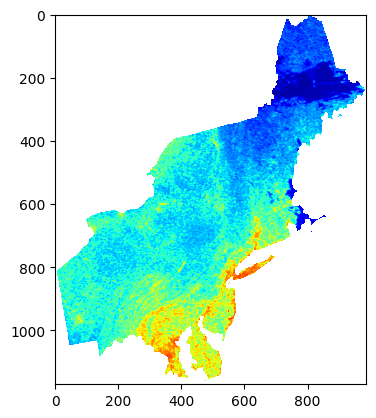

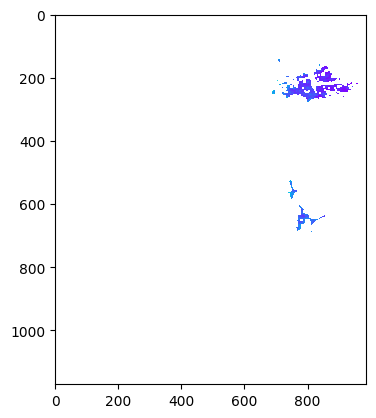

######### 357###############
0.033943176
0.37060362
4.3406348e-05
0.0051744916
0.0
0.415


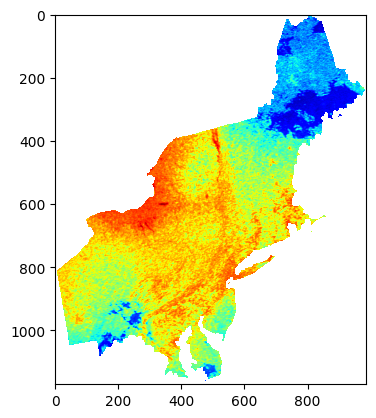

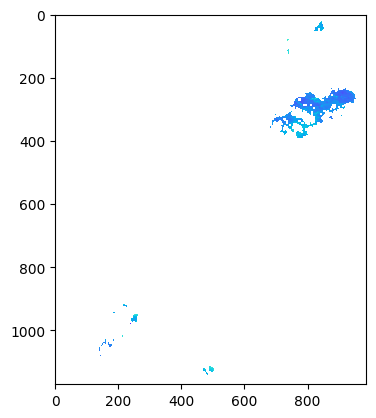

######### 358###############
0.038628574
0.23771745
5.6216737e-05
0.0021289743
0.0
0.433


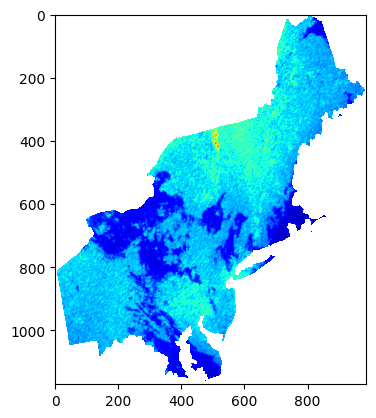

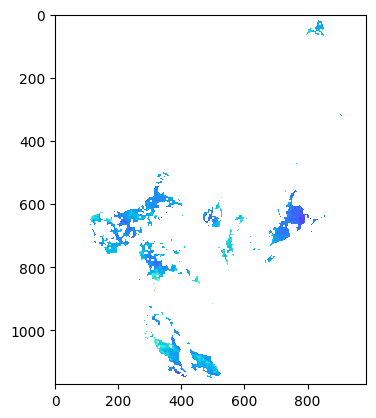

######### 359###############
0.07813501
0.28888598
0.0002300062
0.0031441357
0.0
0.481


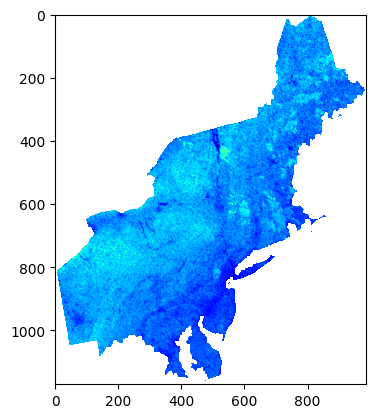

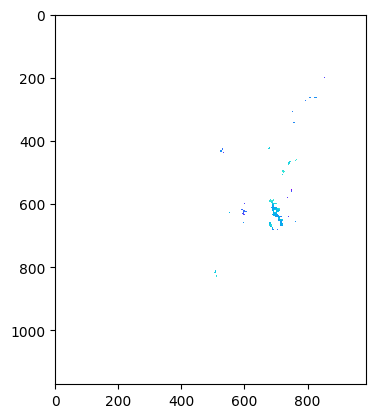

######### 360###############
0.09586269
0.31416503
0.0003462162
0.0037184674
0.043
0.455


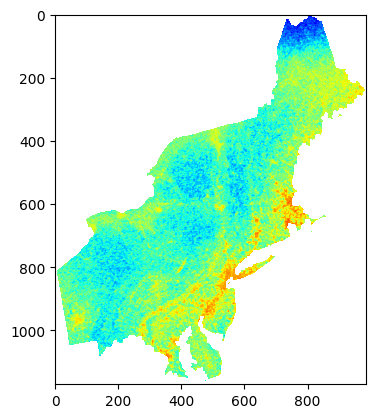

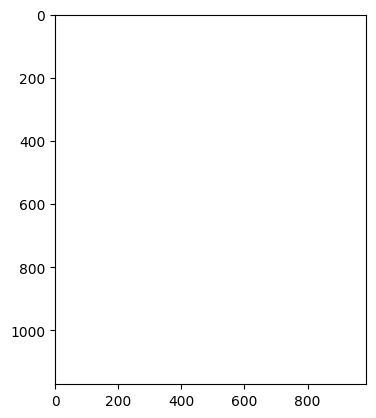

######### 361###############
0.019419182
0.47300076
1.4207255e-05
0.008428922
0.0
3.239


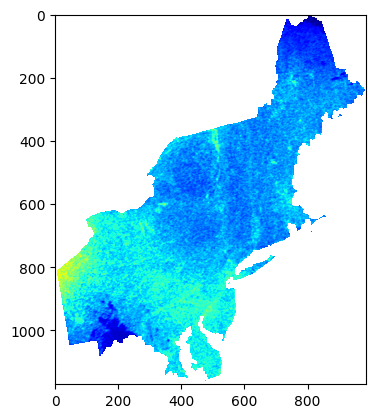

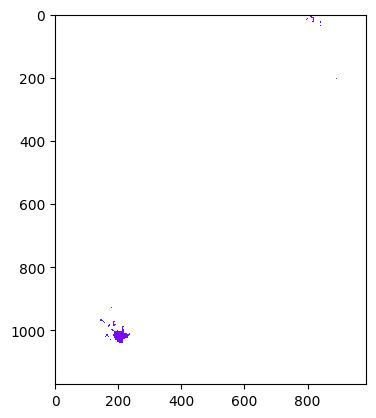

######### 362###############
0.11636557
0.38208562
0.0005101492
0.005500088
0.0
0.435


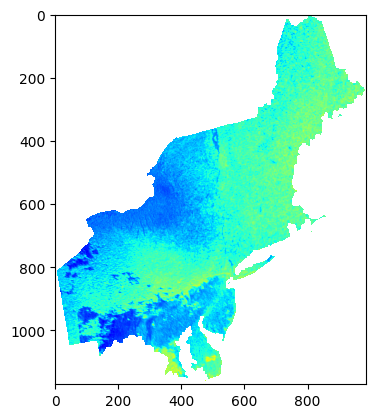

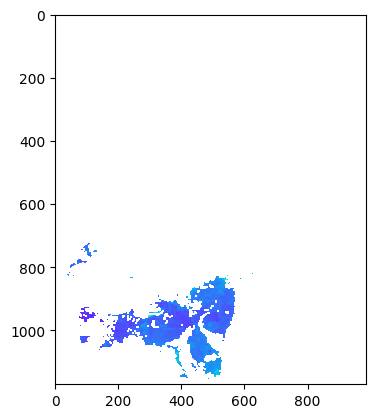

######### 363###############
0.037378915
0.24113102
5.2638283e-05
0.0021905568
0.0
0.423


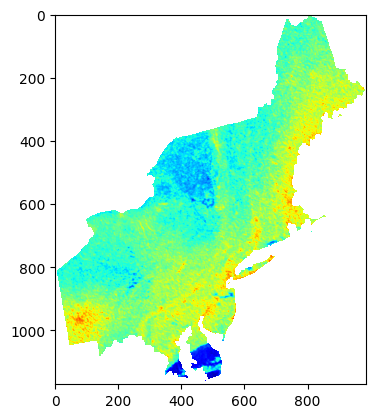

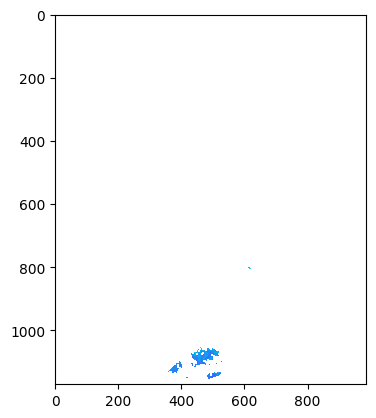

######### 364###############
0.04283835
0.27092993
6.9137524e-05
0.0027654278
0.0
0.43


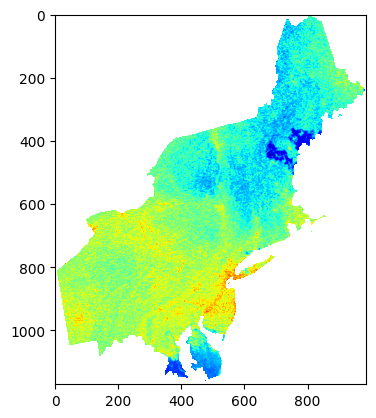

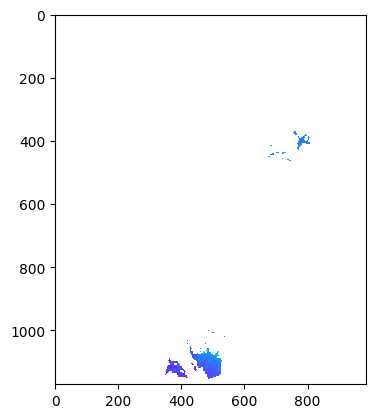

In [188]:
for idx in range(0, pi_width_infer.shape[0]):
    print(f'######### {idx}###############')
    print(np.nanmin(pi_width_infer[idx, 0, :]))
    print(np.nanmax(pi_width_infer[idx, 0, :]))
    print(np.nanmin(var_infer_aod[idx, 0, :]))
    print(np.nanmax(var_infer_aod[idx, 0, :]))
    # print(np.nanmin(std_infer_aod[idx, 0, :]))
    # print(np.nanmax(std_infer_aod[idx, 0, :]))
    # print(np.nanmin(lower_bound_infer_aod[idx, 0, :]))
    # print(np.nanmax(lower_bound_infer_aod[idx, 0, :]))
    # print(np.nanmin(upper_bound_infer_aod[idx, 0, :]))
    # print(np.nanmax(upper_bound_infer_aod[idx, 0, :]))
    print(np.nanmin(actual_infer_aod[idx, 0, :]))
    print(np.nanmax(actual_infer_aod[idx, 0, :]))
    plt.imshow(pi_width_infer[idx,0,:], cmap='jet')
    plt.show()
    plt.imshow(actual_infer_aod[idx,0,:], cmap='rainbow')
    plt.show()

## Impute 2021, 2022 - train test and validation data

In [12]:
x_train_model = load_data(f'{output_pkl}/NE_X_Train.pkl')
x_train_model = x_train_model[0]
y_train_model, miss_y_train_model = load_data(f'{output_pkl}/NE_Y_Train.pkl')
y_train_model = np.where((y_train_model == -9999) | (y_train_model == -1.0), np.nan, y_train_model)

x_test_model = load_data(f'{output_pkl}/NE_X_Test.pkl')
x_test_model = x_test_model[0]
y_test_model, miss_y_test_model = load_data(f'{output_pkl}/NE_Y_Test.pkl')
y_test_model = np.where((y_test_model == -9999) | (y_test_model == -1.0), np.nan, y_test_model)

x_val_model = load_data(f'{output_pkl}/NE_X_Validation.pkl')
x_val_model = x_val_model[0]
y_val_model, miss_y_val_model = load_data(f'{output_pkl}/NE_Y_Validation.pkl')
y_val_model = np.where((y_val_model == -9999) | (y_val_model == -1.0), np.nan, y_val_model)

d_train, d_test, d_val = load_data(f'{output_pkl}/NE_DATE_TTV.pkl')
season_train, season_test, season_val = load_data(f'{output_pkl}/NE_Season_TTV.pkl')
month_train, month_test, month_val = load_data(f'{output_pkl}/NE_Month_TTV.pkl')
data_bm = load_data(f'{output_pkl}/NE_BM.pkl')
latitude, longitude = load_data(f'{output_pkl}/NE_Grid.pkl')
print("Datasets loaded.")

Loading data from /data/Imputation/Input/Pickle//NE_X_Train.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_Y_Train.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_X_Test.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_Y_Test.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_X_Validation.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_Y_Validation.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_DATE_TTV.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_Season_TTV.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_Month_TTV.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_BM.pkl...
Loading data from /data/Imputation/Input/Pickle//NE_Grid.pkl...
Datasets loaded.


In [13]:
# Read and process LULC data
print("Processing LULC data.")
lulc_data, class_to_index = process_lulc_data(lulc_filepath)
lulc_data_remapped = remap_lulc_data(lulc_data, class_to_index)

# Adjust month data and create datasets
adj_month_train = month_train - 1
adj_month_val = month_val - 1
adj_month_test = month_test - 1

train_dataset = CustomIterableDataset(x_train_model, y_train_model, miss_y_train_model, data_bm[0], adj_month_train, season_train, lulc_data_remapped, d_train)
val_dataset = CustomIterableDataset(x_val_model, y_val_model, miss_y_val_model, data_bm[0], adj_month_val, season_val, lulc_data_remapped, d_val)
test_dataset = CustomIterableDataset(x_test_model, y_test_model, miss_y_test_model, data_bm[0], adj_month_test, season_test, lulc_data_remapped, d_test)

print("Training and validation datasets prepared.")

Processing LULC data.
Training and validation datasets prepared.


In [14]:
batch_size = best_result.config["batch_size"]
train_loader = DataLoader(train_dataset, batch_size=batch_size, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=batch_size,num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size,num_workers=2)

In [15]:
# Get the first batch from the DataLoader
first_batch = next(iter(train_loader))
x_first_batch, y_first_batch = first_batch['X'], first_batch['Y']
# Extracting the shape of your input data
num_y_segments, in_channels, height, width = y_first_batch.shape
num_x_segments, x_channels, height, width = x_first_batch.shape

## Run inference train test and validation data

In [28]:
imputed_train_data_samples, gain_train_data_samples, y_train_data, train_all_dates, y_train_mask_data, train_df = run_inference(train_loader)
imputed_val_data_samples, gain_val_data_samples, y_val_data, val_all_dates, y_val_mask_data, val_df = run_inference(val_loader)
imputed_test_data_samples, gain_test_data_samples, y_test_data, test_all_dates, y_test_mask_data, test_df = run_inference(test_loader)

2021-01-01 00:00:00 0.0022742662 0.7009401090953433
2021-01-02 00:00:00 0.010404056 0.5942985789588594
2021-01-03 00:00:00 0.011532965 0.44546689241305953
2021-01-04 00:00:00 0.0075162766 0.6891134792763148
2021-01-05 00:00:00 0.0056552314 0.5861724529446919
2021-01-06 00:00:00 0.005194621 0.5937871695655815
2021-01-07 00:00:00 0.003804801 0.5310250011306774
2021-01-08 00:00:00 0.004041983 0.4782883637607551
2021-09-06 00:00:00 0.0032513058 0.6855697155690458
2021-09-07 00:00:00 0.0014450299 0.7719482039076939
2021-09-08 00:00:00 0.0037828654 0.7953005891396823
2021-09-09 00:00:00 0.0055532665 0.6599660346716173
2021-09-10 00:00:00 0.009703352 0.6985295870074892
2021-09-11 00:00:00 0.003296116 0.763028073720957
2021-09-12 00:00:00 0.018337475 0.7998274914168084
2021-09-13 00:00:00 0.0060035633 0.9630940917962958
2021-01-09 00:00:00 0.0029563946 0.5794465252533927
2021-01-10 00:00:00 0.003442364 0.5068275890460542
2021-01-11 00:00:00 0.003115851 0.5333884917148672
2021-01-12 00:00:00 0.

/tmp/ipykernel_36866/2647984688.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_36866/2647984688.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_36866/2647984688.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_36866/2647984688.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2021-10-08 00:00:00 0.0055116573 0.7710328065229707
2021-10-09 00:00:00 0.011154571 0.7596865390111741
2021-10-10 00:00:00 0.003826531 0.7032597663219802
2021-10-11 00:00:00 0.0013059534 0.7159680884316758
2021-10-12 00:00:00 0.0021316665 0.7607784796916784
2021-10-13 00:00:00 0.0030413873 0.8135807634173542
2021-10-14 00:00:00 0.0021760948 0.7619239845521946
2021-10-15 00:00:00 0.0045304527 0.7445710241741311
2021-02-10 00:00:00 0.0025301978 0.5586494333182903
2021-02-11 00:00:00 0.011617092 -0.04048599947492449
2021-02-12 00:00:00 0.0064748665 0.13831629163955625
2021-02-13 00:00:00 0.008961728 -0.2558081929885335
2021-02-14 00:00:00 nan nan
2021-02-15 00:00:00 0.0066787624 -0.18071955324337577
2021-02-16 00:00:00 0.0064843595 0.5935479291539564
2021-02-17 00:00:00 0.0030143647 0.36544455265424597


/tmp/ipykernel_36866/2647984688.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_36866/2647984688.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_36866/2647984688.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_36866/2647984688.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2021-10-16 00:00:00 0.0039410065 0.6759762333264783
2021-10-17 00:00:00 0.0072680637 0.7395630197986789
2021-10-18 00:00:00 0.0035074393 0.7345271639532517
2021-10-19 00:00:00 0.00058675784 0.6353263927427442
2021-10-20 00:00:00 0.0007836195 0.4401159912190992
2021-10-21 00:00:00 0.002243776 0.7961529453694784
2021-10-22 00:00:00 0.004220737 0.6213073744763898
2021-10-23 00:00:00 0.0017950197 0.80523366862192
2021-02-18 00:00:00 0.015262207 -0.10885362591341347
2021-02-19 00:00:00 0.0064223344 0.0954547148818892
2021-02-20 00:00:00 0.004840032 0.40944425076757807
2021-02-21 00:00:00 0.0021576465 0.391286426489802
2021-02-22 00:00:00 nan nan
2021-02-23 00:00:00 0.0037289804 0.6486077502535066
2021-02-24 00:00:00 0.0027985882 0.5581469622094027
2021-02-25 00:00:00 0.0025548213 0.5825507538782406


/tmp/ipykernel_36866/2647984688.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_36866/2647984688.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_36866/2647984688.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_36866/2647984688.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2021-10-24 00:00:00 0.0012057347 0.8565093354316431
2021-10-25 00:00:00 0.0011359877 0.7182469909630508
2021-10-26 00:00:00 0.0019037195 0.8093821835248086
2021-10-27 00:00:00 0.00076107314 0.6572452039382543
2021-10-28 00:00:00 0.0006208276 0.6633380587398977
2021-10-29 00:00:00 0.00025175847 0.765226542152947
2021-10-30 00:00:00 0.004740624 0.7040341244775548
2021-10-31 00:00:00 0.004522235 0.7193254048155602
2021-02-26 00:00:00 0.0034801906 0.42965163374199383
2021-02-27 00:00:00 0.0021726144 0.03563819052324922
2021-02-28 00:00:00 0.006637379 0.12522758485335753
2021-03-01 00:00:00 0.004844661 -0.1144701825427707
2021-03-02 00:00:00 0.0010732579 0.47017166010369393
2021-03-03 00:00:00 0.0012173605 0.498864450724224
2021-03-04 00:00:00 0.006950787 0.7178403205024142
2021-03-05 00:00:00 0.0019141559 0.5383502794294189
2021-11-01 00:00:00 0.0008280786 0.6571626515016923
2021-11-02 00:00:00 0.0043630307 0.7870289534578988
2021-11-03 00:00:00 0.003022038 0.7209974507138779
2021-11-04 00

/tmp/ipykernel_36866/2647984688.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_36866/2647984688.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_36866/2647984688.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_36866/2647984688.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2021-11-17 00:00:00 0.00506763 0.6931220447062597
2021-11-18 00:00:00 0.0037879113 0.7345180074695797
2021-11-19 00:00:00 0.0033698876 0.7039162032796461
2021-11-20 00:00:00 0.0050623002 0.6051231823599736
2021-11-21 00:00:00 0.002791788 0.45839484285309
2021-11-22 00:00:00 0.0062813605 0.6616690335796922
2021-11-23 00:00:00 0.0029025797 0.6480918328706715
2021-11-24 00:00:00 0.00080770726 0.32655594586157144
2021-03-22 00:00:00 0.0025835782 0.2043097644585691
2021-03-23 00:00:00 0.0032216469 0.7058580047571772
2021-03-24 00:00:00 0.0042737317 0.6511306831294705
2021-03-25 00:00:00 0.008613937 0.5824389848739033
2021-03-26 00:00:00 0.004827768 0.7562078399281642
2021-03-27 00:00:00 0.0023802738 0.7157093207221318
2021-03-28 00:00:00 0.009892648 0.6382253385753927
2021-03-29 00:00:00 0.0019230039 0.5656132017433159
2021-11-25 00:00:00 0.0017016123 0.7639891089969513
2021-11-26 00:00:00 0.0035850652 0.6926974970516422
2021-11-27 00:00:00 0.0028657047 0.615876481593555
2021-11-28 00:00:00

/tmp/ipykernel_36866/2647984688.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_36866/2647984688.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_36866/2647984688.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_36866/2647984688.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2021-05-01 00:00:00 0.0017632375 0.38513138877445874
2021-05-02 00:00:00 0.0041606985 0.7985304075681218
2021-05-03 00:00:00 0.0052678986 0.8464261717783933
2021-05-04 00:00:00 0.004100079 0.8276444088356244
2021-05-05 00:00:00 0.003342751 0.7596959572075196
2021-05-06 00:00:00 0.0019704264 0.7080432968290822
2021-05-07 00:00:00 0.0021968822 0.8230993638652737
2021-05-08 00:00:00 0.008628025 0.4945461151442373
2022-01-04 00:00:00 0.0025379083 0.5305948903390371
2022-01-05 00:00:00 0.018384308 0.3987432917807703
2022-01-06 00:00:00 0.009307419 0.44788065859352505
2022-01-07 00:00:00 0.02609445 0.3023774356686235
2022-01-08 00:00:00 0.006467576 0.14135189904030226
2022-01-09 00:00:00 0.057865117 0.03275892768426312
2022-01-10 00:00:00 0.013726985 0.2532382154871642
2022-01-11 00:00:00 0.005251899 0.40070528508046305
2021-05-09 00:00:00 0.005253348 0.5615344806462208
2021-05-10 00:00:00 0.00837438 0.7208704081016281
2021-05-11 00:00:00 0.0048449077 0.5895482537697817
2021-05-12 00:00:00 0

/tmp/ipykernel_36866/2647984688.py:213: RuntimeWarning: Mean of empty slice
  df_metrics['MAE'].append(np.nanmean(metrics['MAE']))
/tmp/ipykernel_36866/2647984688.py:214: RuntimeWarning: Mean of empty slice
  df_metrics['MSE'].append(np.nanmean(metrics['MSE']))
/tmp/ipykernel_36866/2647984688.py:215: RuntimeWarning: Mean of empty slice
  df_metrics['RMSE'].append(np.nanmean(metrics['RMSE']))
/tmp/ipykernel_36866/2647984688.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2021-06-02 00:00:00 0.0013571318 0.8581142845393281
2021-06-03 00:00:00 0.004565798 0.5818171327742306
2021-06-04 00:00:00 0.0039583286 0.7190680056640393
2021-06-05 00:00:00 0.0016376826 0.7378347169100156
2021-06-06 00:00:00 0.0029320265 0.7542799735461666
2021-06-07 00:00:00 0.0029225333 0.7048107935658573
2021-06-08 00:00:00 0.0033424585 0.6087810055485579
2021-06-09 00:00:00 0.002002857 0.8891001939322967
2022-02-05 00:00:00 0.003604179 0.2548353350830584
2022-02-06 00:00:00 0.004262258 0.5642442534381369
2022-02-07 00:00:00 0.0018675479 0.5467750108588073
2022-02-08 00:00:00 0.0043534404 0.5142467203190295
2022-02-09 00:00:00 0.0023455846 0.45418965570196235
2022-02-10 00:00:00 0.0070037167 0.4419476604079357
2022-02-11 00:00:00 0.004684929 0.4123512947396788
2022-02-12 00:00:00 0.004467751 0.32470861613662727
2021-06-10 00:00:00 0.0017098059 0.85306836208761
2021-06-11 00:00:00 0.0046092886 0.7261801014319315
2021-06-12 00:00:00 0.0017658062 0.7613361992914698
2021-06-13 00:00:0

/tmp/ipykernel_36866/2647984688.py:216: RuntimeWarning: Mean of empty slice
  df_metrics['Correlation'].append(np.nanmean(metrics['Correlation']))


2021-07-12 00:00:00 0.007643338 0.704757830848152
2021-07-13 00:00:00 0.010079616 0.7638285015252799
2021-07-14 00:00:00 0.0060240473 0.7490543942067351
2021-07-15 00:00:00 0.005951826 0.7123206959735588
2021-07-16 00:00:00 0.0045921654 0.8041355927911724
2021-07-17 00:00:00 0.0058599235 0.6865289557723722
2021-07-18 00:00:00 0.10205489 0.9089334438201052
2021-07-19 00:00:00 0.25070018 0.8989398032178683
2022-03-17 00:00:00 0.005117411 0.36033504250725185
2022-03-18 00:00:00 0.0040013967 0.1457551490520425
2022-03-19 00:00:00 0.010354866 0.18847536370164825
2022-03-20 00:00:00 0.0046260455 0.5422858338346811
2022-03-21 00:00:00 0.0017122644 0.5670006260516274
2022-03-22 00:00:00 0.002769383 0.8122465494062221
2022-03-23 00:00:00 0.002515206 0.6524261243806292
2022-03-24 00:00:00 0.0050636446 0.515652950862417
2021-07-20 00:00:00 1.5459554 0.8800112751603708
2021-07-21 00:00:00 0.2964149 0.798824728036919
2021-07-22 00:00:00 0.012071568 0.8319475837674809
2021-07-23 00:00:00 0.008119472

In [46]:
train_df.to_csv(f'{metrics_path}NE_train_metrics_rt.csv')
val_df.to_csv(f'{metrics_path}NE_val_metrics_rt.csv')
test_df.to_csv(f'{metrics_path}NE_test_metrics_rt.csv')

## Process imputed data - sort array based on dates

In [31]:
imputed_train_aod, gain_train_imputed_aod, y_train_data, sorted_train_dates = process_imputed_data(imputed_train_data_samples, gain_train_data_samples, miss_y_train_model, y_train_data, train_all_dates, bm)
imputed_val_aod, gain_val_imputed_aod, y_val_data, sorted_val_dates = process_imputed_data(imputed_val_data_samples, gain_val_data_samples, miss_y_val_model, y_val_data, val_all_dates, bm)
imputed_test_aod, gain_test_imputed_aod, y_test_data, sorted_test_dates = process_imputed_data(imputed_test_data_samples, gain_test_data_samples, miss_y_test_model, y_test_data, test_all_dates, bm)

In [37]:
imputed_train_xr = transform_and_create_dataset(gain_train_imputed_aod, d_train, longs, lats, proj_string)
save_output(f'{tif_path}/GAIN/RT/', imputed_train_xr)
imputed_val_xr = transform_and_create_dataset(gain_val_imputed_aod, d_val, longs, lats, proj_string)
save_output(f'{tif_path}/GAIN/RT/', imputed_val_xr)
imputed_test_xr = transform_and_create_dataset(gain_test_imputed_aod, d_test, longs, lats, proj_string)
save_output(f'{tif_path}/GAIN/RT/', imputed_test_xr)
# f'{tif_path}/GAIN/RT/'

<class 'xarray.core.dataset.Dataset'>
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022132_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022133_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022134_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022135_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022136_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022137_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022138_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022139_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022140_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022141_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022142_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/RT/MAIAC_2022143_GAIN.tif
Saving /data/Imputation/Output/Version3/TIF//GAIN/

In [43]:
# Evaluate model performance
def evaluate_imputation(y_true, y_imputed):
    mse = mean_squared_error(y_true, y_imputed)
    mae = mean_absolute_error(y_true, y_imputed)
    r2 = r2_score(y_true, y_imputed)
    return mse, mae, r2


date_list = [datetime(2021, 5, 1, 0, 0),
    datetime(2021, 5, 19, 0, 0),
    datetime(2021, 5, 20, 0, 0),
    datetime(2021, 6, 17, 0, 0),
    datetime(2021, 6, 24, 0, 0),
    datetime(2021, 8, 6, 0, 0),
    datetime(2021, 9, 19, 0, 0),
    datetime(2021, 10, 20, 0, 0),
    datetime(2021, 11, 6, 0, 0),
    datetime(2021, 11, 7, 0, 0),
    datetime(2021, 11, 8, 0, 0),
    datetime(2021, 11, 24, 0, 0),
    datetime(2021, 12, 12, 0, 0),
    datetime(2021, 12, 14, 0, 0),
    datetime(2022, 5, 9, 0, 0),
    datetime(2022, 5, 10, 0, 0),
    datetime(2022, 5, 11, 0, 0),
    datetime(2022, 5, 30, 0, 0),
    datetime(2022, 6, 25, 0, 0),
    datetime(2022, 7, 3, 0, 0),
    datetime(2022, 7, 10, 0, 0),
    datetime(2022, 7, 23, 0, 0),
    datetime(2022, 9, 2, 0, 0),
    datetime(2022, 9, 15, 0, 0),
    datetime(2022, 9, 17, 0, 0),
    datetime(2022, 10, 11, 0, 0),
    datetime(2022, 10, 21, 0, 0),
    datetime(2022, 10, 22, 0, 0),
    datetime(2022, 10, 27, 0, 0),
    datetime(2022, 10, 29, 0, 0),
    datetime(2022, 11, 2, 0, 0),
    datetime(2022, 11, 3, 0, 0),
    datetime(2022, 11, 7, 0, 0),
    datetime(2022, 11, 8, 0, 0),
    datetime(2022, 11, 9, 0, 0),
    datetime(2022, 11, 10, 0, 0),
    datetime(2022, 11, 26, 0, 0),
    datetime(2022, 12, 9, 0, 0)
]


missingness_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]


combined_dates = sorted_train_dates + sorted_val_dates + sorted_test_dates

gain_imputed_aod = np.concatenate((gain_train_imputed_aod, gain_val_imputed_aod, gain_test_imputed_aod), axis=0)
y_data = np.concatenate((y_train_data, y_val_data, y_test_data), axis=0)
miss_y_data = np.concatenate((miss_y_train_model, miss_y_val_model, miss_y_test_model), axis = 0)

In [53]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
results = []
for missing_rate in missingness_levels:
    all_mse = []
    all_mae = []
    all_rmse = []
    all_r2 = []
    
    mr_folder = int(missing_rate * 100)

    for outer_idx, doi in enumerate(date_list):
        print(doi)
        idx = [i for i, dt in enumerate(combined_dates) if dt == doi]
        idx = idx[0]

        # Step 1: Get the mask for the current index
        mask_idx = miss_y_data[idx, 0] 
        y_data_idx = y_data[idx, 0]
        gain_imputed_aod_idx = gain_imputed_aod[idx, 0]
        
        # Step 3: Simulate missingness by randomly selecting some valid pixels to be marked as missing
        valid_y_data = np.where(mask_idx == 1, y_data_idx, np.nan)
        total_valid = np.sum(mask_idx == 1)  # Count of valid pixels
        num_missing = int(missing_rate * total_valid)  # Number of pixels to mark as missing

        # Step 4: Randomly select valid indices to simulate missingness
        valid_indices = np.where(mask_idx == 1)  # This returns a tuple of arrays (row indices, col indices)
        flat_valid_indices = np.ravel_multi_index(valid_indices, mask_idx.shape)  # Flatten valid indices for selection

        # Randomly select indices to introduce simulated missingness
        simulated_gap_indices = np.random.choice(flat_valid_indices, num_missing, replace=False)

        imputed_values = gain_imputed_aod_idx.flatten()[simulated_gap_indices] 
        ground_truth_values = y_data_idx.flatten()[simulated_gap_indices]  

        # Combine the imputed and original y values into a DataFrame
        df_comparison = pd.DataFrame({
            'Imputed_Y': imputed_values,
            'Original_Y': ground_truth_values
        })

        # Optionally, reset the index if you want a clean DataFrame
        df_comparison.reset_index(drop=True, inplace=True)

        # Step 3: Calculate metrics
        mse, mae, r2 = evaluate_imputation(ground_truth_values, imputed_values)
        rmse = np.sqrt(mse)

        # Append metrics to the lists
        all_mse.append(mse)
        all_mae.append(mae)
        all_rmse.append(rmse)
        all_r2.append(r2)
     
    # Calculate mean and standard deviation for each metric
    mean_mse, std_mse = np.mean(all_mse), np.std(all_mse)
    mean_mae, std_mae = np.mean(all_mae), np.std(all_mae)
    mean_rmse, std_rmse = np.mean(all_rmse), np.std(all_rmse)
    mean_r2, std_r2 = np.mean(all_r2), np.std(all_r2)
    print(mean_mse, mean_mae, mean_r2, mean_rmse)
        

    # Create a dictionary with results for this missingness level
    result_dict = {
        'Model': 'GAIN',
        'Missingness_Level': int(missing_rate * 100),
        'MSE_Mean': mean_mse,
        'MSE_StdDev': std_mse,
        'MAE_Mean': mean_mae,
        'MAE_StdDev': std_mae,
        'RMSE_Mean': mean_rmse,
        'RMSE_StdDev': std_rmse,
        'R2_Mean': mean_r2,
        'R2_StdDev': std_r2
    }

    # Append the result to the results list
    results.append(result_dict)

# Convert the results list into a DataFrame and save to CSV
results_df = pd.DataFrame(results)
results_df

2021-05-01 00:00:00
2021-05-19 00:00:00
2021-05-20 00:00:00
2021-06-17 00:00:00
2021-06-24 00:00:00
2021-08-06 00:00:00
2021-09-19 00:00:00
2021-10-20 00:00:00
2021-11-06 00:00:00
2021-11-07 00:00:00
2021-11-08 00:00:00
2021-11-24 00:00:00
2021-12-12 00:00:00
2021-12-14 00:00:00
2022-05-09 00:00:00
2022-05-10 00:00:00
2022-05-11 00:00:00
2022-05-30 00:00:00
2022-06-25 00:00:00
2022-07-03 00:00:00
2022-07-10 00:00:00
2022-07-23 00:00:00
2022-09-02 00:00:00
2022-09-15 00:00:00
2022-09-17 00:00:00
2022-10-11 00:00:00
2022-10-21 00:00:00
2022-10-22 00:00:00
2022-10-27 00:00:00
2022-10-29 00:00:00
2022-11-02 00:00:00
2022-11-03 00:00:00
2022-11-07 00:00:00
2022-11-08 00:00:00
2022-11-09 00:00:00
2022-11-10 00:00:00
2022-11-26 00:00:00
2022-12-09 00:00:00
0.0011876966 0.0235256 0.0465347638636478 0.03087527
2021-05-01 00:00:00
2021-05-19 00:00:00
2021-05-20 00:00:00
2021-06-17 00:00:00
2021-06-24 00:00:00
2021-08-06 00:00:00
2021-09-19 00:00:00
2021-10-20 00:00:00
2021-11-06 00:00:00
2021-11

,Model,Missingness_Level,MSE_Mean,MSE_StdDev,MAE_Mean,MAE_StdDev,RMSE_Mean,RMSE_StdDev,R2_Mean,R2_StdDev
0,GAIN,10,0.001188,0.001347,0.023526,0.012699,0.030875,0.015311,0.046535,0.422272
1,GAIN,20,0.001186,0.001336,0.023536,0.012708,0.030867,0.015265,0.047452,0.421926
2,GAIN,30,0.001185,0.001336,0.023518,0.012680,0.030852,0.015263,0.047205,0.422885
3,GAIN,40,0.001187,0.001338,0.023541,0.012717,0.030871,0.015288,0.045779,0.422357
4,GAIN,50,0.001185,0.001335,0.023524,0.012696,0.030848,0.015265,0.047103,0.422231
5,GAIN,60,0.001185,0.001333,0.023530,0.012702,0.030860,0.015252,0.047822,0.421429
6,GAIN,70,0.001186,0.001338,0.023526,0.012698,0.030862,0.015275,0.047392,0.422458
7,GAIN,80,0.001185,0.001336,0.023530,0.012700,0.030863,0.015262,0.047277,0.422517


In [54]:
results_df.to_csv('GAIN1.csv')